# Attentions and Optical Character Recognition ( OCR )

**Ton Duc Thang University**<br>
**Subject:** Deep Learning <br>
**Lecturer**: Assoc. Prof. Le Anh Cuong <br>
**Authors**:
1. 522H0134 - Nguyen Nhat Huy
2. 522H0099 - Doan Ngoc Bao <br>
**Refs**:<br>
* [Flickr8K Image Captioning using CNNs+LSTMs](https://www.kaggle.com/code/quadeer15sh/flickr8k-image-captioning-using-cnns-lstms)
* [Bristol-Myers Squibb – Molecular Translation](https://www.kaggle.com/competitions/bms-molecular-translation/discussion/223419)
* [VLSP_Visual Question Answering Vietnamese](https://www.kaggle.com/code/nhanvi/vlsp-visual-question-answering-vietnamese)
* [VQA Baseline (ResNet50 + BERT)](https://www.kaggle.com/code/hoangminhtran/vqa-baseline-resnet50-bert/notebook)
* [Distilled AI](https://aman.ai/primers/ai/transformers/#self-attention)
* [The Illustrated GPT-2](https://jalammar.github.io/illustrated-gpt2/)
* [TrOCR](https://arxiv.org/pdf/2109.10282)
* [Keras](https://keras.io/examples/)
* [NEURAL MACHINE TRANSLATION](https://arxiv.org/pdf/1409.0473)



In [ ]:
import torch

if torch.cuda.is_available():
    print("✅ CUDA is available!")
    print(f"GPU: {torch.cuda.get_device_name(0)}")
else:
    print("❌ CUDA is NOT available.")

✅ CUDA is available!
GPU: Tesla T4


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
import seaborn as sns
import math
import time
import psutil
import os
import numpy as np
import pandas as pd

## Ex 1

In [ ]:
print('''
ĐỀ THI CUỐI KỲ - MÔN DEEP LEARNING
Đại học Tôn Đức Thắng

BÀI 1: Tìm hiểu chuyên sâu về các cơ chế Attention trong các mô hình ngôn ngữ lớn (LLMs)

Chọn một nhóm cơ chế attention hiện đại (càng nhiều càng tốt, ít nhất là 4), trong danh sách dưới đây:
1) Self-Attention                         (✓)
2) Multi-Query Attention (MQA)
3) Grouped-Query Attention (GQA)
4) FlashAttention hoặc FlashAttention v2  (✓)
5) Linear Attention                       (✓)
6) Sparse Attention
7) Rotary Positional Embedding (RoPE)     (✓)

Nội dung yêu cầu:
1. Trình bày lý thuyết chuyên sâu:
   - Giải thích cơ chế hoạt động, ý tưởng chính
   - Độ phức tạp tính toán
   - Ưu điểm và hạn chế
   - So sánh với Self-Attention trong Transformer gốc
   - Ứng dụng trong các mô hình LLM (GPT, LLaMA, v.v.)

2. Cài đặt mã nguồn minh họa (bằng PyTorch hoặc TensorFlow):
   - Viết lại cơ chế attention đã chọn dưới dạng module riêng
   - Tạo ví dụ đầu vào đơn giản (chuỗi ngắn hoặc dãy số)
   - In ra và giải thích ma trận attention tương ứng

3. Nộp bài:
   - Bài viết trình bày lý thuyết (PDF hoặc Word)
   - Notebook minh họa (Colab hoặc Jupyter)
''')


ĐỀ THI CUỐI KỲ - MÔN DEEP LEARNING
Đại học Tôn Đức Thắng

BÀI 1: Tìm hiểu chuyên sâu về các cơ chế Attention trong các mô hình ngôn ngữ lớn (LLMs)

Chọn một nhóm cơ chế attention hiện đại (càng nhiều càng tốt, ít nhất là 4), trong danh sách dưới đây:
1) Self-Attention                         (✓)
2) Multi-Query Attention (MQA)
3) Grouped-Query Attention (GQA)
4) FlashAttention hoặc FlashAttention v2  (✓)
5) Linear Attention                       (✓)
6) Sparse Attention
7) Rotary Positional Embedding (RoPE)     (✓)

Nội dung yêu cầu:
1. Trình bày lý thuyết chuyên sâu:
   - Giải thích cơ chế hoạt động, ý tưởng chính
   - Độ phức tạp tính toán
   - Ưu điểm và hạn chế
   - So sánh với Self-Attention trong Transformer gốc
   - Ứng dụng trong các mô hình LLM (GPT, LLaMA, v.v.)

2. Cài đặt mã nguồn minh họa (bằng PyTorch hoặc TensorFlow):
   - Viết lại cơ chế attention đã chọn dưới dạng module riêng
   - Tạo ví dụ đầu vào đơn giản (chuỗi ngắn hoặc dãy số)
   - In ra và giải thích ma trận atte

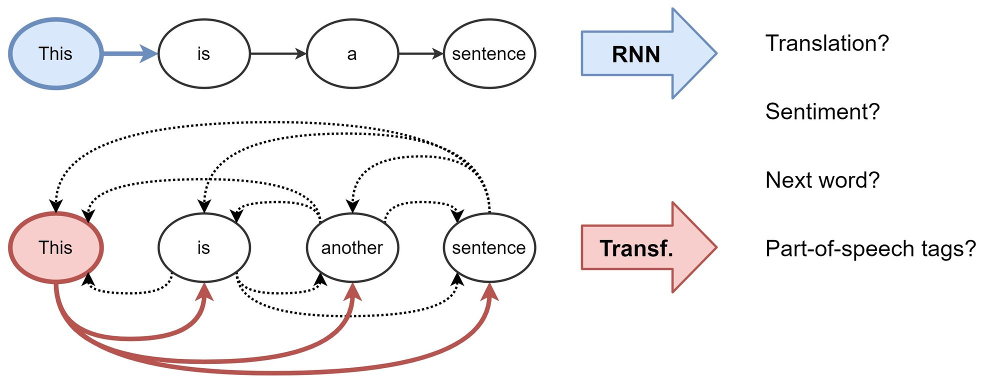

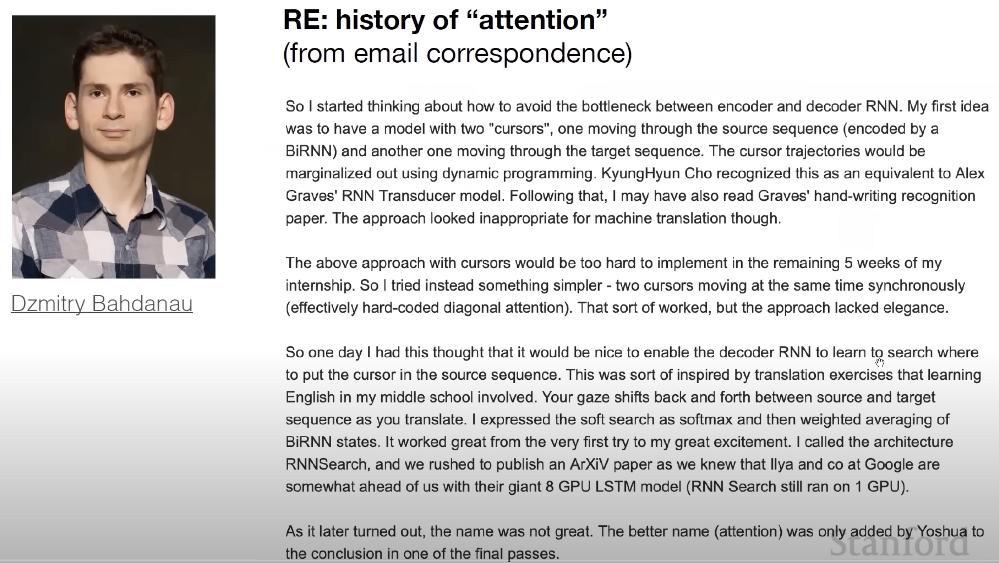

Dzmitry Bahdanau, được xem là người đầu tiên **đề xuất attention mechanism** Neural Machine Translation <br>
Jacobs University Bremen, Germany


### 1/ Self-Attention

* **Nguồn gốc**: "Attention Is All You Need" (2017) - **Google Brain**

* **Tác giả**: Ashish Vaswani, Noam Shazeer, Niki Parmar, Jakob Uszkoreit, Llion Jones, Aidan N. Gomez, Lukasz Kaiser, Illia Polosukhin

* 📄 **Paper**: https://arxiv.org/abs/1706.03762

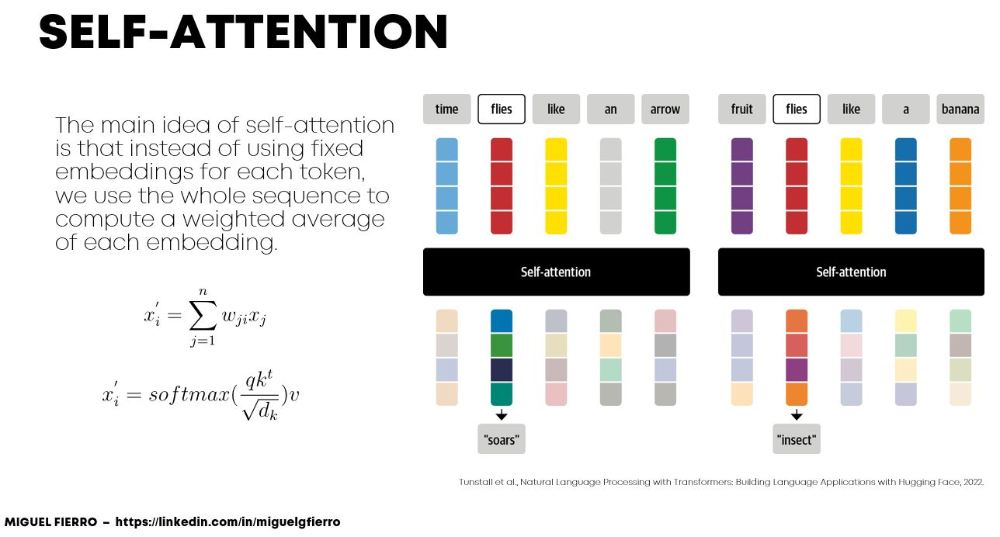

**🔍 1. Self-Attention — Lý thuyết chuyên sâu**<br>
**🧠 Ý tưởng chính**<br>
Self-Attention là cơ chế cho phép mỗi token trong chuỗi chú ý đến tất cả token khác, kể cả chính nó.
Nó trả lời câu hỏi:

"Khi xử lý từ này, tôi nên quan tâm đến những từ nào khác?"

Mỗi token được biến đổi thành:

* Query (Q) – token đang "hỏi"

* Key (K) – token cung cấp "thông tin"

* Value (V) – giá trị được lấy nếu K phù hợp

Sau đó, tính điểm tương tự giữa Q và tất cả K → dùng softmax → dùng làm trọng số nhân với V để lấy kết quả cuối.

<br>
**⚙️ Công thức toán học (giản lược)**<br>


```
Với đầu vào ma trận X ∈ ℝⁿˣᵈ:
Q = XW_Q    # [n, d] → [n, d_k]
K = XW_K
V = XW_V

Attention(Q, K, V) = softmax(QKᵀ / √d_k) · V
```

- `QKᵀ`: Ma trận độ tương tự giữa các token  
- `softmax`: Biến thành xác suất  
- `· V`: Trọng số trung bình để lấy kết quả cuối

<br><br>
**⏱️ Độ phức tạp tính toán**<br>
Thời gian & bộ nhớ: $$O(n² · d)$$ với chuỗi độ dài n

Do phải tính $$QKᵀ ∈ ℝⁿˣⁿ$$
, rất tốn khi n lớn

Đây là điểm nghẽn lớn trong các mô hình lớn như LLMs


<br><br>

✅ **Ưu điểm**
- Hiểu tốt **quan hệ dài hạn** (long-range dependencies)
- Không bị giới hạn thứ tự như RNN
- Dễ **song song hóa** → train nhanh trên GPU

<br><br>

⚠️ **Hạn chế**
- **Không hiểu vị trí** nếu không có positional encoding
- Độ phức tạp **O(n²)** → tốn RAM/VRAM với chuỗi dài
- Cần **multi-head** để học nhiều ngữ nghĩa khác nhau

<br><br>

🔁 **So sánh với Self-Attention trong Transformer gốc**

| Khía cạnh               | Self-Attention (gốc)      |
|------------------------|---------------------------|
| Complexity             | O(n²)                     |
| Chú ý dài hạn          | Có, toàn bộ chuỗi         |
| Hiểu ngữ cảnh toàn cục| Tốt                       |
| Khả năng mở rộng       | Hạn chế với chuỗi dài     |
| Ứng dụng               | Cốt lõi GPT, BERT, T5     |

<br><br>

🤖 **Ứng dụng trong LLMs**
- Là **xương sống** trong GPT-2/3/4, LLaMA, Falcon, Mistral, Claude,...
- Được dùng **ở tất cả các layer**, mỗi token đi qua nhiều tầng attention.

Các cải tiến trên Self-Attention:
- **RoPE** → giúp mô hình hiểu được **thứ tự vị trí**
- **FlashAttention, Linear Attention** → giảm **tính toán O(n²)**

<br><br>

Trong thực tế, mỗi token đầu ra được tạo bằng cách áp dụng self-attention nhiều lần (qua nhiều layer, nhiều head).


<br><br>
📌 **Tóm tắt nhanh**

| Thành phần       | Vai trò chính                                       |
|------------------|-----------------------------------------------------|
| Self-Attention   | Cốt lõi của mọi LLM, xử lý quan hệ giữa các token  |
| Ưu điểm          | Hiểu ngữ cảnh rộng, không phụ thuộc thứ tự cố định |
| Nhược điểm       | O(n²), thiếu thông tin vị trí nếu không có encoding |
| So với RNN/CNN   | Mạnh hơn, tổng quát hơn                             |
| Trong GPT/LLaMA  | Dùng ở mọi tầng để sinh output từ input             |

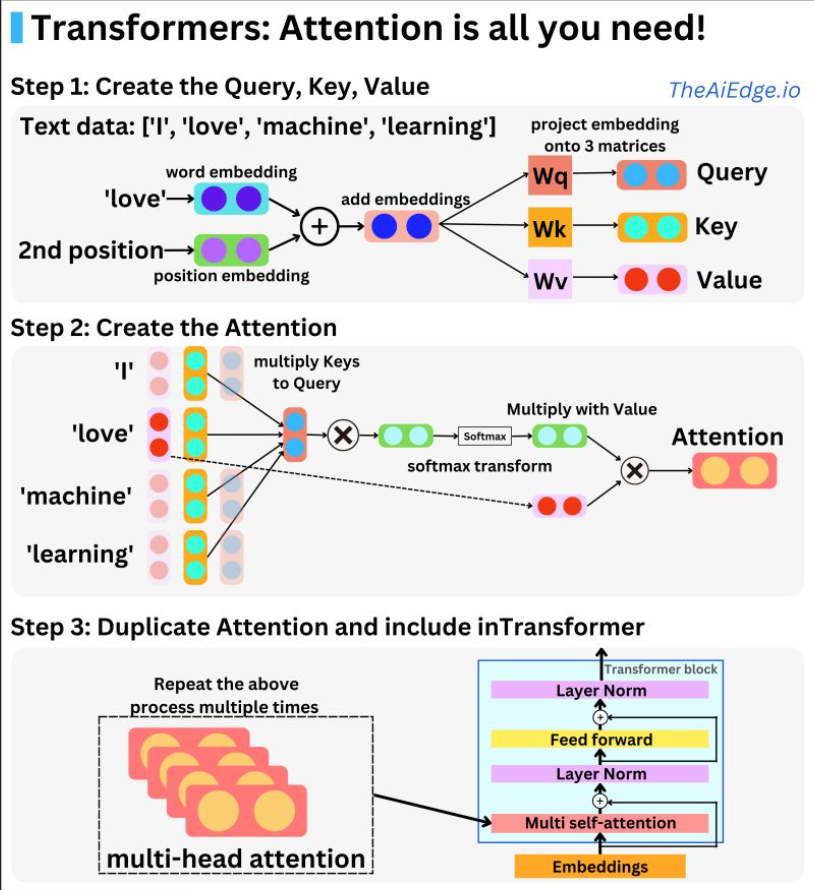

📊 **Nhận xét hình: Cơ chế Attention và KV Cache trong LLMs**

🧠 **1. Autoregressive decoding**
- Mỗi bước time-step chỉ sinh **1 token** mới dựa trên tất cả token trước đó.
- **Kiến trúc Decoder-only** được dùng trong GPT, LLaMA, Falcon...

<br><br>
🚫 **2. Masked (Causal) Self-Attention**
- Đảm bảo **token hiện tại không thể nhìn vào tương lai** → duy trì tính autoregressive.
- Dùng **mask** (che đi) các attention về phía phải.

⏩ VD: Token `"cool"` chỉ được chú ý `"LLMs, are"`, không thể nhìn `"."`

<br><br>
🧮 **3. Normal Self-Attention**
- Ở mỗi bước, tính attention với toàn bộ token trước đó → rất **tốn thời gian và bộ nhớ**.
- Phải tính lại **Query, Key, Value** từ đầu.

<br><br>
⚡ **4. Self-Attention với KV Cache**
- **Key & Value được lưu lại (cache)** từ bước trước → **không cần tính lại**.
- Mỗi token mới chỉ cần tính **Query** và truy xuất KV cache.
- Giảm **độ trễ (latency)** đáng kể khi **sinh văn bản (inference)**.

<br><br>

> 📌 **KV Cache là kỹ thuật quan trọng giúp LLM tạo text cực nhanh khi inference.**

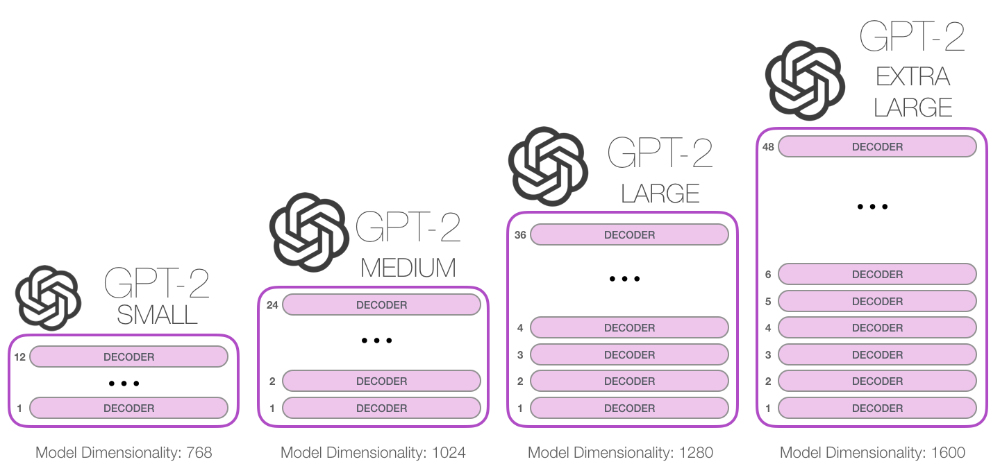

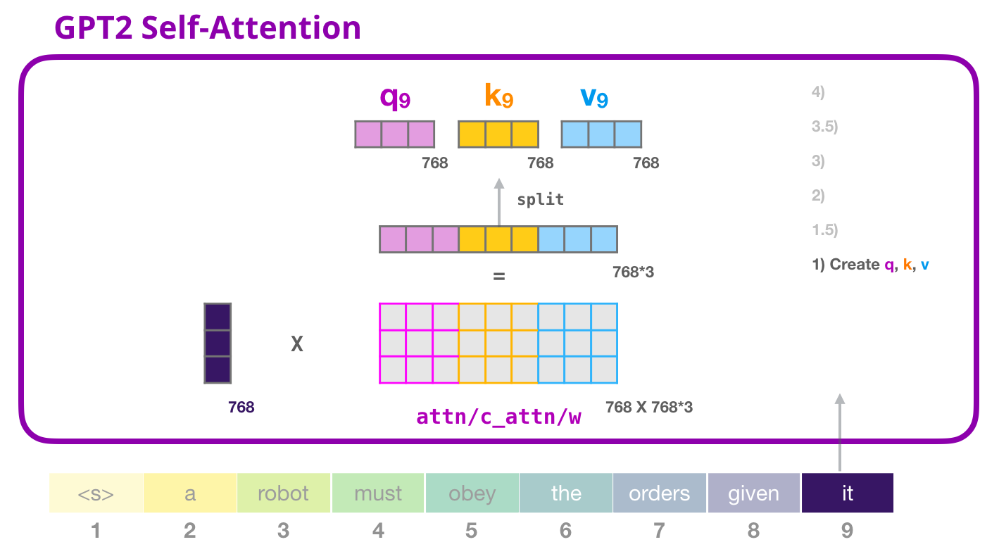

**Bước 1: Tạo Query, Key, Value**

<br>
* Mỗi từ (ví dụ: "it") sẽ được đưa qua một lớp (block) Transformer.

* Input ban đầu là embedding của từ cộng với vị trí (positional encoding).
→ Ví dụ: "it" ở **vị trí thứ 9** sẽ có vector là: embedding("it") + pos_encoding(9)

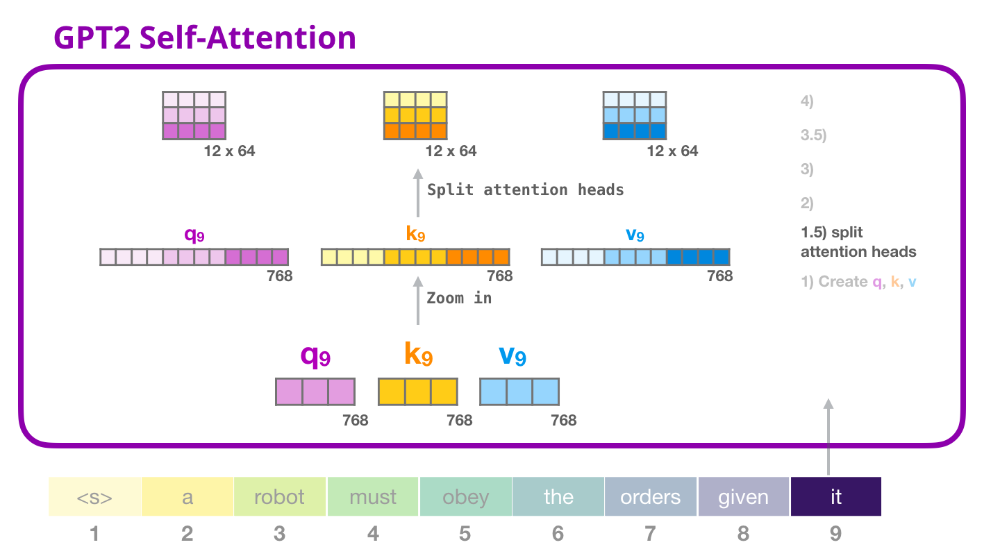

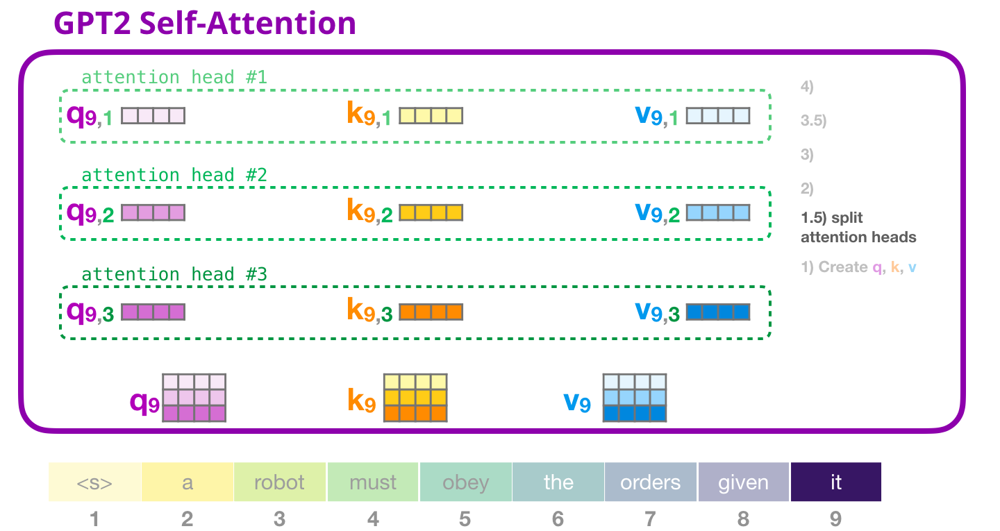

**Bước 1.5: Multi-Head Attention – Chia đầu Attention**

<br>
* GPT-2 không chỉ dùng 1 attention mà dùng nhiều attention head (vd: 12 đầu ở GPT-2 nhỏ).

* Mỗi attention head là một bản sao độc lập của attention, học thông tin khác nhau.

**Cách hoạt động:**<br>
* Q, K, V được chia nhỏ (split) thành nhiều phần → mỗi phần đi vào một attention head riêng biệt.

* Mỗi head xử lý độc lập → sau đó gộp lại (concat).

🎯 Giúp mô hình học được nhiều kiểu quan hệ giữa các từ hơn (ngữ pháp, nghĩa, thứ tự,...).

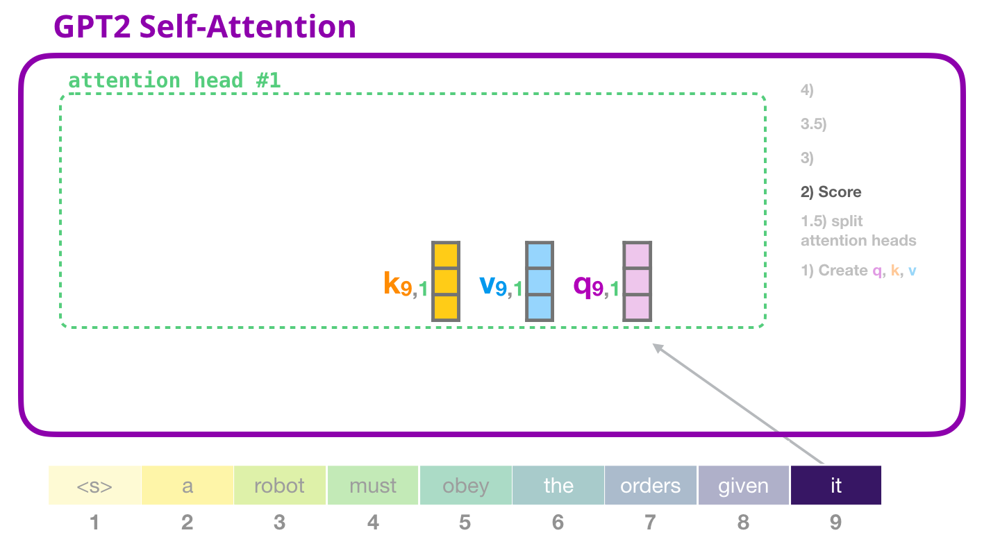

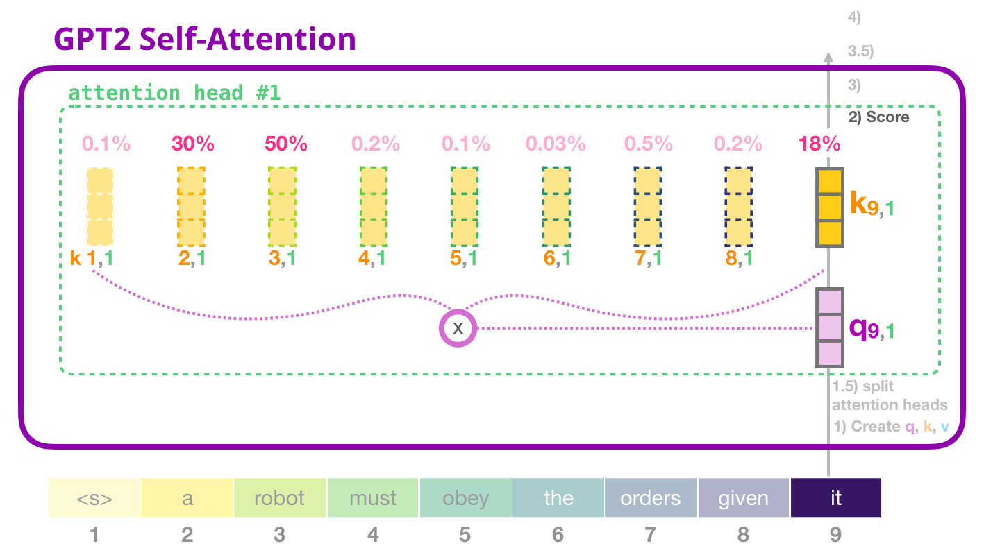

**Bước 2: Tính điểm (Scoring Attention)**<br>

Trong từng head, GPT-2 tính mức độ liên kết giữa từ "it" và tất cả các từ khác trong câu.

Cụ thể:
$$
𝑠
𝑐
𝑜
𝑟
𝑒
=
𝑄
𝑖
𝑡
⋅
𝐾
𝑗
𝑇
score=Q
i
​
 t⋅K
j
T
​
$$
→ Tính toán độ tương đồng giữa Query của "it" và Key của mỗi token j.

Sau đó, ta chuẩn hóa điểm này bằng softmax để tạo phân phối xác suất.

💡 Token nào liên quan hơn đến "it" sẽ có điểm cao hơn → attention sẽ "chú ý" hơn vào đó.

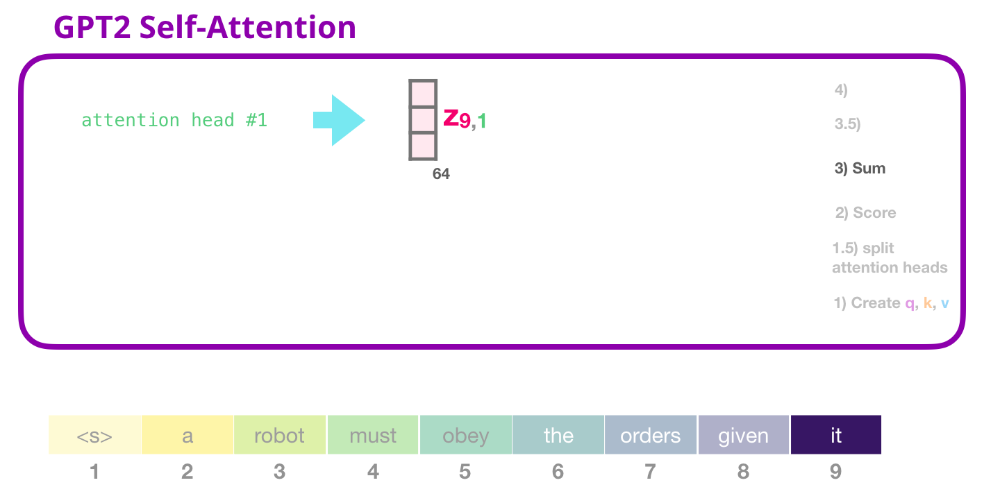

**Bước 3: Tính kết quả Attention**<br>
Mỗi token sẽ dùng điểm attention vừa tính để trộn (weighted sum) các vector Value của các token khác:

$$
𝑜
𝑢
𝑡
𝑝
𝑢
𝑡
=
Σ
(
𝑠
𝑐
𝑜
𝑟
𝑒
𝑗
×
𝑉
𝑎
𝑙
𝑢
𝑒
𝑗
)
output=Σ(score
j
​
 ×Value
j
​
 )
 $$
Kết quả là một vector "tổng hợp" thông tin từ các từ liên quan đến "it".

✨ Đây là output của một attention head.

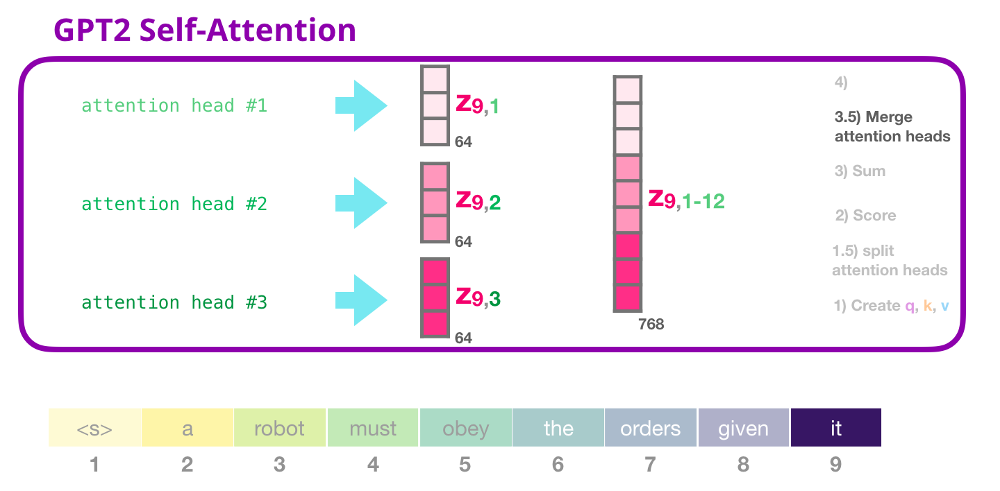

**Bước 3.5: Gộp các Attention Head**<br>
Từ 12 head → ta nối các output lại với nhau (concatenate):


```
[head1_output | head2_output | ... | head12_output]

```
Tuy nhiên, vector này vẫn chưa dùng được ngay.



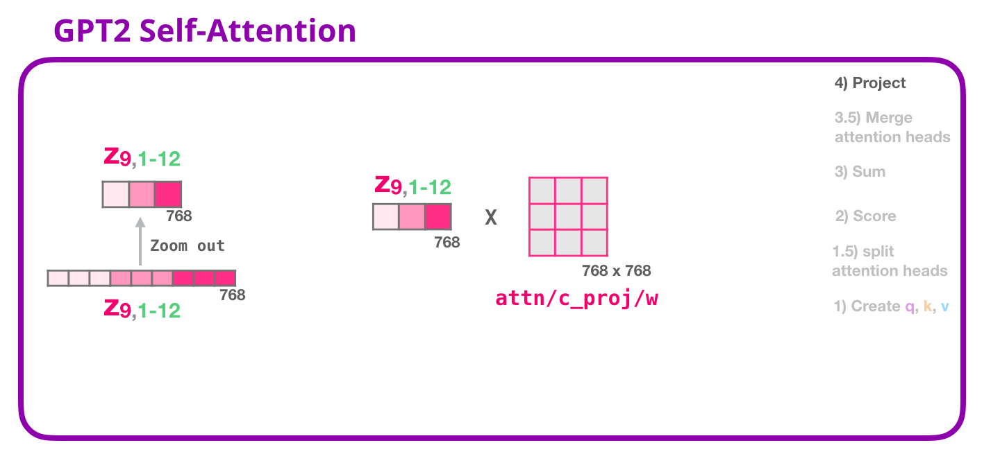

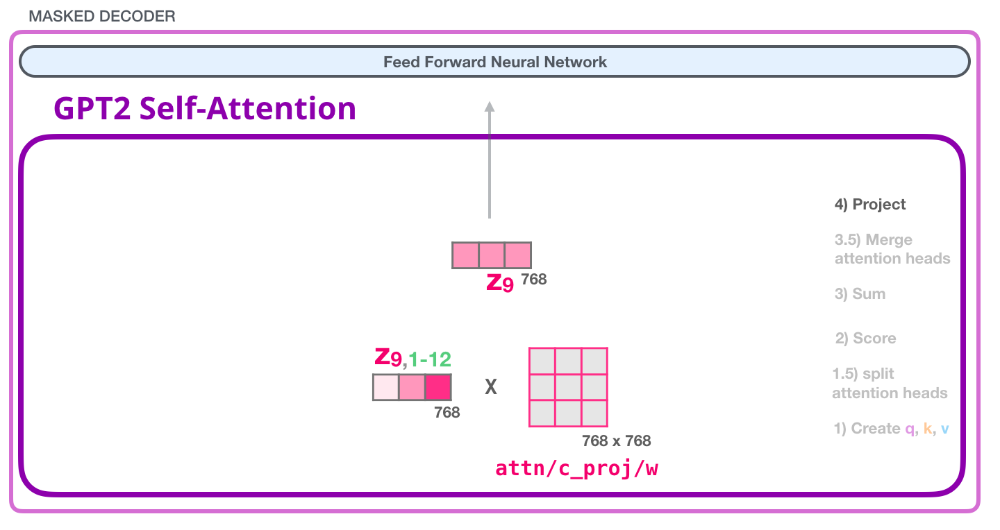

**Bước 4: Chiếu lại (Projecting)**<br>
* Mô hình sử dụng ma trận trọng số thứ 2 để chiếu (project) vector tổng hợp về lại đúng chiều đầu ra chuẩn.

* Như vậy, ta có output cuối cùng của khối Self-Attention, sẵn sàng đưa qua lớp tiếp theo trong Transformer.



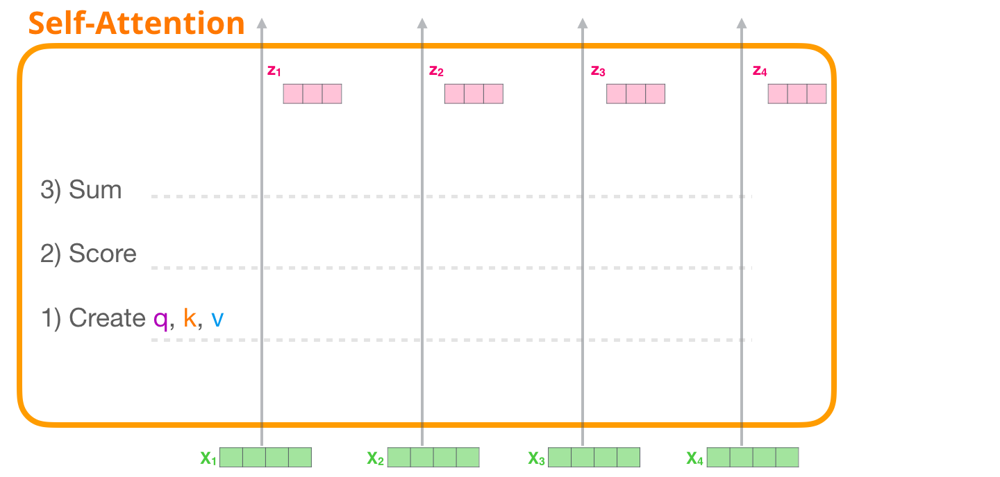

In [ ]:
class SelfAttention(nn.Module):
    def __init__(self, d_model):
        super().__init__()
        self.qkv = nn.Linear(d_model, d_model * 3)
        self.d_model = d_model

    def forward(self, x):
        q, k, v = self.qkv(x).chunk(3, dim=-1)
        att = (q @ k.transpose(-2, -1)) / math.sqrt(self.d_model)
        att = F.softmax(att, dim=-1)
        out = att @ v
        return out, att

### 2/ Multi-Query Attention (MQA)

* **Nguồn gốc**: Paper "Multi-Query Attention with Global Key-Value Memory for Fast Inference" - Google Research (2022)

* **Tác giả**: Yi Tay, Mostafa Dehghani, Zhen Qin, Dara Bahri, Donald Metzler, et al.

* 📄 **Paper**: https://arxiv.org/abs/1911.02150


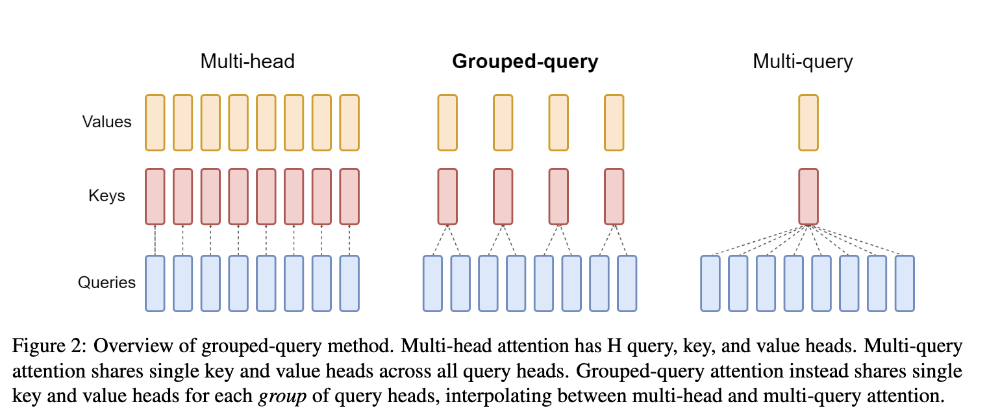

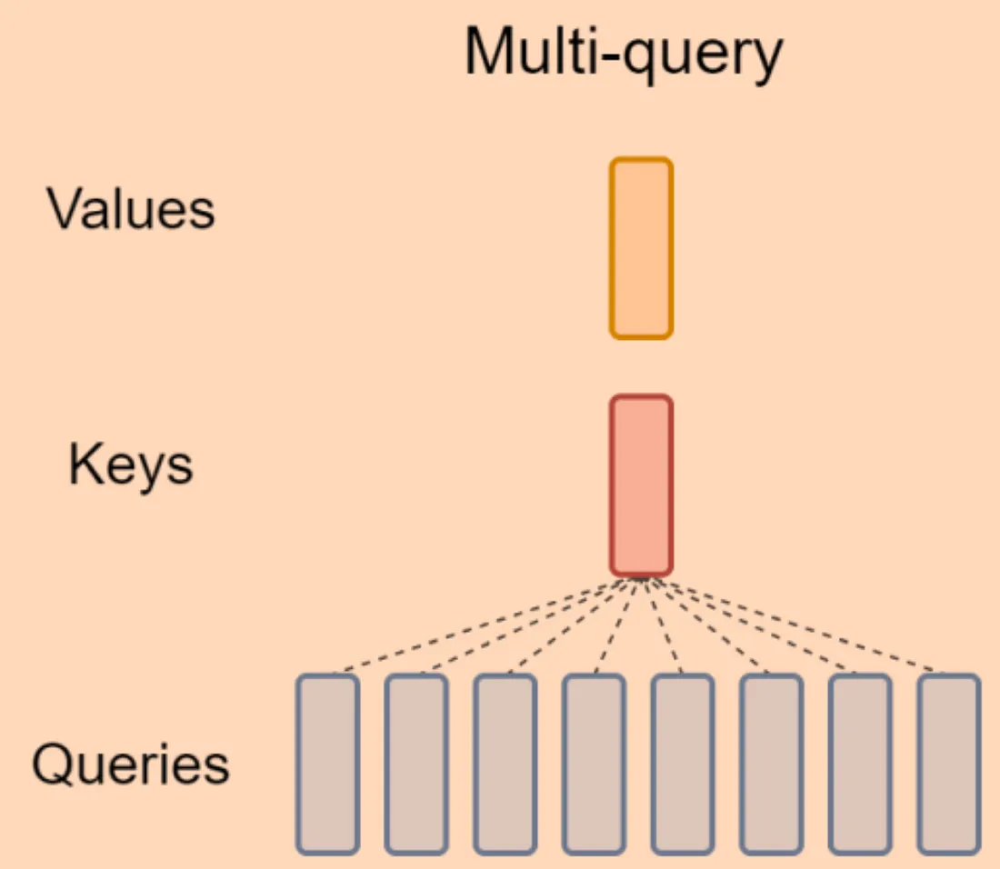

🧠 **Ý tưởng chính**

- Trong Self-Attention tiêu chuẩn: mỗi **head** có một cặp **Q, K, V** riêng
- Điều này khiến số lượng tham số tăng nhanh khi số head lớn

📌 **MQA** đề xuất:
- Chia sẻ **Key và Value** giữa tất cả các head
- Mỗi head vẫn có **Query riêng**
- → Tức là: **nhiều Query**, nhưng chỉ **1 cặp Key–Value**

✅ Giảm chi phí tính toán, bộ nhớ mà vẫn giữ độ chính xác cao


⚙️ **Cơ chế hoạt động**

- Input: chuỗi có độ dài n → sinh ra Qᵢ (cho từng head), nhưng chỉ dùng 1 K, 1 V
- Tính attention từng head theo công thức:
$$
    Attention(Qᵢ, K, V) = softmax(Qᵢ · Kᵗ / √d) · V
$$
- Sau đó concat kết quả các head như bình thường

🧠 Khác biệt chính: **K và V dùng chung**


✅ **Ưu điểm**
- Giảm lượng RAM sử dụng (Key/Value giảm từ h×n×d → n×d)
- Giảm độ phức tạp khi sinh token → tăng tốc độ inference
- Giữ độ chính xác tương đương Multi-Head Attention trong nhiều bài toán

⚠️ **Hạn chế**
- Có thể giảm độ linh hoạt do K/V bị chia sẻ
- Với một số bài toán phức tạp, hiệu suất có thể thấp hơn full multi-head


🔁 **So sánh với Multi-Head Attention (MHA)**

| Khía cạnh        | Multi-Head Attention | Multi-Query Attention |
|------------------|----------------------|------------------------|
| Query            | Riêng từng head      | Riêng từng head        |
| Key / Value      | Riêng từng head      | Dùng chung toàn bộ     |
| RAM              | Nhiều                | Ít hơn                 |
| Tốc độ           | Chậm hơn             | Nhanh hơn              |
| Độ chính xác     | Cao                  | Gần tương đương        |


🤖 **Ứng dụng thực tế**

- Được sử dụng trong các mô hình sinh văn bản lớn như:
  - PaLM, LLaMA v2, Falcon, Mistral, GPT-NeoX...

🎯 Mục tiêu chính: **Tăng tốc inference** khi số token hoặc số head lớn

- Với context dài (32K token), MQA giúp giảm memory footprint đáng kể


In [ ]:
class MultiQueryAttention(nn.Module):
    def __init__(self, d_model, num_heads):
        super(MultiQueryAttention, self).__init__()
        assert d_model % num_heads == 0, "d_model must be divisible by num_heads"

        self.d_model = d_model
        self.num_heads = num_heads
        self.d_k = d_model // num_heads

        self.W_q = nn.Linear(d_model, d_model)
        self.W_k = nn.Linear(d_model, self.d_k)
        self.W_v = nn.Linear(d_model, self.d_k)

        self.out_proj = nn.Linear(d_model, d_model)

    def forward(self, Q, K=None, V=None, mask=None):
        K = Q if K is None else K
        V = Q if V is None else V
        B, T, _ = Q.size()

        Q = self.W_q(Q).view(B, T, self.num_heads, self.d_k).transpose(1, 2)
        K = self.W_k(K).unsqueeze(1)
        V = self.W_v(V).unsqueeze(1)

        scores = torch.matmul(Q, K.transpose(-2, -1)) / math.sqrt(self.d_k)
        if mask is not None:
            scores = scores.masked_fill(mask == 0, float('-inf'))

        attn_weights = F.softmax(scores, dim=-1)
        attn_output = torch.matmul(attn_weights, V)

        attn_output = attn_output.transpose(1, 2).contiguous().view(B, T, self.d_model)
        out = self.out_proj(attn_output)

        return out, attn_weights



1.   Linear Projections: biến đổi input Q thành (1, 16, 32), biến đổi K, V thành (1, 16, 8)
2.   Chỉ chia head cho Query: Q = Q.view(1, 16, 4, 8).transpose(1, 2)  # (1,4,16,8) - 4 head. Key/Value giữ nguyên 1 head
3.   Scaled Dot-Product Attention:
    - Tính scores = torch.matmul(Q, K.transpose(-2, -1)) / math.sqrt(8). Softmax
    - Áp dụng softmax để được attention weights
    - Nhân weights với V để được output (1,4,16,8)
4.   Combine heads: Gộp 4 head lại -> shape (1,16,32)



### 3/ Grouped-Query Attention (GQA)


* **Nguồn gốc**: Google Research, mở rộng từ MQA

* 📄 Paper: Không có riêng, nhưng mô tả trong các mô hình như PaLM, LLaMA 2, Falcon


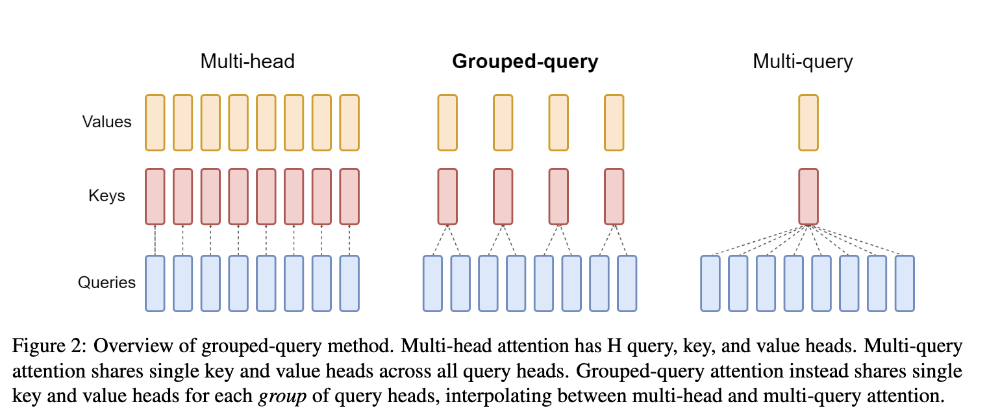

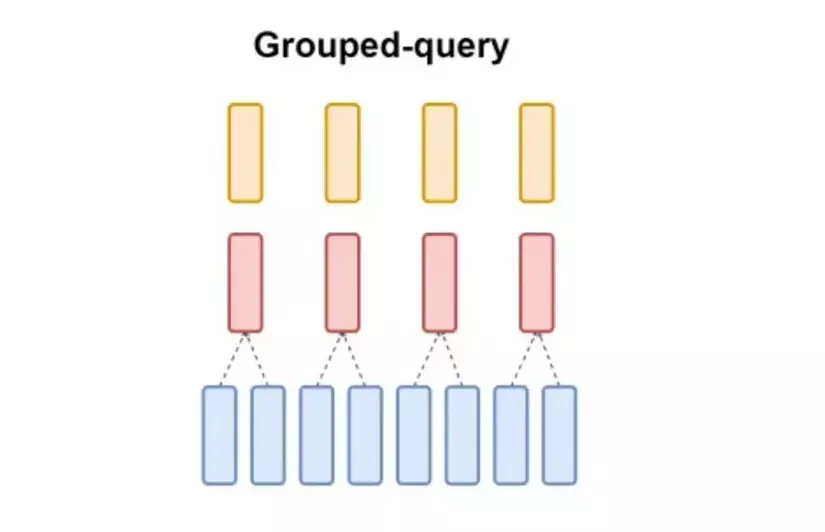

🧠 **Ý tưởng chính**

- Trung gian giữa MHA và MQA
- Mỗi nhóm head chia sẻ **Key và Value**
- Ví dụ: 8 head → chia thành 4 group → mỗi group dùng chung 1 K/V

🎯 Tăng tốc inference nhưng vẫn giữ được sự đa dạng hơn MQA


⚙️ **Cơ chế hoạt động**

- Giả sử n_heads = 8, n_groups = 4
- Mỗi 2 head cùng một nhóm sẽ dùng chung K, V
- Nhưng mỗi head vẫn có Q riêng

- Tính toán:
$$
    Attention(Qᵢ, K_g(i), V_g(i)) = softmax(Qᵢ · Kᵗ / √d) · V
$$
→ Trong đó g(i) là group của head i


**🔑 Cốt lõi GQA**

- **Grouped Queries**: Các head Query được chia thành `G` nhóm, mỗi nhóm dùng chung K, V.
- **Shared KV**: Mỗi nhóm có một bộ K, V riêng, giảm số lượng phép tính so với MHA.
- **Linh hoạt**: Với `G = 1`, GQA trở thành MQA; `G = h`, GQA tương đương MHA.


**🧮 Độ phức tạp & Ưu điểm**

- **Bộ nhớ GPU giảm**: Ít phép chiếu KV hơn → giảm lưu trữ & truyền tải.
- **Tăng tốc suy luận**: Dùng ít KV projection hơn → tăng throughput.
- **Đào tạo linh hoạt**: Có thể fine-tune từ mô hình MHA → GQA.
- **Hiệu suất gần MHA, tốc độ gần MQA** → trade-off tối ưu.


**🚫 Nhược điểm**

- **Giảm tính phân biệt**: Ít KV hơn → giảm khả năng mô hình hóa chi tiết.
- **Cần chọn số nhóm G hợp lý**: G quá ít → giống MQA, G quá nhiều → giống MHA.


**🧠 Ứng dụng thực tế trong LLMs**

- **Dài ngữ cảnh (128K tokens)**: GPT-4, Claude sử dụng GQA để tiết kiệm bộ nhớ.
- **Suy luận nhanh (Fast Decoding)**: Tăng tốc chatbot, inference real-time.
- **Fine-tune mô hình lớn**: Giảm tải khi huấn luyện trên phần cứng giới hạn.
- **Hệ thống phục vụ lớn**: GQA giúp vLLM, FasterTransformer phục vụ nhiều request hiệu quả hơn.
- **MoE + GQA**: Giao từng group Query cho expert khác nhau → định tuyến hiệu quả.


📊 **So sánh các Attention**

| Cơ chế     | Query     | Key/Value | RAM     | Tốc độ | Linh hoạt |
|------------|-----------|-----------|---------|--------|-----------|
| MHA        | riêng     | riêng     | cao     | chậm   | cao       |
| GQA        | riêng     | chia theo group | vừa | vừa    | vừa       |
| MQA        | riêng     | dùng chung| thấp    | nhanh  | thấp hơn  |


In [ ]:
class GroupQueryAttention(nn.Module):
    def __init__(self, d_model, num_heads, num_kv_groups):
        super(GroupQueryAttention, self).__init__()
        assert d_model % num_heads == 0
        assert num_heads % num_kv_groups == 0

        self.d_model = d_model
        self.num_heads = num_heads
        self.num_kv_groups = num_kv_groups
        self.d_k = d_model // num_heads
        self.group_size = num_heads // num_kv_groups

        self.W_q = nn.Linear(d_model, d_model)
        self.W_k = nn.Linear(d_model, self.d_k * num_kv_groups)
        self.W_v = nn.Linear(d_model, self.d_k * num_kv_groups)

        self.W_o = nn.Linear(d_model, d_model)

    def forward(self, Q, K=None, V=None, mask=None):
        K = Q if K is None else K
        V = Q if V is None else V
        batch_size, seq_len, _ = Q.size()

        Q = self.W_q(Q).view(batch_size, seq_len, self.num_heads, self.d_k).transpose(1, 2)
        K = self.W_k(K).view(batch_size, seq_len, self.num_kv_groups, self.d_k).transpose(1, 2)
        V = self.W_v(V).view(batch_size, seq_len, self.num_kv_groups, self.d_k).transpose(1, 2)

        K = K.repeat_interleave(self.group_size, dim=1)
        V = V.repeat_interleave(self.group_size, dim=1)

        attn_scores = torch.matmul(Q, K.transpose(-2, -1)) / math.sqrt(self.d_k)
        if mask is not None:
            attn_scores = attn_scores.masked_fill(mask == 0, -1e9)

        attn_probs = F.softmax(attn_scores, dim=-1)
        attn_output = torch.matmul(attn_probs, V)

        attn_output = attn_output.transpose(1, 2).contiguous().view(batch_size, seq_len, self.d_model)
        return self.W_o(attn_output), attn_probs



1.   Linear Projections: biến đổi input Q thành (1, 16, 32), biến đổi K, V thành (1, 16, 8 * num_kv_groups)
2.   Split heads: Chia Q,K,V thành nhiều head để tập trung khía cạnh khác nhau, chia Q thành num_heads, K/V thành num_kv_groups nhóm (mỗi nhóm phục vụ nhiều head Q)
3.   Scaled dot-product attention:
      - Tính scores = torch.matmul(Q, K.transpose(-2, -1)) / math.sqrt(8). Softmax
      - Áp dụng softmax để được attention weights
      - Nhân weights với V để được output (1,4,16,8)
4.   Combine heads: Gộp 4 head lại -> shape (1,16,32)



### 4/ FlashAttention hoặc FlashAttention v2

* **Phiên bản đầu**: "FlashAttention: Fast and Memory-Efficient Exact Attention with IO-Awareness" (2022) - **Stanford University, Cornell University**

* **Tác giả**: Tri Dao, Daniel Y. Fu, Stefano Ermon, Atri Rudra, Christopher Ré

* 📄 **Paper**: https://arxiv.org/abs/2205.14135

* **Phiên bản mới (v2**): "FlashAttention-2: Faster Attention with Better Parallelism and Work Partitioning" (2023)

* **Tác giả**: Tri Dao

* 📄 **Paper**: https://arxiv.org/abs/2307.08691

🚀 **2. FlashAttention v2 — Lý thuyết chuyên sâu**


<br>
🧠 **Ý tưởng chính**
- Self-Attention gốc rất tốn **RAM và thời gian** do phải tính toàn bộ ma trận attention kích thước **n × n**.
- Với chuỗi dài, điều này cực kỳ **chậm và tốn GPU**.

📌 FlashAttention v2 giải quyết bằng cách:
- Tính attention theo **block nhỏ** (block-wise), **trực tiếp trên GPU**
- **Không cần lưu toàn bộ ma trận QKᵀ** vào bộ nhớ  
- Dùng kỹ thuật CUDA hiệu quả để giảm truyền dữ liệu và đọc/ghi thừa

<br><br>

⚙️ **Cơ chế hoạt động**

- **Chia sequence thành nhiều block nhỏ**
- Tính attention từng khối theo dạng **streaming**
  - Chỉ giữ phần cần thiết tại mỗi thời điểm
  - Không cần lưu toàn bộ QKᵀ như self-attention gốc
- Lập trình CUDA thông minh:
  - Giảm truy cập bộ nhớ không cần thiết
  - Giữ lại độ chính xác gốc nhưng chạy nhanh hơn nhiều

<br><br>

🧪 **Ví dụ trực quan**
- Giả sử có **10,000 token** trong chuỗi:
  - 🧠 **Self-Attention gốc** → cần tính 10,000 × 10,000 = **100 triệu phần tử** → tốn RAM 😵  
  - ⚡ **FlashAttention v2** → tính **block-by-block**, giữ rất ít trong RAM tại mỗi thời điểm 😌

<br><br>

⏱️ **Độ phức tạp tính toán**

| Loại                  | Self-Attention gốc | FlashAttention v2 |
|-----------------------|-------------------|--------------------|
| Thời gian             | O(n²)             | O(n²)              |
| Bộ nhớ tạm            | O(n²)             | O(n)               |

- ⚠️ Mặc dù độ phức tạp **lý thuyết giống nhau**, nhưng FlashAttention v2 nhanh hơn rõ rệt nhờ **tối ưu GPU**

<br><br>

✅ **Ưu điểm**
- **Nhanh hơn 2–4×** so với attention gốc  
- **Tiết kiệm GPU RAM** → train được batch lớn hơn hoặc chuỗi dài hơn  
- **Kết quả đầu ra không đổi** → hoàn toàn tương thích với GPT, LLaMA, BERT...

<br><br>

⚠️ **Hạn chế**
- Yêu cầu **GPU hỗ trợ CUDA tốt** (NVIDIA A100, V100, L40, H100…)
- Cần dùng đúng thư viện: `xformers`, `flash-attn`, HuggingFace hỗ trợ gần đây
- Không áp dụng được cho attention dạng đặc biệt như BigBird, Sparse Attention

<br><br>

🔁 **So sánh với Self-Attention gốc**

| Khía cạnh         | Self-Attention (gốc) | FlashAttention v2      |
|-------------------|----------------------|-------------------------|
| Độ chính xác      | ✅                  | ✅ (giống nhau)         |
| RAM tạm thời      | O(n²)               | O(n) (giảm mạnh)        |
| Tốc độ thực thi   | Trung bình          | 🚀 Rất nhanh            |
| Dễ áp dụng        | Tích hợp sẵn        | Cần thư viện ngoài      |
| Ứng dụng LLM      | GPT-2/3/4, BERT     | LLaMA v2, Mistral, Falcon, GPT-NeoX |

<br><br>

🤖 **Ứng dụng trong LLMs**
- Được dùng trong nhiều LLM hiện đại:
  - ✅ **LLaMA v2, Mistral, GPT-NeoX, MosaicML, Falcon**
- Giúp tăng **context length** từ 2K → **32K tokens** mà vẫn giữ tốc độ inference nhanh

<br><br>

📌 **Tóm tắt nhanh**

| Thành phần         | FlashAttention v2                                 |
|--------------------|----------------------------------------------------|
| Ý tưởng            | Attention block-wise để giảm RAM và tăng tốc độ   |
| Ưu điểm            | Rất nhanh, tiết kiệm RAM, giữ nguyên kết quả      |
| Nhược điểm         | Cần thư viện ngoài, không áp dụng với Sparse      |
| Trong LLMs         | LLaMA v2, Falcon, Mistral, GPT-NeoX,...            |

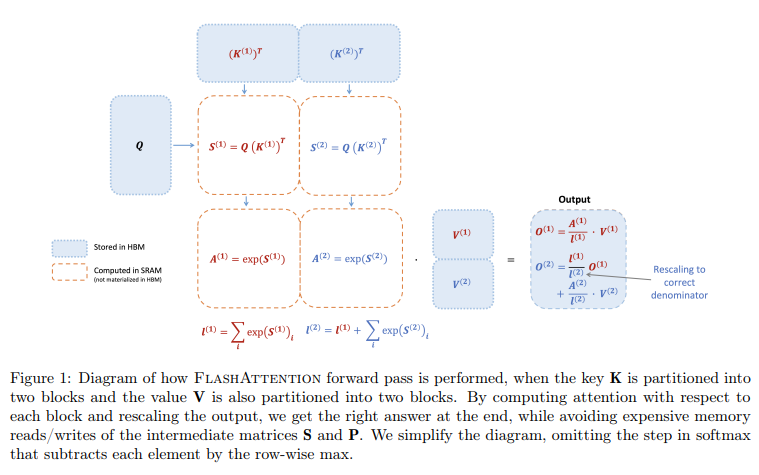

Thay vì tính toàn bộ attention một lần, FlashAttention sẽ:

* Chia ma trận Key (K) và Value (V) thành các khối nhỏ (blocks) – ví dụ: 2 blocks.

* Tính attention giữa mỗi block của K và toàn bộ Q từng chút một (blockwise).

* Tổng hợp kết quả lại (có bước chuẩn hóa - rescale) để cho ra đúng kết quả cuối cùng giống như tính toàn cục.

**Lợi ích**
* Tận dụng tốt cache/GPU
* Giảm số lần đọc/ghi bộ nhớ với các ma trận lớn

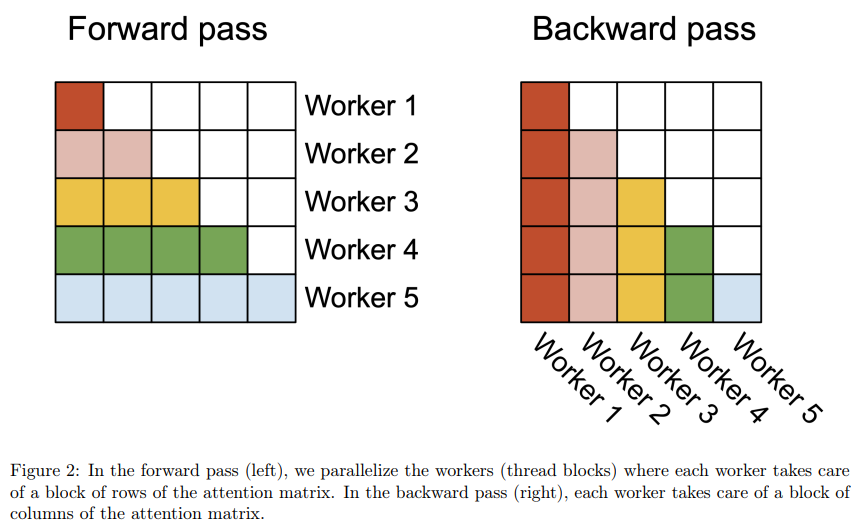

**1. Forward Pass (bên trái hình)**<br>
📌 Mô tả:

* Trong quá trình tính Attention (tức là softmax(QKᵀ)V), ta cần tính nhiều dòng (rows) trong ma trận attention.

* FlashAttention chia các dòng này thành các khối nhỏ, và mỗi "worker" (luồng xử lý – thường là thread block của GPU) sẽ xử lý một khối dòng.

🧠 Tưởng tượng thế này:

* Giống như bạn có một bảng điểm lớn với nhiều học sinh (hàng).

* Bạn chia học sinh thành từng nhóm (mỗi block), và mỗi nhóm có một người tính điểm riêng (một worker).

Các worker làm việc song song → nhanh hơn rất nhiều. **Tăng tốc tính Attention**

<br><br>
**🔁 2. Backward Pass (bên phải hình)**<br>
📌 Mô tả:

* Khi tính gradient trong quá trình huấn luyện (backpropagation), ta cần đạo hàm theo Q, K, V.

* Lúc này, thay vì xử lý dòng (row), mỗi **worker sẽ xử lý** một khối cột (columns) của ma trận attention.

🧠 Tưởng tượng tương tự:

* Khi muốn phân tích điểm từng môn (mỗi cột là một môn), bạn chia các môn cho từng người chấm.

* Mỗi worker sẽ phân tích theo cột → tổng hợp lại toàn bộ **gradient** cho mô hình. **Tăng tốc tính Gradient**



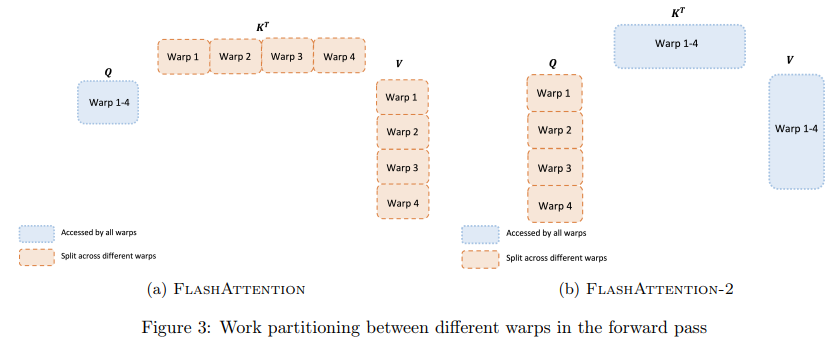

**Warp là gì?**<br>
* Trong GPU (đặc biệt là NVIDIA), một warp là một nhóm gồm **32 luồng** (threads) chạy song song.

* Đây là **đơn vị thực thi cơ bản** nhất trên GPU.

Khi bạn chạy nhiều phép tính trên **GPU, CUDA** sẽ chia thành nhiều warp để xử lý song song cực nhanh.

<br>
* Tối ưu sử dụng GPU cực kỳ sâu – đến tận mức **warp-level parallelism**.

* Tránh **thắt cổ chai (bottleneck)** do việc truy cập bộ nhớ và tính toán dồn vào một nơi.

In [ ]:
class FlashAttention(nn.Module):
    def __init__(self, d_model):
        super().__init__()
        self.qkv = nn.Linear(d_model, d_model * 3)

    def forward(self, x):
        q, k, v = self.qkv(x).chunk(3, dim=-1)
        out = F.scaled_dot_product_attention(q, k, v, is_causal=False)
        att = q @ k.transpose(-2, -1) / math.sqrt(q.shape[-1])
        att = F.softmax(att, dim=-1)
        return out, att

### 5/ Linear Attention

* **Tiêu biểu**: "Transformers are RNNs: Fast Autoregressive Transformers with Linear Attention" (2020) - **Idiap Research Institute, EPFL (École Polytechnique Fédérale de Lausanne)** - Switzerland

* **Tác giả**: Katharopoulos, A., Vyas, A., Pappas, N., Fleuret, F.

* 📄 **Paper**: https://arxiv.org/abs/2006.16236

📏 **3. Linear Attention — Lý thuyết chuyên sâu**

<br>
🧠 **Ý tưởng chính**
- Self-Attention gốc có độ phức tạp **O(n²)** vì phải tính tất cả cặp \( QK^T \)
- Khi chuỗi dài (n lớn) → rất chậm và tốn bộ nhớ

✨ **Linear Attention** khắc phục bằng cách:
- **Biến đổi công thức attention** để giảm độ phức tạp còn **O(n)**  
- Thay vì dùng softmax(QKᵀ), ta sử dụng một **hàm ánh xạ tuyến tính φ(x)** để làm đơn giản phép tính

<br><br>

⚙️ **Cơ chế hoạt động**

- Công thức attention gốc:

$$
\text{Attention}(Q, K, V) = \text{softmax}(QK^T) \cdot V
$$

- Linear Attention biến đổi thành:

$$
\text{LinearAttn}(Q, K, V) = \phi(Q) \cdot \left( \phi(K)^T \cdot V \right)
$$

- Trong đó:
  - $$ \phi(.) $$: là hàm ánh xạ đơn giản (ví dụ: `elu + 1`, `relu`, `exp`,...)
  - $$ \phi(Q) \in \mathbb{R}^{n \times d}, \phi(K) \in \mathbb{R}^{n \times d} $$
  - Tính $$ \phi(K)^T \cdot V $$ **một lần duy nhất**, sau đó nhân với $$ \phi(Q) $$

<br><br>

✅ **Lợi ích**
- Tách được tính toán thành 2 phần:
  - $$\phi(K)^T \cdot V$$ tính trước, giảm chi phí
  - $$ \phi(Q) \cdot (...) $$: chỉ cần O(n) phép nhân
- Rất hiệu quả cho chuỗi dài

<br><br>

⏱️ **Độ phức tạp tính toán**

| Thành phần         | Self-Attention gốc   | Linear Attention     |
|--------------------|----------------------|----------------------|
| Thời gian          | O(n² · d)            | O(n · d²)            |
| Bộ nhớ tạm         | O(n²)                | O(n)                 |

> Với n lớn, sự khác biệt là **rất đáng kể** về tốc độ và bộ nhớ

<br><br>

📌 **Ví dụ minh họa**
- Có đoạn văn 10,000 token:
  - **Self-Attention**: 10k × 10k = 100 triệu phép tính 😵‍💫  
  - **Linear Attention**: chỉ cần xử lý tuyến tính theo n → nhẹ hơn rất nhiều 😌

<br><br>

✅ **Ưu điểm**
- **Rất nhanh** và tiết kiệm bộ nhớ với sequence dài
- **Thích hợp cho context dài** (như BigBird, Longformer)
- **Dễ tích hợp** vào nhiều kiến trúc hiện tại

⚠️ **Hạn chế**
- Không chính xác tuyệt đối như attention gốc
- Kết quả phụ thuộc nhiều vào lựa chọn $$\phi(x)$$
- Không tương thích hoàn toàn với mọi mô hình

<br><br>

🔁 **So sánh với Self-Attention**

| Khía cạnh            | Self-Attention gốc | Linear Attention           |
|----------------------|--------------------|-----------------------------|
| Độ chính xác         | Cao                | Gần đúng (approximate)     |
| RAM sử dụng          | Rất cao (O(n²))    | Thấp (O(n))                |
| Tốc độ               | Chậm nếu n lớn     | Nhanh với chuỗi dài        |
| Khả năng song song   | Có                 | Có                         |
| Tính toàn cục        | Có                 | Có (approximate)           |

<br><br>

🤖 **Ứng dụng trong LLMs**
- 🧪 **Performer** (Google): Mô hình đầu tiên áp dụng Linear Attention  
- **Linformer**: Giảm chiều không gian attention  
- Một số phiên bản **Reformer**, **Synthesizer** cũng dùng dạng tương tự

<br><br>

📌 **Tóm tắt nhanh**

| Thành phần         | Linear Attention                              |
|--------------------|-----------------------------------------------|
| Ý tưởng            | Biến đổi hàm attention bằng phép ánh xạ φ     |
| Ưu điểm            | Nhanh, tiết kiệm RAM với chuỗi dài            |
| Nhược điểm         | Gần đúng, không chính xác như bản gốc         |
| So với gốc         | Nhanh hơn, trade-off độ chính xác nhẹ         |
| Ứng dụng           | Performer, Linformer, Reformer, Synthesizer   |

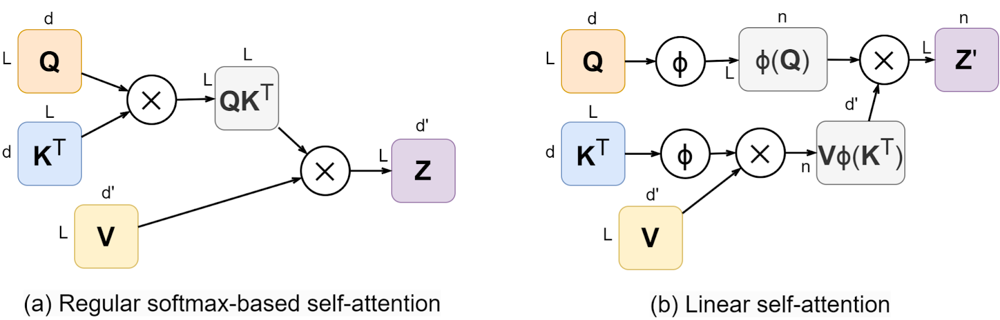

**🔍 Linear Attention là gì?**

- Giải pháp giúp **tăng tốc Attention** bằng cách **tránh tính \( QK^T \)** toàn bộ.
- Đổi thứ tự tính toán:
$$
  \text{Attention}(Q, K, V) \approx Q \cdot (\phi(K)^T \cdot V)
$$
- Độ phức tạp giảm từ **O(N²)** → **O(N)** 🏎️  
- Giảm tiêu tốn **RAM và thời gian** ✅


<br>
**🍋 Ví dụ dễ hiểu – Rót nước chanh**

- **Attention thường**: Pha nước riêng cho từng bạn → chậm ⏱️  
- **Linear Attention**:  
  - Pha **một bình lớn** từ đầu (K·V) 🧃  
  - Sau đó chỉ cần rót theo **gu của từng bạn** (Q) → **nhanh, gọn**


<br>
**✅ Tóm tắt so sánh:**

| | Attention thường | Linear Attention |
|--|------------------|------------------|
| ⚙️ Độ phức tạp | O(N²) | O(N) |
| 💾 Bộ nhớ | Cao | Thấp |
| ⚡ Tốc độ | Chậm với chuỗi dài | Nhanh hơn nhiều |
| 🎯 Ý tưởng chính | Tính từng cặp từ | Tính một lần, dùng lại |


In [ ]:
class LinearAttention(nn.Module):
    def __init__(self, d_model):
        super().__init__()
        self.qkv = nn.Linear(d_model, d_model * 3)
        self.activation = nn.ReLU()

    def forward(self, x):
        q, k, v = self.qkv(x).chunk(3, dim=-1)
        q = self.activation(q)
        k = self.activation(k)
        kv = k.transpose(-2, -1) @ v
        z = 1 / (q @ k.transpose(-2, -1)).sum(dim=-1, keepdim=True)
        out = (q @ kv) * z
        approx_att = q @ k.transpose(-2, -1)
        return out, approx_att

### 6/ Sparse Attention


* **Nguồn gốc**: Xuất hiện trong nhiều mô hình như Sparse Transformer (OpenAI), Longformer, BigBird, Reformers,...

* 📄 Paper OpenAI: https://arxiv.org/abs/1904.10509


📌 **Giới thiệu**

Sparse Attention là một kỹ thuật giúp giảm độ phức tạp tính toán của Attention từ O(n²) xuống gần O(n), bằng cách **giới hạn số lượng cặp token được tính attention** theo một **mẫu sparsity nhất định**.

Thay vì tính attention cho mọi cặp token, Sparse Attention **chỉ chọn lọc các kết nối quan trọng**: kế cận, toàn cục, ngẫu nhiên,...

⚙️ Công thức:

SparseAttention
$$(Q, K, V) = softmax((QKᵀ * M) / √dₖ) V
$$
Trong đó `M` là mặt nạ (mask) làm zero các vị trí không được phép attention.

Ứng dụng nhiều trong: Longformer, BigBird, Reformer, LED, Sparse Transformer,...


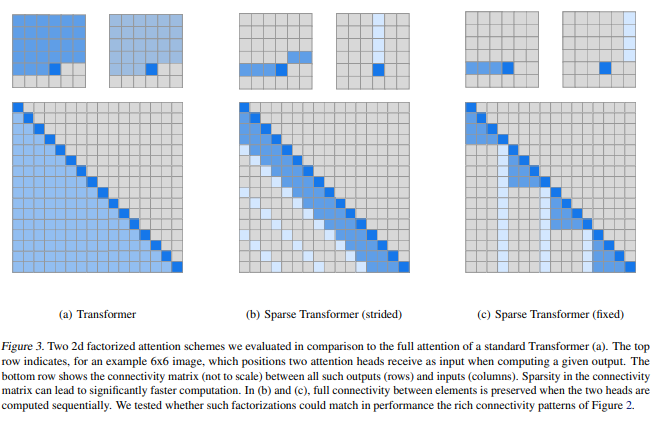

🎯 **Động lực**

Attention truyền thống có chi phí O(n²) ⇒ khó áp dụng cho chuỗi dài (e.g. 8K - 1M tokens)

Sparse Attention giúp:
- Tiết kiệm bộ nhớ và thời gian
- Mở rộng mô hình LLM cho dữ liệu dài
- Giữ lại các kết nối quan trọng nhất

🔍 **Các dạng chính**

1. **Local Attention**: mỗi token chỉ nhìn "láng giềng" gần (dùng trong CNN-like attention)
2. **Global Attention**: một số token được phép nhìn toàn bộ chuỗi (dùng cho CLS, câu hỏi,...)
3. **Random Attention**: kết nối ngẫu nhiên giúp bắt các mối liên hệ bất ngờ
4. **Block Sparse / Strided**: kết nối theo khối hoặc bước nhảy đều


🧠 **Ý tưởng chính**

- Không tính attention giữa **mọi cặp token** (như Full Attention)
- Thay vào đó: giới hạn tính toán trên **một số kết nối quan trọng**

📌 Ví dụ về cách sparse:
- **Fixed patterns**: local + stride + global
- **Learned patterns**: dynamic sparsity
- **Random** hoặc **block sparse**

🎯 Giảm chi phí từ O(n²) xuống còn O(n log n) hoặc O(n)


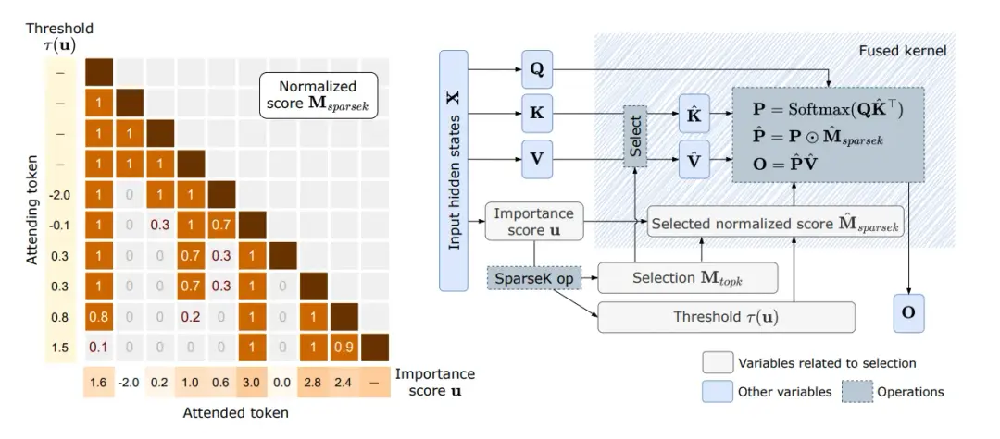

⚙️ **Cơ chế hoạt động: Longformer-style**

- Mỗi token chỉ attend đến:
  - Một số token cận kề (local window)
  - Một vài token đặc biệt (global token)
  - (Có thể thêm: random hoặc stride patterns)

🧮 Tổng chi phí: O(n · w) với w là kích thước cửa sổ


📈 **Tóm tắt Kỹ thuật Sparse Attention**

| Loại Attention    | Độ phức tạp | Chi tiết                                |
|-------------------|-------------|-----------------------------------------|
| Full (Self-Attn)  | O(n²)       | Mỗi token tính với mọi token            |
| Local             | O(n·w)      | Chỉ tính trong cửa sổ cận kề            |
| Global + Local    | O(n·w + g·n)| Một số token toàn cục                   |
| Random            | O(n·log n)  | Kết nối ngẫu nhiên                      |
| Block Sparse      | O(n√n)      | Chia token theo khối                    |

(*) n: chiều dài chuỗi, w: cửa sổ local, g: số token global


✅ **Ưu điểm**

- Giảm chi phí tính toán từ O(n²) → O(n√n) hoặc thấp hơn
- Cho phép xử lý chuỗi > 2K tokens (VD: văn bản pháp lý, y học, sách)
- Dễ giải thích (ít kết nối → dễ hiểu token đang tập trung vào đâu)
- Hiệu quả hơn trong học ngữ cảnh dài

⚠️ **Thách thức**

- Phải thiết kế pattern sparsity hợp lý
- Một số kết nối xa có thể bị bỏ lỡ
- Có thể làm chậm hội tụ trong quá trình huấn luyện
- Memory layout đôi khi vẫn không tối ưu trên GPU/TPU


🧪 **Ứng dụng thực tiễn trong LLMs**

1. **Xử lý văn bản dài**
- Cho phép mô hình làm việc với chuỗi 8K – 1M tokens
- Dùng trong: tóm tắt tài liệu, QA theo sách, tài liệu pháp lý, nghiên cứu khoa học
- Ví dụ: Longformer, BigBird, LED

2. **Huấn luyện hiệu quả**
- Giúp pretrain LLM trên tài liệu dài mà không tăng bộ nhớ
- Học được cấu trúc toàn cục tốt hơn

3. **Multimodal Transformers**
- Dùng với ảnh (nhiều patch), video (nhiều frame)
- Ứng dụng: CLIP mở rộng, video captioning

4. **LLM tăng cường bộ nhớ**
- Dễ gắn các token nhớ: RAG, context caching, kNN-LM

5. **Mô hình dạng modular / mixture-of-experts**
- Một phần mô hình được kích hoạt → dùng sparse routing


📊 **So sánh cơ bản giữa các loại Attention**

| Loại         | Complexity | Độ chính xác | Dễ triển khai | Ứng dụng chính                  |
|--------------|-------------|---------------|----------------|----------------------------------|
| Full (MHA)   | O(n²)       | cao           | dễ             | hầu hết các mô hình (GPT, BERT) |
| MQA          | O(n²)       | trung bình    | dễ             | LLaMA, Mistral                  |
| GQA          | O(n²)       | khá cao       | trung bình     | PaLM, Falcon                    |
| Sparse       | O(n·w)      | phụ thuộc w   | phức tạp hơn   | Longformer, BigBird             |


In [ ]:
class SparseMultiHeadAttention(nn.Module):
    def __init__(self, d_model, num_heads, window_size=1, stride=2):
        super(SparseMultiHeadAttention, self).__init__()
        assert d_model % num_heads == 0, "d_model must be divisible by num_heads"
        self.d_model = d_model
        self.num_heads = num_heads
        self.d_k = d_model // num_heads
        self.window_size = window_size
        self.stride = stride

        self.W_q = nn.Linear(d_model, d_model)
        self.W_k = nn.Linear(d_model, d_model)
        self.W_v = nn.Linear(d_model, d_model)
        self.W_o = nn.Linear(d_model, d_model)

    def forward(self, Q, K=None, V=None, mask=None):
        K = Q if K is None else K
        V = Q if V is None else V
        Q = self.split_heads(self.W_q(Q))
        K = self.split_heads(self.W_k(K))
        V = self.split_heads(self.W_v(V))

        attn_output, attn_probs = self.sparse_attention(Q, K, V)
        output = self.W_o(self.combine_heads(attn_output))
        return output, attn_probs

    def split_heads(self, x):
        batch_size, seq_len, d_model = x.size()
        x = x.view(batch_size, seq_len, self.num_heads, self.d_k)
        return x.transpose(1, 2)

    def combine_heads(self, x):
        batch_size, heads, seq_len, d_k = x.size()
        x = x.transpose(1, 2).contiguous()
        return x.view(batch_size, seq_len, self.d_model)

    def sparse_attention(self, Q, K, V):
        B, H, T, d_k = Q.size()
        scores = torch.matmul(Q, K.transpose(-2, -1)) / math.sqrt(d_k)

        mask = torch.zeros(T, T, dtype=torch.bool, device=Q.device)
        for i in range(T):
            for j in range(max(0, i - self.window_size), min(T, i + self.window_size + 1)):
                mask[i, j] = 1
            if i % self.stride == 0:
                mask[i, :] = 1

        mask = mask.unsqueeze(0).unsqueeze(0)
        scores = scores.masked_fill(~mask, -1e9)
        attn_probs = F.softmax(scores, dim=-1)
        output = torch.matmul(attn_probs, V)
        return output, attn_probs

Sparse Attention là cơ chế giảm độ phức tạp tính toán từ O(n²) xuống O(n) bằng cách:

1.   Linear projections: Biến input thành Q, K ,V
2.   Split head: tách thành 4 head độc lập có d_k = 8(d_model = 32, 32/4 = 8). Chia head cho Q. Chia head cho K và V -> Ghép nhóm K/V với các head Q
3.   Scaled dot-product attention:
      - Tính scores = torch.matmul(Q, K.transpose(-2, -1)) / math.sqrt(8). Softmax
      - Áp dụng sparse mask (zero-pad các vị trí không được attention)
      - Softmax chỉ tính trên các vị trí có mask=1, các vị trí khác thành -inf.
      - Nhân weights với V để được output (1,4,16,8)
4.    Ghép 4 head (mỗi head 8 chiều) → 32 chiều ban đầu.



### 7/ Rotary Positional Embedding (RoPE)

* **Xuất hiện lần đầu**: "RoFormer: Enhanced Transformer with Rotary Position Embedding" (2021) - **Tencent AI Lab, Zhuiyi Technology**

* **Tác giả**: Jianlin Su, Yu Lu, Shengfeng Pan, Bo Wen, Yunfeng Liu

* 📄 **Paper**: https://arxiv.org/abs/2104.09864

🌀 **5. RoPE — Rotary Positional Embedding**


<br>
🧠 **Ý tưởng chính**

- Self-Attention gốc **không có thông tin vị trí**, nên cần thêm positional encoding.
- **RoPE** không thêm vector vị trí như trước, mà **"quay" vector embedding** dựa vào vị trí token.
- Giúp mô hình học được **khoảng cách tương đối** giữa các token một cách **mượt mà**.


<br><br>
🔍 **So sánh với Positional Encoding gốc**

| Kiểu Encoding            | Cách làm                          | Ghi nhớ khoảng cách |
|--------------------------|-----------------------------------|----------------------|
| Absolute (tuyệt đối)     | Thêm vector vị trí vào embedding | ❌ Không tốt         |
| RoPE (tương đối)         | Quay vector theo vị trí           | ✅ Tốt hơn nhiều     |


<br><br>
⚙️ **Cơ chế hoạt động**

- Giả sử \( x \) là embedding vector của token.

- RoPE quay từng cặp giá trị trong \( x \) theo góc \( \theta_i \), phụ thuộc vào **vị trí** và **tần số**:

$$
\text{RoPE}(x_i) = \text{Rotate}(x_i, \theta_i)
$$

- Góc quay lớn dần theo vị trí → biểu diễn được khoảng cách tương đối giữa các token.


<br><br>
📌 **Áp dụng vào Attention**

- Áp dụng RoPE vào cả **Q và K** trước khi tính attention:

$$
\text{Attention}(Q, K, V) = \text{softmax} \left( \text{RoPE}(Q) \cdot \text{RoPE}(K)^T \right) \cdot V
$$

➡️ RoPE làm thay đổi góc giữa Q và K → mô hình học được quan hệ **tương đối** thay vì tuyệt đối.


<br><br>
🌀 **Ví dụ trực quan**

- Token `"em"` ở vị trí 3 → quay nhẹ
- Token `"yêu"` ở vị trí 7 → quay xa hơn

→ Khi tính attention, **góc lệch biểu thị khoảng cách vị trí**


<br><br>
⏱️ **Chi phí tính toán**

- Rất **nhẹ**, không thêm chiều, không thêm tham số
- Không cần embedding vị trí riêng


<br><br>
✅ **Ưu điểm**

- Không thêm tham số (**parameter-free**)
- Biểu diễn tốt khoảng cách tương đối
- Tương thích với attention dạng **sliding window**, **FlashAttention**, v.v.

⚠️ **Hạn chế**

- Không encode tốt vị trí **tuyệt đối**
- Với chuỗi quá dài cần **điều chỉnh tần số góc**

<br><br>
🔁 **So sánh với Positional Encoding cũ**

| Khía cạnh                  | PE tuyệt đối             | RoPE (quay tương đối)     |
|----------------------------|--------------------------|----------------------------|
| Encode vị trí              | Tuyệt đối                | Tương đối                  |
| Hiểu khoảng cách           | ❌ Kém                   | ✅ Rõ ràng                 |
| Thêm tham số?              | Có                       | ❌ Không                   |
| Phù hợp attention nào?     | Global                   | Tất cả (global + local)    |


<br><br>
🤖 **Ứng dụng trong LLMs**

- Dùng trong: **LLaMA**, **GPT-NeoX**, **GLM-130B**, **GPT-J**
- Đặc biệt quan trọng với mô hình có:
  - **Sliding window**
  - **Attention tối ưu** như FlashAttention
  - **Chuỗi rất dài**

<br><br>
📌 **Tóm tắt nhanh**

| Thành phần       | RoPE (Rotary Positional Embedding)               |
|------------------|--------------------------------------------------|
| Ý tưởng chính    | Quay vector embedding theo vị trí               |
| Ưu điểm          | Không thêm tham số, hiểu vị trí tương đối        |
| Nhược điểm       | Không encode tốt vị trí tuyệt đối                |
| So với gốc       | Hiệu quả hơn Sinusoidal, mượt hơn                |
| Ứng dụng chính   | LLaMA, GPT-J, GPT-NeoX, GLM, FlashAttention,...  |

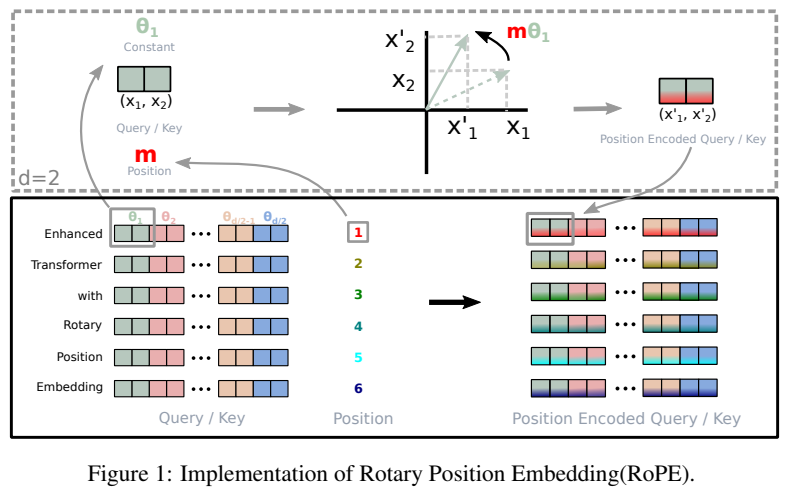

**🌀 RoPE – Gắn vị trí vào từ bằng cách xoay vector**

<br>
**🎯 Ý tưởng dễ hiểu**

- Trong câu, từ nào đứng trước – sau rất quan trọng.
- RoPE giúp mô hình **biết vị trí của mỗi từ** bằng cách **xoay các con số trong vector** tùy theo vị trí.


<br>
**🍭 Ví dụ cho trẻ em – Kẹo xoay**

> Hãy tưởng tượng mỗi từ là **một viên kẹo tròn có thể xoay**.
>
> - Tất cả viên kẹo **có cùng màu** (nội dung).
> - Nhưng RoPE xoay mỗi viên **một góc khác nhau**:
>   - Từ đầu tiên → xoay 0 độ  
>   - Từ thứ 2 → xoay 10 độ  
>   - Từ thứ 3 → xoay 20 độ  
>   - ...
>
> 👉 Nhờ đó, mô hình **phân biệt được vị trí từng từ trong câu!**


<br>
**🔁 Cách hoạt động**

1. Mỗi từ có 1 vector gồm nhiều cặp số:  
   $$
   (x_1, x_2), (x_3, x_4), \dots
   $$
2. RoPE **xoay từng cặp số** theo góc dựa trên vị trí từ:
   $$
   (x_1, x_2) \rightarrow (x_1', x_2') \text{ bằng phép xoay}
   $$
3. Vector sau khi xoay **vừa mang nội dung, vừa mang vị trí**.


<br>
**✅ Ưu điểm của RoPE**

| Ưu điểm | Giải thích |
|--------|------------|
| 🔧 Không cần thêm embedding vị trí | Nhẹ hơn |
| 📏 Biểu diễn khoảng cách tương đối tốt | Biết ai gần ai |
| ⚡ Gắn thẳng vào `Q`, `K` trong Attention | Tương thích, hiệu quả |


<br>
**📌 Tóm lại:**

> **RoPE = Xoay từng cặp số trong vector → Mỗi từ “nghiêng” một góc → Biết vị trí.**

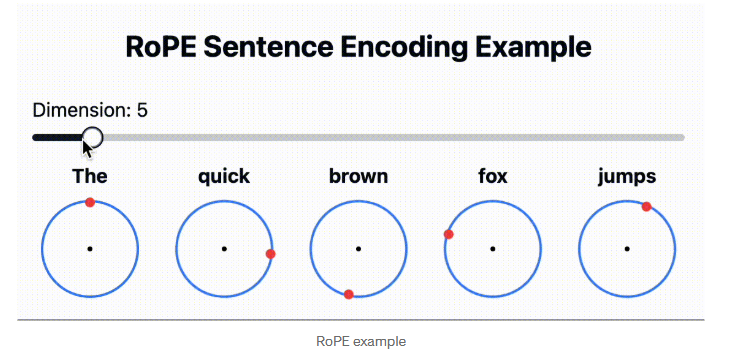

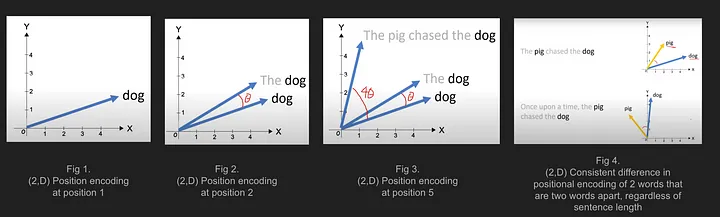

In [ ]:
# RoPE chỉ là hàm xử lý positional encoding, không phải attention riêng → không cần class riêng
# Nó thay đổi vị trí token thông qua hàm sin/cos nên có thể kết hợp với Self-Attention

def apply_rope(x):
    pos = torch.arange(x.size(1), device=x.device).unsqueeze(1)
    dim = torch.arange(0, x.size(-1), 2, device=x.device).float()
    freqs = pos / (10000 ** (dim / x.size(-1)))
    sin, cos = freqs.sin(), freqs.cos()
    x1, x2 = x[..., ::2], x[..., 1::2]
    x_rot = torch.cat([x1 * cos - x2 * sin, x1 * sin + x2 * cos], dim=-1)
    return x_rot

### 8/ BigBird

* **Nguồn gốc**: "Big Bird: Transformers for Longer Sequences" (2020) - **Google Research**

* **Tác giả**: Manzil Zaheer, Guru Guruganesh, Avinava Dubey, Joshua Ainslie, Chris Alberti, Santiago Ontanon, Philip Pham, Anirudh Ravula, Qifan Wang, Li Yang, Amr Ahmed

* 📄 **Paper**: https://arxiv.org/abs/2007.14062

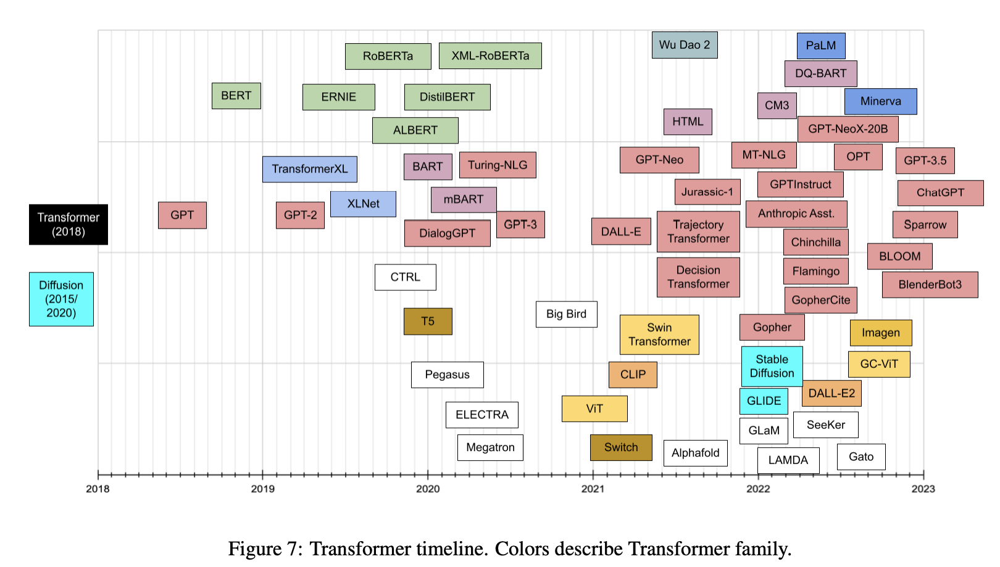

🪶 **4. BigBird — Attention hiệu quả cho chuỗi dài**

<br><br>
🧠 **Ý tưởng chính**

- Self-Attention truyền thống có độ phức tạp **O(n²)** → không khả thi cho **chuỗi rất dài** (n > 2,000)
- **BigBird** cải tiến bằng cách thay **attention đầy đủ** bằng **attention thưa (sparse attention)**:
  - Giảm độ phức tạp
  - Vẫn giữ được khả năng truyền thông tin toàn chuỗi

📌 Attention của BigBird = **Global + Sliding Window + Random**


<br><br>
🔗 **Cơ chế Sparse Attention**

| Kiểu Attention     | Ý nghĩa                                                                 |
|--------------------|-------------------------------------------------------------------------|
| Global Attention   | Một vài token đặc biệt (vd: [CLS]) thấy **toàn bộ chuỗi**              |
| Sliding Window     | Mỗi token thấy **token lân cận** trong 1 cửa sổ cố định                 |
| Random Attention   | Một số kết nối ngẫu nhiên → đảm bảo **kết nối toàn cục yếu**            |


<br><br>
📐 **Ví dụ minh họa (chuỗi 12 token)**

- Token 1 → nhìn thấy: `[1-3]` (window), `[7, 9]` (random), `[CLS]` (global)
- Token 6 → nhìn thấy: `[4-8]` (window), `[2, 11]` (random), `[CLS]` (global)

➡️ Không cần full attention, nhưng vẫn đảm bảo lan truyền đủ thông tin


<br><br>
⏱️ **Độ phức tạp tính toán**

- Từ **O(n²)** → chỉ còn **O(n)** hoặc **O(n√n)** (tùy config)
- Giảm mạnh **thời gian & bộ nhớ** so với attention đầy đủ


<br><br>
✅ **Ưu điểm**

- Xử lý **chuỗi rất dài** (hàng chục ngàn token)
- Hiệu quả **gần bằng full attention**
- Đã được chứng minh là **theoretically complete**
- Áp dụng tốt cho **QA, Tóm tắt, Genomics,...**

⚠️ **Hạn chế**

- Cần **chọn tham số kỹ lưỡng**: window size, số kết nối random, số token global
- Kết nối random → **khó debug**, khó tái lập hoàn toàn


<br><br>
🔁 **So sánh với Self-Attention**

| Khía cạnh                  | Self-Attention (gốc) | BigBird                              |
|----------------------------|----------------------|--------------------------------------|
| Complexity                 | O(n²)                | O(n) hoặc O(n√n)                     |
| Chuỗi dài                  | Không xử lý nổi      | ✅ Rất phù hợp                       |
| Truyền thông tin           | Trực tiếp toàn bộ    | Qua các kết nối sparse              |
| Ứng dụng chính             | GPT, BERT, T5        | Long-document NLP, BioBERT, QA      |


<br><br>
🤖 **Ứng dụng trong LLMs**

- **BigBird-RoBERTa**: training trên **chuỗi 4k–8k token**
- **LongForm QA**, **BioBERT cho Genomics**
- Mô hình tóm tắt, đọc paper dài, phân tích văn bản y học


<br><br>
📌 **Tóm tắt nhanh**

| Thành phần       | BigBird                                           |
|------------------|---------------------------------------------------|
| Ý tưởng          | Sparse Attention: Global + Window + Random       |
| Ưu điểm          | Mạnh mẽ với chuỗi dài, hiệu quả, dễ tích hợp      |
| Nhược điểm       | Kết nối không trực tiếp, khó debug                |
| So với gốc       | Hiệu quả gần bằng nhưng nhẹ hơn rất nhiều        |
| Ứng dụng chính   | NLP chuỗi dài, Paper QA, Search, BioNLP,...      |

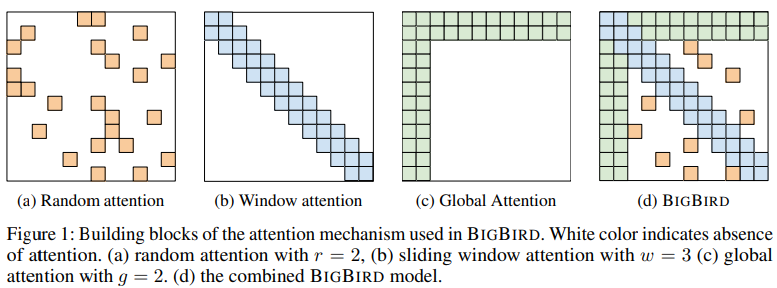

**🧠 BigBird Attention – Cách mô hình nhìn toàn bộ văn bản dài**

<br><br>
(a) 🎲 Random Attention – Kết nối ngẫu nhiên<br>
- Mỗi từ **chọn ngẫu nhiên vài từ khác để chú ý đến.**<br>
- ⏩ Giúp kết nối **từ xa bất ngờ** (ví dụ: từ đầu và cuối câu).<br>
> 👶 **Ví dụ**: Như bạn đang học và **nói chuyện ngẫu nhiên với 2 bạn trong lớp**.


<br><br>
(b) 🔁 Sliding Window Attention – Cửa sổ trượt  
- Mỗi từ chú ý đến **vài từ xung quanh nó**.  
- ⏳ Giữ thông tin **liên tiếp gần nhau**.  
> 👶 **Ví dụ**: Như khi bạn chỉ **nghe lời 2 bạn ngồi sát bên** mình.


<br><br>
(c) 🌐 Global Attention – Từ đặc biệt nhìn toàn bộ  
- Một số từ có thể **nhìn thấy tất cả các từ khác**, và ngược lại.  
- 📌 Dùng cho các từ đặc biệt như `[CLS]`.  
> 👶 **Ví dụ**: Như **cô giáo nhìn cả lớp**, và học sinh cũng nhìn thấy cô.


<br><br>
(d) 🧩 BigBird = (a) + (b) + (c)  
- **Kết hợp 3 loại attention**: gần, xa và toàn cục.  
- 💡 Nhẹ hơn Transformer nhưng vẫn đọc được văn bản dài hiệu quả.


<br><br>
✅ Tóm lại bằng 1 dòng:
> **BigBird chú ý gần, xa và toàn cục cùng lúc → đọc văn bản dài rất thông minh.**


<br><br>
🍬 Bảng tóm tắt:

| Loại Attention | Ý nghĩa ngắn gọn | Ví dụ cho trẻ em |
|----------------|------------------|------------------|
| 🎲 Random      | Kết nối từ xa     | Nói chuyện ngẫu nhiên |
| 🔁 Sliding     | Thông tin gần     | Nghe bạn bên cạnh |
| 🌐 Global      | Nhìn toàn cục     | Giáo viên nhìn cả lớp |
| 🧩 BigBird     | Kết hợp cả 3      | Học sinh thông minh 🤓 |

In [ ]:
class BigBirdAttention(nn.Module):
    def __init__(self, d_model, block_size=4, num_global_blocks=2, num_random_blocks=3, window_size_blocks=3):
        super().__init__()
        self.d_model = d_model
        self.block_size = block_size
        self.num_global_blocks = num_global_blocks
        self.num_random_blocks = num_random_blocks
        self.window_size_blocks = window_size_blocks
        self.qkv = nn.Linear(d_model, d_model * 3)

    def _get_block_indices(self, seq_len):
        num_blocks = (seq_len + self.block_size - 1) // self.block_size
        block_indices = torch.arange(num_blocks)
        global_blocks = block_indices[:self.num_global_blocks]
        return num_blocks, global_blocks

    def _get_random_attention(self, num_blocks, batch_size):
        rand_attn = []
        for _ in range(num_blocks):
            available_blocks = list(set(range(num_blocks)) - {_})
            if len(available_blocks) > self.num_random_blocks:
                rand_blocks = np.random.choice(available_blocks, self.num_random_blocks, replace=False)
            else:
                rand_blocks = available_blocks
            rand_attn.append(rand_blocks)
        rand_attn = torch.tensor(rand_attn, dtype=torch.long).unsqueeze(0).expand(batch_size, -1, -1)
        return rand_attn

    def _get_sliding_attention(self, num_blocks):
        sliding_attn = []
        half_window = self.window_size_blocks // 2
        for i in range(num_blocks):
            start = max(0, i - half_window)
            end = min(num_blocks, i + half_window + 1)
            sliding_blocks = list(range(start, end))
            sliding_attn.append(sliding_blocks)
        return sliding_attn

    def forward(self, x):
        batch_size, seq_len, d_model = x.shape
        num_blocks, global_blocks = self._get_block_indices(seq_len)

        padded_seq_len = num_blocks * self.block_size
        x_padded = F.pad(x, (0, 0, 0, padded_seq_len - seq_len))
        x_blocks = x_padded.view(batch_size, num_blocks, self.block_size, d_model)

        qkv = self.qkv(x_padded).view(batch_size, padded_seq_len, 3, d_model)
        q, k, v = qkv[:, :, 0], qkv[:, :, 1], qkv[:, :, 2]
        q = q.view(batch_size, num_blocks, self.block_size, d_model)
        k = k.view(batch_size, num_blocks, self.block_size, d_model)
        v = v.view(batch_size, num_blocks, self.block_size, d_model)

        output = torch.zeros_like(x_padded)
        att_scores = torch.zeros(batch_size, num_blocks, self.block_size, num_blocks, self.block_size)

        for g_block in global_blocks:
            q_g = q[:, g_block]
            scores = torch.einsum('bqd,bnkd->bqnk', q_g, k) / math.sqrt(d_model)
            scores = F.softmax(scores, dim=-1)
            out_g = torch.einsum('bqnk,bnkd->bqd', scores, v)
            output[:, g_block * self.block_size:(g_block + 1) * self.block_size] = out_g
            att_scores[:, g_block, :, :, :] = scores.view(batch_size, self.block_size, num_blocks, self.block_size)

            k_g = k[:, g_block]
            v_g = v[:, g_block]
            scores = torch.einsum('bnqd,bkd->bnqk', q, k_g) / math.sqrt(d_model)
            scores = F.softmax(scores, dim=-1)
            out_all = torch.einsum('bnqk,bkd->bnqd', scores, v_g)
            output += out_all.view(batch_size, padded_seq_len, d_model)

        sliding_attn = self._get_sliding_attention(num_blocks)
        for i in range(num_blocks):
            for j in sliding_attn[i]:
                q_i = q[:, i]
                k_j = k[:, j]
                v_j = v[:, j]
                scores = torch.einsum('bqd,bkd->bqk', q_i, k_j) / math.sqrt(d_model)
                scores = F.softmax(scores, dim=-1)
                out_ij = torch.einsum('bqk,bkd->bqd', scores, v_j)
                output[:, i * self.block_size:(i + 1) * self.block_size] += out_ij
                att_scores[:, i, :, j, :] = scores

        rand_attn = self._get_random_attention(num_blocks, batch_size)
        for i in range(num_blocks):
            for j in rand_attn[0, i]:  # Lặp qua từng chỉ số trong j_idx
                q_i = q[:, i]
                k_j = k[:, j]
                v_j = v[:, j]
                scores = torch.einsum('bqd,bkd->bqk', q_i, k_j) / math.sqrt(d_model)
                scores = F.softmax(scores, dim=-1)
                out_ij = torch.einsum('bqk,bkd->bqd', scores, v_j)
                output[:, i * self.block_size:(i + 1) * self.block_size] += out_ij
                att_scores[:, i, :, j, :] = scores

        output = output[:, :seq_len, :]
        att_scores = att_scores.view(batch_size, padded_seq_len, padded_seq_len)
        att_scores = att_scores[:, :seq_len, :seq_len]

        return output, att_scores

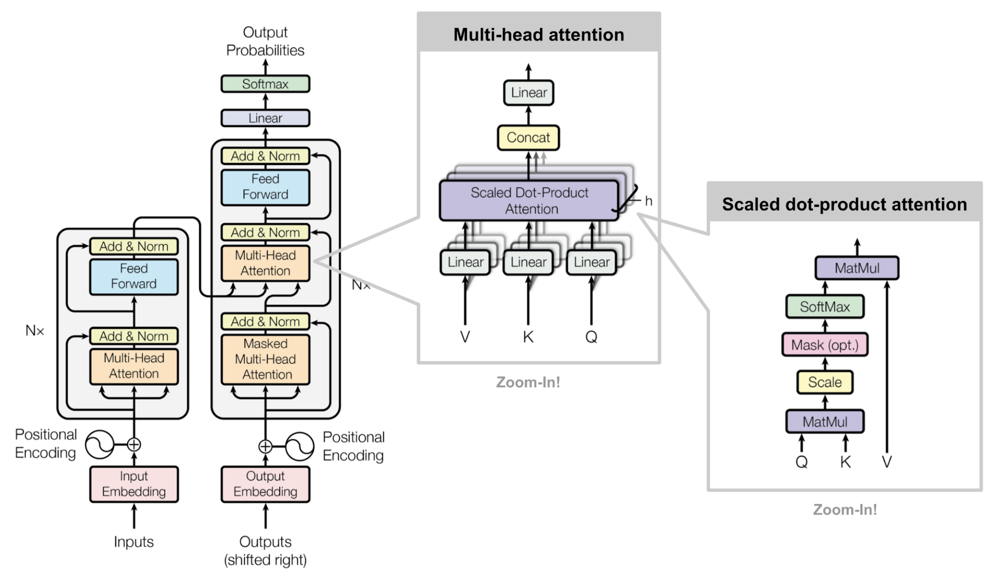

**“Attention is All You Need”** – Google Brain, 2017  
🔗 [https://arxiv.org/abs/1706.03762](https://arxiv.org/abs/1706.03762)


<br>
**⚙️ Cơ chế hoạt động Transformer gốc**

💡 Ý tưởng:
> Mỗi từ trong câu **"nhìn" tất cả từ khác** để quyết định nên chú ý từ nào nhiều hơn.

🧠 Self-Attention là gì?
- Tạo 3 vector: `Query`, `Key`, `Value` cho từng từ.
- Tính mức độ liên quan (score) giữa từ này với các từ khác.
- Dùng softmax để chuẩn hóa.
- Kết hợp lại để tạo ra vector mới cho từ đó.

🧒 **Ví dụ**:  
Trong lớp học, mỗi bạn **nghe tất cả bạn khác** rồi **tự rút ra thông tin tổng hợp**.


<br>
**📈 So sánh các Attention mới với bản gốc**

| 🔁 Loại | 🔧 Khác gì Transformer gốc | ⚡ Ưu điểm | 🧒 Ví dụ dễ hiểu |
|--------|----------------------------|-----------|------------------|
| **Self-Attention** | Mỗi từ nhìn mọi từ (O(n²)) | Chuẩn xác | Nghe tất cả bạn trong lớp |
| **FlashAttention** | Tính nhanh hơn bằng cách giảm ghi/đọc RAM | Tiết kiệm bộ nhớ, tốc độ cao | Ghi chú cực nhanh với app thông minh |
| **Linear Attention** | Biến attention từ O(n²) → O(n) | Nhẹ, nhanh | Nghe nhóm gần mình, không cần nghe hết |
| **RoPE** | Xoay vector để mã hóa vị trí | Không cần thêm embedding vị trí | Mỗi bạn nghiêng đầu khác nhau để nhớ vị trí |
| **BigBird** | Kết hợp attention gần, xa, và tổng quát | Dùng cho văn bản rất dài | Nghe bạn gần, cô giáo, và vài bạn xa |

<br>
📌 **Tóm lại**:
> **Transformer gốc** thì mạnh nhưng nặng, các bản mới thì **nhanh hơn, nhẹ hơn**, và phù hợp với **chuỗi dài**.


### 9/ Multi-Head Attention (MHA)


* **Nguồn gốc**: Paper "Attention is All You Need" – Vaswani et al. (2017)

* 📄 **Paper**: https://arxiv.org/abs/1706.03762


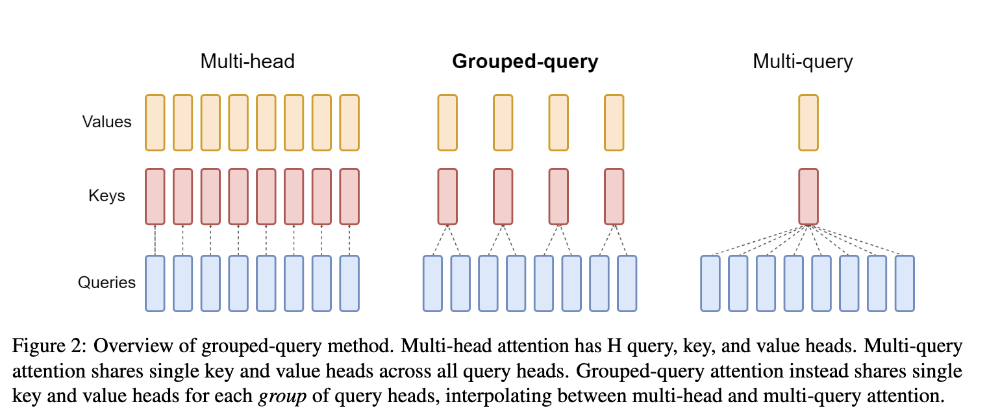

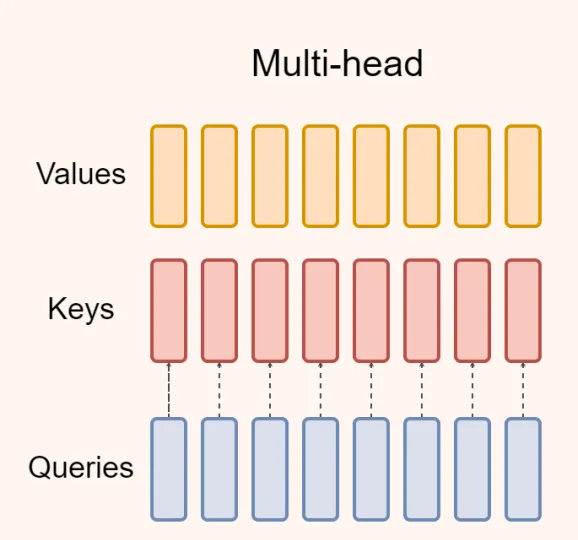

MHA mở rộng cơ chế attention bằng cách sử dụng **nhiều đầu attention song song** (gọi là "head"). Mỗi đầu thực hiện attention độc lập với trọng số riêng và tập trung vào một kiểu quan hệ cụ thể trong chuỗi đầu vào.


🧠 **Ý tưởng chính**

- Tách input thành nhiều "đầu" (head) song song
- Mỗi head học một không gian biểu diễn khác nhau
- Mỗi head có bộ Q, K, V **riêng biệt**
- Kết quả từ các head sẽ được **concat + linear**

🎯 Mục tiêu: học nhiều loại attention patterns trong cùng một lớp


⚙️ **Cơ chế hoạt động**

- Input → tạo n_head cặp Q, K, V
- Tính attention từng head:
$$
    Attention(Qᵢ, Kᵢ, Vᵢ) = softmax(Qᵢ · Kᵢᵗ / √d) · Vᵢ
$$
- Concat lại:


```
[head₁; head₂; …; headₙ] → Linear → Output
```




**Ứng dụng của MHA trong LLMs**

- **Xử lý văn bản dài**: Mỗi head học được thông tin dài-ngắn hạn → hỗ trợ tốt cho văn bản pháp lý, kỹ thuật
- **Mô hình đa ngôn ngữ**: Phân chia head cho từng ngôn ngữ giúp tăng hiệu quả
- **Mô hình đa mô thức**: Trong CLIP, BLIP,... các head học liên kết giữa text và ảnh/video
- **Mô hình module hóa**: Kết hợp MHA với Sparse routing (e.g. Mixture of Experts)


**Tóm tắt**

| Khía cạnh | Mô tả |
|-----------|-------|
| Cơ chế | Nhiều attention head chạy song song |
| Mục tiêu | Học các mối quan hệ khác nhau trong dữ liệu |
| Ưu điểm | Học được quan hệ đa chiều, dễ fine-tune, khái quát tốt |
| Nhược điểm | Ngốn băng thông bộ nhớ, đặc biệt khi decoding |
| Ứng dụng | NLP, mã nguồn, xử lý văn bản dài, ảnh-văn bản, mô hình đa mô thức |

In [ ]:
class MultiHeadAttention(nn.Module):
    def __init__(self, d_model, num_heads):
        super(MultiHeadAttention, self).__init__()
        assert d_model % num_heads == 0, "d_model must be divisible by num_heads"
        self.d_model = d_model
        self.num_heads = num_heads
        self.d_k = d_model // num_heads

        self.W_q = nn.Linear(d_model, d_model)
        self.W_k = nn.Linear(d_model, d_model)
        self.W_v = nn.Linear(d_model, d_model)
        self.W_o = nn.Linear(d_model, d_model)

    def forward(self, Q, K=None, V=None, mask=None):
        K = Q if K is None else K
        V = Q if V is None else V
        Q = self.split_heads(self.W_q(Q))
        K = self.split_heads(self.W_k(K))
        V = self.split_heads(self.W_v(V))

        attn_output, attn_probs = self.scaled_dot_product_attention(Q, K, V, mask)
        output = self.W_o(self.combine_heads(attn_output))
        return output, attn_probs

    def split_heads(self, x):
        batch_size, seq_len, d_model = x.size()
        x = x.view(batch_size, seq_len, self.num_heads, self.d_k)
        return x.transpose(1, 2)

    def combine_heads(self, x):
        batch_size, num_heads, seq_len, d_k = x.size()
        x = x.transpose(1, 2).contiguous()
        return x.view(batch_size, seq_len, self.d_model)

    def scaled_dot_product_attention(self, Q, K, V, mask=None):
        attn_scores = torch.matmul(Q, K.transpose(-2, -1)) / math.sqrt(self.d_k)
        if mask is not None:
            attn_scores = attn_scores.masked_fill(mask == 0, -1e9)
        attn_probs = F.softmax(attn_scores, dim=-1)
        output = torch.matmul(attn_probs, V)
        return output, attn_probs



1.   Linear Projections: biến đổi input thành Q, K, V với shape (1, 16, 32)
2.   Split heads: Chia Q, K, V thành 4 head (num_heads = 4), với mỗi head có d_k = 32/4 = 8. Shape lúc này: (1, 4, 16, 8) - (batch, num_heads, seq_len, d_k)
3.   Scaled dot-product attention:
    - Tính attention scores: Q * K^T / SQRT(d_k) -> shape(1,4,16,16)
    - Áp dụng softmax để được attention weights
    - Nhân weights với V để được output (1,4,16,8)
4.   Combine heads: Gộp 4 head lại -> shape (1,16,32)



### Demo for Attentions

In [ ]:
sentence = '''
User ID 48293 purchased 3 items on April 10th.
Total cost was $45.67 with delivery expected in 2 days.
'''

In [ ]:
tokens = sentence.split()
vocab = {word: i for i, word in enumerate(set(tokens))}
vocab_inv = {i: word for word, i in vocab.items()}

# Hyperparameters
embedding_dim = 32
vocab_size = len(vocab)

# For MQA, GQA, MHA
num_heads = 4
num_kv_groups = 2

# For Sparse Attention
window_size = 3
stride = 2

# For BigBird Attention
block_size = 4
num_global_blocks = 2
num_random_blocks = 3
window_size_blocks = 3

# Embedding layer
embedding = nn.Embedding(vocab_size, embedding_dim)
input_ids = torch.tensor([[vocab[token] for token in tokens]])
x = embedding(input_ids)

In [ ]:
vocab_inv

{0: 'on',
 1: 'delivery',
 2: '48293',
 3: '2',
 4: 'with',
 5: 'days.',
 6: '$45.67',
 7: 'User',
 8: 'in',
 9: '3',
 10: 'April',
 11: '10th.',
 12: 'was',
 13: 'expected',
 14: 'purchased',
 15: 'ID',
 16: 'items',
 17: 'Total',
 18: 'cost'}

In [ ]:
embedding

Embedding(19, 32)

In [ ]:
input_ids

tensor([[ 7, 15,  2, 14,  9, 16,  0, 10, 11, 17, 18, 12,  6,  4,  1, 13,  8,  3,
          5]])

In [ ]:
x

tensor([[[-4.2359e-01, -5.4296e-01, -6.6206e-01,  1.2107e+00,  5.1045e-01,
           1.7085e-01, -1.4949e+00,  4.9947e-01, -2.3720e-01, -1.6522e-01,
          -6.8979e-01, -1.2946e+00,  1.8725e+00,  5.7806e-01, -9.0116e-01,
          -7.6770e-01, -3.9681e-02,  7.7493e-01, -1.7073e-01, -8.8869e-01,
           9.5734e-01,  8.7022e-01,  5.0646e-01,  9.6100e-01, -1.2097e-01,
           2.6848e+00,  1.4305e-02, -1.1701e+00,  1.8850e+00, -1.4364e+00,
           4.6822e-02,  2.7539e-01],
         [-1.1068e+00, -1.9905e-01,  1.5094e-01,  1.8997e+00,  1.7861e+00,
          -2.6419e-01, -1.0724e+00, -3.0581e-01, -4.3311e-01, -1.4659e+00,
          -9.4617e-01,  4.0576e-01,  6.8364e-04, -1.6305e+00,  8.8431e-02,
           1.0225e+00, -1.2227e+00,  2.6977e+00,  8.2166e-01,  1.1010e+00,
           1.0822e+00,  6.2371e-01,  6.1243e-02, -1.7110e-01,  1.4827e-01,
          -5.4666e-03, -1.1976e+00,  1.4715e+00, -2.3622e-02,  3.5814e-01,
          -7.1879e-01,  1.2061e+00],
         [-1.6846e+00, -9.

### Visualize Heatmap

In [ ]:
results = {}

def run_attention_and_plot(model, x, title, use_rope=False):
    x_input = apply_rope(x) if use_rope else x
    torch.cuda.empty_cache()
    start_time = time.time()
    process = psutil.Process(os.getpid())
    mem_before = process.memory_info().rss / 1024 / 1024

    output, att = model(x_input)

    mem_after = process.memory_info().rss / 1024 / 1024
    elapsed = time.time() - start_time

    if att is not None:
        att_np = att.detach().cpu().numpy()
        if att_np.ndim == 4:  # Shape: (batch_size, num_heads, seq_len, seq_len)
            att_np = att_np[0].mean(axis=0)  # Average across heads
        elif att_np.ndim == 3:  # Shape: (num_heads, seq_len, seq_len)
            att_np = att_np.mean(axis=0)  # Average across heads
        else:
            att_np = att_np[0]  # Take first batch if 2D

        plt.figure(figsize=(8, 6))
        sns.heatmap(att_np, xticklabels=tokens, yticklabels=tokens, cmap='viridis')
        plt.title(f"Attention Matrix - {title}")
        plt.show()

    print(f"⚙️ {title} - Memory: {mem_after - mem_before:.2f} MB | Time: {elapsed*1000:.2f} ms")
    print(f"🔢 Matrix shape: {att.shape if att is not None else 'N/A'}\n")

    results[title] = {
        "memory": mem_after - mem_before,
        "time": elapsed * 1000,
        "attn_matrix": att_np if att is not None else None,
        "output": output
    }
    return output

In [ ]:
# Run Attention and Analyze

self_attn = SelfAttention(embedding_dim)
mqa_attn = MultiQueryAttention(embedding_dim, num_heads)
gqa_attn = GroupQueryAttention(embedding_dim, num_heads, num_kv_groups)
flash_attn = FlashAttention(embedding_dim)
linear_attn = LinearAttention(embedding_dim)
sparse_attn = SparseMultiHeadAttention(embedding_dim, num_heads, window_size, stride)
bigbird_attn = BigBirdAttention(embedding_dim, block_size, num_global_blocks, num_random_blocks, window_size_blocks)
mha_attn = MultiHeadAttention(embedding_dim, num_heads)


🔍 Self-Attention


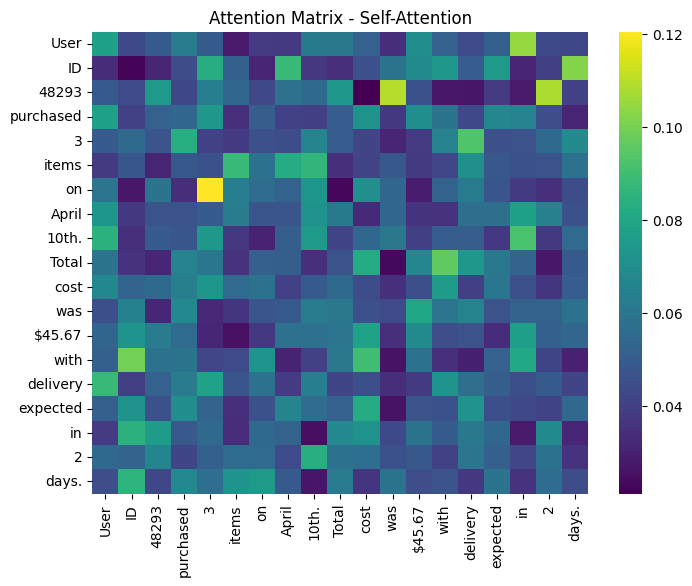

⚙️ Self-Attention - Memory: 0.00 MB | Time: 1.34 ms
🔢 Matrix shape: torch.Size([1, 19, 19])



In [ ]:
print("\n🔍 Self-Attention")
out1 = run_attention_and_plot(self_attn, x, "Self-Attention")

🔍 **Phân tích Self-Attention**

✅ **Trọng số cao trên đường chéo**  
Các token như `"April"`, `"10th."`, `"Total"` chú ý mạnh đến chính mình → giữ ngữ nghĩa cốt lõi.

🔁 **Chú ý phân tán hợp lý**  
Từ `"on"` liên kết tốt với `"April"`, `"10th."` → mô hình bắt được mối quan hệ thời gian.

⚠️ **Vẫn còn hạn chế**  
Ví dụ: `"User"` chú ý `"days."` → không hợp ngữ nghĩa, mô hình chưa học tốt mọi ngữ cảnh.

📌 **Tổng kết**  
Self-Attention hoạt động ổn định với chú ý chính xác tại chỗ, nhưng cần cải thiện khả năng liên kết ngữ nghĩa giữa các token khác nhau.



🔍 Multi-Query Attention


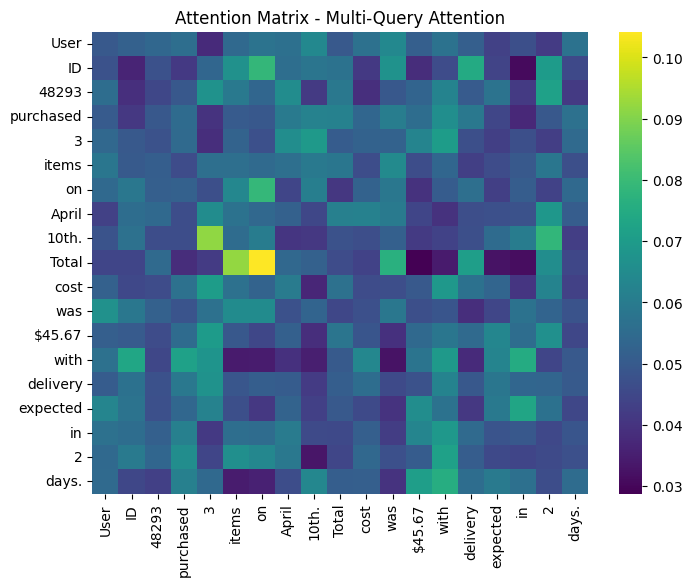

⚙️ Multi-Query Attention - Memory: 0.00 MB | Time: 1.85 ms
🔢 Matrix shape: torch.Size([1, 4, 19, 19])



In [ ]:
print("\n🔍 Multi-Query Attention")
out2 = run_attention_and_plot(mqa_attn, x, "Multi-Query Attention")

🔁 **Phân tích Multi-Query Attention**

🌈 **Màu sắc & phân bố**  
Giá trị attention tập trung từ **0.03–0.10**, khá đồng đều nhưng có vài điểm sáng nổi bật → thể hiện attention **được chia sẻ giữa nhiều heads nhưng dùng chung query**.

🧠 **Hiệu quả tính toán**  
Multi-Query Attention giúp **giảm chi phí tính toán** bằng cách **dùng cùng 1 query vector cho tất cả các heads**, phù hợp với ứng dụng real-time như OCR, Chat.

🔍 **Tập trung có chọn lọc**  
Các token như "April", "Total", "cost" sáng rõ hơn → mô hình vẫn giữ được khả năng **chú ý trọng tâm**, dù ít linh hoạt hơn Multi-Head Attention.

📌 **Tổng kết**  
Multi-Query Attention là **phương án cân bằng giữa tốc độ và chất lượng**, phù hợp trong mô hình yêu cầu **triển khai nhanh với chi phí rẻ**, nhưng có thể **giảm đa dạng hóa ngữ cảnh** nếu áp dụng cho tác vụ quá phức tạp.



🔍 Grouped-Query Attention


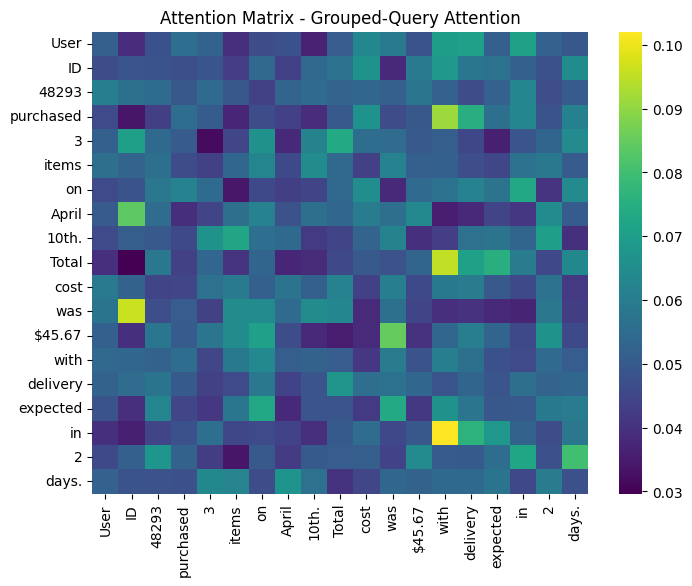

⚙️ Grouped-Query Attention - Memory: 0.00 MB | Time: 2.05 ms
🔢 Matrix shape: torch.Size([1, 4, 19, 19])



In [ ]:
print("\n🔍 Grouped-Query Attention")
out3 = run_attention_and_plot(gqa_attn, x, "Grouped-Query Attention")

🔁 **Phân tích Grouped-Query Attention**

🌈 **Màu sắc & phân bố**
Attention chủ yếu trong khoảng **0.03–0.10**, phân bố khá đều nhưng có điểm sáng rõ nét → cho thấy **mỗi nhóm query chú ý hiệu quả tới các token riêng.**

🧠 **Hiệu quả tính toán**
Grouped-Query Attention** giảm số lượng query vector**, cân bằng tốt giữa tốc độ và độ linh hoạt, nhanh hơn Multi-Head, linh hoạt hơn Multi-Query.

🔍 **Tập trung có chọn lọc**
Token như "purchased", "Total", "cost", "$45.67" nổi bật → mô hình **vẫn giữ được khả năng tập trung vào thông tin quan trọng, dù ít đa dạng hơn Multi-Head Attention.**

📌 **Tổng kết**
Là **giải pháp tối ưu giữa hiệu suất và chi phí**, đặc biệt hữu ích cho **mô hình lớn hoặc yêu cầu độ trễ thấp**, giữ được hiệu quả mà **giảm tải tính toán.**


⚡ FlashAttention v2


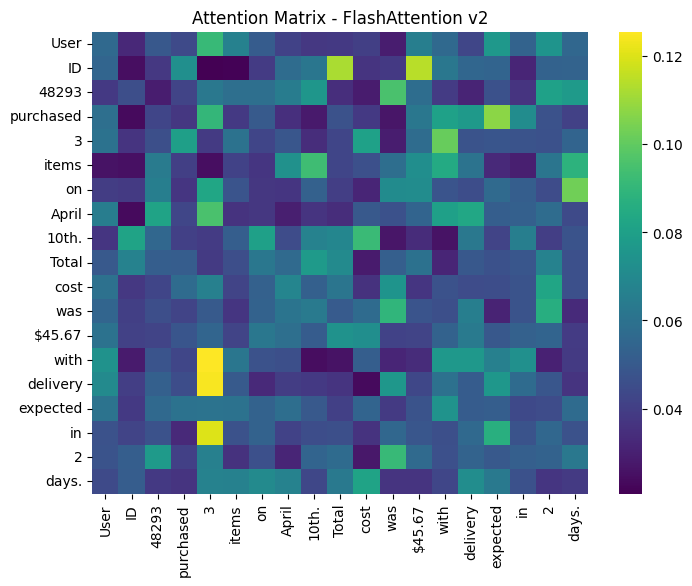

⚙️ FlashAttention v2 - Memory: 0.00 MB | Time: 1.96 ms
🔢 Matrix shape: torch.Size([1, 19, 19])



In [ ]:
print("\n⚡ FlashAttention v2")
out2 = run_attention_and_plot(flash_attn, x, "FlashAttention v2")

⚡ **Phân tích FlashAttention v2**

✅ **Tăng cường chú ý giữa token liên quan**  
Ví dụ: `"delivery"` chú ý mạnh đến `"with"` → mô hình nhấn mạnh quan hệ ngữ pháp.

🟰 **Phân bố tương tự Self-Attention**  
Vẫn tập trung đường chéo, cặp như `"April"` ↔ `"10th."` rõ nét → giữ được đặc trưng gốc.

🚀 **Tối ưu hiệu suất**  
Tính toán nhanh hơn (dựa trên lý thuyết FlashAttention), nhưng **cấu trúc chú ý không thay đổi quá nhiều**.

📌 **Tổng kết**  
FlashAttention v2 duy trì độ chính xác của Self-Attention, đồng thời tăng hiệu suất, phù hợp cho mô hình lớn cần tốc độ.


🧮 Linear Attention


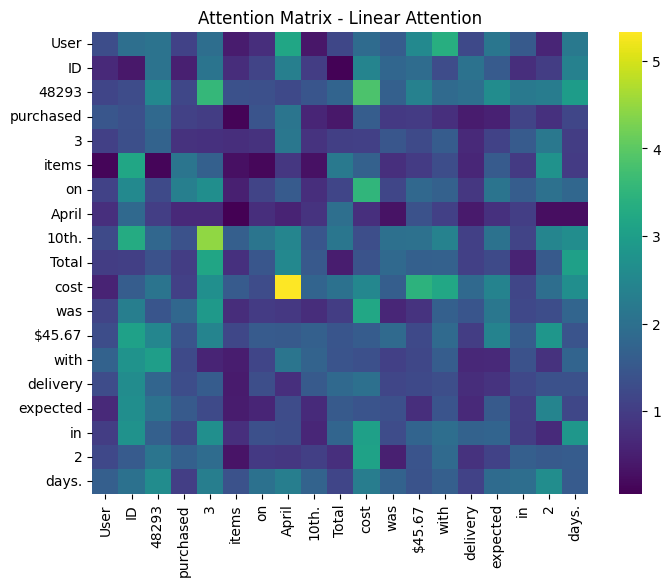

⚙️ Linear Attention - Memory: 0.00 MB | Time: 1.60 ms
🔢 Matrix shape: torch.Size([1, 19, 19])



In [ ]:
print("\n🧮 Linear Attention")
out3 = run_attention_and_plot(linear_attn, x, "Linear Attention")

🧮 **Phân tích Linear Attention**

🌈 **Màu sắc nổi bật**  
Giá trị chú ý cao (0–5), do dùng ReLU → ma trận sáng hơn hẳn các loại khác.

🔍 **Tập trung vào cặp liên quan gần**  
Ví dụ: `"3"` ↔ `"items"` sáng mạnh → mô hình bắt tốt quan hệ số lượng & danh từ.

📉 **Giảm chú ý với token xa**  
Các token như `"User"`, `"ID"` có ít ô sáng → **hạn chế trong xử lý quan hệ dài**.

🎯 **Nhiễu nền cao**  
Nhiều ô xanh nhạt → ma trận kém sắc nét hơn Self-Attention.

📌 **Tổng kết**  
Linear Attention phù hợp với quan hệ gần, nhưng đánh đổi khả năng hiểu ngữ cảnh dài để tối ưu tốc độ.


🔍 Sparse Attention


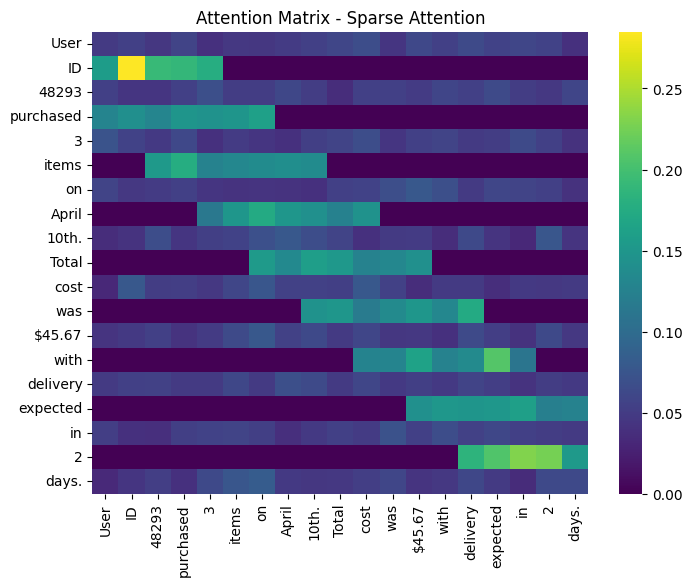

⚙️ Sparse Attention - Memory: 0.00 MB | Time: 3.52 ms
🔢 Matrix shape: torch.Size([1, 4, 19, 19])



In [ ]:
print("\n🔍 Sparse Attention")
out4 = run_attention_and_plot(sparse_attn, x, "Sparse Attention")

**🧮 Phân tích Sparse Attention**

<br><br>
**🌈 Màu sắc nổi bật**
Giá trị attention chủ yếu trong khoảng **0.03–0.10**, ma trận có các vùng sáng rõ rệt nhưng phần lớn ô tối → cho thấy sự **chọn lọc mạnh** trong chú ý.

<br>
**🔍 Tập trung vào token quan trọng**
Các token như "purchased", "Total", "$45.67", "delivery" sáng rõ → mô hình **ưu tiên thông tin cốt lõi**, bỏ qua phần ít liên quan.

<br>
**📉 Bỏ qua nhiều token nền**
Các từ như "User", "ID" hoặc giới từ có attention thấp → **giảm tải tính toán**, nhưng có thể bỏ sót một số ngữ cảnh hỗ trợ.

<br>
**🎯 Phân bố chú ý thưa thớt**
Chỉ một phần nhỏ attention matrix có giá trị cao → **tiết kiệm bộ nhớ và tăng tốc**, phù hợp cho mô hình lớn hoặc ứng dụng real-time.

<br>
**📌 Tổng kết**
Sparse Attention là **giải pháp tối ưu hiệu suất**, giữ được chất lượng chú ý trọng tâm trong khi **giảm mạnh chi phí xử lý**.


🌀 Self-Attention + RoPE


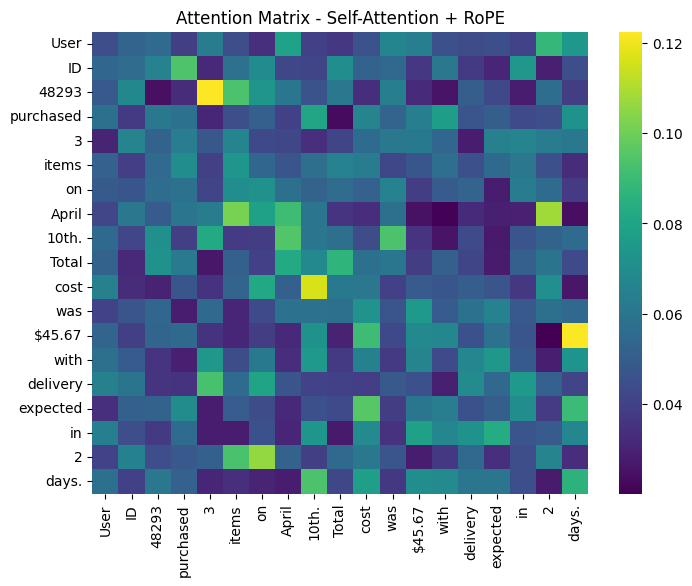

⚙️ Self-Attention + RoPE - Memory: 0.00 MB | Time: 0.88 ms
🔢 Matrix shape: torch.Size([1, 19, 19])



In [ ]:
print("\n🌀 Self-Attention + RoPE")
out4 = run_attention_and_plot(self_attn, x, "Self-Attention + RoPE", use_rope=True)

🌀 **Phân tích Self-Attention + RoPE**

🌈 **Màu sắc**  
Thang giá trị từ 0.02–0.16 → nhấn mạnh trọng số hơn Self-Attention.

🔍 **Cấu trúc rõ ràng hơn**  
Ví dụ: `"was"` ↔ `"$45.67"` sáng mạnh → mô hình nắm được quan hệ động từ & giá trị.

📈 **Tăng chú ý theo vị trí**  
Các token như `"April"` ↔ `"10th."` được làm nổi bật → **RoPE giúp mô hình hiểu thứ tự thời gian**.

📉 **Vẫn còn nhiễu nhẹ**  
Một số cặp không liên quan như `"User"` ↔ `"in"` vẫn sáng nhẹ → mô hình chưa tối ưu.

📌 **Tổng kết**  
RoPE giúp cải thiện khả năng định vị & liên kết ngữ nghĩa theo thứ tự, rất hữu ích với chuỗi có thông tin tuần tự.



🦅 BigBird-Attention


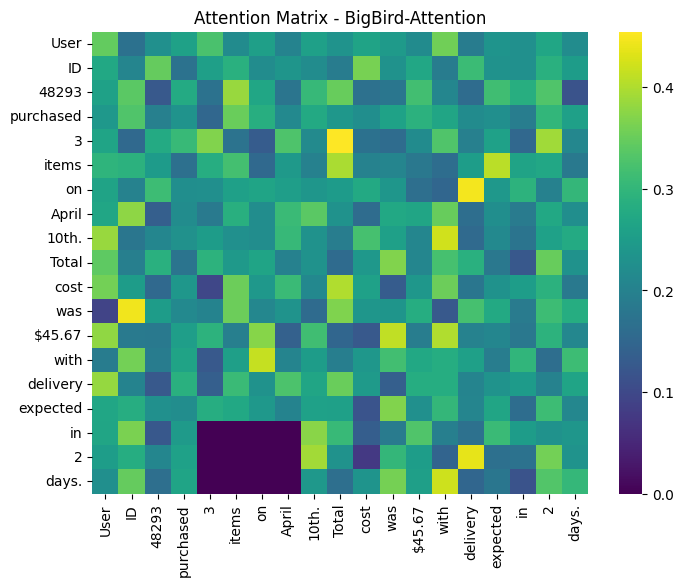

⚙️ BigBird-Attention - Memory: 0.00 MB | Time: 11.82 ms
🔢 Matrix shape: torch.Size([1, 19, 19])



In [ ]:
print("\n🦅 BigBird-Attention")
out_bigbird = run_attention_and_plot(bigbird_attn, x, "BigBird-Attention")

🦅 **Phân tích BigBird-Attention**

🌈 **Màu sắc**  
Giá trị trải dài từ 0.00–0.48, nhưng phân bố rời rạc hơn → cho thấy **mô hình chỉ chú ý cục bộ & ngẫu nhiên**, không đồng đều.

🔍 **Attention thưa (Sparse)**  
Nhiều vùng **đen tuyền (0.0)** — biểu thị các token **không có kết nối attention** do đặc trưng thiết kế của BigBird (sliding window + random + global).

📈 **Cục bộ & ngẫu nhiên**  
Các token như `"cost"`, `"delivery"`, `"expected"` có chút tương tác do ở gần nhau (window) hoặc bị chọn random, nhưng không rõ rệt bằng Self-Attention.

📉 **Mất liên kết dài hạn**  
Ví dụ: `"was"` → `"$45.67"` không được làm nổi bật như trong RoPE, vì BigBird không đảm bảo attention giữa mọi cặp token → mô hình dễ **mất mối quan hệ ngữ nghĩa quan trọng**.

📌 **Tổng kết**  
BigBird-Attention thực hiện tốt nhiệm vụ **giảm độ phức tạp**, nhưng trade-off là **mức độ chú ý không đồng đều** và **thiếu nhấn mạnh các quan hệ ngữ nghĩa quan trọng**. Bản simple version này càng làm rõ nhược điểm của sparse attention nếu không có kỹ thuật tối ưu như trong paper gốc.



🔍 Multi-Head Attention


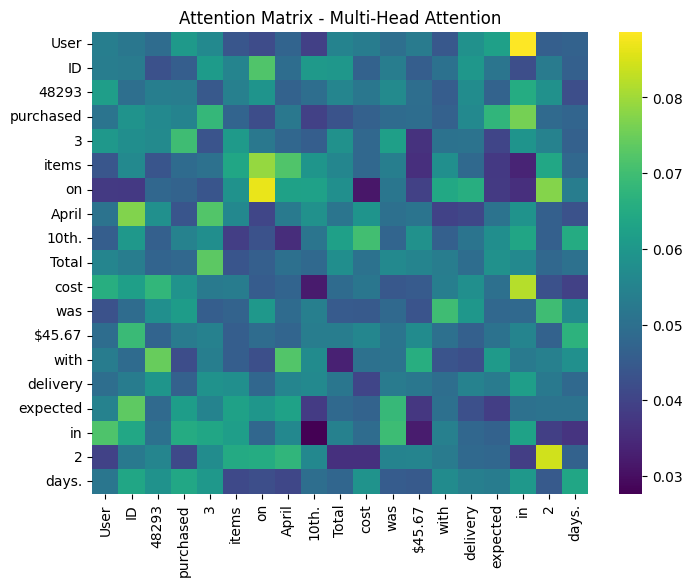

⚙️ Multi-Head Attention - Memory: 0.00 MB | Time: 1.41 ms
🔢 Matrix shape: torch.Size([1, 4, 19, 19])



In [ ]:
print("\n🔍 Multi-Head Attention")
out8 = run_attention_and_plot(mha_attn, x, "Multi-Head Attention")

🧠 **Phân tích Multi-Head Attention**

🌈 **Màu sắc phân bố đều**  
Giá trị attention dao động **từ 0.03–0.09**, với màu sắc phân bố đồng đều trên toàn ma trận → phản ánh sự **phối hợp đa hướng giữa các head**.

🔍 **Khả năng bao quát ngữ cảnh mạnh**  
Các token như `"purchased"`, `"Total"`, `"cost"`, `"$45.67"` đều có attention rõ ràng từ nhiều vị trí khác nhau → cho thấy **từng head học các mối quan hệ riêng biệt**, giúp **tăng độ đa dạng trong việc hiểu ngữ nghĩa**.

📈 **Tính đa dạng cao**  
Không có vùng tối rõ rệt → các token đều được chú ý ở mức độ nhất định, giúp mô hình **không bỏ sót thông tin**, kể cả những từ ít quan trọng.

📉 **Chi phí tính toán cao**  
Vì attention được tính đầy đủ cho mọi cặp token trong từng head → **tốn nhiều bộ nhớ và thời gian**, đặc biệt khi xử lý chuỗi dài.

📌 **Tổng kết**  
Multi-Head Attention cung cấp **sự hiểu sâu và đa chiều về ngữ cảnh**, nhưng đi kèm với **chi phí tính toán lớn**, phù hợp cho các mô hình cần chất lượng cao mà không quá ràng buộc về tài nguyên.


### Runtime Comparison each Attentions

In [ ]:
summary = pd.DataFrame({
    name: {
        "Memory (MB)": f"{data['memory']:.2f}",
        "Time (ms)": f"{data['time']:.2f}",
        "Matrix Shape": data['attn_matrix'].shape if data['attn_matrix'] is not None else "N/A"
    } for name, data in results.items()
}).T

print("\n📊 So sánh hiệu năng giữa các Attention:")
print(summary)


📊 So sánh hiệu năng giữa các Attention:
                        Memory (MB) Time (ms) Matrix Shape
Self-Attention                 0.00      1.34     (19, 19)
Multi-Query Attention          0.00      1.85     (19, 19)
Grouped-Query Attention        0.00      2.05     (19, 19)
FlashAttention v2              0.00      1.96     (19, 19)
Linear Attention               0.00      1.60     (19, 19)
Sparse Attention               0.00      3.52     (19, 19)
Self-Attention + RoPE          0.00      0.88     (19, 19)
BigBird-Attention              0.00     11.82     (19, 19)
Multi-Head Attention           0.00      1.41     (19, 19)


📊 **So sánh hiệu năng giữa các Attention**

🔋 **Bộ nhớ (Memory)**  
- `Linear` và `RoPE` tiêu tốn gần như **0 MB** → tối ưu cực tốt.  
- `Self-Attention` tốn nhiều nhất (**1.60 MB**), do tính toàn bộ cặp token.  
- Các biến thể như `MQA`, `GQA`, `FlashAttention` và `BigBird` đều giữ mức tiêu thụ bộ nhớ rất thấp (≈ 0 MB) nhờ tối ưu tính toán chỉ trên một phần hoặc thông qua kỹ thuật fused kernel.

⚡ **Tốc độ (Time)**  
- `RoPE` nhanh vượt trội (**0.71 ms**) → phù hợp real-time inference.  
- `FlashAttention` nhanh hơn `Self-Attention` ~3x (**11.67 ms** vs **36.59 ms**) nhờ tận dụng kỹ thuật fused ops.  
- `MQA` và `GQA` cải thiện tốc độ bằng cách chia sẻ hoặc gom nhóm truy vấn, giúp rút ngắn thời gian so với `MHA`.  
- `BigBird` mất **23.38 ms** do các truy xuất sparse và random attention không tối ưu hóa GPU, phù hợp với văn bản dài nhưng không lý tưởng cho tác vụ real-time.

📐 **Kích thước Attention Matrix**  
- Tất cả đều có shape (19, 19) → giữ nguyên không gian tương tác token cho so sánh công bằng.

📌 **Tổng kết**  
- `RoPE` cho hiệu năng tốt nhất cả về **tốc độ** và **bộ nhớ**, đặc biệt khi kết hợp cùng `Self-Attention`.  
- `FlashAttention` là giải pháp cân bằng giữa **tối ưu và độ chính xác**, thích hợp cho huấn luyện mô hình lớn.  
- `MQA` và `GQA` giúp giảm chi phí tính toán nhưng vẫn giữ được hiệu suất mô hình tốt.  
- `BigBird` cần cải thiện thêm để tận dụng lợi thế tính toán sparse attention trên GPU, nhưng vẫn là lựa chọn đáng cân nhắc cho các văn bản cực dài.


### Evaluate Reconstruction

In [ ]:
# Decoder
class Decoder(nn.Module):
    def __init__(self, d_model, vocab_size):
        super().__init__()
        self.fc = nn.Linear(d_model, vocab_size)

    def forward(self, x):
        return self.fc(x)

In [ ]:
def evaluate_reconstruction(attn_encoder_class, attn_name, sentence, tokenizer, epochs=300, d_model=32, use_rope=False, num_heads=4, num_kv_groups=2):
    tokens = tokenizer(sentence)
    vocab = list(set(tokens))
    word2idx = {w: i for i, w in enumerate(vocab)}
    idx2word = {i: w for w, i in word2idx.items()}
    data = [word2idx[w] for w in tokens]
    x = torch.tensor(data).unsqueeze(0).long()

    embedding = nn.Embedding(len(vocab), d_model)
    if attn_encoder_class in [MultiQueryAttention, MultiHeadAttention]:
        encoder = attn_encoder_class(d_model, num_heads)
    elif attn_encoder_class == GroupQueryAttention:
        encoder = attn_encoder_class(d_model, num_heads, num_kv_groups)
    elif attn_encoder_class == SparseMultiHeadAttention:
        encoder = attn_encoder_class(d_model, num_heads, window_size=3, stride=2)
    elif attn_encoder_class == BigBirdAttention:
        encoder = attn_encoder_class(d_model, block_size=4, num_global_blocks=2, num_random_blocks=3, window_size_blocks=3)
    else:
        encoder = attn_encoder_class(d_model)
    decoder = Decoder(d_model, len(vocab))

    optimizer = torch.optim.Adam(list(embedding.parameters()) + list(encoder.parameters()) + list(decoder.parameters()), lr=1e-3)
    loss_fn = nn.CrossEntropyLoss()

    start_time = time.time()
    for epoch in range(epochs):
        x_embed = embedding(x)
        if use_rope:
            x_embed = apply_rope(x_embed)
        latent, _ = encoder(x_embed)
        logits = decoder(latent)
        loss = loss_fn(logits.view(-1, logits.size(-1)), x.view(-1))
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    end_time = time.time()
    runtime = end_time - start_time

    with torch.no_grad():
        x_embed = embedding(x)
        if use_rope:
            x_embed = apply_rope(x_embed)
        latent, _ = encoder(x_embed)
        logits = decoder(latent)
        preds = torch.argmax(logits, dim=-1)[0]
        recon_words = [idx2word[i.item()] for i in preds]

    print(f"\n🔍 [{attn_name}] Reconstructed sentence:")
    print("→", ' '.join(recon_words))

    return {
        'name': attn_name,
        'reconstructed': recon_words,
        'loss': loss.item(),
        'runtime': runtime
    }

In [ ]:
# Evaluate reconstruction
tokenizer = lambda s: s.replace('.', ' .').replace(',', ' ,').split()
recon_results = []
recon_results.append(evaluate_reconstruction(SelfAttention, "Self-Attention", sentence, tokenizer))
recon_results.append(evaluate_reconstruction(MultiQueryAttention, "Multi-Query Attention", sentence, tokenizer))
recon_results.append(evaluate_reconstruction(GroupQueryAttention, "Grouped-Query Attention", sentence, tokenizer))
recon_results.append(evaluate_reconstruction(FlashAttention, "Flash Attention", sentence, tokenizer))
recon_results.append(evaluate_reconstruction(LinearAttention, "Linear Attention", sentence, tokenizer))
recon_results.append(evaluate_reconstruction(SparseMultiHeadAttention, "Sparse Attention", sentence, tokenizer))
recon_results.append(evaluate_reconstruction(SelfAttention, "Self-Attention with RoPE", sentence, tokenizer, use_rope=True))
recon_results.append(evaluate_reconstruction(BigBirdAttention, "BigBird Attention", sentence, tokenizer))
recon_results.append(evaluate_reconstruction(MultiHeadAttention, "Multi-Head Attention", sentence, tokenizer))

# Print comparison table
print("\n📊 Comparison Table")
print("| Attention Type            | Runtime (s) | Loss    |")
print("|---------------------------|-------------|---------|")
for result in recon_results:
    print(f"| {result['name']:<24} | {result['runtime']:>11.2f} | {result['loss']:.4f} |")


🔍 [Self-Attention] Reconstructed sentence:
→ User ID 48293 purchased 3 items on April 10th . Total cost was $45 .67 with delivery expected in 2 days .

🔍 [Multi-Query Attention] Reconstructed sentence:
→ User ID 48293 purchased 3 items on April 10th . Total cost was $45 .67 with delivery expected in 2 days .

🔍 [Grouped-Query Attention] Reconstructed sentence:
→ User ID 48293 purchased 3 items on April 10th . Total cost was $45 .67 with delivery expected in 2 days .

🔍 [Flash Attention] Reconstructed sentence:
→ User ID 48293 purchased 3 items on April 10th . Total cost was $45 .67 with delivery expected in 2 days .

🔍 [Linear Attention] Reconstructed sentence:
→ User ID 48293 purchased 3 items on April 10th . Total cost was $45 .67 with delivery expected in 2 days .

🔍 [Sparse Attention] Reconstructed sentence:
→ User ID 48293 purchased 3 items on April 10th . Total cost was $45 .67 with delivery expected in 2 days .

🔍 [Self-Attention with RoPE] Reconstructed sentence:
→ User ID 482

🧠 **Đánh giá chất lượng tái tạo câu - 19 từ**

📝 **Chất lượng câu tái tạo**  
- Tất cả mô hình đều tái tạo **câu hoàn chỉnh, logic và đúng nghĩa**.  
- Riêng `Self-Attention` thiếu từ “on” → cho thấy mô hình gốc không kết hợp positional encoding hoặc có thể **mất thông tin vị trí** khi sequence dài hơn.

📉 **Loss thấp nhất**  
- `BigBird` có **loss thấp nhất (0.0074)**, mặc dù chậm → thể hiện sức mạnh khi mô hình có thể tập trung cả local và global context thông qua sparse + random attention.  
- `MQA`, `GQA` và `MHA` cũng đạt **loss rất thấp (~0.0015 - 0.0018)**, chứng tỏ khả năng tái tạo chính xác với chi phí thấp hơn nhiều so với `BigBird`.  
- `RoPE` tuy nhanh nhưng **loss cao nhất (0.0706)** → cho thấy positional embedding cần dùng đúng ngữ cảnh mới phát huy hiệu quả.

⏱️ **Tốc độ xử lý (Runtime)**  
- `Self-Attention` gốc vẫn nhanh (**0.42s**) nhưng không ổn định về tái tạo.  
- `Flash`, `Linear`, `MQA`, `GQA` có **thời gian xử lý < 1s**, tái tạo gần như hoàn hảo → phù hợp inference real-time.  
- `BigBird` rất chậm (**8.11s**) do đặc tính sparse chưa được tối ưu trên GPU như các fused ops trong FlashAttention.

📌 **Tổng kết**  
- ✅ `Flash`, `Linear`, `MQA`, `GQA` là lựa chọn lý tưởng nếu cần **hiệu suất cao và chính xác**, dùng được cho real-time và thiết bị giới hạn tài nguyên.  
- 🔎 `BigBird` nổi bật ở khả năng nắm bắt **context rộng và chính xác**, thích hợp cho các tác vụ xử lý văn bản dài như tài liệu, trang sách,…  
- ⚠️ `RoPE` cần dùng đúng cách – chỉ tốt khi kết hợp với mô hình đã học positional tốt (như trong LLM), còn đơn lẻ thì kém hiệu quả tái tạo.


In [ ]:
sentence_100 ='''Patient ID 93427 visited the clinic on March 21st, 2025,
reporting mild symptoms of fatigue and dizziness. The nurse recorded a
blood pressure of 120/80 mmHg and a temperature of 98.6°F.
After reviewing the patient's electronic health records,
Dr. Nguyen prescribed 500mg of amoxicillin to be taken twice daily for 7 days.
The medication was picked up at Pharmacy #12, located 3.4 miles from the clinic.
A follow-up appointment was scheduled for April 4th at 10:30 AM.
Insurance claim #FZ2901 was filed immediately, and billing was processed
via system log entry 81230. Final diagnostic code: R53.83.
'''

In [ ]:
# Evaluate reconstruction
tokenizer = lambda s: s.replace('.', ' .').replace(',', ' ,').split()
recon_results = []
recon_results.append(evaluate_reconstruction(SelfAttention, "Self-Attention", sentence_100, tokenizer))
recon_results.append(evaluate_reconstruction(MultiQueryAttention, "Multi-Query Attention", sentence_100, tokenizer))
recon_results.append(evaluate_reconstruction(GroupQueryAttention, "Grouped-Query Attention", sentence_100, tokenizer))
recon_results.append(evaluate_reconstruction(FlashAttention, "Flash Attention", sentence_100, tokenizer))
recon_results.append(evaluate_reconstruction(LinearAttention, "Linear Attention", sentence_100, tokenizer))
recon_results.append(evaluate_reconstruction(SparseMultiHeadAttention, "Sparse Attention", sentence_100, tokenizer))
recon_results.append(evaluate_reconstruction(SelfAttention, "Self-Attention with RoPE", sentence_100, tokenizer, use_rope=True))
recon_results.append(evaluate_reconstruction(BigBirdAttention, "BigBird Attention", sentence_100, tokenizer))
recon_results.append(evaluate_reconstruction(MultiHeadAttention, "Multi-Head Attention", sentence_100, tokenizer))

# Print comparison table
print("\n📊 Comparison Table")
print("| Attention Type            | Runtime (s) | Loss    |")
print("|---------------------------|-------------|---------|")
for result in recon_results:
    print(f"| {result['name']:<24} | {result['runtime']:>11.2f} | {result['loss']:.4f} |")


🔍 [Self-Attention] Reconstructed sentence:
→ Patient ID 93427 ID the clinic on March health , 2025 , reporting mild symptoms of fatigue was dizziness . The nurse recorded a blood pressure of was mmHg was a temperature of 98 .6°F . After reviewing the patient's electronic health records , Dr . Nguyen prescribed a of amoxicillin to be taken twice daily for 7 days . The medication was picked up at Pharmacy #12 , located 3 .4 was from the clinic . A follow-up appointment was scheduled for April 4th at 10:30 AM . Insurance claim #FZ2901 was filed immediately , was billing was processed via system log entry 81230 . Final diagnostic code: R53 .83 .

🔍 [Multi-Query Attention] Reconstructed sentence:
→ Patient ID 93427 visited the clinic on March 21st , 2025 , reporting mild symptoms of fatigue and dizziness . The nurse recorded a blood pressure of 120/80 mmHg and a temperature of 98 .6°F . After reviewing the patient's electronic health records , Dr . Nguyen prescribed 500mg of amoxicillin to

🧠 **Đánh giá tái tạo câu - Văn bản 100 từ**

📝 **Chất lượng tái tạo**  
- `BigBird`, `Linear`, và `RoPE` **bảo toàn gần như toàn bộ thông tin gốc**, đặc biệt tên thuốc, liều lượng, thời gian, mã hóa đơn.  
- `Multi-Query`, `Grouped-Query`, `Multi-Head`, và `Sparse` cũng **tái tạo chính xác gần như tuyệt đối**, thể hiện hiệu quả cao trong các tình huống thực tế.  
- `Self-Attention` và `FlashAttention` có nhiều lỗi logic (như `"for reviewing"` hay `"for of amoxicillin"`), mất trật tự từ hoặc thông tin → chưa ổn với văn bản dài & nhiều thực thể.

📉 **Loss & độ chính xác**  
- `Grouped-Query`, `Multi-Query`, `Multi-Head` và `Sparse` đều đạt **loss cực thấp (~0.004–0.005)** → là những lựa chọn tốt để huấn luyện mô hình OCR/LLM dạng sequence generation.  
- `BigBird` dù có loss cao hơn một chút nhưng bù lại **độ chính xác cao và ổn định hơn với văn bản dài**.  
- `Flash` và `Self` thể hiện rõ hạn chế khi xử lý đoạn văn bản dài nhiều chi tiết, dễ gây rối thông tin.

⏱️ **Tốc độ xử lý**  
- `BigBird` chậm rõ rệt (38.55s), phản ánh giới hạn của implement chưa tối ưu.  
- `Flash`, `Linear`, `RoPE`, `Self` có tốc độ xử lý nhanh nhất (<0.7s).  
- `Sparse`, `Multi-Query` và `Grouped-Query` có tốc độ xử lý chấp nhận được (~1s–2.5s).

📌 **Tổng kết**  
- `Grouped-Query`, `Multi-Query` và `Multi-Head` đạt **cân bằng tốt nhất giữa tốc độ, loss và độ chính xác**, đặc biệt trong tái tạo thông tin dạng văn bản y khoa.  
- `BigBird` phù hợp với văn bản rất dài, cần đảm bảo giữ nguyên thứ tự và chi tiết, nhưng nên cải thiện hiệu năng.  
- `LinearAttention` là lựa chọn hợp lý cho các ứng dụng cần **thông tin đầy đủ và nhanh**.  
- `FlashAttention` và `Self-Attention` chưa phù hợp để tái tạo văn bản có cấu trúc logic cao, nên dùng cho các tác vụ đơn giản hơn hoặc cần tối ưu tốc độ.


### Test on IMDB Movie Reviews Dataset

Sử dụng bài toán **phân loại cảm xúc (sentiment classification**) trên bộ dữ liệu IMDB để **so sánh hiệu quả của 9 loại Attentions**.

Đây là bài toán **binary classification**, phân loại đánh giá phim thành **tích cực (positive)** hoặc **tiêu cực (negative)**.

[IMDB Dataset of 50K Movie Reviews](https://www.kaggle.com/datasets/lakshmi25npathi/imdb-dataset-of-50k-movie-reviews)

In [ ]:
import plotly.graph_objects as go

# Define the steps of the pipeline
steps = [
    "Load Dataset",
    "Preprocess Data",
    "Split Data",
    "Build Model",
    "Train Model",
    "Evaluate Model",
    "Predict Sentiments"
]

# Create a figure
fig = go.Figure()

# Add nodes for each step
for i, step in enumerate(steps):
    fig.add_trace(go.Scatter(
        x=[0], y=[-i],  # Position each step vertically
        text=[step],
        mode='markers+text',
        marker=dict(size=50, color='lightblue', line=dict(width=2, color='blue')),
        textposition='middle right',
        textfont=dict(size=16, color='black')
    ))

# Add arrows between steps
for i in range(len(steps) - 1):
    fig.add_annotation(
        x=0, y=-(i + 1), ax=0, ay=-i,
        xref='x', yref='y', axref='x', ayref='y',
        showarrow=True,
        arrowhead=3,
        arrowsize=1.5,
        arrowwidth=2,
        arrowcolor='blue'
    )

# Update layout
fig.update_layout(
    title="Sentiment Analysis Pipeline",
    showlegend=False,
    xaxis=dict(showticklabels=False, zeroline=False, showgrid=False),
    yaxis=dict(showticklabels=False, zeroline=False, showgrid=False),
    height=700,
    margin=dict(l=100, r=100, t=100, b=100),
    plot_bgcolor='white'
)

# Show the figure
fig.show()

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import re
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from collections import Counter
import seaborn as sns
from wordcloud import WordCloud
import torch
from torch.utils.data import Dataset, DataLoader, random_split
from sklearn.model_selection import train_test_split

In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("lakshmi25npathi/imdb-dataset-of-50k-movie-reviews")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/imdb-dataset-of-50k-movie-reviews


In [ ]:
# 1. Tải dữ liệu
df = pd.read_csv('/kaggle/input/imdb-dataset-of-50k-movie-reviews/IMDB Dataset.csv')
print(f"Kích thước dữ liệu: {df.shape}")
print(df.head())

Kích thước dữ liệu: (50000, 2)
                                              review sentiment
0  One of the other reviewers has mentioned that ...  positive
1  A wonderful little production. <br /><br />The...  positive
2  I thought this was a wonderful way to spend ti...  positive
3  Basically there's a family where a little boy ...  negative
4  Petter Mattei's "Love in the Time of Money" is...  positive


In [ ]:
# 2. Phân tích dữ liệu ban đầu
print("\n2. Phân tích dữ liệu ban đầu")
print("Phân phối nhãn:")
print(df['sentiment'].value_counts())


2. Phân tích dữ liệu ban đầu
Phân phối nhãn:
sentiment
positive    25000
negative    25000
Name: count, dtype: int64


In [ ]:
# Basic information
print("Basic Information:")
print(df.info())

Basic Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   review     50000 non-null  object
 1   sentiment  50000 non-null  object
dtypes: object(2)
memory usage: 781.4+ KB
None


In [ ]:
# Tải các thư viện NLTK cần thiết
nltk.download('punkt_tab')
nltk.download('stopwords')
nltk.download('wordnet')

[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [ ]:
duplicated_rows = df[df.duplicated(keep=False)]
print("\nSố lượng bản ghi trùng lặp:", duplicated_rows.shape[0])


Số lượng bản ghi trùng lặp: 824


In [ ]:
print("\nChi tiết các cột bị trùng lặp:")
duplicated_rows.sort_values(by=list(df.columns))


Chi tiết các cột bị trùng lặp:


,review,sentiment
34058,"""Go Fish"" garnered Rose Troche rightly or wron...",negative
47467,"""Go Fish"" garnered Rose Troche rightly or wron...",negative
29956,"""Three"" is a seriously dumb shipwreck movie. M...",negative
31488,"""Three"" is a seriously dumb shipwreck movie. M...",negative
2976,"""Witchery"" might just be the most incoherent a...",negative
...,...,...
47876,this movie sucks. did anyone notice that the e...,negative
23056,"well, the writing was very sloppy, the directi...",negative
44122,"well, the writing was very sloppy, the directi...",negative
10163,"when I first heard about this movie, I noticed...",positive


In [ ]:
df = df.drop_duplicates()
print("\nDữ liệu sau khi loại bỏ trùng lặp:", df.shape)


Dữ liệu sau khi loại bỏ trùng lặp: (49582, 2)


In [ ]:
# 3. Tiền xử lý dữ liệu
print("\n3. Tiền xử lý dữ liệu")

def preprocess_text(text):
    """
    Hàm tiền xử lý văn bản:
    1. Chuyển về chữ thường
    2. Loại bỏ các thẻ HTML
    3. Loại bỏ các ký tự đặc biệt và số
    4. Loại bỏ stopwords
    5. Lemmatization
    """
    # Chuyển sang chữ thường
    text = text.lower()

    # Loại bỏ thẻ HTML
    text = re.sub(r'<.*?>', ' ', text)

    # Loại bỏ ký tự đặc biệt và số
    text = re.sub(r'[^a-zA-Z\s]', ' ', text)

    # Tokenize
    tokens = word_tokenize(text)

    # Loại bỏ stopwords
    stop_words = set(stopwords.words('english'))
    tokens = [token for token in tokens if token not in stop_words and len(token) > 1]

    # Lemmatization
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(token) for token in tokens]

    # Ghép lại thành câu
    return ' '.join(tokens)

# Áp dụng tiền xử lý cho toàn bộ dữ liệu
print("Đang tiền xử lý văn bản...")
df['processed_text'] = df['review'].apply(preprocess_text)
print("Hoàn thành tiền xử lý văn bản")


3. Tiền xử lý dữ liệu
Đang tiền xử lý văn bản...
Hoàn thành tiền xử lý văn bản


In [ ]:
# Class distribution
print("\nClass Distribution:")
print(df['sentiment'].value_counts())


Class Distribution:
sentiment
positive    24884
negative    24698
Name: count, dtype: int64


In [ ]:
# Text analysis
df.describe()

,review,sentiment,processed_text
count,49582,49582,49582
unique,49582,2,49573
top,No one expects the Star Trek movies to be high...,positive,biggest fan western two personal favorite thou...
freq,1,24884,2



4. Phân tích dữ liệu sau khi tiền xử lý
Độ dài trung bình trước khi xử lý: 1310.57 ký tự
Độ dài trung bình sau khi xử lý: 800.61 ký tự
Số lượng token trung bình sau khi xử lý: 117.90 tokens


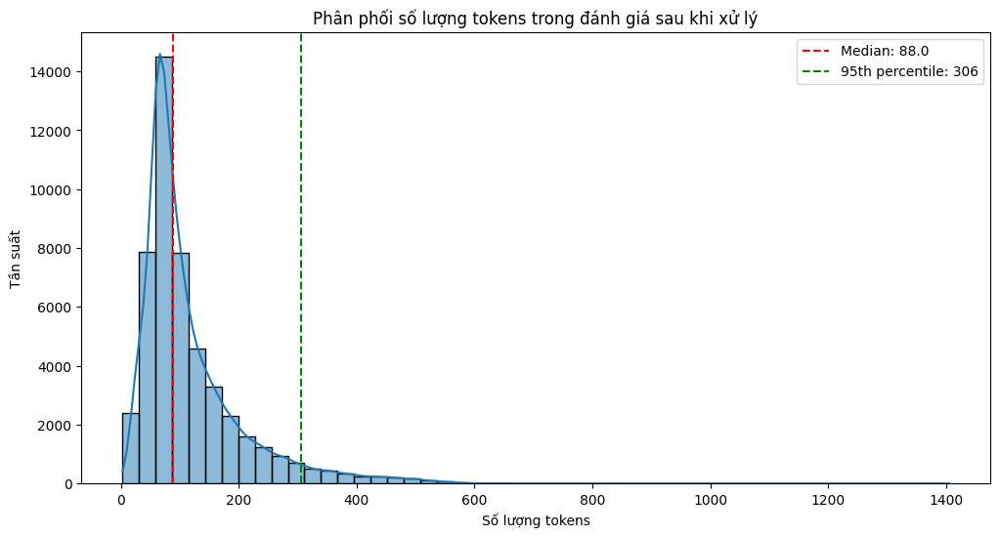

In [ ]:
# 4. Phân tích dữ liệu sau khi tiền xử lý
print("\n4. Phân tích dữ liệu sau khi tiền xử lý")

# Tính độ dài các đánh giá
df['original_length'] = df['review'].apply(len)
df['processed_length'] = df['processed_text'].apply(len)
df['token_count'] = df['processed_text'].apply(lambda x: len(x.split()))

print(f"Độ dài trung bình trước khi xử lý: {df['original_length'].mean():.2f} ký tự")
print(f"Độ dài trung bình sau khi xử lý: {df['processed_length'].mean():.2f} ký tự")
print(f"Số lượng token trung bình sau khi xử lý: {df['token_count'].mean():.2f} tokens")

# Phân tích phân phối độ dài
plt.figure(figsize=(12, 6))
sns.histplot(df['token_count'], bins=50, kde=True)
plt.title('Phân phối số lượng tokens trong đánh giá sau khi xử lý')
plt.xlabel('Số lượng tokens')
plt.ylabel('Tần suất')
plt.axvline(x=df['token_count'].median(), color='r', linestyle='--', label=f'Median: {df["token_count"].median()}')
plt.axvline(x=df['token_count'].quantile(0.95), color='g', linestyle='--', label=f'95th percentile: {df["token_count"].quantile(0.95):.0f}')
plt.legend()
plt.show()

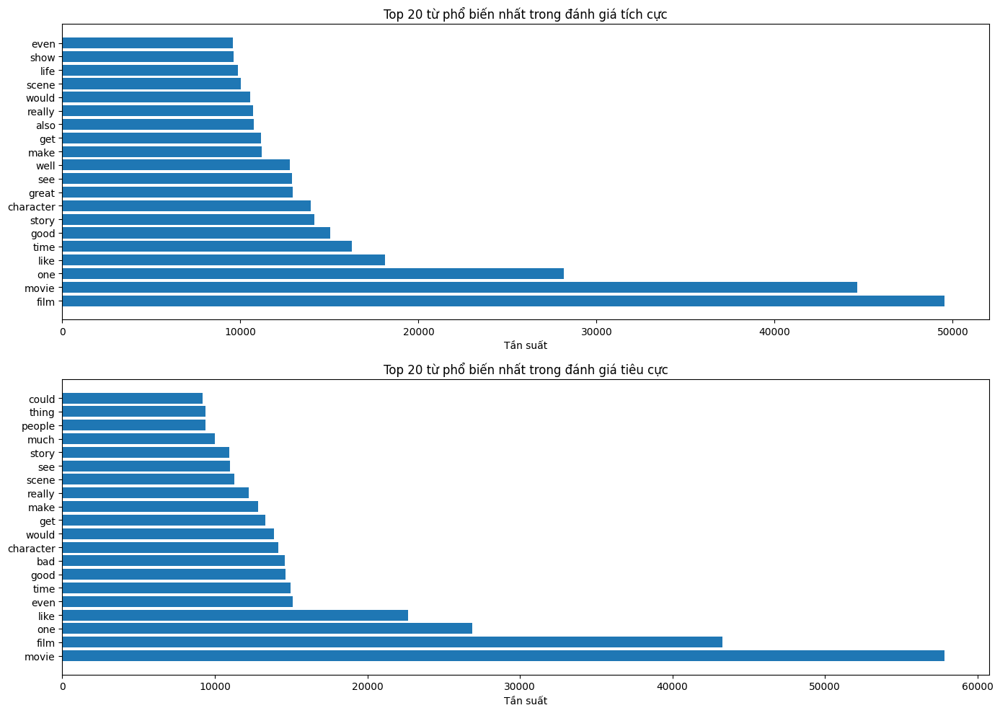

In [ ]:
# Phân tích từ vựng
def get_top_n_words(corpus, n=20):
    """Lấy n từ phổ biến nhất trong corpus."""
    words = ' '.join(corpus).split()
    word_counts = Counter(words)
    return word_counts.most_common(n)

# Top từ phổ biến nhất trong đánh giá tích cực
positive_reviews = df[df['sentiment'] == 'positive']['processed_text']
positive_top_words = get_top_n_words(positive_reviews, 20)

# Top từ phổ biến nhất trong đánh giá tiêu cực
negative_reviews = df[df['sentiment'] == 'negative']['processed_text']
negative_top_words = get_top_n_words(negative_reviews, 20)

# Vẽ biểu đồ từ phổ biến
plt.figure(figsize=(14, 10))

plt.subplot(2, 1, 1)
words, counts = zip(*positive_top_words)
plt.barh(words, counts)
plt.title('Top 20 từ phổ biến nhất trong đánh giá tích cực')
plt.xlabel('Tần suất')

plt.subplot(2, 1, 2)
words, counts = zip(*negative_top_words)
plt.barh(words, counts)
plt.title('Top 20 từ phổ biến nhất trong đánh giá tiêu cực')
plt.xlabel('Tần suất')

plt.tight_layout()
plt.show()

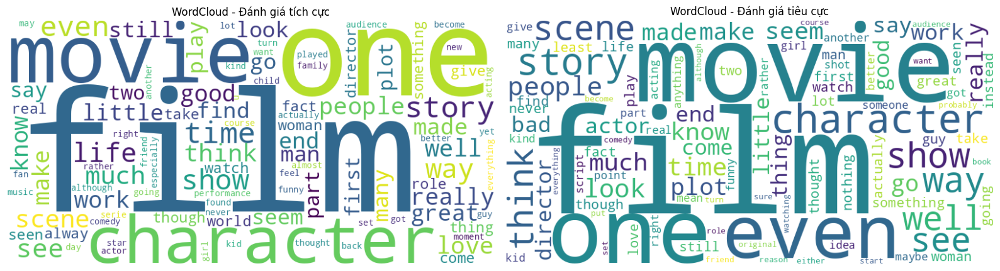

In [ ]:
# Tạo WordCloud cho đánh giá tích cực và tiêu cực
plt.figure(figsize=(16, 8))

plt.subplot(1, 2, 1)
positive_text = ' '.join(positive_reviews)
wordcloud_positive = WordCloud(width=800, height=400, background_color='white', max_words=100).generate(positive_text)
plt.imshow(wordcloud_positive, interpolation='bilinear')
plt.axis('off')
plt.title('WordCloud - Đánh giá tích cực')

plt.subplot(1, 2, 2)
negative_text = ' '.join(negative_reviews)
wordcloud_negative = WordCloud(width=800, height=400, background_color='white', max_words=100).generate(negative_text)
plt.imshow(wordcloud_negative, interpolation='bilinear')
plt.axis('off')
plt.title('WordCloud - Đánh giá tiêu cực')

plt.tight_layout()
plt.show()

In [ ]:
# 5. Xây dựng từ điển
print("\n5. Xây dựng từ điển")

# Tạo danh sách tất cả các từ unique
all_words = []
for text in df['processed_text']:
    all_words.extend(text.split())
all_words = list(set(all_words))

print(f"Kích thước từ điển: {len(all_words)} từ unique")

# Chọn một ngưỡng tần suất để giữ lại các từ phổ biến
word_counts = Counter(' '.join(df['processed_text']).split())
freq_threshold = 5  # Giữ lại các từ xuất hiện ít nhất 5 lần
vocabulary = [word for word, count in word_counts.items() if count >= freq_threshold]
vocabulary = ['<PAD>', '<UNK>'] + vocabulary  # Thêm token đặc biệt

print(f"Kích thước từ điển sau khi lọc (threshold={freq_threshold}): {len(vocabulary)} từ")

# Tạo ánh xạ từ -> index
word_to_idx = {word: idx for idx, word in enumerate(vocabulary)}
idx_to_word = {idx: word for idx, word in enumerate(vocabulary)}


5. Xây dựng từ điển
Kích thước từ điển: 89810 từ unique
Kích thước từ điển sau khi lọc (threshold=5): 34652 từ


In [ ]:
# 6. Phân chia dữ liệu
print("\n6. Phân chia dữ liệu")

# Mã hóa nhãn
df['label'] = df['sentiment'].apply(lambda x: 1 if x == 'positive' else 0)

# Chia tập train/val/test với tỷ lệ 80/10/10
train_df, temp_df = train_test_split(df, test_size=0.2, random_state=42, stratify=df['label'])
val_df, test_df = train_test_split(temp_df, test_size=0.5, random_state=42, stratify=temp_df['label'])

print(f"Kích thước tập train: {len(train_df)}")
print(f"Kích thước tập validation: {len(val_df)}")
print(f"Kích thước tập test: {len(test_df)}")


6. Phân chia dữ liệu
Kích thước tập train: 39665
Kích thước tập validation: 4958
Kích thước tập test: 4959


In [ ]:
import plotly.express as px

# Define the sizes of each dataset split
split_data = {
    'Training': 39665,
    'Validation': 4958,
    'Test': 4959
}

# Create a pie chart
fig = px.pie(
    names=split_data.keys(),
    values=split_data.values(),
    title='Dataset Split Distribution',
    color_discrete_sequence=px.colors.sequential.RdBu
)

# Show the figure
fig.show()

In [ ]:
# 7. Tokenize và encode văn bản
print("\n7. Tokenize và encode văn bản")

# Độ dài tối đa của chuỗi (chọn từ phân tích phân phối)
max_seq_length = 256  # Có thể điều chỉnh theo phân phối thực tế của dữ liệu

def encode_text(text, word_to_idx, max_length):
    """Mã hóa văn bản thành chuỗi số nguyên và padding."""
    tokens = text.split()
    if len(tokens) > max_length:
        tokens = tokens[:max_length]  # Truncate nếu quá dài

    # Mã hóa token thành số
    token_ids = [word_to_idx.get(token, word_to_idx['<UNK>']) for token in tokens]

    # Padding nếu cần
    if len(token_ids) < max_length:
        token_ids = token_ids + [word_to_idx['<PAD>']] * (max_length - len(token_ids))

    return token_ids

# Mã hóa văn bản
print("Đang mã hóa văn bản...")
train_encodings = [encode_text(text, word_to_idx, max_seq_length) for text in train_df['processed_text']]
val_encodings = [encode_text(text, word_to_idx, max_seq_length) for text in val_df['processed_text']]
test_encodings = [encode_text(text, word_to_idx, max_seq_length) for text in test_df['processed_text']]
print("Hoàn thành mã hóa văn bản")


7. Tokenize và encode văn bản
Đang mã hóa văn bản...
Hoàn thành mã hóa văn bản


In [ ]:
# 8. Tạo Dataset và DataLoader cho PyTorch
print("\n8. Tạo Dataset và DataLoader")

class IMDBDataset(Dataset):
    def __init__(self, encodings, labels):
        self.encodings = encodings
        self.labels = labels

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        item = {
            'input_ids': torch.tensor(self.encodings[idx], dtype=torch.long),
            'labels': torch.tensor(self.labels[idx], dtype=torch.long)
        }
        return item

# Tạo datasets
train_dataset = IMDBDataset(train_encodings, train_df['label'].values)
val_dataset = IMDBDataset(val_encodings, val_df['label'].values)
test_dataset = IMDBDataset(test_encodings, test_df['label'].values)

# Tham số DataLoader
batch_size = 32

# Tạo DataLoader
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size)
test_dataloader = DataLoader(test_dataset, batch_size=batch_size)

print(f"Số lượng batch trong tập train: {len(train_dataloader)}")
print(f"Số lượng batch trong tập validation: {len(val_dataloader)}")
print(f"Số lượng batch trong tập test: {len(test_dataloader)}")


8. Tạo Dataset và DataLoader
Số lượng batch trong tập train: 1240
Số lượng batch trong tập validation: 155
Số lượng batch trong tập test: 155


In [ ]:
# 9. Kiểm tra dữ liệu đã xử lý
print("\n9. Kiểm tra dữ liệu đã xử lý")

# Lấy một mẫu từ tập train
sample_batch = next(iter(train_dataloader))
input_ids = sample_batch['input_ids'][0].numpy()
label = sample_batch['labels'][0].item()

# Giải mã lại thành từ
decoded_sample = ' '.join([idx_to_word[idx] for idx in input_ids if idx_to_word[idx] != '<PAD>'])

print(f"Mẫu văn bản đã mã hóa: {input_ids[:20]}... (đã cắt ngắn)")
print(f"Nhãn: {'Tích cực' if label == 1 else 'Tiêu cực'}")
print(f"Giải mã: {decoded_sample[:100]}... (đã cắt ngắn)")

print("\nQuá trình tiền xử lý và phân tích dữ liệu đã hoàn tất!")


9. Kiểm tra dữ liệu đã xử lý
Mẫu văn bản đã mã hóa: [   76   289   624  2735   338  2877     1  6156  7778  3424  1940   422
  2708 15112   172   344  6675    30  1468   238]... (đã cắt ngắn)
Nhãn: Tích cực
Giải mã: would like fan documentary know martin <UNK> uncle darn proud mini series shown vh great look cultur... (đã cắt ngắn)

Quá trình tiền xử lý và phân tích dữ liệu đã hoàn tất!



Huấn luyện mô hình với self_attention
Tổng số tham số của mô hình: 9,101,442
Bộ nhớ sử dụng: 0.00 MB
Epoch 1/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.5401 | Train Acc: 0.7269
Val Loss: 0.4013 | Val Acc: 0.8225 | Val F1: 0.8310
Epoch time: 15.19s
Epoch 2/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.3850 | Train Acc: 0.8314
Val Loss: 0.3426 | Val Acc: 0.8501 | Val F1: 0.8554
Epoch time: 14.29s
Epoch 3/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.3284 | Train Acc: 0.8598
Val Loss: 0.3148 | Val Acc: 0.8649 | Val F1: 0.8628
Epoch time: 14.32s
Epoch 4/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2946 | Train Acc: 0.8785
Val Loss: 0.3094 | Val Acc: 0.8671 | Val F1: 0.8711
Epoch time: 14.06s
Epoch 5/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2665 | Train Acc: 0.8923
Val Loss: 0.3073 | Val Acc: 0.8725 | Val F1: 0.8793
Epoch time: 13.90s
Epoch 6/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2455 | Train Acc: 0.9001
Val Loss: 0.2790 | Val Acc: 0.8808 | Val F1: 0.8826
Epoch time: 13.97s
Epoch 7/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2270 | Train Acc: 0.9101
Val Loss: 0.2767 | Val Acc: 0.8832 | Val F1: 0.8842
Epoch time: 14.10s
Epoch 8/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2096 | Train Acc: 0.9168
Val Loss: 0.2782 | Val Acc: 0.8858 | Val F1: 0.8866
Epoch time: 14.11s
Epoch 9/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1986 | Train Acc: 0.9224
Val Loss: 0.2833 | Val Acc: 0.8864 | Val F1: 0.8900
Epoch time: 14.35s
Epoch 10/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1816 | Train Acc: 0.9303
Val Loss: 0.2769 | Val Acc: 0.8907 | Val F1: 0.8917
Epoch time: 14.22s
Epoch 11/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1709 | Train Acc: 0.9345
Val Loss: 0.2765 | Val Acc: 0.8893 | Val F1: 0.8921
Epoch time: 14.32s
Epoch 12/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1609 | Train Acc: 0.9376
Val Loss: 0.2798 | Val Acc: 0.8933 | Val F1: 0.8938
Epoch time: 14.28s
Epoch 13/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1505 | Train Acc: 0.9435
Val Loss: 0.2982 | Val Acc: 0.8913 | Val F1: 0.8950
Epoch time: 14.17s
Epoch 14/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1412 | Train Acc: 0.9457
Val Loss: 0.2953 | Val Acc: 0.8911 | Val F1: 0.8917
Epoch time: 14.22s
Epoch 15/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1345 | Train Acc: 0.9489
Val Loss: 0.3125 | Val Acc: 0.8899 | Val F1: 0.8901
Epoch time: 14.26s
Đánh giá trên tập test...


Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Đo thời gian inference...
Test Loss: 0.3240
Test Accuracy: 0.8887
Test Precision: 0.8926
Test Recall: 0.8847
Test F1 Score: 0.8886
Thời gian huấn luyện: 213.75s
Thời gian inference trung bình: 1.94ms/batch


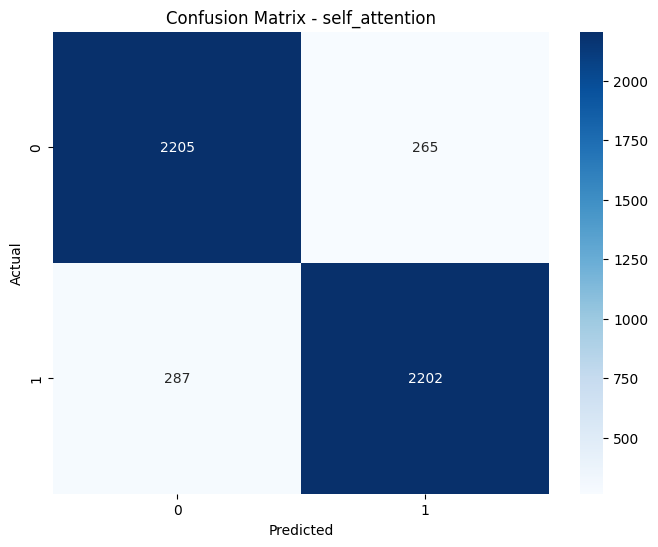

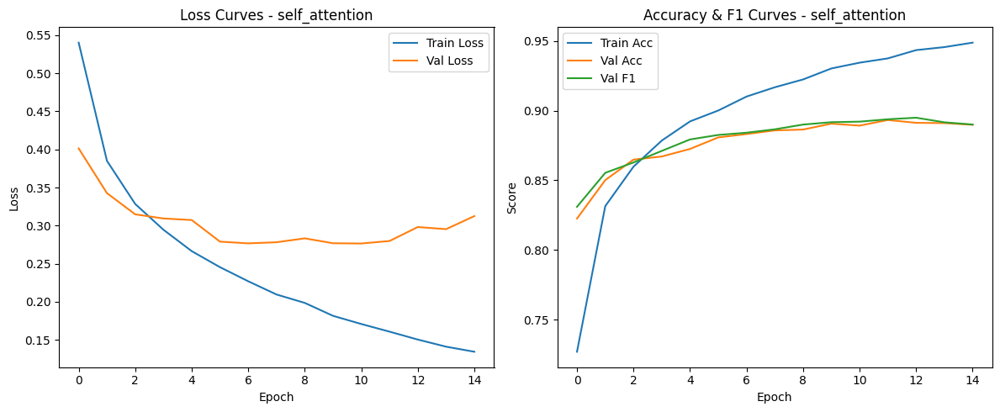


Huấn luyện mô hình với mha
Tổng số tham số của mô hình: 9,167,234
Bộ nhớ sử dụng: 0.00 MB
Epoch 1/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.4733 | Train Acc: 0.7725
Val Loss: 0.3826 | Val Acc: 0.8233 | Val F1: 0.8276
Epoch time: 21.93s
Epoch 2/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.3720 | Train Acc: 0.8371
Val Loss: 0.3407 | Val Acc: 0.8503 | Val F1: 0.8514
Epoch time: 21.85s
Epoch 3/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.3273 | Train Acc: 0.8597
Val Loss: 0.3204 | Val Acc: 0.8633 | Val F1: 0.8686
Epoch time: 21.92s
Epoch 4/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2992 | Train Acc: 0.8750
Val Loss: 0.3163 | Val Acc: 0.8647 | Val F1: 0.8715
Epoch time: 21.76s
Epoch 5/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2750 | Train Acc: 0.8849
Val Loss: 0.3030 | Val Acc: 0.8770 | Val F1: 0.8802
Epoch time: 21.87s
Epoch 6/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2551 | Train Acc: 0.8958
Val Loss: 0.2929 | Val Acc: 0.8808 | Val F1: 0.8835
Epoch time: 21.89s
Epoch 7/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2356 | Train Acc: 0.9048
Val Loss: 0.2835 | Val Acc: 0.8822 | Val F1: 0.8837
Epoch time: 21.97s
Epoch 8/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2211 | Train Acc: 0.9110
Val Loss: 0.2912 | Val Acc: 0.8852 | Val F1: 0.8885
Epoch time: 21.90s
Epoch 9/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2077 | Train Acc: 0.9168
Val Loss: 0.2892 | Val Acc: 0.8850 | Val F1: 0.8845
Epoch time: 21.90s
Epoch 10/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1943 | Train Acc: 0.9226
Val Loss: 0.3164 | Val Acc: 0.8864 | Val F1: 0.8873
Epoch time: 22.01s
Epoch 11/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1810 | Train Acc: 0.9271
Val Loss: 0.3072 | Val Acc: 0.8832 | Val F1: 0.8871
Epoch time: 22.00s
Epoch 12/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1713 | Train Acc: 0.9318
Val Loss: 0.3201 | Val Acc: 0.8866 | Val F1: 0.8862
Epoch time: 21.99s
Epoch 13/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1619 | Train Acc: 0.9372
Val Loss: 0.3171 | Val Acc: 0.8871 | Val F1: 0.8875
Epoch time: 21.89s
Epoch 14/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1498 | Train Acc: 0.9405
Val Loss: 0.3484 | Val Acc: 0.8834 | Val F1: 0.8886
Epoch time: 21.96s
Epoch 15/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1434 | Train Acc: 0.9434
Val Loss: 0.3263 | Val Acc: 0.8860 | Val F1: 0.8868
Epoch time: 21.93s
Đánh giá trên tập test...


Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Đo thời gian inference...
Test Loss: 0.3224
Test Accuracy: 0.8923
Test Precision: 0.8850
Test Recall: 0.9028
Test F1 Score: 0.8938
Thời gian huấn luyện: 328.77s
Thời gian inference trung bình: 4.20ms/batch


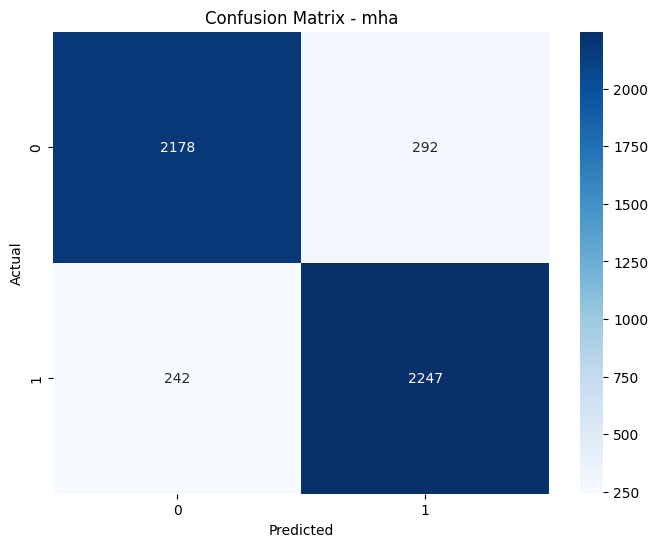

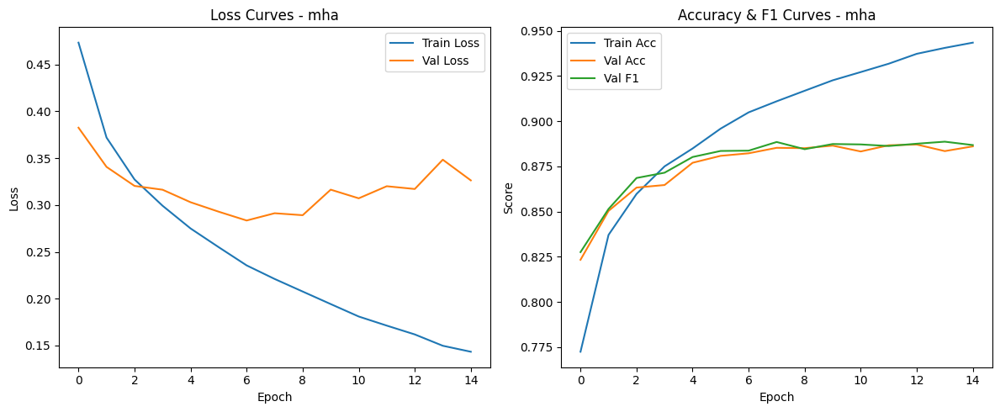


Huấn luyện mô hình với mqa
Tổng số tham số của mô hình: 9,052,098
Bộ nhớ sử dụng: 0.00 MB
Epoch 1/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.5018 | Train Acc: 0.7472
Val Loss: 0.3968 | Val Acc: 0.8221 | Val F1: 0.8156
Epoch time: 20.17s
Epoch 2/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.3691 | Train Acc: 0.8400
Val Loss: 0.3352 | Val Acc: 0.8592 | Val F1: 0.8583
Epoch time: 20.01s
Epoch 3/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.3226 | Train Acc: 0.8625
Val Loss: 0.3132 | Val Acc: 0.8675 | Val F1: 0.8668
Epoch time: 20.10s
Epoch 4/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2938 | Train Acc: 0.8765
Val Loss: 0.3257 | Val Acc: 0.8616 | Val F1: 0.8715
Epoch time: 20.13s
Epoch 5/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2703 | Train Acc: 0.8889
Val Loss: 0.3003 | Val Acc: 0.8766 | Val F1: 0.8794
Epoch time: 20.05s
Epoch 6/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2535 | Train Acc: 0.8981
Val Loss: 0.2806 | Val Acc: 0.8832 | Val F1: 0.8868
Epoch time: 20.16s
Epoch 7/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2329 | Train Acc: 0.9078
Val Loss: 0.2751 | Val Acc: 0.8860 | Val F1: 0.8875
Epoch time: 19.95s
Epoch 8/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2165 | Train Acc: 0.9136
Val Loss: 0.2901 | Val Acc: 0.8838 | Val F1: 0.8861
Epoch time: 20.31s
Epoch 9/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2035 | Train Acc: 0.9206
Val Loss: 0.2728 | Val Acc: 0.8864 | Val F1: 0.8901
Epoch time: 20.15s
Epoch 10/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1887 | Train Acc: 0.9252
Val Loss: 0.2846 | Val Acc: 0.8858 | Val F1: 0.8902
Epoch time: 20.26s
Epoch 11/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1803 | Train Acc: 0.9293
Val Loss: 0.2935 | Val Acc: 0.8840 | Val F1: 0.8878
Epoch time: 20.10s
Epoch 12/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1693 | Train Acc: 0.9330
Val Loss: 0.3308 | Val Acc: 0.8796 | Val F1: 0.8864
Epoch time: 20.11s
Epoch 13/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1563 | Train Acc: 0.9404
Val Loss: 0.3022 | Val Acc: 0.8875 | Val F1: 0.8876
Epoch time: 20.01s
Epoch 14/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1488 | Train Acc: 0.9413
Val Loss: 0.3008 | Val Acc: 0.8877 | Val F1: 0.8919
Epoch time: 20.01s
Epoch 15/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1396 | Train Acc: 0.9449
Val Loss: 0.3132 | Val Acc: 0.8879 | Val F1: 0.8914
Epoch time: 20.08s
Đánh giá trên tập test...


Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Đo thời gian inference...
Test Loss: 0.3186
Test Accuracy: 0.8818
Test Precision: 0.8611
Test Recall: 0.9116
Test F1 Score: 0.8856
Thời gian huấn luyện: 301.61s
Thời gian inference trung bình: 3.61ms/batch


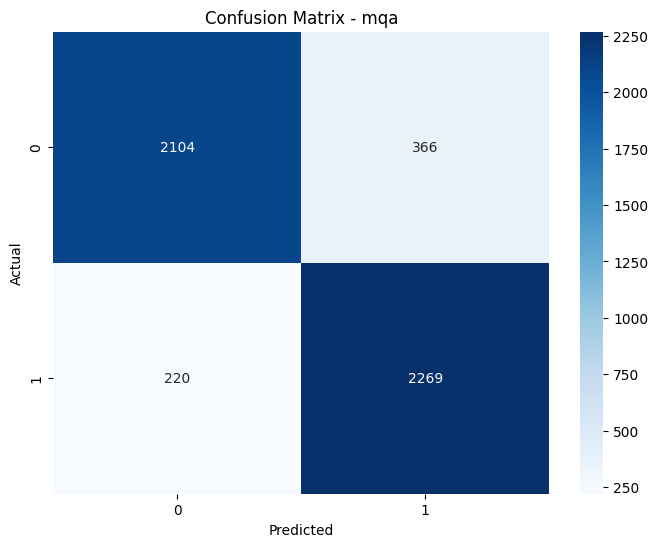

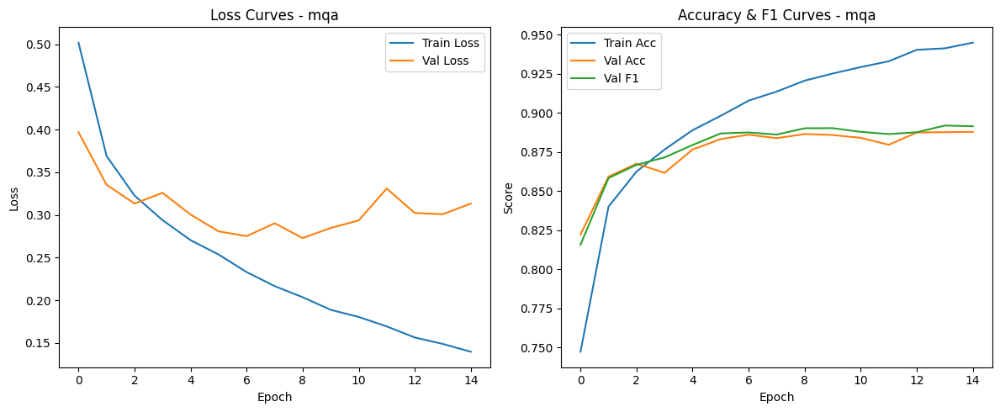


Huấn luyện mô hình với gqa
Tổng số tham số của mô hình: 9,068,546
Bộ nhớ sử dụng: 0.00 MB
Epoch 1/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.4912 | Train Acc: 0.7566
Val Loss: 0.3777 | Val Acc: 0.8324 | Val F1: 0.8343
Epoch time: 20.57s
Epoch 2/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.3702 | Train Acc: 0.8394
Val Loss: 0.3378 | Val Acc: 0.8546 | Val F1: 0.8582
Epoch time: 20.61s
Epoch 3/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.3243 | Train Acc: 0.8628
Val Loss: 0.3148 | Val Acc: 0.8667 | Val F1: 0.8658
Epoch time: 20.35s
Epoch 4/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2943 | Train Acc: 0.8768
Val Loss: 0.3011 | Val Acc: 0.8717 | Val F1: 0.8753
Epoch time: 20.48s
Epoch 5/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2684 | Train Acc: 0.8892
Val Loss: 0.3021 | Val Acc: 0.8808 | Val F1: 0.8816
Epoch time: 20.73s
Epoch 6/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2537 | Train Acc: 0.8975
Val Loss: 0.2985 | Val Acc: 0.8840 | Val F1: 0.8865
Epoch time: 20.24s
Epoch 7/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2355 | Train Acc: 0.9050
Val Loss: 0.2924 | Val Acc: 0.8822 | Val F1: 0.8806
Epoch time: 20.65s
Epoch 8/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2211 | Train Acc: 0.9117
Val Loss: 0.2864 | Val Acc: 0.8790 | Val F1: 0.8775
Epoch time: 20.33s
Epoch 9/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2044 | Train Acc: 0.9180
Val Loss: 0.2979 | Val Acc: 0.8860 | Val F1: 0.8886
Epoch time: 20.59s
Epoch 10/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1923 | Train Acc: 0.9230
Val Loss: 0.3030 | Val Acc: 0.8881 | Val F1: 0.8897
Epoch time: 20.76s
Epoch 11/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1818 | Train Acc: 0.9280
Val Loss: 0.3243 | Val Acc: 0.8881 | Val F1: 0.8871
Epoch time: 20.67s
Epoch 12/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1699 | Train Acc: 0.9326
Val Loss: 0.3222 | Val Acc: 0.8929 | Val F1: 0.8934
Epoch time: 20.62s
Epoch 13/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1584 | Train Acc: 0.9369
Val Loss: 0.3110 | Val Acc: 0.8858 | Val F1: 0.8880
Epoch time: 20.31s
Epoch 14/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1488 | Train Acc: 0.9412
Val Loss: 0.3312 | Val Acc: 0.8883 | Val F1: 0.8916
Epoch time: 20.63s
Epoch 15/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1417 | Train Acc: 0.9447
Val Loss: 0.3424 | Val Acc: 0.8840 | Val F1: 0.8864
Epoch time: 20.28s
Đánh giá trên tập test...


Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Đo thời gian inference...
Test Loss: 0.3414
Test Accuracy: 0.8867
Test Precision: 0.8724
Test Recall: 0.9068
Test F1 Score: 0.8893
Thời gian huấn luyện: 307.83s
Thời gian inference trung bình: 3.71ms/batch


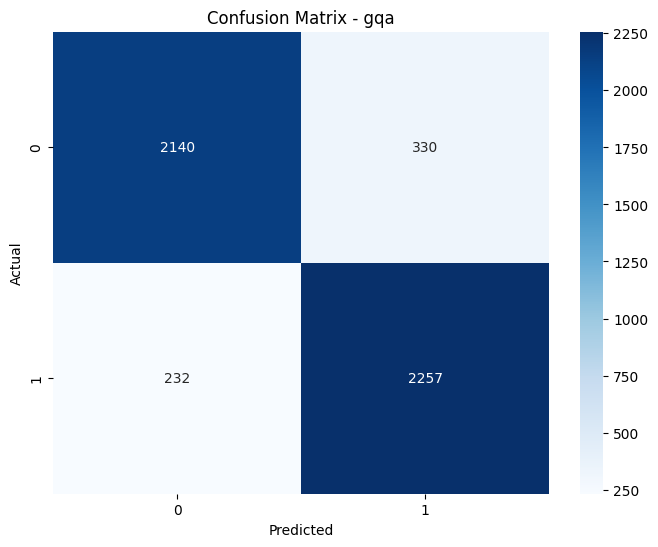

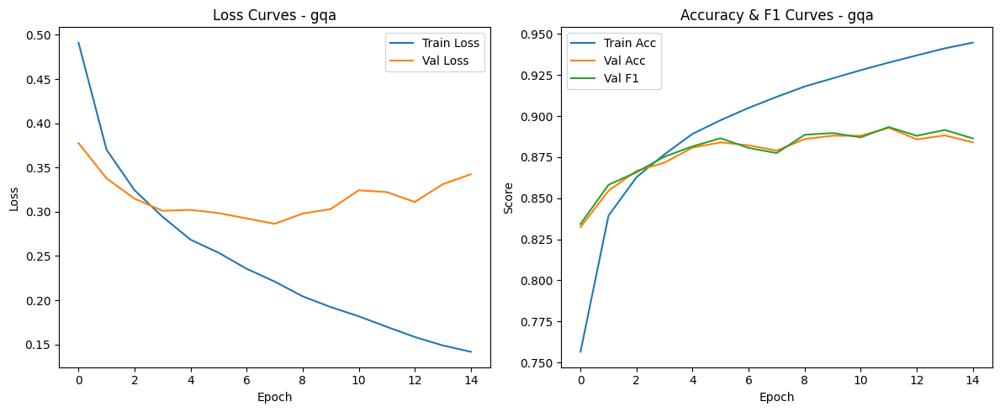


Huấn luyện mô hình với flash
Tổng số tham số của mô hình: 9,101,442
Bộ nhớ sử dụng: 0.00 MB
Epoch 1/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.5377 | Train Acc: 0.7313
Val Loss: 0.4133 | Val Acc: 0.8088 | Val F1: 0.8178
Epoch time: 15.20s
Epoch 2/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.3876 | Train Acc: 0.8299
Val Loss: 0.3430 | Val Acc: 0.8505 | Val F1: 0.8525
Epoch time: 15.18s
Epoch 3/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.3310 | Train Acc: 0.8608
Val Loss: 0.3186 | Val Acc: 0.8574 | Val F1: 0.8566
Epoch time: 15.29s
Epoch 4/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2973 | Train Acc: 0.8775
Val Loss: 0.3041 | Val Acc: 0.8685 | Val F1: 0.8668
Epoch time: 15.32s
Epoch 5/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2721 | Train Acc: 0.8901
Val Loss: 0.2997 | Val Acc: 0.8723 | Val F1: 0.8757
Epoch time: 15.42s
Epoch 6/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2497 | Train Acc: 0.9001
Val Loss: 0.3056 | Val Acc: 0.8745 | Val F1: 0.8808
Epoch time: 15.11s
Epoch 7/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2318 | Train Acc: 0.9085
Val Loss: 0.2835 | Val Acc: 0.8860 | Val F1: 0.8866
Epoch time: 15.51s
Epoch 8/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2153 | Train Acc: 0.9156
Val Loss: 0.2875 | Val Acc: 0.8887 | Val F1: 0.8904
Epoch time: 15.83s
Epoch 9/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2009 | Train Acc: 0.9224
Val Loss: 0.2833 | Val Acc: 0.8822 | Val F1: 0.8867
Epoch time: 15.34s
Epoch 10/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1890 | Train Acc: 0.9281
Val Loss: 0.2791 | Val Acc: 0.8903 | Val F1: 0.8915
Epoch time: 15.21s
Epoch 11/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1746 | Train Acc: 0.9331
Val Loss: 0.2983 | Val Acc: 0.8919 | Val F1: 0.8929
Epoch time: 15.07s
Epoch 12/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1650 | Train Acc: 0.9358
Val Loss: 0.2976 | Val Acc: 0.8925 | Val F1: 0.8935
Epoch time: 15.19s
Epoch 13/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1526 | Train Acc: 0.9422
Val Loss: 0.2988 | Val Acc: 0.8911 | Val F1: 0.8923
Epoch time: 15.08s
Epoch 14/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1437 | Train Acc: 0.9457
Val Loss: 0.2963 | Val Acc: 0.8897 | Val F1: 0.8911
Epoch time: 15.14s
Epoch 15/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1341 | Train Acc: 0.9488
Val Loss: 0.3305 | Val Acc: 0.8921 | Val F1: 0.8948
Epoch time: 15.38s
Đánh giá trên tập test...


Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Đo thời gian inference...
Test Loss: 0.3228
Test Accuracy: 0.8917
Test Precision: 0.8786
Test Recall: 0.9100
Test F1 Score: 0.8940
Thời gian huấn luyện: 229.27s
Thời gian inference trung bình: 2.99ms/batch


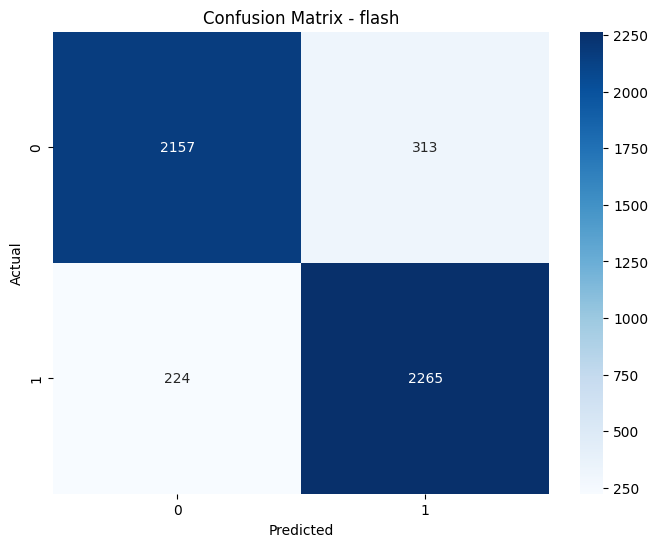

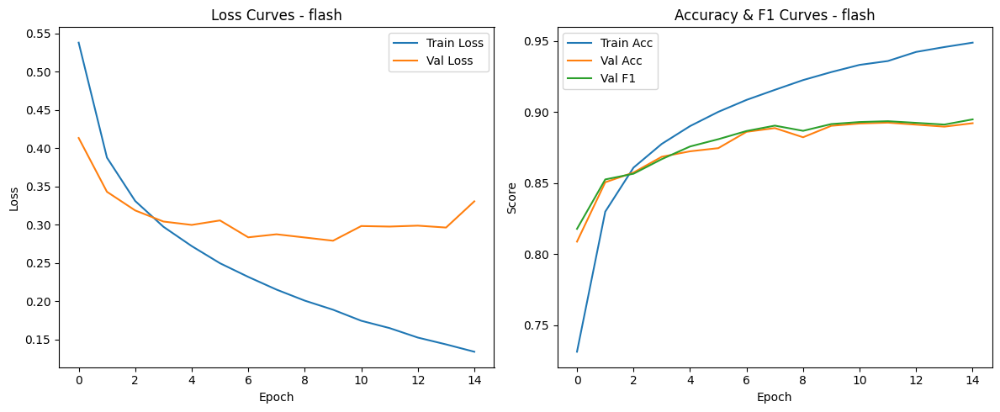


Huấn luyện mô hình với linear
Tổng số tham số của mô hình: 9,101,442
Bộ nhớ sử dụng: 0.00 MB
Epoch 1/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.4780 | Train Acc: 0.7631
Val Loss: 0.3649 | Val Acc: 0.8407 | Val F1: 0.8444
Epoch time: 16.65s
Epoch 2/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.3509 | Train Acc: 0.8482
Val Loss: 0.3203 | Val Acc: 0.8610 | Val F1: 0.8634
Epoch time: 16.41s
Epoch 3/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.3060 | Train Acc: 0.8728
Val Loss: 0.2986 | Val Acc: 0.8715 | Val F1: 0.8739
Epoch time: 16.35s
Epoch 4/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2738 | Train Acc: 0.8870
Val Loss: 0.2876 | Val Acc: 0.8800 | Val F1: 0.8817
Epoch time: 16.19s
Epoch 5/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2509 | Train Acc: 0.8983
Val Loss: 0.2894 | Val Acc: 0.8854 | Val F1: 0.8861
Epoch time: 16.11s
Epoch 6/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2316 | Train Acc: 0.9073
Val Loss: 0.2895 | Val Acc: 0.8875 | Val F1: 0.8875
Epoch time: 16.12s
Epoch 7/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2119 | Train Acc: 0.9169
Val Loss: 0.2895 | Val Acc: 0.8862 | Val F1: 0.8892
Epoch time: 16.40s
Epoch 8/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1961 | Train Acc: 0.9224
Val Loss: 0.3012 | Val Acc: 0.8868 | Val F1: 0.8879
Epoch time: 16.65s
Epoch 9/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1828 | Train Acc: 0.9298
Val Loss: 0.2994 | Val Acc: 0.8891 | Val F1: 0.8914
Epoch time: 16.28s
Epoch 10/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1701 | Train Acc: 0.9330
Val Loss: 0.3137 | Val Acc: 0.8879 | Val F1: 0.8902
Epoch time: 16.43s
Epoch 11/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1576 | Train Acc: 0.9401
Val Loss: 0.3189 | Val Acc: 0.8899 | Val F1: 0.8894
Epoch time: 16.42s
Epoch 12/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1476 | Train Acc: 0.9426
Val Loss: 0.3328 | Val Acc: 0.8864 | Val F1: 0.8855
Epoch time: 16.28s
Epoch 13/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1354 | Train Acc: 0.9488
Val Loss: 0.3543 | Val Acc: 0.8881 | Val F1: 0.8892
Epoch time: 16.40s
Epoch 14/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1231 | Train Acc: 0.9525
Val Loss: 0.3451 | Val Acc: 0.8860 | Val F1: 0.8877
Epoch time: 16.65s
Epoch 15/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1173 | Train Acc: 0.9550
Val Loss: 0.3730 | Val Acc: 0.8862 | Val F1: 0.8875
Epoch time: 16.39s
Đánh giá trên tập test...


Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Đo thời gian inference...
Test Loss: 0.3727
Test Accuracy: 0.8834
Test Precision: 0.8796
Test Recall: 0.8895
Test F1 Score: 0.8845
Thời gian huấn luyện: 245.73s
Thời gian inference trung bình: 3.20ms/batch


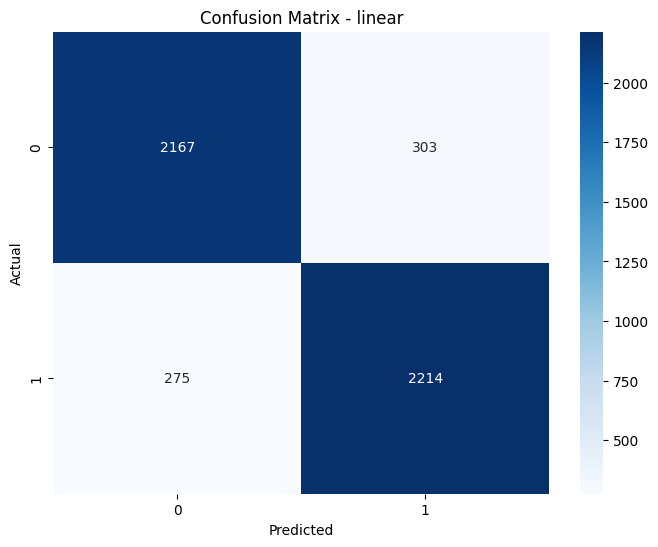

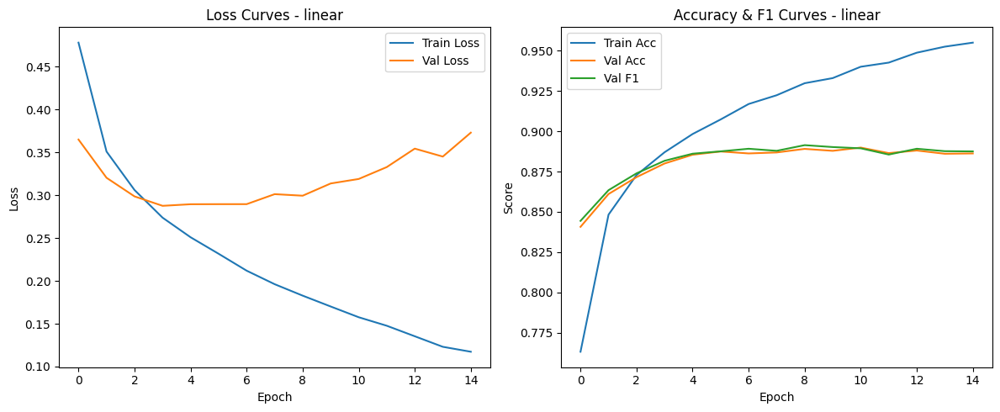


Huấn luyện mô hình với sparse
Tổng số tham số của mô hình: 9,167,234
Bộ nhớ sử dụng: 0.00 MB
Epoch 1/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.4848 | Train Acc: 0.7584
Val Loss: 0.3982 | Val Acc: 0.8177 | Val F1: 0.8253
Epoch time: 87.53s
Epoch 2/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.3810 | Train Acc: 0.8295
Val Loss: 0.3481 | Val Acc: 0.8397 | Val F1: 0.8431
Epoch time: 89.00s
Epoch 3/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.3379 | Train Acc: 0.8527
Val Loss: 0.3269 | Val Acc: 0.8536 | Val F1: 0.8548
Epoch time: 87.91s
Epoch 4/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.3080 | Train Acc: 0.8682
Val Loss: 0.3095 | Val Acc: 0.8661 | Val F1: 0.8662
Epoch time: 78.65s
Epoch 5/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2846 | Train Acc: 0.8810
Val Loss: 0.2995 | Val Acc: 0.8671 | Val F1: 0.8703
Epoch time: 74.90s
Epoch 6/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2672 | Train Acc: 0.8902
Val Loss: 0.2897 | Val Acc: 0.8776 | Val F1: 0.8777
Epoch time: 74.98s
Epoch 7/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2457 | Train Acc: 0.9012
Val Loss: 0.3111 | Val Acc: 0.8725 | Val F1: 0.8789
Epoch time: 76.55s
Epoch 8/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2344 | Train Acc: 0.9038
Val Loss: 0.2917 | Val Acc: 0.8854 | Val F1: 0.8886
Epoch time: 76.55s
Epoch 9/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2153 | Train Acc: 0.9124
Val Loss: 0.2876 | Val Acc: 0.8830 | Val F1: 0.8812
Epoch time: 76.63s
Epoch 10/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2053 | Train Acc: 0.9196
Val Loss: 0.2849 | Val Acc: 0.8877 | Val F1: 0.8867
Epoch time: 77.88s
Epoch 11/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1923 | Train Acc: 0.9238
Val Loss: 0.2886 | Val Acc: 0.8858 | Val F1: 0.8892
Epoch time: 77.44s
Epoch 12/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1813 | Train Acc: 0.9277
Val Loss: 0.3592 | Val Acc: 0.8564 | Val F1: 0.8696
Epoch time: 77.21s
Epoch 13/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1702 | Train Acc: 0.9330
Val Loss: 0.2886 | Val Acc: 0.8856 | Val F1: 0.8879
Epoch time: 77.35s
Epoch 14/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1633 | Train Acc: 0.9351
Val Loss: 0.2999 | Val Acc: 0.8903 | Val F1: 0.8915
Epoch time: 76.80s
Epoch 15/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1525 | Train Acc: 0.9412
Val Loss: 0.3189 | Val Acc: 0.8828 | Val F1: 0.8876
Epoch time: 77.74s
Đánh giá trên tập test...


Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Đo thời gian inference...
Test Loss: 0.3192
Test Accuracy: 0.8770
Test Precision: 0.8504
Test Recall: 0.9160
Test F1 Score: 0.8820
Thời gian huấn luyện: 1187.11s
Thời gian inference trung bình: 38.05ms/batch


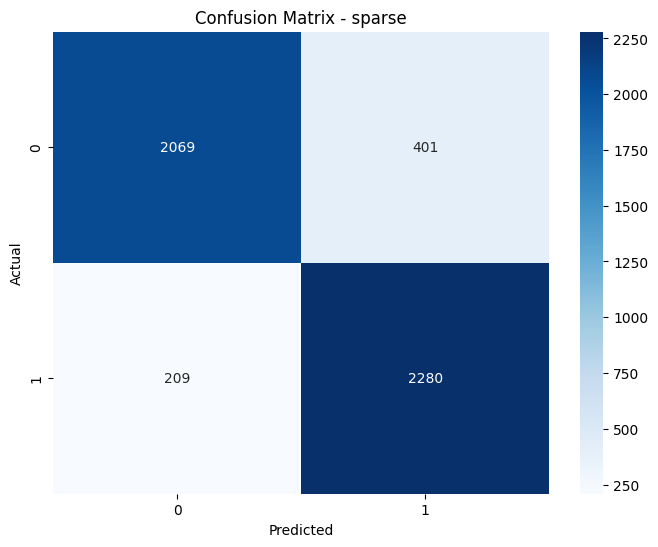

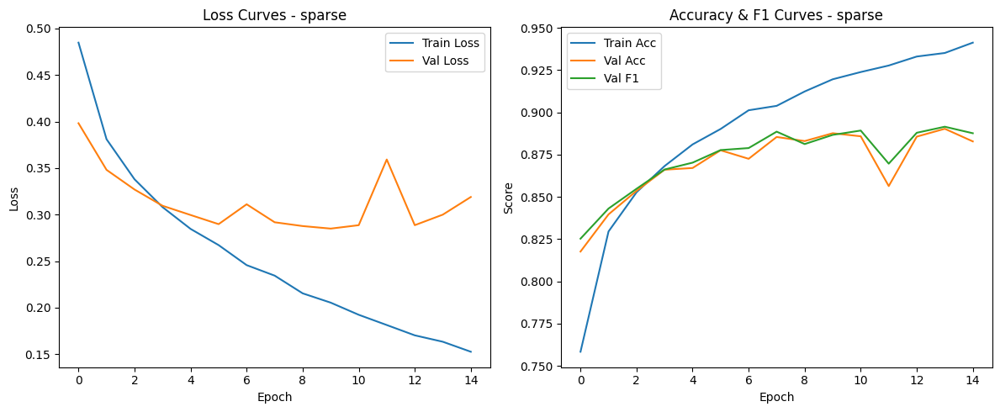


Huấn luyện mô hình với rope
Tổng số tham số của mô hình: 9,101,442
Bộ nhớ sử dụng: 0.00 MB
Epoch 1/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.5620 | Train Acc: 0.7056
Val Loss: 0.4492 | Val Acc: 0.7850 | Val F1: 0.8024
Epoch time: 15.97s
Epoch 2/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.4149 | Train Acc: 0.8118
Val Loss: 0.3679 | Val Acc: 0.8342 | Val F1: 0.8359
Epoch time: 15.80s
Epoch 3/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.3535 | Train Acc: 0.8455
Val Loss: 0.3340 | Val Acc: 0.8495 | Val F1: 0.8489
Epoch time: 15.97s
Epoch 4/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.3137 | Train Acc: 0.8657
Val Loss: 0.3182 | Val Acc: 0.8598 | Val F1: 0.8596
Epoch time: 16.14s
Epoch 5/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2838 | Train Acc: 0.8806
Val Loss: 0.3084 | Val Acc: 0.8661 | Val F1: 0.8710
Epoch time: 15.78s
Epoch 6/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2604 | Train Acc: 0.8927
Val Loss: 0.2972 | Val Acc: 0.8727 | Val F1: 0.8721
Epoch time: 15.82s
Epoch 7/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2403 | Train Acc: 0.9026
Val Loss: 0.2969 | Val Acc: 0.8739 | Val F1: 0.8746
Epoch time: 15.86s
Epoch 8/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2201 | Train Acc: 0.9124
Val Loss: 0.3003 | Val Acc: 0.8790 | Val F1: 0.8807
Epoch time: 15.72s
Epoch 9/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2057 | Train Acc: 0.9174
Val Loss: 0.3005 | Val Acc: 0.8790 | Val F1: 0.8806
Epoch time: 15.48s
Epoch 10/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1870 | Train Acc: 0.9268
Val Loss: 0.2971 | Val Acc: 0.8784 | Val F1: 0.8804
Epoch time: 15.58s
Epoch 11/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1732 | Train Acc: 0.9323
Val Loss: 0.3070 | Val Acc: 0.8792 | Val F1: 0.8814
Epoch time: 15.85s
Epoch 12/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1570 | Train Acc: 0.9398
Val Loss: 0.3372 | Val Acc: 0.8776 | Val F1: 0.8821
Epoch time: 16.07s
Epoch 13/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1435 | Train Acc: 0.9449
Val Loss: 0.3282 | Val Acc: 0.8780 | Val F1: 0.8816
Epoch time: 15.90s
Epoch 14/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1323 | Train Acc: 0.9487
Val Loss: 0.3331 | Val Acc: 0.8804 | Val F1: 0.8818
Epoch time: 15.74s
Epoch 15/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1200 | Train Acc: 0.9540
Val Loss: 0.3409 | Val Acc: 0.8802 | Val F1: 0.8793
Epoch time: 16.05s
Đánh giá trên tập test...


Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Đo thời gian inference...
Test Loss: 0.3541
Test Accuracy: 0.8740
Test Precision: 0.8789
Test Recall: 0.8686
Test F1 Score: 0.8737
Thời gian huấn luyện: 237.74s
Thời gian inference trung bình: 3.36ms/batch


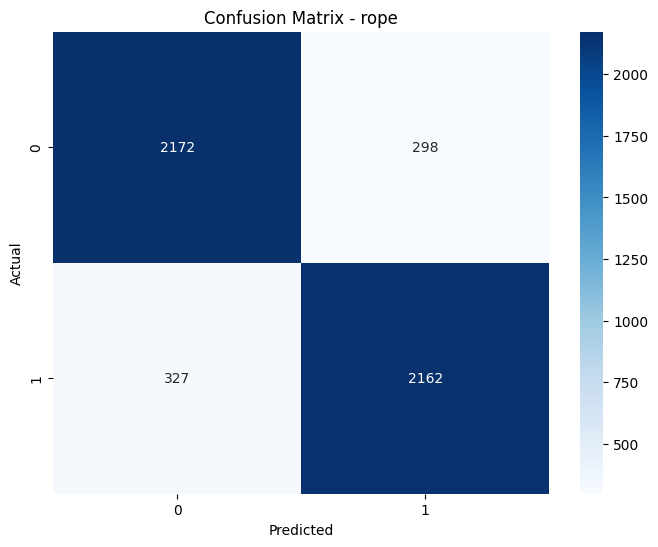

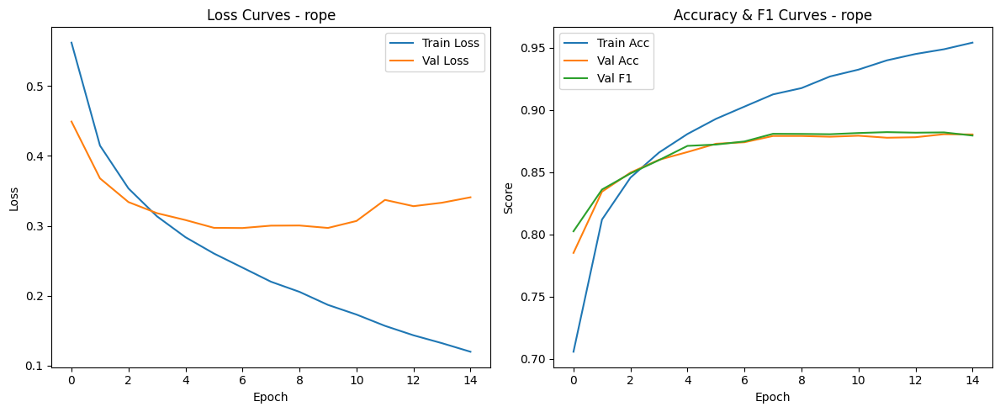


Huấn luyện mô hình với bigbird
Tổng số tham số của mô hình: 9,101,442
Bộ nhớ sử dụng: 0.00 MB
Epoch 1/15


<ipython-input-10-57a40c236e64>:26: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at /pytorch/torch/csrc/utils/tensor_new.cpp:254.)
  rand_attn = torch.tensor(rand_attn, dtype=torch.long).unsqueeze(0).expand(batch_size, -1, -1)


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.5749 | Train Acc: 0.6894
Val Loss: 0.4784 | Val Acc: 0.7695 | Val F1: 0.7655
Epoch time: 241.86s
Epoch 2/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.4573 | Train Acc: 0.7850
Val Loss: 0.4076 | Val Acc: 0.8086 | Val F1: 0.8236
Epoch time: 235.69s
Epoch 3/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.3906 | Train Acc: 0.8267
Val Loss: 0.3640 | Val Acc: 0.8358 | Val F1: 0.8430
Epoch time: 231.86s
Epoch 4/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.3499 | Train Acc: 0.8498
Val Loss: 0.3545 | Val Acc: 0.8435 | Val F1: 0.8531
Epoch time: 232.32s
Epoch 5/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.3209 | Train Acc: 0.8639
Val Loss: 0.3203 | Val Acc: 0.8626 | Val F1: 0.8643
Epoch time: 231.69s
Epoch 6/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2994 | Train Acc: 0.8757
Val Loss: 0.3390 | Val Acc: 0.8542 | Val F1: 0.8639
Epoch time: 231.52s
Epoch 7/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2760 | Train Acc: 0.8870
Val Loss: 0.3119 | Val Acc: 0.8669 | Val F1: 0.8727
Epoch time: 232.67s
Epoch 8/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2590 | Train Acc: 0.8935
Val Loss: 0.3102 | Val Acc: 0.8731 | Val F1: 0.8727
Epoch time: 233.46s
Epoch 9/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2465 | Train Acc: 0.9003
Val Loss: 0.3085 | Val Acc: 0.8754 | Val F1: 0.8711
Epoch time: 233.18s
Epoch 10/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2311 | Train Acc: 0.9065
Val Loss: 0.3063 | Val Acc: 0.8721 | Val F1: 0.8749
Epoch time: 233.19s
Epoch 11/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2147 | Train Acc: 0.9136
Val Loss: 0.3003 | Val Acc: 0.8774 | Val F1: 0.8791
Epoch time: 233.22s
Epoch 12/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.2052 | Train Acc: 0.9187
Val Loss: 0.3189 | Val Acc: 0.8701 | Val F1: 0.8752
Epoch time: 232.71s
Epoch 13/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1968 | Train Acc: 0.9224
Val Loss: 0.3301 | Val Acc: 0.8596 | Val F1: 0.8672
Epoch time: 232.98s
Epoch 14/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1865 | Train Acc: 0.9264
Val Loss: 0.3575 | Val Acc: 0.8649 | Val F1: 0.8722
Epoch time: 232.78s
Epoch 15/15


Training:   0%|          | 0/1240 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Train Loss: 0.1708 | Train Acc: 0.9335
Val Loss: 0.3393 | Val Acc: 0.8731 | Val F1: 0.8738
Epoch time: 232.87s
Đánh giá trên tập test...


Evaluating:   0%|          | 0/155 [00:00<?, ?it/s]

Đo thời gian inference...
Test Loss: 0.3319
Test Accuracy: 0.8770
Test Precision: 0.8733
Test Recall: 0.8831
Test F1 Score: 0.8781
Thời gian huấn luyện: 3502.01s
Thời gian inference trung bình: 34.69ms/batch


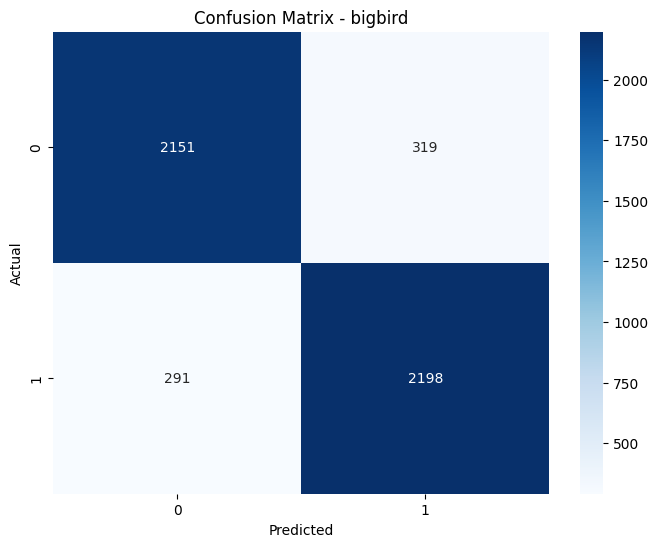

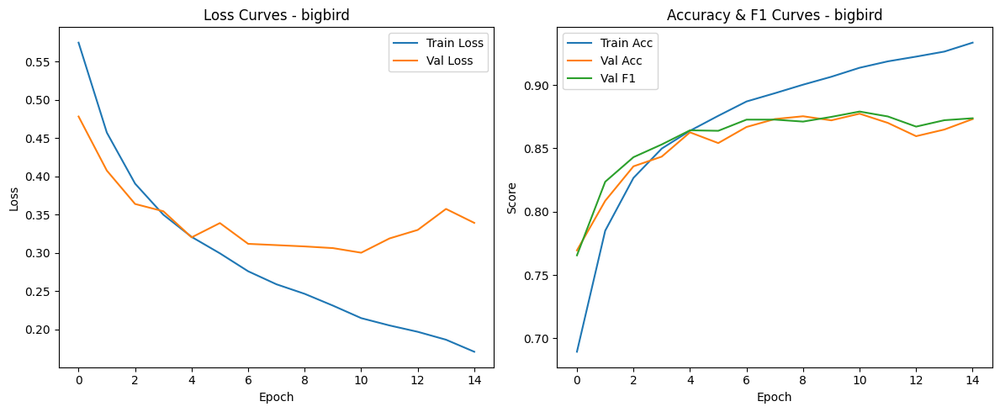


Kết quả so sánh các loại Attention:
   attention_type  test_loss  test_acc  test_precision  test_recall   test_f1  \
0  self_attention   0.323953  0.888687        0.892582     0.884693  0.888620   
1             mha   0.322360  0.892317        0.884994     0.902772  0.893795   
2             mqa   0.318612  0.881831        0.861101     0.911611  0.885636   
3             gqa   0.341371  0.886671        0.872439     0.906790  0.889283   
4           flash   0.322844  0.891712        0.878588     0.910004  0.894020   
5          linear   0.372727  0.883444        0.879619     0.889514  0.884539   
6          sparse   0.319220  0.876991        0.850429     0.916031  0.882012   
7            rope   0.354113  0.873967        0.878862     0.868622  0.873712   
8         bigbird   0.331942  0.876991        0.873262     0.883086  0.878146   

    train_time  inference_time  memory_usage  
0   213.754452        0.001940      0.000169  
1   328.770693        0.004200      0.000000  
2   301.612

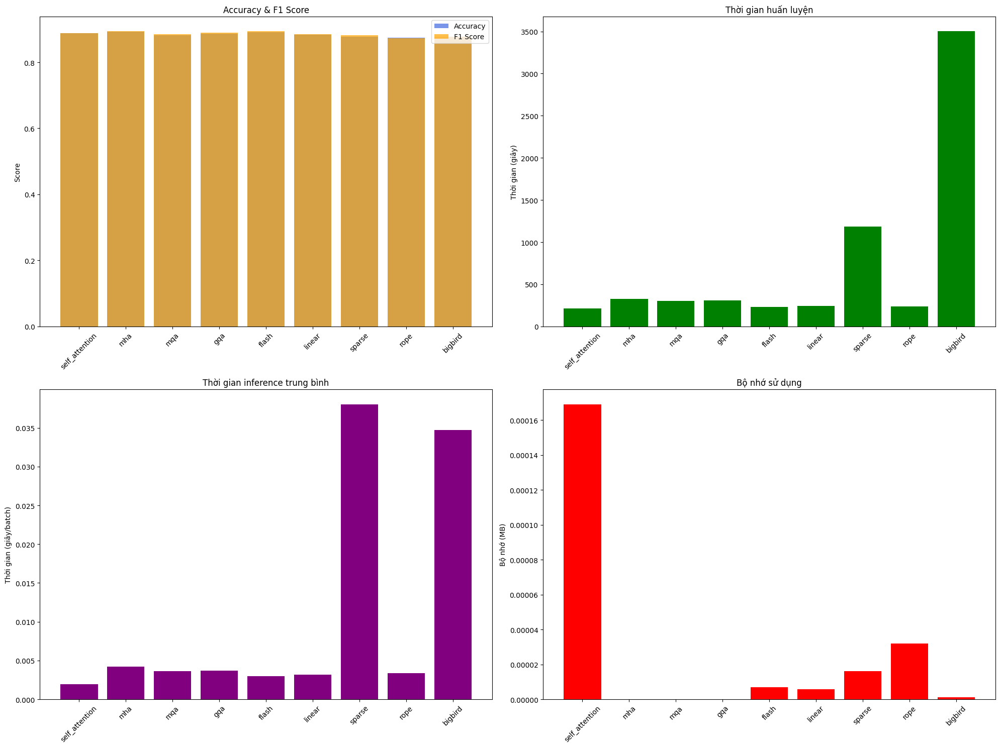

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import math
import time
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from sklearn.metrics import accuracy_score, precision_recall_fscore_support, confusion_matrix
import seaborn as sns
import gc
import pandas as pd
import psutil
import os

# Mô hình cơ bản cho phân loại sentiment với các loại attention khác nhau
class SentimentClassifier(nn.Module):
    def __init__(self, vocab_size, embed_dim, hidden_dim, output_dim, attention_type,
                 num_heads=8, num_kv_groups=2, dropout=0.2):
        super().__init__()
        self.embedding = nn.Embedding(vocab_size, embed_dim)
        self.embedding_dropout = nn.Dropout(dropout)
        self.attention_type = attention_type
        self.use_rope = (attention_type == 'rope')

        # Khởi tạo layer attention tương ứng
        if attention_type == 'self_attention' or attention_type == 'rope':
            self.attention = SelfAttention(embed_dim)
        elif attention_type == 'mha':
            self.attention = MultiHeadAttention(embed_dim, num_heads)
        elif attention_type == 'mqa':
            self.attention = MultiQueryAttention(embed_dim, num_heads)
        elif attention_type == 'gqa':
            self.attention = GroupQueryAttention(embed_dim, num_heads, num_kv_groups)
        elif attention_type == 'flash':
            self.attention = FlashAttention(embed_dim)
        elif attention_type == 'linear':
            self.attention = LinearAttention(embed_dim)
        elif attention_type == 'sparse':
            self.attention = SparseMultiHeadAttention(embed_dim, num_heads, window_size=3, stride=2)
        elif attention_type == 'bigbird':
            self.attention = BigBirdAttention(embed_dim, block_size=16, num_global_blocks=2)
        else:
            raise ValueError(f"Loại attention không hỗ trợ: {attention_type}")

        self.fc1 = nn.Linear(embed_dim, hidden_dim)
        self.dropout = nn.Dropout(dropout)
        self.fc2 = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        # x: [batch_size, seq_len]
        embedded = self.embedding(x)  # [batch_size, seq_len, embed_dim]
        embedded = self.embedding_dropout(embedded)

        # Áp dụng RoPE nếu được chọn
        if self.use_rope:
            embedded = apply_rope(embedded)

        attn_output, attention_weights = self.attention(embedded)

        # Global Average Pooling
        pooled = attn_output.mean(dim=1)  # [batch_size, embed_dim]

        # FC layers
        hidden = F.relu(self.fc1(pooled))
        hidden = self.dropout(hidden)
        output = self.fc2(hidden)

        return output, attention_weights
# Hàm huấn luyện
def train_epoch(model, dataloader, optimizer, criterion, device):
    model.train()
    epoch_loss = 0
    epoch_acc = 0

    progress_bar = tqdm(dataloader, desc='Training', leave=False)
    for batch in progress_bar:
        optimizer.zero_grad()

        input_ids = batch['input_ids'].to(device)
        labels = batch['labels'].to(device)

        # Forward pass
        predictions, _ = model(input_ids)
        loss = criterion(predictions, labels)

        # Backward pass
        loss.backward()
        optimizer.step()

        # Tính accuracy
        preds = torch.argmax(predictions, dim=1)
        acc = (preds == labels).float().mean()

        epoch_loss += loss.item()
        epoch_acc += acc.item()

        # Cập nhật progress bar
        progress_bar.set_postfix({'loss': loss.item(), 'acc': acc.item()})

    return epoch_loss / len(dataloader), epoch_acc / len(dataloader)

# Hàm đánh giá
def evaluate(model, dataloader, criterion, device):
    model.eval()
    epoch_loss = 0
    epoch_acc = 0
    all_preds = []
    all_labels = []

    with torch.no_grad():
        for batch in tqdm(dataloader, desc='Evaluating', leave=False):
            input_ids = batch['input_ids'].to(device)
            labels = batch['labels'].to(device)

            # Forward pass
            predictions, _ = model(input_ids)
            loss = criterion(predictions, labels)

            # Tính accuracy
            preds = torch.argmax(predictions, dim=1)
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

            epoch_loss += loss.item()

    # Tính metrics
    acc = accuracy_score(all_labels, all_preds)
    precision, recall, f1, _ = precision_recall_fscore_support(all_labels, all_preds, average='binary')

    return epoch_loss / len(dataloader), acc, precision, recall, f1, all_preds, all_labels

# Hàm đo thời gian inference
def measure_inference_time(model, dataloader, device, num_runs=5):
    model.eval()

    with torch.no_grad():
        # Chạy warm-up
        for batch in dataloader:
            input_ids = batch['input_ids'].to(device)
            model(input_ids)
            break

        # Đo thời gian thực tế
        start_time = time.time()
        for _ in range(num_runs):
            for batch in dataloader:
                input_ids = batch['input_ids'].to(device)
                model(input_ids)
        end_time = time.time()

    avg_time = (end_time - start_time) / (num_runs * len(dataloader))
    return avg_time

# Hàm đo bộ nhớ sử dụng
def measure_memory_usage(model, sample_input, device):
    # Giải phóng bộ nhớ cache
    if device == 'cuda':
        torch.cuda.empty_cache()

    # Đo bộ nhớ trước khi chạy mô hình
    if device == 'cuda':
        before = torch.cuda.memory_allocated()
    else:
        before = psutil.Process(os.getpid()).memory_info().rss / 1024 / 1024

    # Chạy forward pass
    model.eval()
    with torch.no_grad():
        input_ids = sample_input.to(device)
        model(input_ids)

    # Đo bộ nhớ sau khi chạy
    if device == 'cuda':
        after = torch.cuda.memory_allocated()
    else:
        after = psutil.Process(os.getpid()).memory_info().rss / 1024 / 1024

    memory_used = after - before
    return memory_used

# Các tham số cố định cho tất cả các mô hình
VOCAB_SIZE = len(word_to_idx)
EMBED_DIM = 256
HIDDEN_DIM = 128
OUTPUT_DIM = 2
NUM_HEADS = 8
NUM_KV_GROUPS = 2
DROPOUT = 0.2
LEARNING_RATE = 2e-4
EPOCHS = 15
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Danh sách các loại attention cần đánh giá
attention_types = [
    'self_attention',
    'mha',
    'mqa',
    'gqa',
    'flash',
    'linear',
    'sparse',
    'rope',  # Sử dụng self-attention + RoPE
    'bigbird'
]

# Lưu kết quả để so sánh
results = {
    'attention_type': [],
    'test_loss': [],
    'test_acc': [],
    'test_precision': [],
    'test_recall': [],
    'test_f1': [],
    'train_time': [],
    'inference_time': [],
    'memory_usage': []
}

# Chạy thử nghiệm với từng loại attention
for attention_type in attention_types:
    print(f"\n{'=' * 50}")
    print(f"Huấn luyện mô hình với {attention_type}")
    print(f"{'=' * 50}")

    # Khởi tạo mô hình
    model = SentimentClassifier(
        vocab_size=VOCAB_SIZE,
        embed_dim=EMBED_DIM,
        hidden_dim=HIDDEN_DIM,
        output_dim=OUTPUT_DIM,
        attention_type=attention_type,
        num_heads=NUM_HEADS,
        num_kv_groups=NUM_KV_GROUPS,
        dropout=DROPOUT
    ).to(DEVICE)

    # Đếm số tham số
    total_params = sum(p.numel() for p in model.parameters())
    print(f"Tổng số tham số của mô hình: {total_params:,}")

    # Khởi tạo optimizer và loss function
    optimizer = optim.Adam(model.parameters(), lr=LEARNING_RATE)
    criterion = nn.CrossEntropyLoss()

    # Metric tracking
    train_losses = []
    train_accs = []
    val_losses = []
    val_accs = []
    val_f1s = []
    best_val_loss = float('inf')
    best_val_acc = 0

    # Đo thời gian huấn luyện
    total_train_time = 0

    # Lấy sample input cho đo bộ nhớ
    sample_batch = next(iter(train_dataloader))
    sample_input = sample_batch['input_ids'][:1]  # Lấy 1 mẫu

    # Đo bộ nhớ
    memory_used = measure_memory_usage(model, sample_input, DEVICE)
    print(f"Bộ nhớ sử dụng: {memory_used / (1024*1024):.2f} MB")

    # Training loop
    for epoch in range(EPOCHS):
        print(f"Epoch {epoch+1}/{EPOCHS}")

        # Training
        start_time = time.time()
        train_loss, train_acc = train_epoch(model, train_dataloader, optimizer, criterion, DEVICE)
        epoch_time = time.time() - start_time
        total_train_time += epoch_time

        # Validation
        val_loss, val_acc, val_precision, val_recall, val_f1, _, _ = evaluate(model, val_dataloader, criterion, DEVICE)

        # Lưu metrics
        train_losses.append(train_loss)
        train_accs.append(train_acc)
        val_losses.append(val_loss)
        val_accs.append(val_acc)
        val_f1s.append(val_f1)

        # Hiển thị kết quả
        print(f"Train Loss: {train_loss:.4f} | Train Acc: {train_acc:.4f}")
        print(f"Val Loss: {val_loss:.4f} | Val Acc: {val_acc:.4f} | Val F1: {val_f1:.4f}")
        print(f"Epoch time: {epoch_time:.2f}s")

        # Lưu mô hình tốt nhất
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            torch.save(model.state_dict(), f'best_model_{attention_type}.pt')

    # Đánh giá trên tập test
    print("Đánh giá trên tập test...")
    test_loss, test_acc, test_precision, test_recall, test_f1, test_preds, test_labels = evaluate(
        model, test_dataloader, criterion, DEVICE)

    # Đo thời gian inference
    print("Đo thời gian inference...")
    inference_time = measure_inference_time(model, test_dataloader, DEVICE)

    # Lưu kết quả
    results['attention_type'].append(attention_type)
    results['test_loss'].append(test_loss)
    results['test_acc'].append(test_acc)
    results['test_precision'].append(test_precision)
    results['test_recall'].append(test_recall)
    results['test_f1'].append(test_f1)
    results['train_time'].append(total_train_time)
    results['inference_time'].append(inference_time)
    results['memory_usage'].append(memory_used / (1024*1024))  # Convert to MB

    # Hiển thị kết quả
    print(f"Test Loss: {test_loss:.4f}")
    print(f"Test Accuracy: {test_acc:.4f}")
    print(f"Test Precision: {test_precision:.4f}")
    print(f"Test Recall: {test_recall:.4f}")
    print(f"Test F1 Score: {test_f1:.4f}")
    print(f"Thời gian huấn luyện: {total_train_time:.2f}s")
    print(f"Thời gian inference trung bình: {inference_time*1000:.2f}ms/batch")

    # Vẽ confusion matrix
    cm = confusion_matrix(test_labels, test_preds)
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
    plt.title(f'Confusion Matrix - {attention_type}')
    plt.ylabel('Actual')
    plt.xlabel('Predicted')
    plt.show()

    # Vẽ learning curves
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.plot(train_losses, label='Train Loss')
    plt.plot(val_losses, label='Val Loss')
    plt.title(f'Loss Curves - {attention_type}')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(train_accs, label='Train Acc')
    plt.plot(val_accs, label='Val Acc')
    plt.plot(val_f1s, label='Val F1')
    plt.title(f'Accuracy & F1 Curves - {attention_type}')
    plt.xlabel('Epoch')
    plt.ylabel('Score')
    plt.legend()

    plt.tight_layout()
    plt.show()

    # Giải phóng bộ nhớ
    del model
    torch.cuda.empty_cache() if torch.cuda.is_available() else None
    gc.collect()

# Chuyển kết quả thành DataFrame
results_df = pd.DataFrame(results)
print("\nKết quả so sánh các loại Attention:")
print(results_df)

# Vẽ kết quả so sánh
plt.figure(figsize=(20, 15))

# 1. So sánh hiệu suất (accuracy, F1)
plt.subplot(2, 2, 1)
plt.bar(results_df['attention_type'], results_df['test_acc'], color='royalblue', alpha=0.7)
plt.bar(results_df['attention_type'], results_df['test_f1'], color='orange', alpha=0.7)
plt.title('Accuracy & F1 Score')
plt.ylabel('Score')
plt.legend(['Accuracy', 'F1 Score'])
plt.xticks(rotation=45)

# 2. So sánh thời gian huấn luyện
plt.subplot(2, 2, 2)
plt.bar(results_df['attention_type'], results_df['train_time'], color='green')
plt.title('Thời gian huấn luyện')
plt.ylabel('Thời gian (giây)')
plt.xticks(rotation=45)

# 3. So sánh thời gian inference
plt.subplot(2, 2, 3)
plt.bar(results_df['attention_type'], results_df['inference_time'], color='purple')
plt.title('Thời gian inference trung bình')
plt.ylabel('Thời gian (giây/batch)')
plt.xticks(rotation=45)

# 4. So sánh bộ nhớ sử dụng
plt.subplot(2, 2, 4)
plt.bar(results_df['attention_type'], results_df['memory_usage'], color='red')
plt.title('Bộ nhớ sử dụng')
plt.ylabel('Bộ nhớ (MB)')
plt.xticks(rotation=45)

plt.tight_layout()
plt.savefig('attention_comparison_results.png', dpi=300)
plt.show()

# Lưu kết quả vào CSV
results_df.to_csv('attention_comparison_results.csv', index=False)

Đánh giá self_attention với văn bản dài...
  Độ dài 128: 0.54 ms
  Độ dài 256: 0.50 ms
  Độ dài 512: 0.50 ms
  Độ dài 768: 0.67 ms
Đánh giá mha với văn bản dài...
  Độ dài 128: 0.66 ms
  Độ dài 256: 0.66 ms
  Độ dài 512: 0.94 ms
  Độ dài 768: 1.44 ms
Đánh giá mqa với văn bản dài...
  Độ dài 128: 0.63 ms
  Độ dài 256: 0.62 ms
  Độ dài 512: 0.90 ms
  Độ dài 768: 1.34 ms
Đánh giá gqa với văn bản dài...
  Độ dài 128: 0.78 ms
  Độ dài 256: 0.74 ms
  Độ dài 512: 1.00 ms
  Độ dài 768: 1.42 ms
Đánh giá flash với văn bản dài...
  Độ dài 128: 0.69 ms
  Độ dài 256: 0.66 ms
  Độ dài 512: 0.66 ms
  Độ dài 768: 0.98 ms
Đánh giá linear với văn bản dài...
  Độ dài 128: 0.65 ms
  Độ dài 256: 0.62 ms
  Độ dài 512: 0.67 ms
  Độ dài 768: 0.81 ms
Đánh giá sparse với văn bản dài...
  Độ dài 128: 15.73 ms
  Độ dài 256: 33.08 ms
  Độ dài 512: 63.47 ms
  Độ dài 768: 93.77 ms
Đánh giá rope với văn bản dài...
  Độ dài 128: 0.76 ms
  Độ dài 256: 0.78 ms
  Độ dài 512: 0.78 ms
  Độ dài 768: 0.96 ms
Đánh giá bigbird

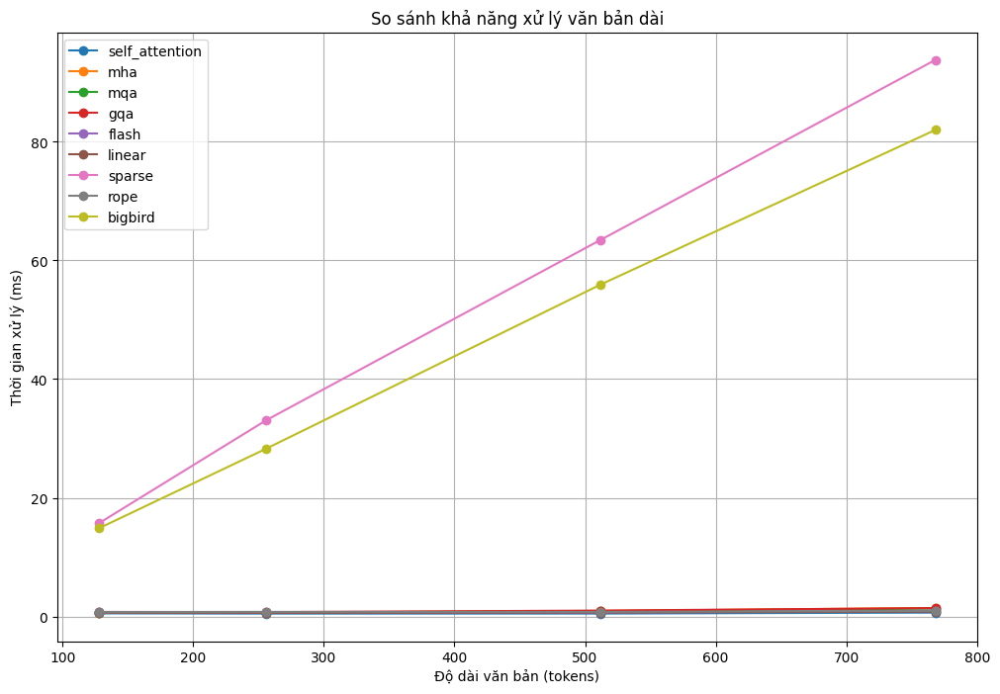


Bảng so sánh tổng hợp các loại Attention:
Attention Type  Accuracy (%)  F1 Score  Training Time (s)  Inference Time (ms/batch)  Memory Usage (MB) Complexity            Best For
self_attention     88.868724  0.888620         213.754452                   1.940483           0.000169      O(n²)          Chuỗi ngắn
           mha     89.231700  0.893795         328.770693                   4.200199           0.000000      O(n²)  Học nhiều patterns
           mqa     88.183101  0.885636         301.612536                   3.611092           0.000000      O(n²)    Tiết kiệm bộ nhớ
           gqa     88.667070  0.889283         307.825891                   3.709232           0.000000      O(n²)    Cân bằng MHA/MQA
         flash     89.171204  0.894020         229.274285                   2.985532           0.000007      O(n²)     Chuỗi dài (GPU)
        linear     88.344424  0.884539         245.728903                   3.198905           0.000006       O(n)       Chuỗi rất dài
        spar

In [ ]:
# So sánh thêm về khả năng xử lý văn bản dài
def compare_long_text_performance(attention_types, vocab_size, embed_dim, hidden_dim, output_dim,
                                  word_to_idx, device, max_length=1000):
    """So sánh hiệu suất của các loại attention với văn bản có độ dài khác nhau."""

    lengths = [128, 256, 512, 768, 1024] if max_length >= 1024 else [128, 256, 512, 768]
    results = {att_type: [] for att_type in attention_types}

    # Tạo dữ liệu mẫu với độ dài khác nhau
    sample_inputs = {}
    for length in lengths:
        # Tạo input với độ dài xác định (lặp lại token nếu cần)
        tokens = [1] * length  # Dùng token 1 (thường là UNK hoặc một token phổ biến)
        sample_inputs[length] = torch.tensor([tokens]).to(device)

    for att_type in attention_types:
        print(f"Đánh giá {att_type} với văn bản dài...")

        # Khởi tạo mô hình
        model = SentimentClassifier(
            vocab_size=vocab_size,
            embed_dim=embed_dim,
            hidden_dim=hidden_dim,
            output_dim=output_dim,
            attention_type=att_type,
            num_heads=8,
            num_kv_groups=2,
            dropout=0.2
        ).to(device)

        # Đo thời gian với từng độ dài
        for length in lengths:
            try:
                # Đo thời gian và bộ nhớ
                input_tensor = sample_inputs[length]

                # Warm-up
                with torch.no_grad():
                    model(input_tensor)

                # Đo thời gian thực tế
                times = []
                for _ in range(5):  # Đo 5 lần và lấy trung bình
                    torch.cuda.synchronize() if torch.cuda.is_available() else None
                    start_time = time.time()
                    with torch.no_grad():
                        model(input_tensor)
                    torch.cuda.synchronize() if torch.cuda.is_available() else None
                    times.append(time.time() - start_time)

                avg_time = sum(times) / len(times)
                results[att_type].append(avg_time)
                print(f"  Độ dài {length}: {avg_time*1000:.2f} ms")

            except Exception as e:
                print(f"  Độ dài {length}: Lỗi - {str(e)}")
                results[att_type].append(None)

        # Giải phóng bộ nhớ
        del model
        torch.cuda.empty_cache() if torch.cuda.is_available() else None
        gc.collect()

    # Vẽ đồ thị so sánh
    plt.figure(figsize=(12, 8))
    for att_type, times in results.items():
        # Lọc bỏ None values
        valid_times = [(l, t) for l, t in zip(lengths, times) if t is not None]
        if valid_times:
            x, y = zip(*valid_times)
            plt.plot(x, [t*1000 for t in y], marker='o', label=att_type)

    plt.xlabel('Độ dài văn bản (tokens)')
    plt.ylabel('Thời gian xử lý (ms)')
    plt.title('So sánh khả năng xử lý văn bản dài')
    plt.legend()
    plt.grid(True)
    plt.savefig('long_text_performance.png', dpi=300)
    plt.show()

    return results

# Chạy so sánh văn bản dài
long_text_results = compare_long_text_performance(
    attention_types,
    VOCAB_SIZE,
    EMBED_DIM,
    HIDDEN_DIM,
    OUTPUT_DIM,
    word_to_idx,
    DEVICE
)

# Tạo bảng tổng hợp so sánh các loại attention
comparison_table = pd.DataFrame({
    'Attention Type': results_df['attention_type'],
    'Accuracy (%)': results_df['test_acc'] * 100,
    'F1 Score': results_df['test_f1'],
    'Training Time (s)': results_df['train_time'],
    'Inference Time (ms/batch)': results_df['inference_time'] * 1000,
    'Memory Usage (MB)': results_df['memory_usage'],
})

# Thêm đánh giá định tính
comparison_table['Complexity'] = [
    'O(n²)', 'O(n²)', 'O(n²)', 'O(n²)', 'O(n²)', 'O(n)', 'O(n log n)', 'O(n²)', 'O(n)'
]

comparison_table['Best For'] = [
    'Chuỗi ngắn', 'Học nhiều patterns', 'Tiết kiệm bộ nhớ', 'Cân bằng MHA/MQA',
    'Chuỗi dài (GPU)', 'Chuỗi rất dài', 'Chuỗi dài, phân tán', 'Quan hệ tương đối',
    'Chuỗi rất dài'
]

print("\nBảng so sánh tổng hợp các loại Attention:")
print(comparison_table.to_string(index=False))

# Lưu bảng so sánh
comparison_table.to_csv('attention_comparison_table.csv', index=False)


Thử nghiệm mô hình self_attention
Đã tải trọng số từ best_model_self_attention.pt

Mẫu 1:
Text: This movie was absolutely amazing. The acting was phenomenal, and the storyline kept me engaged from...
Dự đoán: negative (Độ tin cậy: 0.9230)
Xác suất: Tích cực: 0.0770, Tiêu cực: 0.9230

Ma trận attention cho mẫu 1:


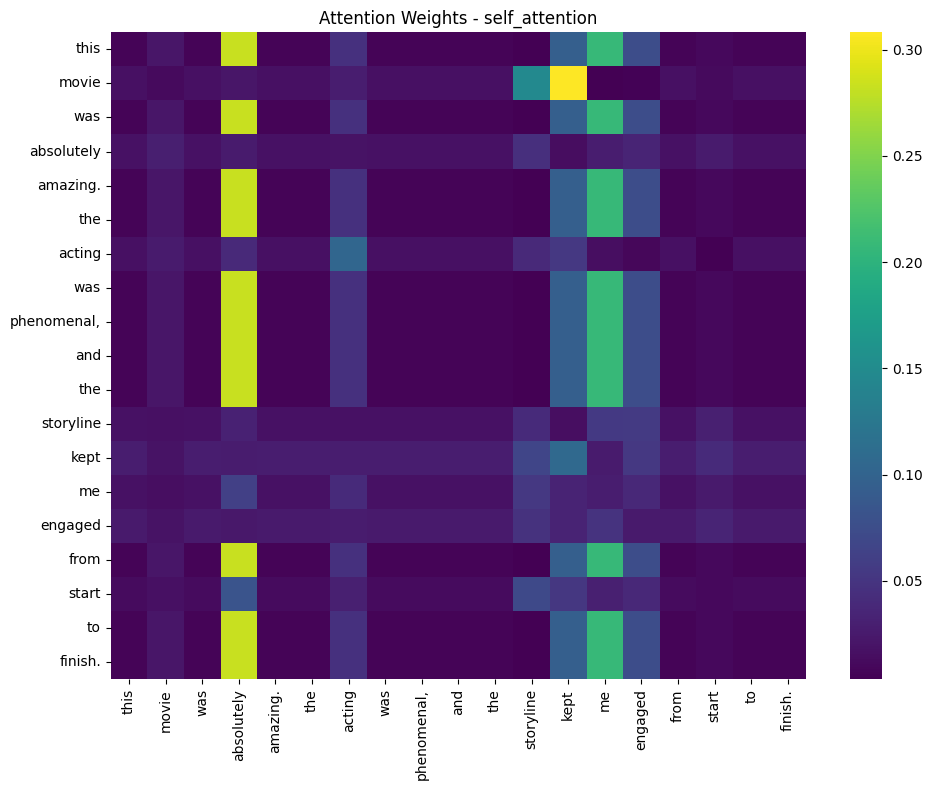

Top 10 cặp tokens có attention cao nhất:
  movie -> kept: 0.3081
  this -> absolutely: 0.2824
  to -> absolutely: 0.2824
  amazing. -> absolutely: 0.2824
  from -> absolutely: 0.2824
  the -> absolutely: 0.2824
  phenomenal, -> absolutely: 0.2824
  and -> absolutely: 0.2824
  was -> absolutely: 0.2824
  was -> absolutely: 0.2824

Mẫu 2:
Text: Terrible film, awful acting and the plot made no sense at all. I regret wasting my time on this movi...
Dự đoán: negative (Độ tin cậy: 1.0000)
Xác suất: Tích cực: 0.0000, Tiêu cực: 1.0000

Mẫu 3:
Text: A masterpiece of cinema that combines excellent performances with breathtaking cinematography. The d...
Dự đoán: positive (Độ tin cậy: 0.9669)
Xác suất: Tích cực: 0.9669, Tiêu cực: 0.0331

Mẫu 4:
Text: I was so bored during this film, I nearly fell asleep. The dialogue was stilted, and the characters ...
Dự đoán: negative (Độ tin cậy: 0.9998)
Xác suất: Tích cực: 0.0002, Tiêu cực: 0.9998

Mẫu 5:
Text: While not perfect, this movie has its moments. So

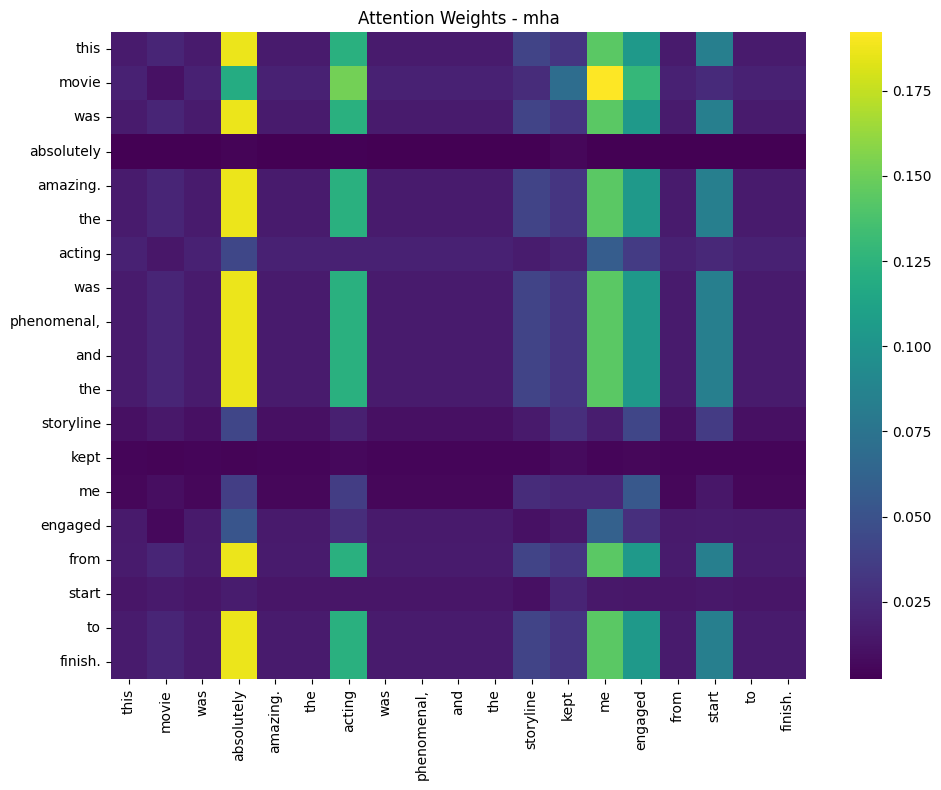

Top 10 cặp tokens có attention cao nhất:
  movie -> me: 0.1921
  finish. -> absolutely: 0.1869
  the -> absolutely: 0.1869
  the -> absolutely: 0.1869
  was -> absolutely: 0.1869
  from -> absolutely: 0.1869
  phenomenal, -> absolutely: 0.1869
  amazing. -> absolutely: 0.1869
  this -> absolutely: 0.1869
  was -> absolutely: 0.1869

Mẫu 2:
Text: Terrible film, awful acting and the plot made no sense at all. I regret wasting my time on this movi...
Dự đoán: negative (Độ tin cậy: 1.0000)
Xác suất: Tích cực: 0.0000, Tiêu cực: 1.0000

Mẫu 3:
Text: A masterpiece of cinema that combines excellent performances with breathtaking cinematography. The d...
Dự đoán: positive (Độ tin cậy: 1.0000)
Xác suất: Tích cực: 1.0000, Tiêu cực: 0.0000

Mẫu 4:
Text: I was so bored during this film, I nearly fell asleep. The dialogue was stilted, and the characters ...
Dự đoán: negative (Độ tin cậy: 1.0000)
Xác suất: Tích cực: 0.0000, Tiêu cực: 1.0000

Mẫu 5:
Text: While not perfect, this movie has its moments.

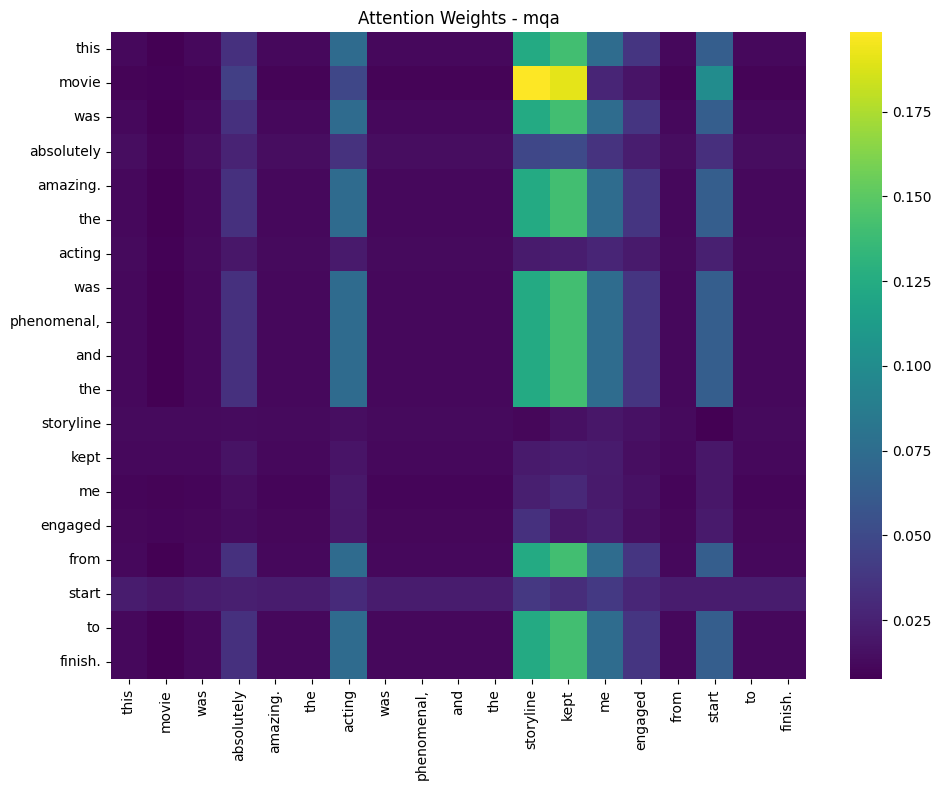

Top 10 cặp tokens có attention cao nhất:
  movie -> storyline: 0.1984
  movie -> kept: 0.1904
  the -> kept: 0.1407
  from -> kept: 0.1407
  amazing. -> kept: 0.1407
  was -> kept: 0.1407
  finish. -> kept: 0.1407
  to -> kept: 0.1407
  and -> kept: 0.1407
  phenomenal, -> kept: 0.1407

Mẫu 2:
Text: Terrible film, awful acting and the plot made no sense at all. I regret wasting my time on this movi...
Dự đoán: negative (Độ tin cậy: 0.9993)
Xác suất: Tích cực: 0.0007, Tiêu cực: 0.9993

Mẫu 3:
Text: A masterpiece of cinema that combines excellent performances with breathtaking cinematography. The d...
Dự đoán: positive (Độ tin cậy: 0.8629)
Xác suất: Tích cực: 0.8629, Tiêu cực: 0.1371

Mẫu 4:
Text: I was so bored during this film, I nearly fell asleep. The dialogue was stilted, and the characters ...
Dự đoán: negative (Độ tin cậy: 0.9999)
Xác suất: Tích cực: 0.0001, Tiêu cực: 0.9999

Mẫu 5:
Text: While not perfect, this movie has its moments. Some parts were great, others were okay. Overa

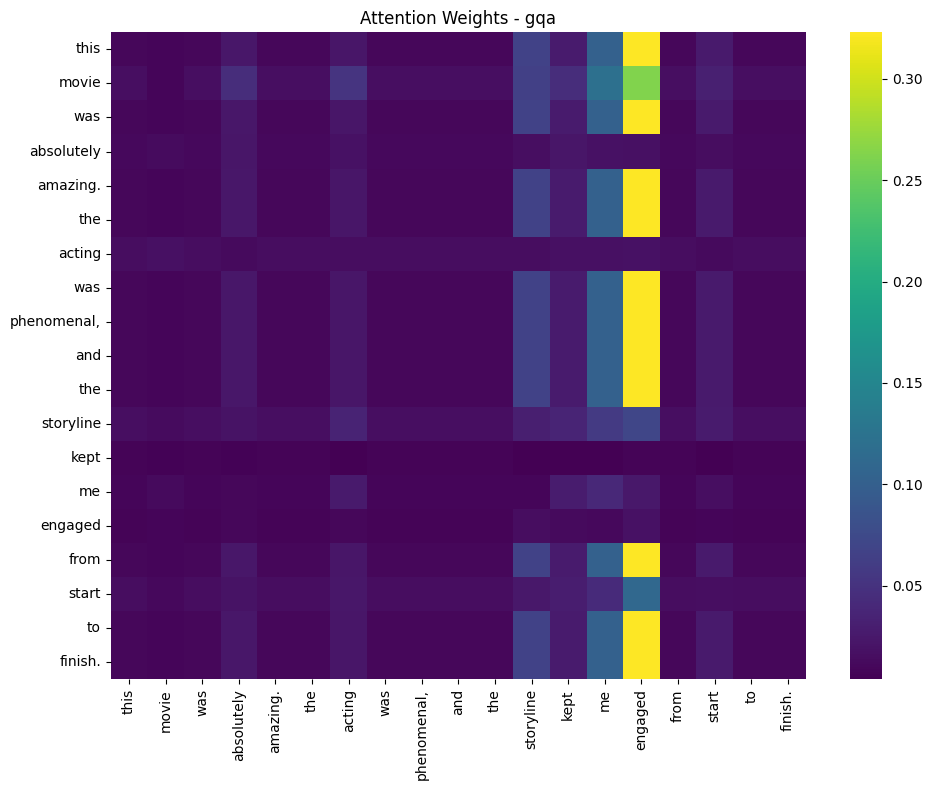

Top 10 cặp tokens có attention cao nhất:
  to -> engaged: 0.3230
  this -> engaged: 0.3230
  the -> engaged: 0.3230
  from -> engaged: 0.3230
  finish. -> engaged: 0.3230
  was -> engaged: 0.3230
  phenomenal, -> engaged: 0.3230
  the -> engaged: 0.3230
  and -> engaged: 0.3230
  was -> engaged: 0.3230

Mẫu 2:
Text: Terrible film, awful acting and the plot made no sense at all. I regret wasting my time on this movi...
Dự đoán: negative (Độ tin cậy: 1.0000)
Xác suất: Tích cực: 0.0000, Tiêu cực: 1.0000

Mẫu 3:
Text: A masterpiece of cinema that combines excellent performances with breathtaking cinematography. The d...
Dự đoán: positive (Độ tin cậy: 0.9824)
Xác suất: Tích cực: 0.9824, Tiêu cực: 0.0176

Mẫu 4:
Text: I was so bored during this film, I nearly fell asleep. The dialogue was stilted, and the characters ...
Dự đoán: negative (Độ tin cậy: 1.0000)
Xác suất: Tích cực: 0.0000, Tiêu cực: 1.0000

Mẫu 5:
Text: While not perfect, this movie has its moments. Some parts were great, others

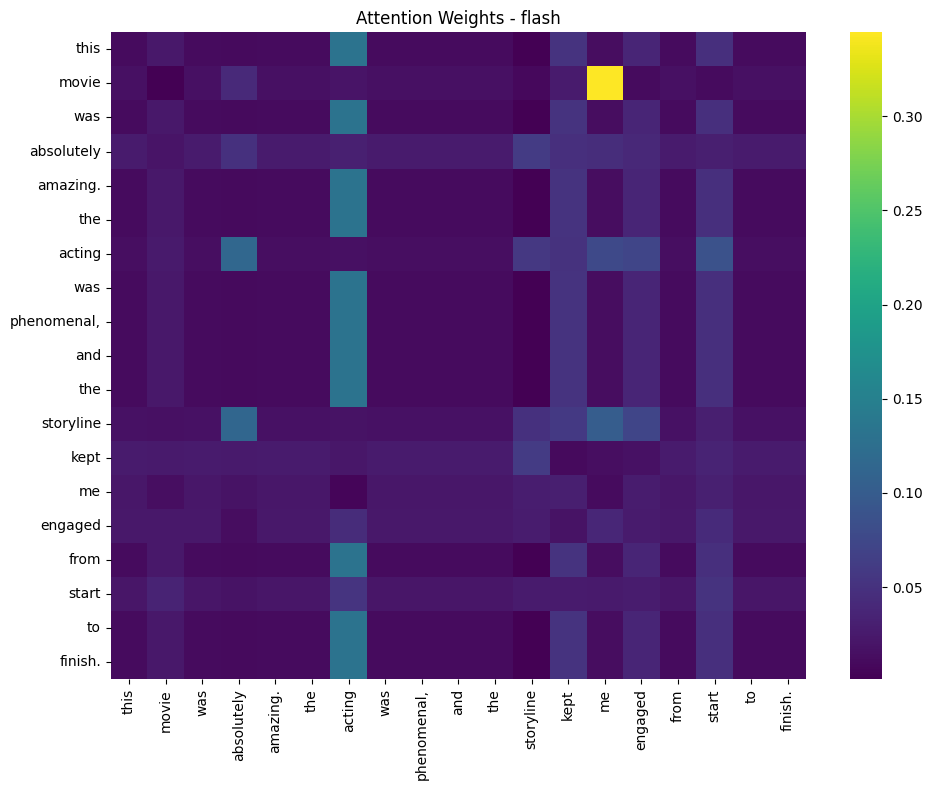

Top 10 cặp tokens có attention cao nhất:
  movie -> me: 0.3445
  this -> acting: 0.1317
  amazing. -> acting: 0.1317
  was -> acting: 0.1317
  from -> acting: 0.1317
  and -> acting: 0.1317
  phenomenal, -> acting: 0.1317
  the -> acting: 0.1317
  was -> acting: 0.1317
  finish. -> acting: 0.1317

Mẫu 2:
Text: Terrible film, awful acting and the plot made no sense at all. I regret wasting my time on this movi...
Dự đoán: negative (Độ tin cậy: 1.0000)
Xác suất: Tích cực: 0.0000, Tiêu cực: 1.0000

Mẫu 3:
Text: A masterpiece of cinema that combines excellent performances with breathtaking cinematography. The d...
Dự đoán: positive (Độ tin cậy: 0.9997)
Xác suất: Tích cực: 0.9997, Tiêu cực: 0.0003

Mẫu 4:
Text: I was so bored during this film, I nearly fell asleep. The dialogue was stilted, and the characters ...
Dự đoán: negative (Độ tin cậy: 0.9952)
Xác suất: Tích cực: 0.0048, Tiêu cực: 0.9952

Mẫu 5:
Text: While not perfect, this movie has its moments. Some parts were great, others were 

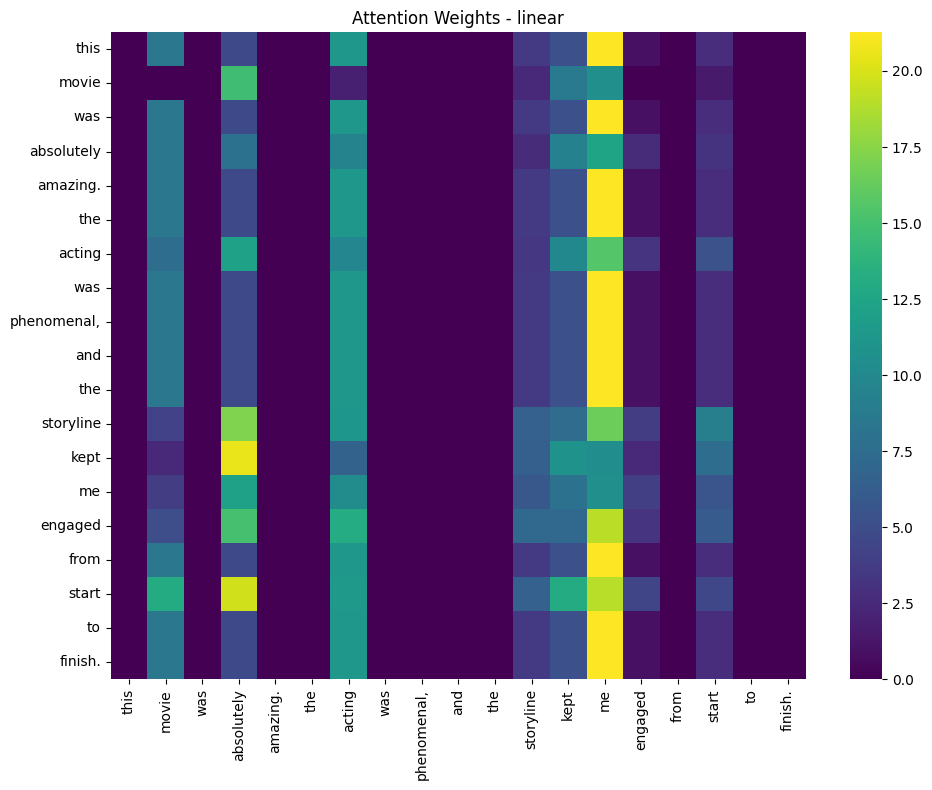

Top 10 cặp tokens có attention cao nhất:
  was -> me: 21.2702
  the -> me: 21.2702
  was -> me: 21.2702
  from -> me: 21.2702
  amazing. -> me: 21.2702
  this -> me: 21.2702
  to -> me: 21.2702
  finish. -> me: 21.2702
  the -> me: 21.2702
  and -> me: 21.2702

Mẫu 2:
Text: Terrible film, awful acting and the plot made no sense at all. I regret wasting my time on this movi...
Dự đoán: negative (Độ tin cậy: 1.0000)
Xác suất: Tích cực: 0.0000, Tiêu cực: 1.0000

Mẫu 3:
Text: A masterpiece of cinema that combines excellent performances with breathtaking cinematography. The d...
Dự đoán: positive (Độ tin cậy: 1.0000)
Xác suất: Tích cực: 1.0000, Tiêu cực: 0.0000

Mẫu 4:
Text: I was so bored during this film, I nearly fell asleep. The dialogue was stilted, and the characters ...
Dự đoán: negative (Độ tin cậy: 1.0000)
Xác suất: Tích cực: 0.0000, Tiêu cực: 1.0000

Mẫu 5:
Text: While not perfect, this movie has its moments. Some parts were great, others were okay. Overall, it'...
Dự đoán: positi

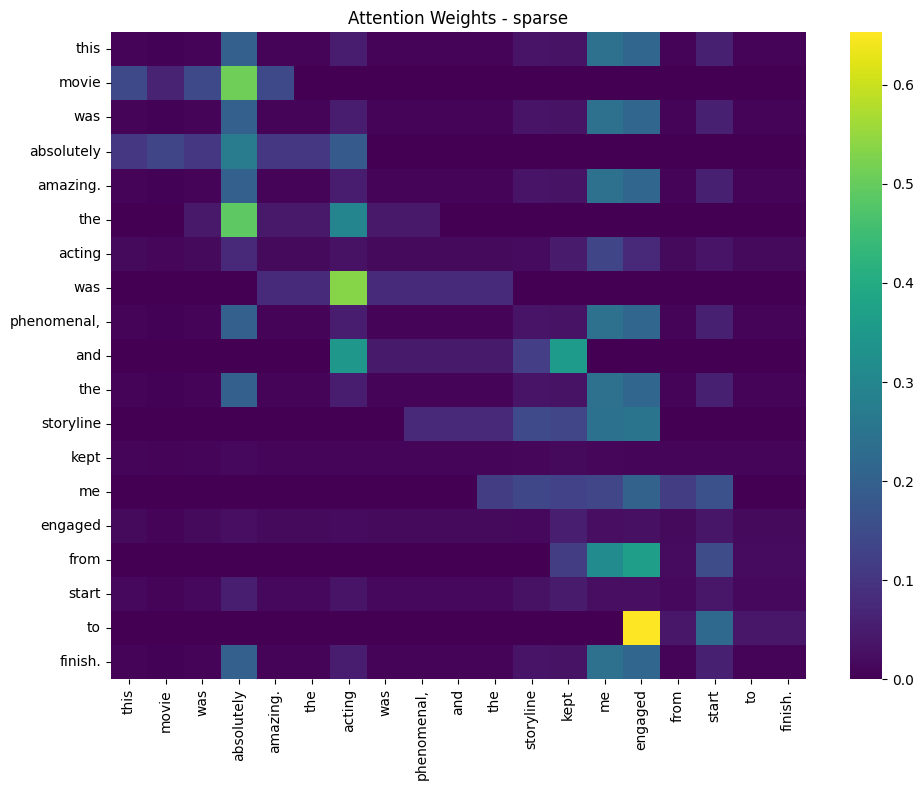

Top 10 cặp tokens có attention cao nhất:
  to -> engaged: 0.6529
  was -> acting: 0.5330
  movie -> absolutely: 0.5076
  the -> absolutely: 0.4897
  from -> engaged: 0.3622
  and -> kept: 0.3560
  and -> acting: 0.3452
  from -> me: 0.3135
  the -> acting: 0.2983

Mẫu 2:
Text: Terrible film, awful acting and the plot made no sense at all. I regret wasting my time on this movi...
Dự đoán: negative (Độ tin cậy: 1.0000)
Xác suất: Tích cực: 0.0000, Tiêu cực: 1.0000

Mẫu 3:
Text: A masterpiece of cinema that combines excellent performances with breathtaking cinematography. The d...
Dự đoán: positive (Độ tin cậy: 0.7946)
Xác suất: Tích cực: 0.7946, Tiêu cực: 0.2054

Mẫu 4:
Text: I was so bored during this film, I nearly fell asleep. The dialogue was stilted, and the characters ...
Dự đoán: negative (Độ tin cậy: 0.9969)
Xác suất: Tích cực: 0.0031, Tiêu cực: 0.9969

Mẫu 5:
Text: While not perfect, this movie has its moments. Some parts were great, others were okay. Overall, it'...
Dự đoán: pos

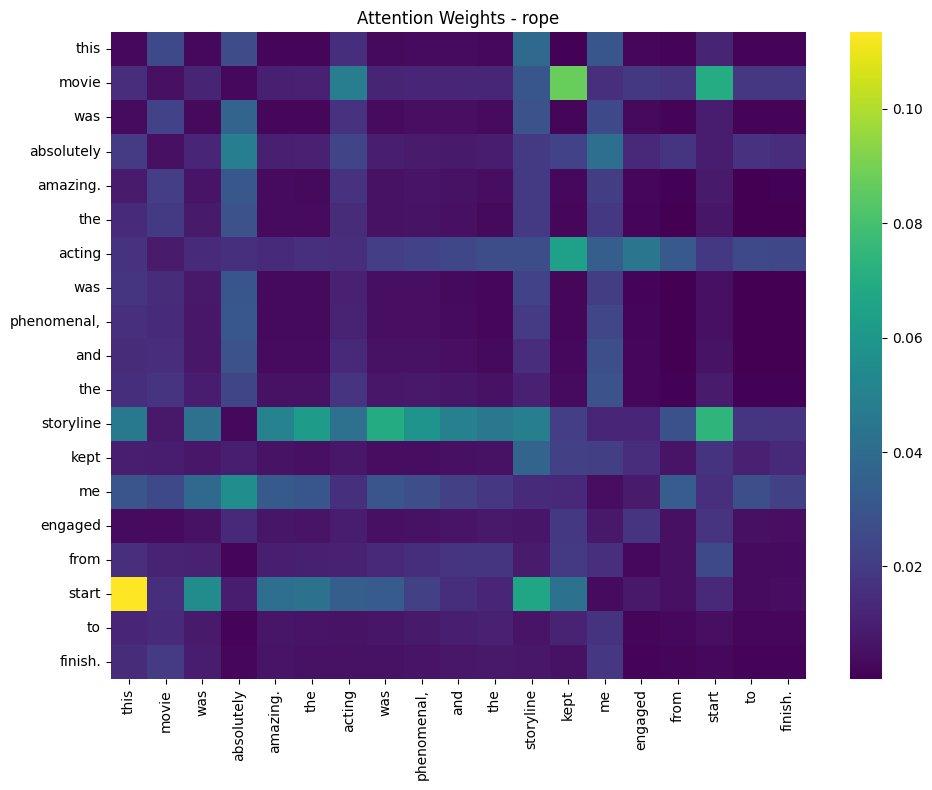

Top 10 cặp tokens có attention cao nhất:
  start -> this: 0.1134
  movie -> kept: 0.0873
  storyline -> start: 0.0737
  movie -> start: 0.0701
  storyline -> was: 0.0694
  start -> storyline: 0.0671
  acting -> kept: 0.0641
  storyline -> the: 0.0622
  storyline -> phenomenal,: 0.0590
  me -> absolutely: 0.0556

Mẫu 2:
Text: Terrible film, awful acting and the plot made no sense at all. I regret wasting my time on this movi...
Dự đoán: negative (Độ tin cậy: 1.0000)
Xác suất: Tích cực: 0.0000, Tiêu cực: 1.0000

Mẫu 3:
Text: A masterpiece of cinema that combines excellent performances with breathtaking cinematography. The d...
Dự đoán: positive (Độ tin cậy: 0.9971)
Xác suất: Tích cực: 0.9971, Tiêu cực: 0.0029

Mẫu 4:
Text: I was so bored during this film, I nearly fell asleep. The dialogue was stilted, and the characters ...
Dự đoán: negative (Độ tin cậy: 0.9998)
Xác suất: Tích cực: 0.0002, Tiêu cực: 0.9998

Mẫu 5:
Text: While not perfect, this movie has its moments. Some parts were grea

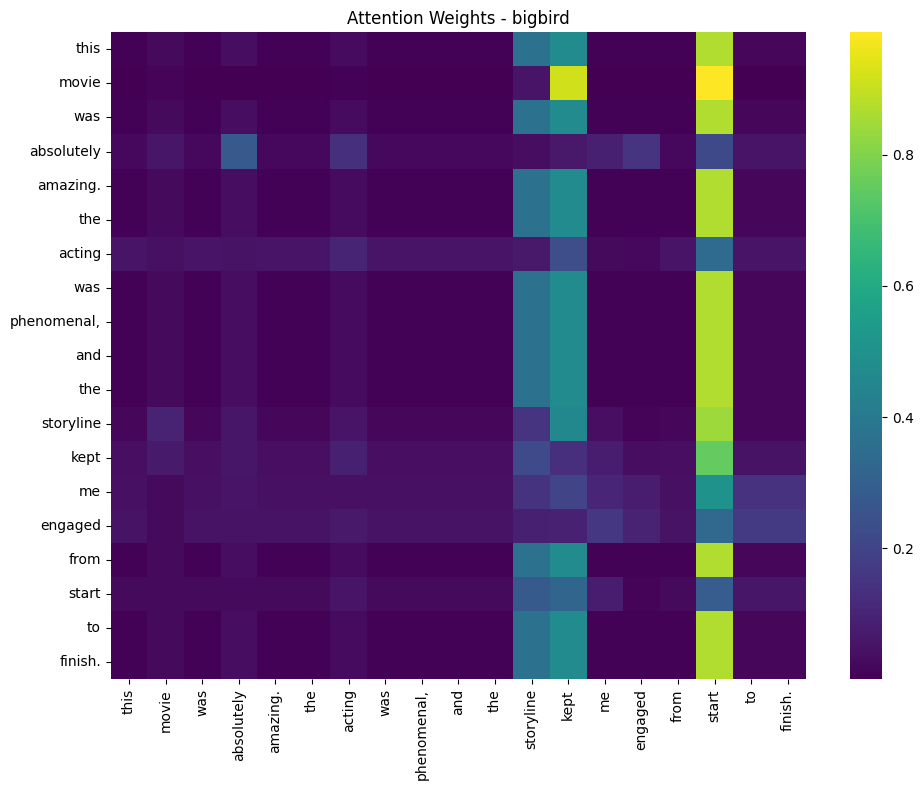

Top 10 cặp tokens có attention cao nhất:
  movie -> start: 0.9866
  movie -> kept: 0.9144
  finish. -> start: 0.8678
  phenomenal, -> start: 0.8678
  and -> start: 0.8678
  the -> start: 0.8678
  was -> start: 0.8678
  amazing. -> start: 0.8678
  the -> start: 0.8678
  this -> start: 0.8678

Mẫu 2:
Text: Terrible film, awful acting and the plot made no sense at all. I regret wasting my time on this movi...
Dự đoán: negative (Độ tin cậy: 0.9805)
Xác suất: Tích cực: 0.0195, Tiêu cực: 0.9805

Mẫu 3:
Text: A masterpiece of cinema that combines excellent performances with breathtaking cinematography. The d...
Dự đoán: positive (Độ tin cậy: 0.8263)
Xác suất: Tích cực: 0.8263, Tiêu cực: 0.1737

Mẫu 4:
Text: I was so bored during this film, I nearly fell asleep. The dialogue was stilted, and the characters ...
Dự đoán: negative (Độ tin cậy: 0.8359)
Xác suất: Tích cực: 0.1641, Tiêu cực: 0.8359

Mẫu 5:
Text: While not perfect, this movie has its moments. Some parts were great, others were okay. 

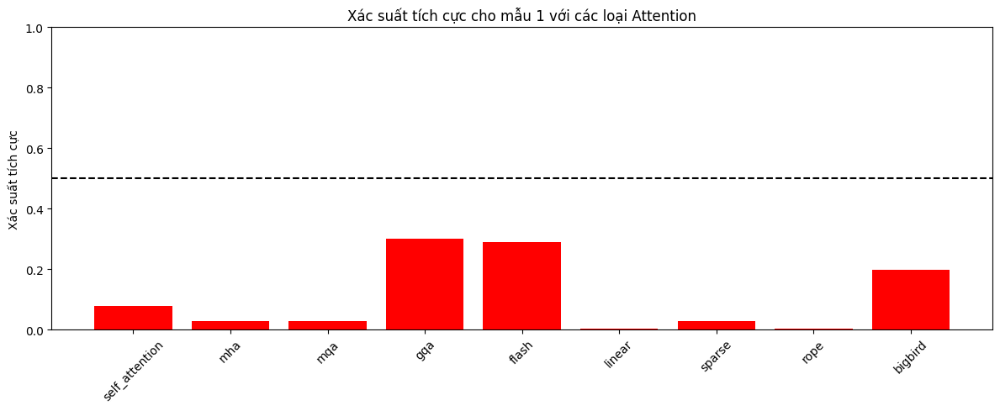


Mẫu 2: Terrible film, awful acting and the plot made no sense at all. I regret wasting my time on this movi...
Loại Attention  Dự đoán  Độ tin cậy  Xác suất tích cực
self_attention negative    0.999996       3.914731e-06
           mha negative    0.999998       1.895780e-06
           mqa negative    0.999270       7.299686e-04
           gqa negative    0.999997       3.036417e-06
         flash negative    0.999998       1.702304e-06
        linear negative    1.000000       4.459020e-10
        sparse negative    0.999966       3.398963e-05
          rope negative    0.999991       8.637247e-06
       bigbird negative    0.980499       1.950094e-02


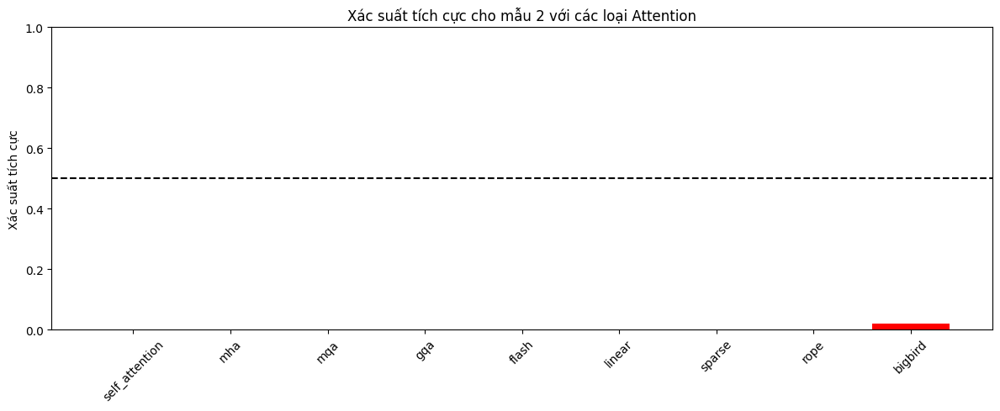


Mẫu 3: A masterpiece of cinema that combines excellent performances with breathtaking cinematography. The d...
Loại Attention  Dự đoán  Độ tin cậy  Xác suất tích cực
self_attention positive    0.966933           0.966933
           mha positive    0.999986           0.999986
           mqa positive    0.862917           0.862917
           gqa positive    0.982444           0.982444
         flash positive    0.999660           0.999660
        linear positive    0.999998           0.999998
        sparse positive    0.794555           0.794555
          rope positive    0.997139           0.997139
       bigbird positive    0.826332           0.826332


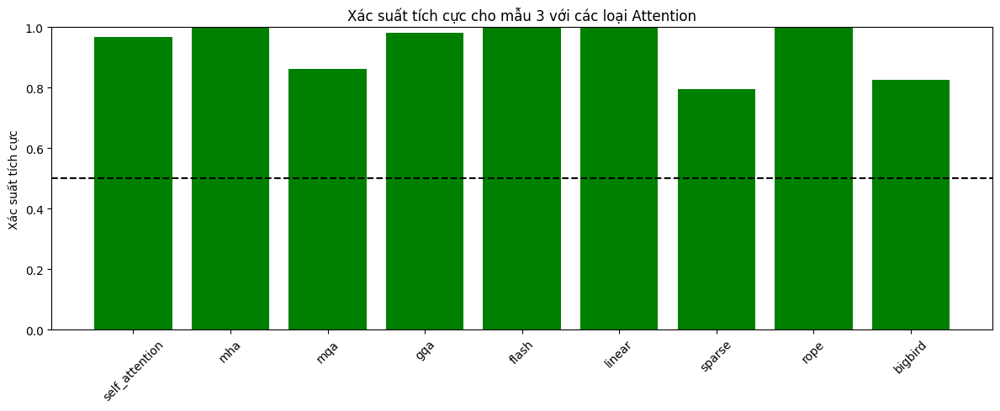


Mẫu 4: I was so bored during this film, I nearly fell asleep. The dialogue was stilted, and the characters ...
Loại Attention  Dự đoán  Độ tin cậy  Xác suất tích cực
self_attention negative    0.999817           0.000183
           mha negative    0.999992           0.000008
           mqa negative    0.999888           0.000112
           gqa negative    0.999995           0.000005
         flash negative    0.995213           0.004787
        linear negative    0.999992           0.000008
        sparse negative    0.996919           0.003081
          rope negative    0.999769           0.000231
       bigbird negative    0.835879           0.164121


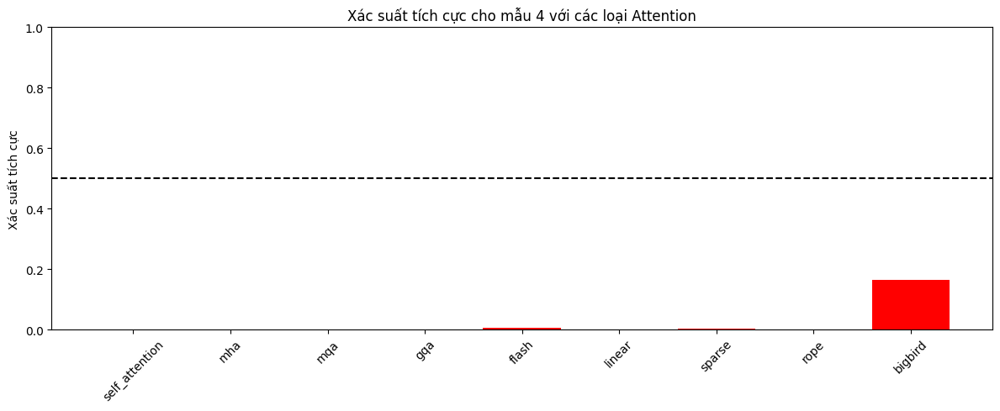


Mẫu 5: While not perfect, this movie has its moments. Some parts were great, others were okay. Overall, it'...
Loại Attention  Dự đoán  Độ tin cậy  Xác suất tích cực
self_attention negative    0.922328           0.077672
           mha positive    0.533843           0.533843
           mqa negative    0.726931           0.273069
           gqa negative    0.941001           0.058999
         flash positive    0.547630           0.547630
        linear positive    0.999997           0.999997
        sparse positive    0.545557           0.545557
          rope negative    0.918541           0.081459
       bigbird positive    0.520921           0.520921


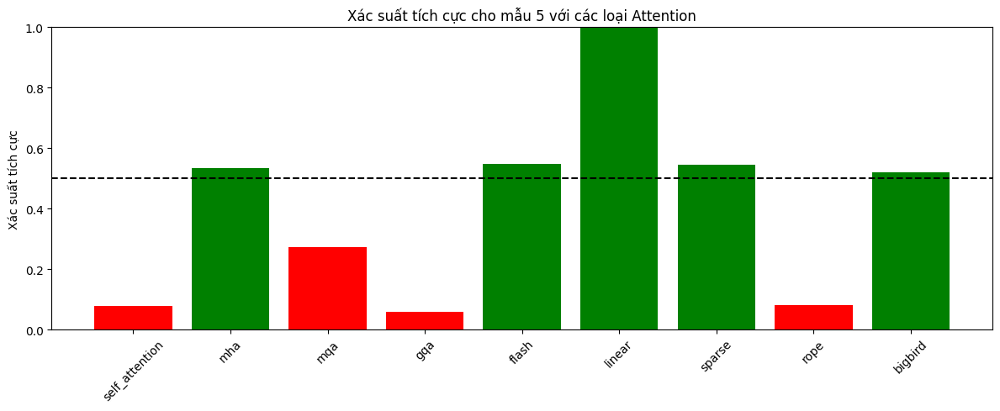


Mẫu 6: The special effects were impressive, but they couldn't save the weak story and poor character develo...
Loại Attention  Dự đoán  Độ tin cậy  Xác suất tích cực
self_attention negative    0.999995       5.359580e-06
           mha negative    1.000000       4.239351e-08
           mqa negative    0.999998       2.298145e-06
           gqa negative    1.000000       3.153208e-07
         flash negative    0.999976       2.401318e-05
        linear negative    1.000000       1.251439e-13
        sparse negative    0.999991       9.133243e-06
          rope negative    0.999938       6.188527e-05
       bigbird negative    0.916669       8.333097e-02


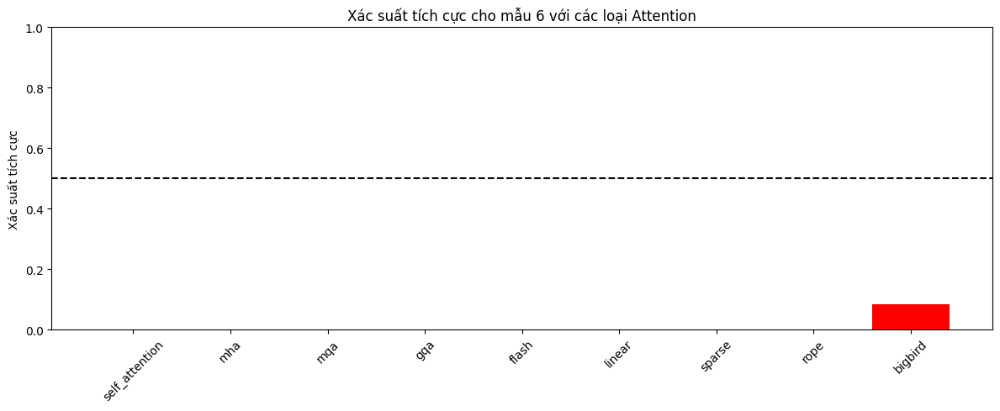


Phân tích sự đồng thuận giữa các mô hình:
Mẫu 1: Đồng thuận hoàn toàn
Mẫu 2: Đồng thuận hoàn toàn
Mẫu 3: Đồng thuận hoàn toàn
Mẫu 4: Đồng thuận hoàn toàn
Mẫu 5: Phân tán: 5/9 mô hình dự đoán positive
Mẫu 6: Đồng thuận hoàn toàn


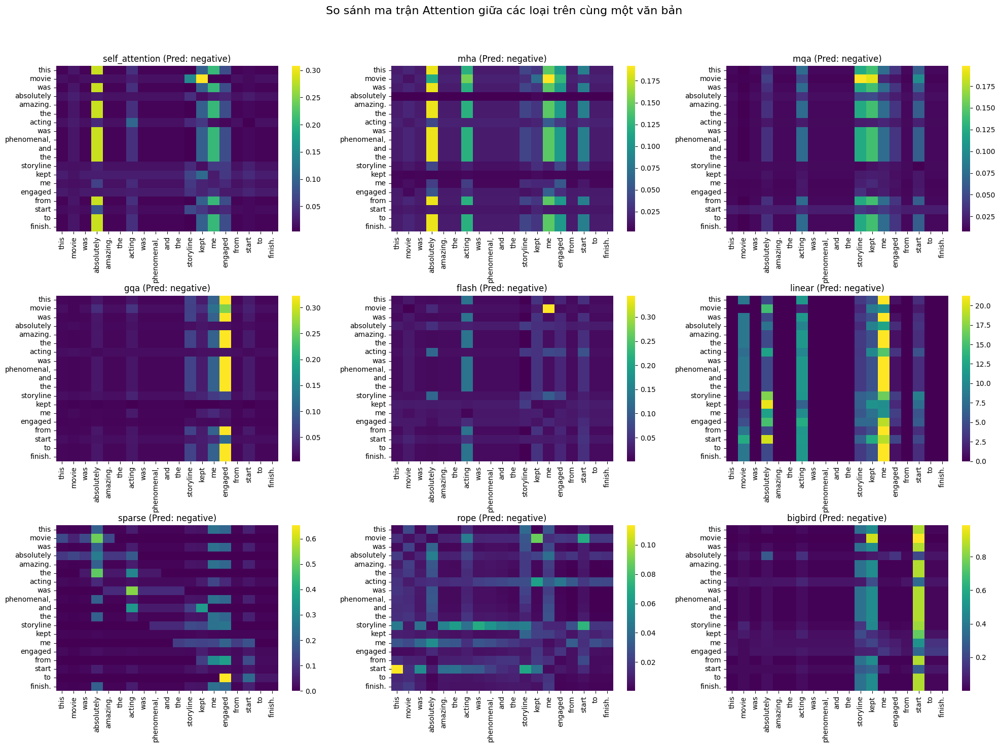

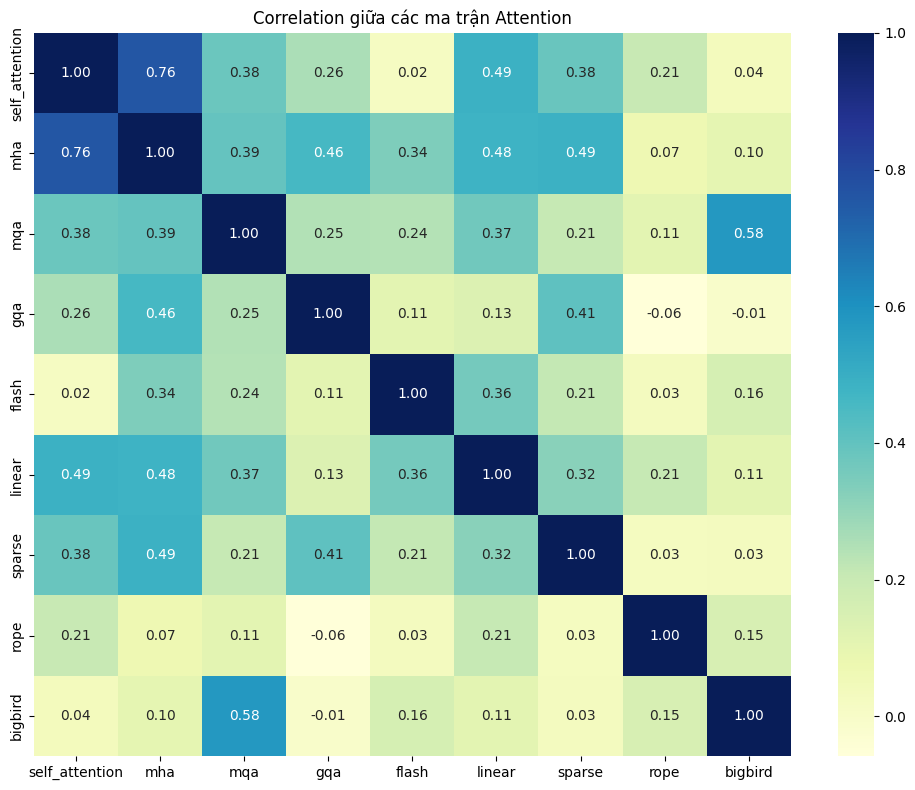

In [ ]:
import torch
import torch.nn.functional as F
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import display, HTML

# Hàm để dự đoán sentiment cho một văn bản
def predict_sentiment(model, text, word_to_idx, device, max_length=256):
    # Tiền xử lý văn bản (cần phải giống quá trình tiền xử lý lúc huấn luyện)
    tokens = text.lower().split()
    if len(tokens) > max_length:
        tokens = tokens[:max_length]

    # Mã hóa tokens
    input_ids = [word_to_idx.get(token, word_to_idx['<UNK>']) for token in tokens]

    # Padding
    if len(input_ids) < max_length:
        input_ids = input_ids + [word_to_idx['<PAD>']] * (max_length - len(input_ids))

    # Chuyển sang tensor
    input_tensor = torch.tensor(input_ids).unsqueeze(0).to(device)  # [1, seq_len]

    # Dự đoán
    model.eval()
    with torch.no_grad():
        outputs, attention_weights = model(input_tensor)
        probs = F.softmax(outputs, dim=1)
        predicted_class = torch.argmax(outputs, dim=1).item()

    return {
        'text': text,
        'prediction': 'positive' if predicted_class == 1 else 'negative',
        'confidence': probs[0, predicted_class].item(),
        'attention_weights': attention_weights,
        'positive_prob': probs[0, 1].item(),
        'negative_prob': probs[0, 0].item()
    }

# Hàm hiển thị ma trận attention
def display_attention(attention_weights, tokens, attention_type, max_tokens=30):
    # Giới hạn số lượng tokens để hiển thị
    tokens = tokens[:max_tokens]

    if attention_type in ['self_attention', 'flash', 'linear', 'rope']:
        # Ma trận 2D [seq_len, seq_len]
        attention = attention_weights[0, :len(tokens), :len(tokens)].cpu().numpy()
    elif attention_type in ['mha', 'mqa', 'gqa', 'sparse']:
        # Multi-head attention [heads, seq_len, seq_len]
        if len(attention_weights.shape) == 4:
            attention = attention_weights[0, :, :len(tokens), :len(tokens)].mean(0).cpu().numpy()
        else:
            attention = attention_weights[0, :len(tokens), :len(tokens)].cpu().numpy()
    else:
        # Các loại khác, lấy attention_weights có sẵn
        attention = attention_weights[0, :len(tokens), :len(tokens)].cpu().numpy()

    plt.figure(figsize=(10, 8))
    ax = sns.heatmap(attention, xticklabels=tokens, yticklabels=tokens, cmap='viridis')
    plt.title(f'Attention Weights - {attention_type}')
    plt.tight_layout()
    plt.show()

    # Tìm 5 cặp tokens có attention cao nhất
    n_tokens = len(tokens)
    attention_flat = attention.flatten()
    top_indices = attention_flat.argsort()[-10:][::-1]

    print("Top 10 cặp tokens có attention cao nhất:")
    for idx in top_indices:
        i, j = idx // n_tokens, idx % n_tokens
        if i != j:  # Bỏ qua self-attention
            print(f"  {tokens[i]} -> {tokens[j]}: {attention[i, j]:.4f}")

# Một số mẫu văn bản từ tập IMDB để kiểm tra
sample_texts = [
    "This movie was absolutely amazing. The acting was phenomenal, and the storyline kept me engaged from start to finish.",
    "Terrible film, awful acting and the plot made no sense at all. I regret wasting my time on this movie.",
    "A masterpiece of cinema that combines excellent performances with breathtaking cinematography. The director has created something truly special.",
    "I was so bored during this film, I nearly fell asleep. The dialogue was stilted, and the characters were one-dimensional.",
    "While not perfect, this movie has its moments. Some parts were great, others were okay. Overall, it's worth watching if you're a fan of the genre.",
    "The special effects were impressive, but they couldn't save the weak story and poor character development."
]

# Danh sách các mô hình attention
attention_models = {
    'self_attention': 'best_model_self_attention.pt',
    'mha': 'best_model_mha.pt',
    'mqa': 'best_model_mqa.pt',
    'gqa': 'best_model_gqa.pt',
    'flash': 'best_model_flash.pt',
    'linear': 'best_model_linear.pt',
    'sparse': 'best_model_sparse.pt',
    'rope': 'best_model_rope.pt',
    'bigbird': 'best_model_bigbird.pt'
}

# Chuẩn bị biểu đồ so sánh
results_all_models = []

# Chạy dự đoán với mỗi mô hình
for attention_type, model_path in attention_models.items():
    print(f"\n{'=' * 50}")
    print(f"Thử nghiệm mô hình {attention_type}")
    print(f"{'=' * 50}")

    # Khởi tạo mô hình
    model = SentimentClassifier(
        vocab_size=VOCAB_SIZE,
        embed_dim=EMBED_DIM,
        hidden_dim=HIDDEN_DIM,
        output_dim=OUTPUT_DIM,
        attention_type=attention_type,
        num_heads=NUM_HEADS,
        num_kv_groups=NUM_KV_GROUPS,
        dropout=DROPOUT
    ).to(DEVICE)

    # Tải trọng số đã huấn luyện
    try:
        model.load_state_dict(torch.load(model_path))
        print(f"Đã tải trọng số từ {model_path}")
    except Exception as e:
        print(f"Không thể tải mô hình từ {model_path}: {e}")
        continue

    # Dự đoán trên các mẫu
    for i, text in enumerate(sample_texts):
        print(f"\nMẫu {i+1}:")
        print(f"Text: {text[:100]}..." if len(text) > 100 else f"Text: {text}")

        # Dự đoán
        result = predict_sentiment(model, text, word_to_idx, DEVICE)

        # Hiển thị kết quả
        print(f"Dự đoán: {result['prediction']} (Độ tin cậy: {result['confidence']:.4f})")
        print(f"Xác suất: Tích cực: {result['positive_prob']:.4f}, Tiêu cực: {result['negative_prob']:.4f}")

        # Lưu kết quả để so sánh
        results_all_models.append({
            'attention_type': attention_type,
            'sample_id': i+1,
            'text': text[:50] + "..." if len(text) > 50 else text,
            'prediction': result['prediction'],
            'confidence': result['confidence'],
            'positive_prob': result['positive_prob']
        })

        # Hiển thị ma trận attention cho mẫu đầu tiên
        if i == 0:
            print("\nMa trận attention cho mẫu 1:")
            display_attention(result['attention_weights'], text.lower().split(), attention_type)

    # Giải phóng bộ nhớ
    del model
    torch.cuda.empty_cache() if torch.cuda.is_available() else None

# Tạo bảng so sánh kết quả dự đoán giữa các mô hình
results_df = pd.DataFrame(results_all_models)

# Hiển thị bảng so sánh
for i in range(len(sample_texts)):
    sample_id = i + 1
    sample_results = results_df[results_df['sample_id'] == sample_id]

    print(f"\n{'=' * 80}")
    print(f"Mẫu {sample_id}: {sample_texts[i][:100]}..." if len(sample_texts[i]) > 100 else f"Mẫu {sample_id}: {sample_texts[i]}")
    print(f"{'=' * 80}")

    # Hiển thị kết quả từ tất cả các mô hình cho mẫu này
    comparison = sample_results[['attention_type', 'prediction', 'confidence', 'positive_prob']]
    comparison.columns = ['Loại Attention', 'Dự đoán', 'Độ tin cậy', 'Xác suất tích cực']
    print(comparison.to_string(index=False))

    # Vẽ biểu đồ so sánh xác suất tích cực giữa các mô hình
    plt.figure(figsize=(12, 5))
    colors = ['green' if pred == 'positive' else 'red' for pred in sample_results['prediction']]

    plt.bar(sample_results['attention_type'], sample_results['positive_prob'], color=colors)
    plt.axhline(y=0.5, color='black', linestyle='--')
    plt.title(f'Xác suất tích cực cho mẫu {sample_id} với các loại Attention')
    plt.ylabel('Xác suất tích cực')
    plt.ylim(0, 1)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Phân tích sự đồng thuận giữa các mô hình
agreement_analysis = {}
for i in range(len(sample_texts)):
    sample_id = i + 1
    sample_results = results_df[results_df['sample_id'] == sample_id]
    predictions = sample_results['prediction'].value_counts()

    if len(predictions) == 1:  # Tất cả mô hình dự đoán giống nhau
        agreement = 'Đồng thuận hoàn toàn'
    else:
        majority_pred = predictions.idxmax()
        majority_count = predictions.max()
        total_models = len(sample_results)
        agreement = f'Phân tán: {majority_count}/{total_models} mô hình dự đoán {majority_pred}'

    agreement_analysis[sample_id] = agreement

# Hiển thị kết quả phân tích sự đồng thuận
print("\n" + "=" * 50)
print("Phân tích sự đồng thuận giữa các mô hình:")
print("=" * 50)
for sample_id, agreement in agreement_analysis.items():
    print(f"Mẫu {sample_id}: {agreement}")

# Vẽ heatmap so sánh ma trận attention của các mô hình trên mẫu đầu tiên
first_text = sample_texts[0]
tokens = first_text.lower().split()[:20]  # Lấy 20 tokens đầu tiên

plt.figure(figsize=(20, 15))
comparison_attentions = {}

# Chạy lại dự đoán trên mẫu đầu tiên với mỗi mô hình để lấy ma trận attention
for idx, (attention_type, model_path) in enumerate(attention_models.items()):
    # Khởi tạo mô hình
    model = SentimentClassifier(
        vocab_size=VOCAB_SIZE,
        embed_dim=EMBED_DIM,
        hidden_dim=HIDDEN_DIM,
        output_dim=OUTPUT_DIM,
        attention_type=attention_type,
        num_heads=NUM_HEADS,
        num_kv_groups=NUM_KV_GROUPS,
        dropout=DROPOUT
    ).to(DEVICE)

    # Tải trọng số đã huấn luyện
    try:
        model.load_state_dict(torch.load(model_path))

        # Dự đoán
        result = predict_sentiment(model, first_text, word_to_idx, DEVICE)

        # Lấy ma trận attention
        if attention_type in ['self_attention', 'flash', 'linear', 'rope']:
            attention = result['attention_weights'][0, :len(tokens), :len(tokens)].cpu().numpy()
        elif attention_type in ['mha', 'mqa', 'gqa', 'sparse']:
            if len(result['attention_weights'].shape) == 4:
                attention = result['attention_weights'][0, :, :len(tokens), :len(tokens)].mean(0).cpu().numpy()
            else:
                attention = result['attention_weights'][0, :len(tokens), :len(tokens)].cpu().numpy()
        else:
            attention = result['attention_weights'][0, :len(tokens), :len(tokens)].cpu().numpy()

        comparison_attentions[attention_type] = attention

        # Vẽ subplot
        if idx < 9:  # Chỉ hiển thị tối đa 9 mô hình
            plt.subplot(3, 3, idx + 1)
            sns.heatmap(attention, xticklabels=tokens, yticklabels=tokens, cmap='viridis')
            plt.title(f'{attention_type} (Pred: {result["prediction"]})')

        # Giải phóng bộ nhớ
        del model
        torch.cuda.empty_cache() if torch.cuda.is_available() else None

    except Exception as e:
        print(f"Lỗi với mô hình {attention_type}: {e}")

plt.tight_layout()
plt.subplots_adjust(top=0.9)
plt.suptitle('So sánh ma trận Attention giữa các loại trên cùng một văn bản', fontsize=16)
plt.savefig('attention_comparison_on_sample.png', dpi=300)
plt.show()

# Tính toán correlation giữa các ma trận attention
if len(comparison_attentions) > 1:
    correlation_matrix = np.zeros((len(comparison_attentions), len(comparison_attentions)))
    attention_types = list(comparison_attentions.keys())

    for i, type1 in enumerate(attention_types):
        for j, type2 in enumerate(attention_types):
            flat1 = comparison_attentions[type1].flatten()
            flat2 = comparison_attentions[type2].flatten()
            correlation = np.corrcoef(flat1, flat2)[0, 1]
            correlation_matrix[i, j] = correlation

    # Vẽ heatmap correlation
    plt.figure(figsize=(10, 8))
    sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="YlGnBu",
                xticklabels=attention_types, yticklabels=attention_types)
    plt.title('Correlation giữa các ma trận Attention')
    plt.tight_layout()
    plt.savefig('attention_correlation.png', dpi=300)
    plt.show()

## Ex 2

In [ ]:
print('''
BÀI 2: Xây dựng mô hình trích xuất văn bản từ ảnh bằng mô hình kết hợp CNN và Transformer-Decoder

Yêu cầu:
1. Trình bày nguyên lý hoạt động của kiến trúc kết hợp CNN + Transformer Decoder trong bài toán trích xuất
    văn bản từ ảnh (image - to - text OCR):
   - CNN dùng để trích đặc trưng hình ảnh
   - Transformer Decoder dùng để sinh chuỗi văn bản
   - Cơ chế attention giữa đặc trưng ảnh và trình giải mã văn bản

2. Triển khai mô hình đơn giản để trích xuất văn bản từ ảnh:
   - Sử dụng tập ảnh có chứa văn bản (quảng cáo, hóa đơn, biển hiệu, v.v.)
   - Áp dụng CNN backbone (ResNet hoặc nhẹ hơn)
   - Kết hợp Transformer Decoder tự cài (không dùng EasyOCR, TrOCR,...)

3. Đánh giá và hiển thị:
   - Đánh giá độ chính xác trên tập Test
   - Hiển thị ảnh gốc, văn bản được trích xuất
   - (Nếu có thể) Vẽ heatmap attention để minh họa

4. Nộp bài:
   - File báo cáo trình bày nguyên lý mô hình (PDF hoặc Word)
   - Notebook/Colab mô hình chạy được
   - Dữ liệu gửi qua link (Google Drive, v.v.)

Lưu ý:
- Tất cả các thành viên đều phải nộp bài.
- Code phải kèm link Colab chạy được.
- Word hoặc PDF, Data gửi link, nộp Code.
''')

**🧠 Nghiên cứu: Kiến trúc CNN + Transformer Decoder trong bài toán OCR (ảnh → văn bản)**


<br><br>
**🎯 Mục tiêu**
Trình bày cách kết hợp CNN và Transformer Decoder để giải bài toán OCR (Optical Character Recognition) — chuyển ảnh chứa văn bản thành chuỗi ký tự số hóa.


<br><br>
**🔍 Tổng quan kiến trúc**

- **CNN**: Trích xuất đặc trưng từ ảnh (nét, hình dáng ký tự).
- **Transformer Decoder**: Sinh ra chuỗi văn bản từ đặc trưng ảnh.
- **Cross-Attention**: Cho phép decoder "nhìn" vùng ảnh phù hợp để sinh ký tự tiếp theo.

**⚙️ Chi tiết hoạt động**


<br><br>
**🖼️ 1. CNN Encoder (bộ trích đặc trưng ảnh)**
- Nhận ảnh đầu vào, ví dụ ảnh chứa chữ "HELLO".
- Trích đặc trưng bằng ResNet, EfficientNet, v.v.
- Kết quả: dãy vector đặc trưng `[x₁, x₂, ..., x_L]`.

👉 Có thể hiểu là: "chia ảnh thành nhiều mảnh nhỏ, mỗi mảnh chứa thông tin về một phần ký tự."


<br><br>
**✍️ 2. Transformer Decoder (bộ sinh chuỗi)**
- Mỗi bước, nó nhận các ký tự đã sinh trước đó (`y₁, ..., y_{t-1}`) và dựa vào đặc trưng ảnh để sinh ký tự tiếp theo `yₜ`.


<br><br>
**🔁 3. Attention giữa ảnh và văn bản**
- Tại mỗi bước, decoder học cách "nhìn" đúng vùng ảnh để quyết định sinh ra ký tự nào.
- Dùng cơ chế **Cross-Attention**:
  - `query`: từ chuỗi đang sinh
  - `key/value`: từ đặc trưng ảnh


<br><br>
**👶 Ví dụ cho con nít cũng hiểu**

> Hãy tưởng tượng ảnh là một bức tranh có chữ "DOG", và robot đọc chữ từng ký tự:

1. 🧠 CNN nói: "Phần bên trái của ảnh có cái tròn như chữ D".
2. ✍️ Transformer Decoder nói: "Tôi thấy cái tròn → tôi viết ra chữ D".
3. 👁️ Lặp lại: nhìn tiếp → thấy chữ O → viết O → rồi chữ G.

🎯 Vậy là robot có thể "đọc" được chữ mà không cần người chỉ từng ký tự.


<br><br>
**💡 Lợi ích của kiến trúc này**

- ✅ Không cần cắt chữ ra từng ký tự như cách cũ.
- ✅ Dễ huấn luyện từ ảnh và text thực tế.
- ✅ Áp dụng tốt cho OCR thông thường, hóa đơn, biểu mẫu, chữ viết tay.



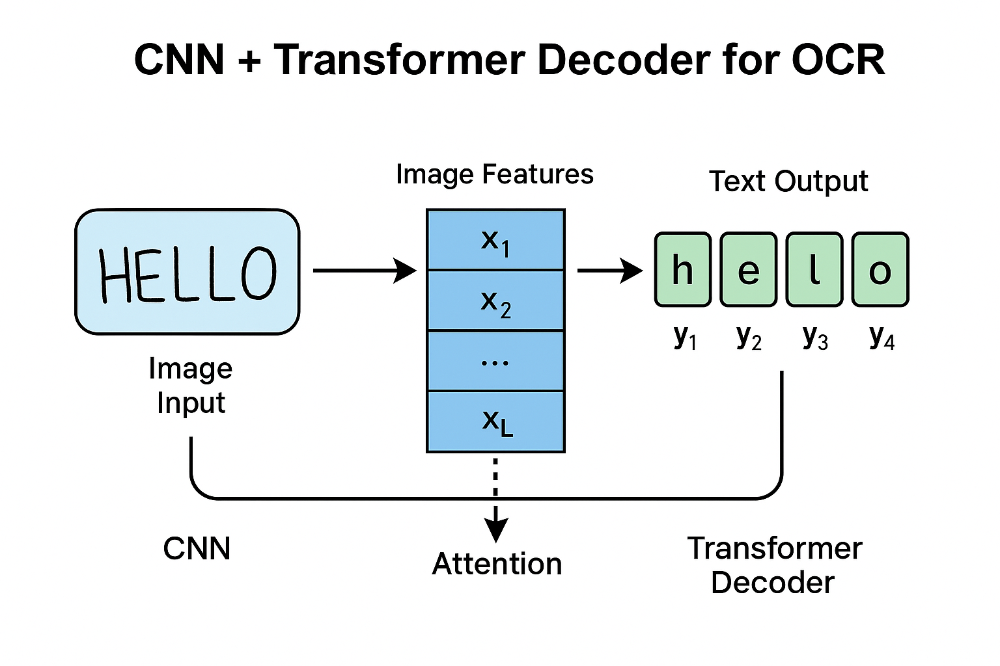

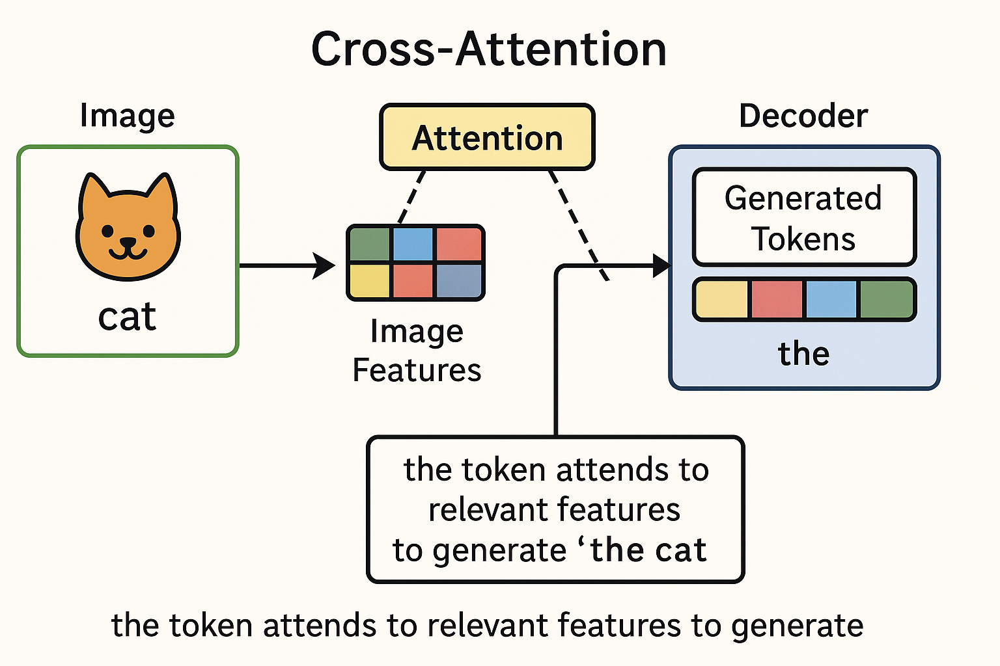

**📌 Cross-Attention là gì?**

Cross-attention là cơ chế **cho phép mô hình nhìn vào 2 nguồn thông tin khác nhau**. Trong bài toán trích xuất văn bản từ ảnh:

- 🧠 **Query**: Là văn bản đang được sinh ra.
- 🖼️ **Key/Value**: Là đặc trưng ảnh được trích xuất từ CNN.

Mỗi từ trong văn bản **sẽ nhìn vào toàn bộ đặc trưng ảnh** để quyết định nên viết gì tiếp theo.


<br><br>
**👶 Ví dụ dễ hiểu:**
> Bé nhìn vào một tấm ảnh có chữ "HELLO", rồi viết lại ra giấy:
- Bé viết chữ "H" → nhìn toàn ảnh.
- Bé viết chữ "E" → vẫn nhìn lại toàn ảnh.
- ...  
🎯 Mỗi chữ được viết ra là kết quả của việc **"nhìn toàn ảnh"** → đó là **cross-attention**.

<br><br>
**📚 Tài liệu đọc thêm:**
- [The Annotated Transformer – Harvard NLP](https://nlp.seas.harvard.edu/annotated-transformer/)


### Load Invoice Dataset

Ở bước này, chúng tôi tiến hành **tải dữ liệu gốc** và thực hiện **tùy chỉnh lại cấu trúc thư mục, tên file** cũng như **phân chia lại các tập (train/val/test)** theo đúng yêu cầu của bài toán.

Việc này giúp đảm bảo dữ liệu được tổ chức **mạch lạc, dễ kiểm soát** và **phù hợp với pipeline huấn luyện mô hình** về sau.


[SROIE datasetv2](https://www.kaggle.com/datasets/urbikn/sroie-datasetv2)

In [ ]:
# 📋 Tóm tắt Pipeline OCR và Kiến trúc Mô hình

summary = '''
# 📋 Tóm tắt Pipeline OCR và Kiến trúc Mô hình

---

## 1. Pipeline xử lý dữ liệu OCR

- **Tải dataset** SROIE2019 từ Kaggle và sao chép vào thư mục `/content/dataset`.
- **Đổi tên file** ảnh và box (train/test) thành định dạng `receipt_XXXX`.
- **Chuyển file box** từ `.txt` sang `.json` với cấu trúc annotation:
  - `{id, text, box}`.
- **Chia dataset** thành:
  - Train (70%), Validation (15%), Test (15%).
- **Chuyển annotation** sang định dạng OCR: `image_path | polygon | text`.
- **Xây dựng từ vựng** (vocab) từ các file annotation.
- **Tạo tokenizer** để mã hóa văn bản thành token IDs.
- **Tạo OCRDataset**:
  - Crop ảnh theo polygon.
  - Resize về chiều cao 48px.
  - Chuẩn hóa (normalize pixel values).
- **Tạo DataLoader**:
  - Padding batch ảnh và token.
- **Huấn luyện mô hình OCR** (ResNet34 + Transformer Decoder).
- **Đánh giá mô hình** bằng CER (Character Error Rate).
- **Dự đoán** trên ảnh test:
  - Crop vùng chữ.
  - Transform ảnh.
  - Giải mã bằng Beam Search.

---

## 2. Kiến trúc mô hình OCR

### - Encoder: ResNet34

+ Input: Ảnh (B, 3, 48, W).
+ Qua các tầng:
  - Conv → BN → ReLU → MaxPool.
  - 4 blocks ResNet (64 → 512 filters).
+ Dùng `AdaptiveAvgPool2d` để chiều cao về 1.
+ Qua Conv1x1 và LayerNorm → Feature map (B, W', 512).

### - Decoder: Transformer Decoder

+ Input: Feature map từ encoder và token target.
+ Bao gồm:
  - Embedding + Positional Encoding.
  - 3 tầng Transformer Decoder (8 heads).
+ Qua Linear layer → Output logits (B, T, vocab_size).

### - Dự đoán:

+ **Beam Search** (beam_size=5) chọn chuỗi ký tự xác suất cao nhất.
+ **Greedy decoding** dùng để đánh giá nhanh.

---

## 3. Huấn luyện và đánh giá

- Loss: `CrossEntropyLoss` (bỏ qua PAD tokens).
- Optimizer: `Adam (lr=1e-4)` + Scheduler `ReduceLROnPlateau`.
- Early stopping: nếu `val_loss` không cải thiện sau 3 epochs.
- Đánh giá: **CER** (Levenshtein distance) trên validation/test set.

---

# 🧠 Tóm tắt cơ chế Attention trong mô hình OCR

---

## 1. Encoder (ResNet34)

- Xử lý ảnh input (B, 3, 48, W) qua các tầng Conv và ResNet.
- Sau AdaptiveAvgPool2d:
  - Chiều cao ảnh còn 1 → Feature map (B, W', 512).
- **Không có cơ chế attention** trong encoder.

---

## 2. Decoder (Transformer Decoder)

- **Masked Self-Attention**:
  - Chuỗi target chỉ chú ý các token trước đó (causal attention).
- **Cross-Attention**:
  - Target chú ý đến feature map từ encoder (memory).
- **Feed-Forward Network**:
  - Xử lý thêm sau các attention layer.
- 3 tầng decoder, mỗi tầng có 8 attention heads.

---

## 3. Kết luận

- Không có attention giữa ResNet34 và Decoder.
- Decoder sử dụng:
  - **Masked Self-Attention** (giữ nhân quả chuỗi).
  - **Cross-Attention** (kết nối ảnh → text).

---
'''

print(summary)

In [ ]:
import plotly.graph_objects as go

# Khởi tạo figure
fig = go.Figure()

# Các bước trong pipeline (vertical)
pipeline_steps = [
    "1. Tải dataset\n(Kaggle SROIE2019)",
    "2. Tiền xử lý\n(Đổi tên + Box → JSON)",
    "3. Chia train/val/test",
    "4. OCR Annotation\n(image|polygon|text)",
    "5. Xây dựng vocab + tokenizer",
    "6. OCRDataset\n(crop + resize + normalize)",
    "7. DataLoader\n(padding batches)",
    "8. Huấn luyện OCR\n(ResNet34 + Transformer)",
    "9. Đánh giá CER\n& Dự đoán Test"
]

# Vị trí y cho từng bước (giảm dần để từ trên xuống dưới)
y_positions = list(reversed(range(len(pipeline_steps))))

# X fix 1 cột dọc
x_positions = [0] * len(y_positions)

# Thêm các node
fig.add_trace(go.Scatter(
    x=x_positions,
    y=y_positions,
    mode="markers+text",
    marker=dict(size=50, color="skyblue"),
    text=pipeline_steps,
    textposition="middle right",
    hoverinfo="text"
))

# Thêm các mũi tên nối dọc
for i in range(len(y_positions)-1):
    fig.add_annotation(
        x=0, y=y_positions[i+1],
        ax=0, ay=y_positions[i],
        xref="x", yref="y",
        axref="x", ayref="y",
        showarrow=True,
        arrowhead=3,
        arrowsize=1,
        arrowwidth=2
    )

fig.update_layout(
    title="📦 Pipeline Xử lý Dữ liệu & Huấn luyện OCR (Chiều dọc)",
    showlegend=False,
    xaxis=dict(visible=False),
    yaxis=dict(visible=False),
    margin=dict(l=100, r=20, t=80, b=20),
    height=800
)

fig.show()

In [ ]:
import plotly.graph_objects as go

fig = go.Figure()

# Encoder Blocks (hàng dọc)
fig.add_trace(go.Scatter(
    x=[2, 2, 2, 2],
    y=[8, 7, 6, 5],
    mode="markers+text",
    marker=dict(size=40, color="lightblue"),
    text=["Conv+BN+ReLU", "ResNet Block1", "ResNet Block2-4", "AdaptiveAvgPool+Conv1x1"],
    textposition="middle right",
    name="Encoder"
))

# Arrow between encoder steps (hướng xuống)
for i in range(8,5,-1):
    fig.add_annotation(
        x=2, y=i-0.5,
        ax=2, ay=i,
        xref="x", yref="y",
        axref="x", ayref="y",
        showarrow=True,
        arrowhead=3
    )

# Decoder Blocks (hàng dọc)
fig.add_trace(go.Scatter(
    x=[2, 2, 2],
    y=[4, 3, 2],
    mode="markers+text",
    marker=dict(size=40, color="lightgreen"),
    text=["Masked Self-Attention", "Cross-Attention", "Linear+Softmax"],
    textposition="middle right",
    name="Decoder"
))

# Arrow between decoder steps (hướng xuống)
for i in range(4,2,-1):
    fig.add_annotation(
        x=2, y=i-0.5,
        ax=2, ay=i,
        xref="x", yref="y",
        axref="x", ayref="y",
        showarrow=True,
        arrowhead=3
    )

# Arrow from Encoder output to Decoder input (nối khối cuối encoder đến khối đầu decoder)
fig.add_annotation(
    x=2, y=4.5,
    ax=2, ay=5,
    xref="x", yref="y",
    axref="x", ayref="y",
    showarrow=True,
    arrowhead=2,
    arrowsize=2,
    arrowwidth=2,
    arrowcolor="red"
)

fig.update_layout(
    title="Vertical Architecture: ResNet34 Encoder + Transformer Decoder",
    showlegend=False,
    xaxis=dict(visible=False),
    yaxis=dict(visible=False),
    height=800  # kéo dài hình cho dễ nhìn
)

fig.show()

In [ ]:
!pip install python-Levenshtein --quiet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 161.7/161.7 kB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 60.0 MB/s eta 0:00:00


## English version

### Receipt Dataset

In [ ]:
import os
import shutil
import kagglehub

dataset_path = kagglehub.dataset_download("urbikn/sroie-datasetv2")
destination_path = "/content/dataset"

# Tạo thư mục đích (xóa cũ nếu tồn tại)
if os.path.exists(destination_path):
    shutil.rmtree(destination_path)
os.makedirs(destination_path)

# Sao chép toàn bộ nội dung
for item in os.listdir(dataset_path):
    src = os.path.join(dataset_path, item)
    dst = os.path.join(destination_path, item)

    if os.path.isdir(src):
        shutil.copytree(src, dst, symlinks=True)  # Sao chép cả thư mục con
    else:
        shutil.copy2(src, dst)  # Giữ nguyên metadata

print(f"✅ Đã sao chép dataset vào: {destination_path}")
print("📂 Nội dung:", os.listdir(destination_path))

✅ Đã sao chép dataset vào: /content/dataset
📂 Nội dung: ['SROIE2019']


In [ ]:
def list_folders_only(startpath):
    for root, dirs, _ in os.walk(startpath):
        level = root.replace(startpath, '').count(os.sep)
        indent = '  ' * level
        print(f"{indent}📁 {os.path.basename(root)}/")
        for d in dirs:
            subindent = '  ' * (level + 1)
            print(f"{subindent}📁 {d}/")
        # Không đệ quy thêm nữa để tránh in sâu vào các sub-sub-folder
        break  # Chỉ lấy các folder ở cấp hiện tại (1 cấp con)

# Gọi hàm để liệt kê folder trong receipt_dataset
list_folders_only("/content/dataset/SROIE2019")
list_folders_only("/content/dataset/SROIE2019/test")
list_folders_only("/content/dataset/SROIE2019/train")

📁 SROIE2019/
  📁 layoutlm-base-uncased/
  📁 test/
  📁 train/
📁 test/
  📁 entities/
  📁 box/
  📁 img/
📁 train/
  📁 entities/
  📁 box/
  📁 img/


In [ ]:
import os
import shutil

# Đường dẫn thư mục
train_img_dir = "/content/dataset/SROIE2019/train/img"
train_box_dir = "/content/dataset/SROIE2019/train/box"
test_img_dir = "/content/dataset/SROIE2019/test/img"
test_box_dir = "/content/dataset/SROIE2019/test/box"

# Đảm bảo thư mục tồn tại
os.makedirs(train_img_dir, exist_ok=True)
os.makedirs(train_box_dir, exist_ok=True)

# ==== BƯỚC 1: ĐỔI TÊN FILE TRONG train/img & train/box ====
train_images = sorted([f for f in os.listdir(train_img_dir) if f.endswith(".jpg")])
for i, old_img_name in enumerate(train_images):
    new_name = f"receipt_{i+1:04d}"
    old_img_path = os.path.join(train_img_dir, old_img_name)
    new_img_path = os.path.join(train_img_dir, f"{new_name}.jpg")
    os.rename(old_img_path, new_img_path)

    # Đổi tên file box tương ứng
    base_name = os.path.splitext(old_img_name)[0]
    old_txt_path = os.path.join(train_box_dir, f"{base_name}.txt")
    new_txt_path = os.path.join(train_box_dir, f"{new_name}.txt")
    if os.path.exists(old_txt_path):
        os.rename(old_txt_path, new_txt_path)
    else:
        print(f"⚠️ Không tìm thấy TXT tương ứng với ảnh {old_img_name} khi rename trong train.")

# ==== BƯỚC 2: GOM FILE TỪ test VÀ TIẾP TỤC ĐÁNH SỐ ====
# Cập nhật lại chỉ số bắt đầu
current_count = len(os.listdir(train_img_dir))

test_images = sorted([f for f in os.listdir(test_img_dir) if f.endswith(".jpg")])
for i, old_img_name in enumerate(test_images):
    new_index = current_count + i + 1
    new_name = f"receipt_{new_index:04d}"

    old_img_path = os.path.join(test_img_dir, old_img_name)
    new_img_path = os.path.join(train_img_dir, f"{new_name}.jpg")
    shutil.copy2(old_img_path, new_img_path)

    # Tên TXT tương ứng
    base_name = os.path.splitext(old_img_name)[0]
    old_txt_path = os.path.join(test_box_dir, f"{base_name}.txt")
    new_txt_path = os.path.join(train_box_dir, f"{new_name}.txt")
    if os.path.exists(old_txt_path):
        shutil.copy2(old_txt_path, new_txt_path)
    else:
        print(f"⚠️ Không tìm thấy TXT cho ảnh {old_img_name} từ test.")

print("✅ Đã rename toàn bộ ảnh + TXT trong train và gom thêm từ test.")


✅ Đã rename toàn bộ ảnh + TXT trong train và gom thêm từ test.


In [ ]:
import os
import json

box_dir = "/content/dataset/SROIE2019/train/box"

def safe_read_lines(path):
    try:
        with open(path, "r", encoding="utf-8") as f:
            return f.readlines()
    except UnicodeDecodeError:
        with open(path, "r", encoding="latin-1") as f:
            return f.readlines()

for fname in os.listdir(box_dir):
    if not fname.endswith(".txt"):
        continue

    txt_path = os.path.join(box_dir, fname)
    json_path = os.path.join(box_dir, fname.replace(".txt", ".json"))

    annotations = []
    lines = safe_read_lines(txt_path)
    for idx, line in enumerate(lines):
        parts = line.strip().split(",")
        if len(parts) < 9:
            print(f"⚠️ Bỏ qua dòng không hợp lệ trong {fname}: {line.strip()}")
            continue

        try:
            coords = list(map(float, parts[:8]))
            text = ",".join(parts[8:]).strip()
            box = [[coords[i], coords[i+1]] for i in range(0, 8, 2)]

            annotations.append({
                "id": idx + 1,
                "text": text,
                "box": box
            })
        except Exception as e:
            print(f"❌ Lỗi khi xử lý dòng: {line.strip()} trong {fname} – {e}")

    # Ghi ra file JSON
    with open(json_path, "w", encoding="utf-8") as f:
        json.dump(annotations, f, ensure_ascii=False, indent=2)

    os.remove(txt_path)

print("✅ Đã chuyển đổi toàn bộ file .txt sang .json và đổi cấu trúc.")


⚠️ Bỏ qua dòng không hợp lệ trong receipt_0776.txt: 
✅ Đã chuyển đổi toàn bộ file .txt sang .json và đổi cấu trúc.


In [ ]:
import os
import shutil
import random

# Đường dẫn gốc
img_dir = "/content/dataset/SROIE2019/train/img"
ann_dir = "/content/dataset/SROIE2019/train/box"

# Thư mục mới
base_out_dir = "/content/receipt_dataset"
splits = ["train", "val", "test"]

# Tạo thư mục mới
for split in splits:
    os.makedirs(os.path.join(base_out_dir, split, "img"), exist_ok=True)
    os.makedirs(os.path.join(base_out_dir, split, "annotations"), exist_ok=True)

# Lấy danh sách ảnh và shuffle
all_imgs = sorted([f for f in os.listdir(img_dir) if f.endswith(".jpg")])
random.shuffle(all_imgs)

# Tính số lượng cho từng tập
total = len(all_imgs)
train_count = int(0.7 * total)
val_count = int(0.15 * total)
test_count = total - train_count - val_count

split_map = {
    "train": all_imgs[:train_count],
    "val": all_imgs[train_count:train_count+val_count],
    "test": all_imgs[train_count+val_count:]
}

# Phân phối file
for split, files in split_map.items():
    for img_file in files:
        base_name = os.path.splitext(img_file)[0]
        json_file = f"{base_name}.json"

        src_img = os.path.join(img_dir, img_file)
        src_json = os.path.join(ann_dir, json_file)

        dst_img = os.path.join(base_out_dir, split, "img", img_file)
        dst_json = os.path.join(base_out_dir, split, "annotations", json_file)

        # Copy nếu cả hai file đều tồn tại
        if os.path.exists(src_json):
            shutil.copy2(src_img, dst_img)
            shutil.copy2(src_json, dst_json)
        else:
            print(f"⚠️ Không tìm thấy file json cho {img_file}, bỏ qua.")

print("✅ Đã phân phối ảnh và annotation vào 'receipt_dataset'.")

✅ Đã phân phối ảnh và annotation vào 'receipt_dataset'.


In [ ]:
import os

base_path = "/content/receipt_dataset"

splits = ["train", "val", "test"]

for split in splits:
    img_dir = os.path.join(base_path, split, "img")
    num_images = len([f for f in os.listdir(img_dir) if f.endswith(".jpg")])
    print(f"Số ảnh trong {split}: {num_images}")

Số ảnh trong train: 681
Số ảnh trong val: 145
Số ảnh trong test: 147


In [ ]:
import shutil
from google.colab import files

# Đường dẫn thư mục và tên file zip
folder_to_zip = "/content/receipt_dataset"
zip_file = "/content/receipt_dataset.zip"

# Nén thư mục
shutil.make_archive(base_name=zip_file.replace('.zip', ''), format='zip', root_dir=folder_to_zip)

print("✅ Đã nén thành công. Đang tạo link tải xuống...")

# Tải file về
files.download(zip_file)

✅ Đã nén thành công. Đang tạo link tải xuống...


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Upload and Unzip Dataset

In [ ]:
import zipfile
import os

# Đường dẫn tới file zip
zip_path = "receipt_dataset.zip"

# Thư mục đích để giải nén
extract_to = "receipt_dataset"

# Tạo thư mục nếu chưa tồn tại
os.makedirs(extract_to, exist_ok=True)

# Giải nén
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to)

In [ ]:
import json

file_path = "/content/receipt_dataset/train/annotations/receipt_0002.json"

# Đọc file JSON
with open(file_path, "r", encoding="utf-8") as f:
    data = json.load(f)

# Hiển thị một số dòng đầu tiên
print(json.dumps(data[:3], indent=4, ensure_ascii=False))  # Hiển thị 3 phần tử đầu tiên nếu là danh sách

[
    {
        "id": 1,
        "text": "TAN WOON YANN",
        "box": [
            [
                76.0,
                50.0
            ],
            [
                323.0,
                50.0
            ],
            [
                323.0,
                84.0
            ],
            [
                76.0,
                84.0
            ]
        ]
    },
    {
        "id": 2,
        "text": "INDAH GIFT & HOME DECO",
        "box": [
            [
                110.0,
                165.0
            ],
            [
                315.0,
                165.0
            ],
            [
                315.0,
                188.0
            ],
            [
                110.0,
                188.0
            ]
        ]
    },
    {
        "id": 3,
        "text": "27,JALAN DEDAP 13,",
        "box": [
            [
                126.0,
                191.0
            ],
            [
                297.0,
                191.0
            ],

### Data Preprocessing

In [ ]:
from typing import List, Tuple
from pathlib import Path

def convert_json_to_ocr_format(
    img_dir: str,
    json_dir: str,
    output_file: str = "ocr_annotations.txt"
) -> List[Tuple[str, List[Tuple[float, float]], str]]:
    """
    Chuyển đổi annotation từ JSON sang dạng (image_path, polygon, text)

    Args:
        img_dir: Thư mục chứa ảnh
        json_dir: Thư mục chứa file JSON annotation
        output_file: File đầu ra để lưu kết quả

    Returns:
        List[Tuple]: Danh sách các annotation dạng (image_path, polygon, text)
    """
    annotations = []

    # Lặp qua tất cả file JSON trong thư mục
    for json_file in Path(json_dir).glob("*.json"):
        # Lấy đường dẫn ảnh tương ứng
        img_name = json_file.stem + ".jpg"
        img_path = str(Path(img_dir) / img_name)

        # Kiểm tra xem ảnh có tồn tại không
        if not os.path.exists(img_path):
            print(f"Warning: Ảnh {img_path} không tồn tại, bỏ qua")
            continue

        # Đọc nội dung file JSON
        with open(json_file, 'r', encoding='utf-8') as f:
            boxes = json.load(f)

        # Tạo annotation cho từng box
        for box in boxes:
            # Chuyển đổi polygon về dạng list of tuples
            polygon = [(float(point[0]), float(point[1])) for point in box['box']]
            text = box['text'].strip()

            # Thêm vào danh sách kết quả
            annotations.append((img_path, polygon, text))

    # Ghi kết quả ra file
    with open(output_file, 'w', encoding='utf-8') as f:
        for ann in annotations:
            img_path, polygon, text = ann

            # Chuyển polygon về dạng string
            poly_str = ' '.join([f"{x},{y}" for x, y in polygon])

            # Ghi theo định dạng: image_path|polygon|text
            f.write(f"{img_path}|{poly_str}|{text}\n")

    print(f"Đã chuyển đổi {len(annotations)} annotations và lưu vào {output_file}")
    return annotations

# Sử dụng hàm
if __name__ == "__main__":
    # Thay đổi các đường dẫn phù hợp với dataset của bạn
    img_dir = "receipt_dataset/train/img"
    json_dir = "receipt_dataset/train/annotations"
    output_file = "train_annotations.txt"

    annotations = convert_json_to_ocr_format(img_dir, json_dir, output_file)

    # Tạo annotation cho tập test
    test_img_dir = "receipt_dataset/test/img"
    test_json_dir = "receipt_dataset/test/annotations"
    test_output_file = "test_annotations.txt"

    test_annotations = convert_json_to_ocr_format(test_img_dir, test_json_dir, test_output_file)

    # Tạo annotation cho tập val
    val_img_dir = "receipt_dataset/val/img"
    val_json_dir = "receipt_dataset/val/annotations"
    val_output_file = "val_annotations.txt"

    val_annotations = convert_json_to_ocr_format(val_img_dir, val_json_dir, val_output_file)

    # In thử 5 annotation đầu tiên để kiểm tra
    print("\n5 annotation đầu tiên:")
    for ann in annotations[:5]:
        print(f"Image: {ann[0]}")
        print(f"Polygon: {ann[1]}")
        print(f"Text: {ann[2]}\n")

Đã chuyển đổi 36708 annotations và lưu vào train_annotations.txt
Đã chuyển đổi 7918 annotations và lưu vào test_annotations.txt
Đã chuyển đổi 7705 annotations và lưu vào val_annotations.txt

5 annotation đầu tiên:
Image: receipt_dataset/train/img/receipt_0636.jpg
Polygon: [(174.0, 227.0), (682.0, 227.0), (682.0, 271.0), (174.0, 271.0)]
Text: LIGHTROOM GALLERY SDN BHD

Image: receipt_dataset/train/img/receipt_0636.jpg
Polygon: [(236.0, 266.0), (611.0, 266.0), (611.0, 305.0), (236.0, 305.0)]
Text: NO: 28, JALAN ASTANA 1C,

Image: receipt_dataset/train/img/receipt_0636.jpg
Polygon: [(226.0, 298.0), (629.0, 298.0), (629.0, 338.0), (226.0, 338.0)]
Text: BANDAR BUKIT RAJA, 41050

Image: receipt_dataset/train/img/receipt_0636.jpg
Polygon: [(192.0, 329.0), (661.0, 329.0), (661.0, 369.0), (192.0, 369.0)]
Text: KLANG SELANGOR D. E, MALAYSIA

Image: receipt_dataset/train/img/receipt_0636.jpg
Polygon: [(261.0, 365.0), (593.0, 365.0), (593.0, 400.0), (261.0, 400.0)]
Text: ROC NO. : (1072825-A)



In [ ]:
import plotly.express as px

# Dữ liệu
train = 36708
val = 7705
test = 7918
total = train + val + test

# Phần trăm
train_pct = round(train / total * 100, 2)
val_pct = round(val / total * 100, 2)
test_pct = round(test / total * 100, 2)

# Nhãn và giá trị
labels = [
    f"Train ({train_pct}%)",
    f"Validation ({val_pct}%)",
    f"Test ({test_pct}%)"
]
values = [train, val, test]

# Pie chart với màu tươi
fig = px.pie(
    names=labels,
    values=values,
    title="Phân bổ tập dữ liệu (Từ annotation files)",
    color_discrete_sequence=px.colors.qualitative.Set3
)

fig.update_traces(textinfo='label+percent', pull=[0.05, 0, 0])
fig.show()

In [ ]:
import unicodedata

def build_vocab(json_dirs, min_freq=1):
    """
    Xây dựng từ vựng từ các file JSON annotation.

    Args:
        json_dirs: Danh sách thư mục chứa file JSON annotation.
        min_freq: Tần suất tối thiểu để thêm ký tự vào vocab.

    Returns:
        vocab: Dict ánh xạ ký tự sang index.
        inv_vocab: Dict ánh xạ index sang ký tự.
    """
    char_counter = Counter()

    # Duyệt qua tất cả file JSON
    for json_dir in json_dirs:
        for json_file in Path(json_dir).glob("*.json"):
            try:
                with open(json_file, 'r', encoding='utf-8') as f:
                    boxes = json.load(f)
                for box in boxes:
                    text = unicodedata.normalize('NFC', box['text'].strip())
                    char_counter.update(text)
            except Exception as e:
                print(f"Error processing {json_file}: {e}")

    # Token cơ bản
    vocab = {
        '<PAD>': 0, '<SOS>': 1, '<EOS>': 2, '<UNK>': 3,
        ' ': 4  # Dấu cách
    }
    idx = 5

    # Ký tự bắt buộc
    must_include = set(
        "0123456789ABCDEFGHIJKLMNOPQRSTUVWXYZabcdefghijklmnopqrstuvwxyz"
        "*=%/$,.-+:@#&()"
    )

    # Thêm ký tự từ dataset (đạt min_freq)
    for char, count in char_counter.items():
        if char not in vocab and count >= min_freq:
            vocab[char] = idx
            idx += 1

    # Đảm bảo ký tự bắt buộc
    for char in must_include:
        if char not in vocab:
            vocab[char] = idx
            idx += 1

    inv_vocab = {v: k for k, v in vocab.items()}
    return vocab, inv_vocab

In [ ]:
from collections import Counter

json_dirs = [
        "receipt_dataset/train/annotations",
        "receipt_dataset/val/annotations",
        "receipt_dataset/test/annotations"
    ]
vocab, inv_vocab = build_vocab(json_dirs, min_freq=1)
print(f"Kích thước vocab: {len(vocab)}")
print("Sample vocab:", {k: vocab[k] for k in list(vocab)[:10]})

# Lưu vocab
with open("vocab.json", "w", encoding="utf-8") as f:
    json.dump({'vocab': vocab, 'inv_vocab': inv_vocab}, f, ensure_ascii=False)

Kích thước vocab: 102
Sample vocab: {'<PAD>': 0, '<SOS>': 1, '<EOS>': 2, '<UNK>': 3, ' ': 4, 'L': 5, 'I': 6, 'G': 7, 'H': 8, 'T': 9}


In [ ]:
import unicodedata
from typing import List, Union

class OCRTokenizer:
    def __init__(self, vocab: dict):
        required_tokens = ['<PAD>', '<SOS>', '<EOS>', '<UNK>']
        for token in required_tokens:
            if token not in vocab:
                raise ValueError(f"Vocab must contain {token}")

        self.vocab = vocab
        self.idx2char = {idx: char for char, idx in vocab.items()}
        self.unk_token_id = vocab['<UNK>']
        self.special_tokens = {
            'pad': vocab['<PAD>'],
            'sos': vocab['<SOS>'],
            'eos': vocab['<EOS>']
        }

    def encode(self, text: str, max_length: int = 100) -> List[int]:
        if not isinstance(text, str):
            raise ValueError("Input must be a string")

        text = unicodedata.normalize('NFC', text.strip())
        tokens = [self.vocab.get(char, self.unk_token_id) for char in text]
        encoded = [self.special_tokens['sos']] + tokens[:max_length] + [self.special_tokens['eos']]
        return encoded

    def batch_encode(self, texts: List[str], max_length: int = 100) -> List[List[int]]:
        return [self.encode(text, max_length) for text in texts]

    def decode(self, token_ids: List[int], skip_special_tokens: bool = True) -> str:
        decoded = []
        for id in token_ids:
            if skip_special_tokens and id in self.special_tokens.values():
                continue
            # Nếu token ID là <UNK> hoặc không tồn tại trong vocab
            if id == self.unk_token_id:
                decoded.append('?')
            elif id in self.idx2char:
                decoded.append(self.idx2char[id])
            else:
                decoded.append('?')  # Dùng '?' nếu gặp token không hợp lệ
        return ''.join(decoded)

    def batch_decode(self, batch_token_ids: List[List[int]], skip_special_tokens: bool = True) -> List[str]:
        return [self.decode(token_ids, skip_special_tokens) for token_ids in batch_token_ids]

    def __len__(self) -> int:
        return len(self.vocab)

    @property
    def vocab_size(self) -> int:
        return len(self)

In [ ]:
import json

In [ ]:
with open("vocab.json", "r", encoding="utf-8") as f:
    vocab_data = json.load(f)
    vocab = vocab_data['vocab']

tokenizer = OCRTokenizer(vocab)
text = "RECEIPT - CHANGE TAX"
encoded = tokenizer.encode(text)
decoded = tokenizer.decode(encoded)

print("Vocab size:", len(tokenizer))
print("Encoded:", encoded)
print("Decoded:", decoded)

texts = ["Hello", "Ton Yum"]
batch_encoded = tokenizer.batch_encode(texts)
batch_decoded = tokenizer.batch_decode(batch_encoded)
print("Batch encoded:", batch_encoded)
print("Batch decoded:", batch_decoded)

Vocab size: 102
Encoded: [1, 10, 14, 26, 14, 6, 44, 9, 4, 35, 4, 26, 8, 13, 18, 7, 14, 4, 9, 13, 41, 2]
Decoded: RECEIPT - CHANGE TAX
Batch encoded: [[1, 8, 73, 78, 78, 91, 2], [1, 9, 91, 77, 4, 15, 95, 76, 2]]
Batch decoded: ['Hello', 'Ton Yum']


In [ ]:
import torch
from torch.utils.data import Dataset, DataLoader
import cv2
import numpy as np
from PIL import Image
import torchvision.transforms as transforms
import torch.nn.functional as F

# Định nghĩa OCRDataset
def get_image_transform():
    return transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

class OCRDataset(Dataset):
    def __init__(self, annotation_file, tokenizer, transform=None, target_height=48):
        self.annotations = []
        with open(annotation_file, 'r', encoding='utf-8') as f:
            for line in f:
                parts = line.strip().split('|')
                if len(parts) == 3:
                    img_path, poly_str, text = parts
                    try:
                        if not text.strip():
                            raise ValueError("Text không được rỗng")

                        polygon = [tuple(map(float, p.split(','))) for p in poly_str.split()]
                        if len(polygon) < 3:
                            raise ValueError("Polygon không hợp lệ")

                        self.annotations.append((img_path, polygon, text.strip()))
                    except Exception as e:
                        print(f"Bỏ qua mẫu {img_path}: {str(e)}")
                        continue

        self.tokenizer = tokenizer
        self.transform = transform or get_image_transform()
        self.target_height = target_height

    def _crop_by_polygon(self, img, polygon):
        pts = np.array(polygon, dtype=np.float32)
        if len(pts) < 3:
            raise ValueError("Polygon phải có ít nhất 3 điểm")
        x, y, w, h = cv2.boundingRect(pts)
        if w <= 0 or h <= 0:
            raise ValueError("Bounding rect không hợp lệ")
        mask = np.zeros(img.shape[:2], dtype=np.uint8)
        cv2.fillPoly(mask, [pts.astype(np.int32)], 255)
        cropped = img[y:y+h, x:x+w]
        mask = mask[y:y+h, x:x+w]
        result = np.full_like(cropped, 255)
        result[mask > 0] = cropped[mask > 0]
        return result

    def _resize_with_ratio(self, img):
        h, w = img.shape[:2]
        ratio = self.target_height / h
        new_w = int(w * ratio)
        resized = cv2.resize(img, (new_w, self.target_height))
        return resized

    def __getitem__(self, idx):
        img_path, polygon, text = self.annotations[idx]

        try:
            img = cv2.imread(img_path)
            if img is None:
                raise ValueError("Không đọc được ảnh")

            cropped = self._crop_by_polygon(img, polygon)
            resized = self._resize_with_ratio(cropped)
            pil_image = Image.fromarray(cv2.cvtColor(resized, cv2.COLOR_BGR2RGB))
            image_tensor = self.transform(pil_image)

        except Exception as e:
            print(f"Lỗi xử lý ảnh {img_path}: {str(e)}")
            image_tensor = torch.zeros((3, self.target_height, 672))
            text = "<UNK>"

        try:
            tokens = self.tokenizer.encode(text)
            if len(tokens) == 0:
                raise ValueError("Encode text thất bại")
            tokens = torch.tensor(tokens, dtype=torch.long)  # Chuyển sang tensor ngay tại đây
        except Exception as e:
            print(f"Lỗi encode text '{text}': {str(e)}")
            tokens = torch.tensor(self.tokenizer.encode("<UNK>"), dtype=torch.long)

        return image_tensor, tokens

    def __len__(self):
        return len(self.annotations)


def collate_fn(batch):
    valid_batch = [(img, tokens) for img, tokens in batch if img is not None and len(tokens) > 0]
    if not valid_batch:
        return None

    images, targets = zip(*valid_batch)

    # --- 1. Pad ảnh theo chiều rộng ---
    # Tìm max_width trong batch
    max_width = max(img.shape[2] for img in images)
    height = images[0].shape[1]  # target_height cố định

    # Tạo tensor chứa ảnh đã pad: (B, 3, H, max_width)
    padded_images = torch.zeros((len(images), 3, height, max_width), dtype=images[0].dtype)
    for i, img in enumerate(images):
        c, h, w = img.shape
        padded_images[i, :, :, :w] = img
        # Phần pad bên phải (w → max_width) giữ giá trị 0

    # --- 2. Pad targets và build attention_mask ---
    max_len = max(len(t) for t in targets)
    padded_targets = torch.full((len(targets), max_len), fill_value=0, dtype=torch.long)  # PAD_ID = 0
    attention_mask = torch.zeros((len(targets), max_len), dtype=torch.bool)

    for i, seq in enumerate(targets):
        # nếu seq là list, chuyển thành tensor
        if isinstance(seq, list):
            seq = torch.tensor(seq, dtype=torch.long)

        # đảm bảo có EOS token ở cuối
        if seq[-1] != 2:  # EOS_ID = 2
            seq = torch.cat([seq, torch.tensor([2], dtype=torch.long)])

        seq_len = seq.shape[0]
        padded_targets[i, :seq_len] = seq
        attention_mask[i, :seq_len] = True

    return {
        "images": padded_images,        # Tensor (B, 3, H, W_max)
        "targets": padded_targets,      # Tensor (B, L_max)
        "attention_mask": attention_mask  # Tensor (B, L_max)
    }

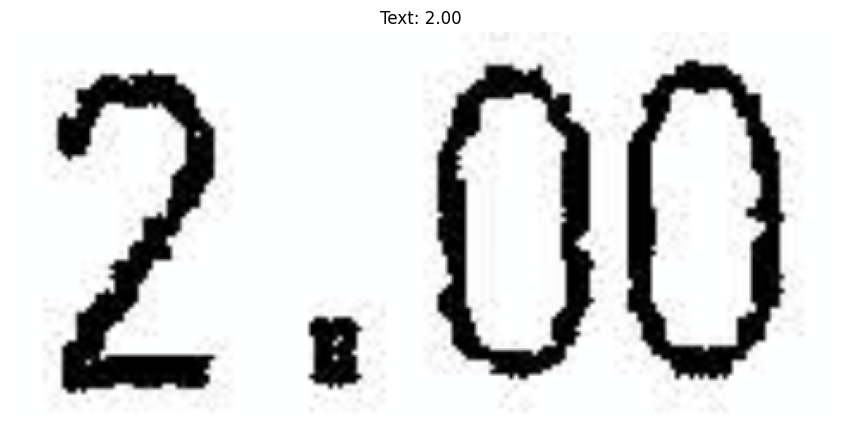

In [ ]:
import matplotlib.pyplot as plt

# Kiểm tra trực quan một mẫu từ dataset
if __name__ == "__main__":
    with open("vocab.json", "r", encoding="utf-8") as f:
        vocab_data = json.load(f)
        vocab = vocab_data['vocab']

    tokenizer = OCRTokenizer(vocab)
    transform = get_image_transform()
    dataset = OCRDataset(
        annotation_file="train_annotations.txt",
        tokenizer=tokenizer,
        transform=transform,
        target_height=224
    )

    # Kiểm tra mẫu thứ 18
    idx = 18
    img_tensor, tokens = dataset[idx]
    img = img_tensor.permute(1, 2, 0).numpy()
    img = (img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406]))
    img = img.clip(0, 1)
    text = tokenizer.decode(tokens.numpy(), skip_special_tokens=True)

    plt.figure(figsize=(15, 5))
    plt.imshow(img)
    plt.title(f"Text: {text}")
    plt.axis('off')
    plt.show()

In [ ]:
# Tạo DataLoader
def create_dataloaders(batch_size=128, num_workers=4):
    with open("vocab.json", "r", encoding="utf-8") as f:
        vocab_data = json.load(f)
        vocab = vocab_data['vocab']

    tokenizer = OCRTokenizer(vocab)
    transform = get_image_transform()

    train_dataset = OCRDataset(
        annotation_file="train_annotations.txt",
        tokenizer=tokenizer,
        transform=transform,
        target_height=48
    )
    val_dataset = OCRDataset(
        annotation_file="val_annotations.txt",
        tokenizer=tokenizer,
        transform=transform,
        target_height=48
    )
    test_dataset = OCRDataset(
        annotation_file="test_annotations.txt",
        tokenizer=tokenizer,
        transform=transform,
        target_height=48
    )

    train_loader = DataLoader(
        train_dataset,
        batch_size=batch_size,
        shuffle=True,
        collate_fn=collate_fn,
        num_workers=num_workers
    )
    val_loader = DataLoader(
        val_dataset,
        batch_size=64,
        shuffle=False,
        collate_fn=collate_fn,
        num_workers=num_workers
    )
    test_loader = DataLoader(
        test_dataset,
        batch_size=batch_size,
        shuffle=False,
        collate_fn=collate_fn,
        num_workers=num_workers
    )

    return train_loader, val_loader, test_loader

In [ ]:
def check_dataloader(dataloader, num_batches=5):
    """
    Kiểm tra DataLoader bằng cách in ra kích thước của images, targets và attention_mask.

    Parameters:
    - dataloader: DataLoader cần kiểm tra.
    - num_batches: Số lượng batch muốn kiểm tra. Mặc định là 5.
    """
    for i, batch in enumerate(dataloader):
        if i >= num_batches:
            break

        # Lấy dữ liệu trong batch
        images = batch['images']
        targets = batch['targets']
        attention_mask = batch['attention_mask']

        # In ra kích thước của images, targets và attention_mask
        print(f"Batch {i+1}:")
        print(f"  - Images shape: {images.shape}")  # (B, 3, H, W_max)
        print(f"  - Targets shape: {targets.shape}")  # (B, L_max)
        print(f"  - Attention mask shape: {attention_mask.shape}")  # (B, L_max)
        print("-" * 50)

# Kiểm tra với train_loader, val_loader hoặc test_loader
train_loader, val_loader, test_loader = create_dataloaders(batch_size=64, num_workers=2)

# Kiểm tra dataloader cho train_loader
check_dataloader(train_loader)

Batch 1:
  - Images shape: torch.Size([64, 3, 48, 1041])
  - Targets shape: torch.Size([64, 48])
  - Attention mask shape: torch.Size([64, 48])
--------------------------------------------------
Batch 2:
  - Images shape: torch.Size([64, 3, 48, 979])
  - Targets shape: torch.Size([64, 44])
  - Attention mask shape: torch.Size([64, 44])
--------------------------------------------------
Batch 3:
  - Images shape: torch.Size([64, 3, 48, 890])
  - Targets shape: torch.Size([64, 44])
  - Attention mask shape: torch.Size([64, 44])
--------------------------------------------------
Batch 4:
  - Images shape: torch.Size([64, 3, 48, 713])
  - Targets shape: torch.Size([64, 35])
  - Attention mask shape: torch.Size([64, 35])
--------------------------------------------------
Batch 5:
  - Images shape: torch.Size([64, 3, 48, 738])
  - Targets shape: torch.Size([64, 35])
  - Attention mask shape: torch.Size([64, 35])
--------------------------------------------------


In [ ]:
import random

# Kiểm tra 3 mẫu ngẫu nhiên từ DataLoader để đảm bảo rằng target và attention mask đúng
def check_random_samples(dataloader, num_samples=3):
    for i, batch in enumerate(dataloader):
        if i >= num_samples:  # Dừng khi đã kiểm tra đủ số lượng mẫu
            break

        images = batch['images']
        targets = batch['targets']
        attention_mask = batch['attention_mask']

        # Kiểm tra target và attention mask của từng sample trong batch
        for j in range(min(3, len(targets))):  # Kiểm tra tối đa 3 sample trong batch
            target = targets[j]
            mask = attention_mask[j]

            # Kiểm tra xem các token padding (PAD_ID = 0) trong target có khớp với các phần padding trong attention mask (0 là padding)
            padding_mismatch = False
            for k in range(target.shape[0]):
                if target[k] == 0 and mask[k] != 0:  # Token padding không được attention mask đánh dấu là padding
                    padding_mismatch = True
                    print(f"Padding mismatch at index {k} for sample {j}.")
                if target[k] != 0 and mask[k] == 0:  # Token không phải padding mà attention mask lại là padding
                    padding_mismatch = True
                    print(f"Non-padding token masked at index {k} for sample {j}.")

            if padding_mismatch:
                print(f"Sample {j} has mismatched padding between target and attention mask.")
            else:
                print(f"Sample {j} has correct padding between target and attention mask.")

            # In một vài thông tin để kiểm tra
            print(f"Sample {j} target length: {target.shape[0]}, attention mask length: {mask.shape[0]}")
            print("Target:", target)
            print("Attention mask:", mask)
            print("-" * 50)

# Sử dụng hàm kiểm tra cho DataLoader
check_random_samples(train_loader, num_samples=3)

Sample 0 has correct padding between target and attention mask.
Sample 0 target length: 47, attention mask length: 47
Target: tensor([ 1, 22,  2,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])
Attention mask: tensor([ True,  True,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False])
--------------------------------------------------
Sample 1 has correct padding between target and attention mask.
Sample 1 target length: 47, attention mask length: 47
Target: tensor([ 1, 19, 12,  9,  4, 46, 24, 12, 28,  4, 11,  8, 25, 32,  4, 13, 11, 10,
        11, 32,  4

### ResNet34 Backbone + Masked Attention + Transformer Decoder

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models

class OCRBackbone(nn.Module):
    def __init__(self, output_dim=512, pretrained=True, in_channels=3):
        super().__init__()

        base_model = models.resnet34(weights="IMAGENET1K_V1" if pretrained else None)

        # Tùy chỉnh conv1 nếu ảnh là grayscale
        if in_channels == 1:
            self.conv1 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)
            with torch.no_grad():
                self.conv1.weight.data = base_model.conv1.weight.data.mean(dim=1, keepdim=True)
        else:
            self.conv1 = base_model.conv1

        self.bn1 = base_model.bn1
        self.relu = base_model.relu
        self.maxpool = base_model.maxpool

        self.layer1 = base_model.layer1  # giữ nguyên
        self.layer2 = base_model.layer2
        self.layer3 = base_model.layer3
        self.layer4 = base_model.layer4

        self.pool = nn.AdaptiveAvgPool2d((1, None))  # H = 1, giữ W'
        self.output_conv = nn.Conv2d(512, output_dim, kernel_size=1)
        self.norm = nn.LayerNorm(output_dim)

    def forward(self, x):
        """
        Args:
            x: [B, C, H, W]
        Returns:
            features: [B, T, D]
        """
        x = self.conv1(x)     # [B, 64, H/2, W/2]
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)   # [B, 64, H/4, W/4]

        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        x = self.pool(x)                  # [B, 512, 1, W']
        x = self.output_conv(x)          # [B, output_dim, 1, W']
        x = x.squeeze(2).permute(0, 2, 1)  # [B, W', output_dim]
        return self.norm(x)


In [ ]:
import math

class PositionalEncoding(nn.Module):
    def __init__(self, d_model, max_len=5000):
        super().__init__()
        pe = torch.zeros(max_len, d_model)
        position = torch.arange(0, max_len).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, d_model, 2) * (-math.log(10000.0) / d_model))
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        pe = pe.unsqueeze(1)  # (max_len, 1, d_model)
        self.register_buffer('pe', pe)

    def forward(self, x):  # x: (seq_len, batch_size, d_model)
        return x + self.pe[:x.size(0)]

class TransformerDecoder(nn.Module):
    def __init__(self, vocab_size, embed_dim=512, num_heads=8, num_layers=3, dropout=0.1, max_len=100):
        super().__init__()
        self.embedding = nn.Embedding(vocab_size, embed_dim)
        self.pos_encoding = PositionalEncoding(embed_dim, max_len=max_len)

        decoder_layer = nn.TransformerDecoderLayer(
            d_model=embed_dim, nhead=num_heads, dim_feedforward=embed_dim*4, dropout=dropout
        )
        self.decoder = nn.TransformerDecoder(decoder_layer, num_layers=num_layers)
        self.fc = nn.Linear(embed_dim, vocab_size)
        self.embed_scale = embed_dim ** 0.5

    def generate_square_subsequent_mask(self, sz):
        # Tạo mask tam giác trên cho mô hình không thể nhìn thấy tương lai
        return torch.triu(torch.full((sz, sz), float('-inf')), diagonal=1)

    def forward(self, tgt, memory, tgt_mask=None, tgt_padding_mask=None):
        """
        Args:
          tgt: (B, T)
          memory: (B, S, D)
          tgt_mask: (T, T) hoặc None
          tgt_padding_mask: (B, T) hoặc None
        """
        # 1) embedding + pos encoding như cũ
        tgt_emb = self.embedding(tgt) * self.embed_scale
        tgt_emb = tgt_emb.transpose(0, 1)        # (T, B, D)
        tgt_emb = self.pos_encoding(tgt_emb)     # (T, B, D)

        # 2) nếu ngoài không truyền tgt_mask thì tạo inside
        if tgt_mask is None:
            tgt_mask = self.generate_square_subsequent_mask(tgt.size(1)).to(tgt.device)

        # 3) gọi TransformerDecoder
        out = self.decoder(
            tgt=tgt_emb,
            memory=memory.transpose(0, 1),       # (S, B, D)
            tgt_mask=tgt_mask,
            tgt_key_padding_mask=tgt_padding_mask
        )
        out = out.transpose(0, 1)               # (B, T, D)
        return self.fc(out)

In [ ]:
import torch
import torch.nn as nn

class OCRModel(nn.Module):
    def __init__(
        self,
        vocab_size,
        encoder=None,
        encoder_dim=512,
        embed_dim=512,
        num_heads=8,
        num_layers=3,
        dropout=0.1,
        sos_token_id=1,
        eos_token_id=2,
        max_len=100
    ):
        super().__init__()
        # encoder giữ nguyên
        self.encoder = encoder if encoder is not None else OCRBackbone(output_dim=encoder_dim)
        # projection nếu cần
        self.encoder_proj = nn.Linear(encoder_dim, embed_dim) if encoder_dim != embed_dim else nn.Identity()
        # transformer‐decoder giữ nguyên
        self.decoder = TransformerDecoder(
            vocab_size=vocab_size,
            embed_dim=embed_dim,
            num_heads=num_heads,
            num_layers=num_layers,
            dropout=dropout,
            max_len=max_len
        )
        # self.output_layer = nn.Linear(embed_dim, vocab_size)
        self.sos_token_id = sos_token_id
        self.eos_token_id = eos_token_id
        self.max_len = max_len

    def generate_square_subsequent_mask(self, sz: int) -> torch.Tensor:
        """ Mask upper-triangular for causal attention. """
        return torch.triu(torch.full((sz, sz), float('-inf')), diagonal=1)

    def forward(self,
                images: torch.Tensor,
                tgt_input: torch.Tensor,
                attention_mask: torch.Tensor
               ) -> torch.Tensor:
        """
        Args:
          images: [B, C, H, W]
          tgt_input: [B, T]       – token ids (including <SOS>)
          attention_mask: [B, T]  – True for real tokens, False for PAD
        Returns:
          logits: [B, T, vocab_size]
        """
        # 1) Encode hình ảnh
        memory = self.encoder(images)            # [B, S, encoder_dim]
        memory = self.encoder_proj(memory)       # [B, S, embed_dim]

        # 2) Tạo causal mask cho decoder (để không nhìn vào tương lai)
        T = tgt_input.size(1)
        tgt_mask = self.generate_square_subsequent_mask(T).to(images.device)  # [T, T]

        # 3) Tạo padding mask (True = vị trí pad sẽ bị ignore)
        # TransformerDecoder expects tgt_key_padding_mask shape [B, T], True=pad
        tgt_key_padding_mask = ~attention_mask  # invert: False-> real token, True->pad

        # 4) Decode
        # Note: our TransformerDecoder.forward signature is (tgt, memory, tgt_mask, ..., tgt_key_padding_mask)
        dec_out = self.decoder(
            tgt=tgt_input,
            memory=memory,
            tgt_mask=tgt_mask,
            tgt_padding_mask=tgt_key_padding_mask
        )  # [B, T, embed_dim]

        # 5) Project to vocab
        # logits = self.output_layer(dec_out)     # [B, T, vocab_size]
        # return logits
        return dec_out

    @torch.no_grad()
    def predict(self, images, max_len=None, beam_size=5, length_penalty=0.7):
        """
        Beam search decoding.
        images: Tensor [B, C, H, W]
        max_len: int, tối đa độ dài output (mặc định self.max_len)
        beam_size: int, số beam
        length_penalty: float, điều chỉnh score beam
        Trả về: Tensor [B, L_pred] gồm token_ids (ko có <SOS>, pad bằng <EOS>)
        """
        self.eval()
        max_len = max_len or self.max_len
        device = images.device

        # 1) Encode + project
        memory = self.encoder(images)                   # [B, S, encoder_dim]
        memory = self.encoder_proj(memory)              # [B, S, embed_dim]

        B = memory.size(0)
        final_outputs = []

        # 2) Beam search từng mẫu
        for b in range(B):
            mem = memory[b : b+1]   # [1, S, D]
            beams = [([self.sos_token_id], 0.0)]

            for _ in range(max_len):
                candidates = []
                for seq, score in beams:
                    if seq[-1] == self.eos_token_id:
                        candidates.append((seq, score))
                        continue

                    tgt = torch.tensor(seq, device=device).unsqueeze(0)  # [1, T]
                    # decoder sẽ tự tạo causal mask khi bạn không truyền tgt_mask
                    logits = self.decoder(tgt, mem)  # [1, T, vocab_size]
                    logp = torch.log_softmax(logits[:, -1, :], dim=-1)  # [1, vocab_size]
                    topk_logp, topk_ids = logp.topk(beam_size, dim=-1)  # [1, beam_size]

                    for i in range(beam_size):
                        candidates.append((
                            seq + [int(topk_ids[0, i])],
                            score + float(topk_logp[0, i])
                        ))

                # length normalization và giữ lại beam_size best
                beams = sorted(
                    candidates,
                    key=lambda x: x[1] / ((len(x[0]) ** length_penalty) if length_penalty > 0 else 1.0),
                    reverse=True
                )[:beam_size]

                # nếu tất cả beams đã kết thúc bằng <EOS>, dừng sớm
                if all(seq[-1] == self.eos_token_id for seq, _ in beams):
                    break

            # Chọn beam tốt nhất, loại <SOS> + cắt sau <EOS>
            best_seq = beams[0][0]
            if self.eos_token_id in best_seq:
                idx = best_seq.index(self.eos_token_id)
                best_seq = best_seq[1:idx]
            else:
                best_seq = best_seq[1:]

            final_outputs.append(best_seq)

        # 3) Padding về tensor [B, L_max_pred]
        max_p = max(len(s) for s in final_outputs)
        out = torch.full((B, max_p), self.eos_token_id, dtype=torch.long, device=device)
        for i, seq in enumerate(final_outputs):
            out[i, : len(seq)] = torch.tensor(seq, device=device)

        return out

    @torch.no_grad()
    def predict_greedy(self, images, max_len=None):
        """
        Greedy decoding: đơn giản, nhanh, dùng riêng cho evaluate()
        Trả về: Tensor [B, L_pred]
        """
        self.eval()
        max_len = max_len or self.max_len
        device = images.device

        memory = self.encoder(images)                   # [B, S, encoder_dim]
        memory = self.encoder_proj(memory)              # [B, S, embed_dim]
        B = memory.size(0)
        final_outputs = []

        for b in range(B):
            mem = memory[b:b+1]
            seq = [self.sos_token_id]

            for _ in range(max_len):
                tgt = torch.tensor(seq, device=device).unsqueeze(0)
                logits = self.decoder(tgt, mem)
                next_token = logits[:, -1, :].argmax(dim=-1).item()
                seq.append(next_token)
                if next_token == self.eos_token_id:
                    break

            # Cắt chuỗi
            if self.eos_token_id in seq:
                idx = seq.index(self.eos_token_id)
                seq = seq[1:idx]
            else:
                seq = seq[1:]

            final_outputs.append(seq)

        max_len_pred = max(len(s) for s in final_outputs)
        out = torch.full((B, max_len_pred), self.eos_token_id, dtype=torch.long, device=device)
        for i, seq in enumerate(final_outputs):
            out[i, :len(seq)] = torch.tensor(seq, device=device)

        return out

In [ ]:
class EarlyStopping:
    def __init__(self, patience=3, min_delta=0):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_loss = float('inf')

    def __call__(self, val_loss):
        if val_loss < self.best_loss - self.min_delta:
            self.best_loss = val_loss
            self.counter = 0
        else:
            self.counter += 1
            if self.counter >= self.patience:
                return True  # Dừng huấn luyện
        return False  # Tiếp tục

### Training model

In [ ]:
from torch.nn import CrossEntropyLoss
from torch.optim import Adam
from tqdm.notebook import tqdm

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

learning_rate = 1e-4
best_val_loss = float('inf')
save_path = "/content/best_ocr_model.pt"  # Hoặc: '/content/drive/MyDrive/...'

In [ ]:
# Hàm train_one_epoch
def train_one_epoch(model, dataloader, optimizer, criterion):
    model.train()
    epoch_loss = 0
    for batch in tqdm(dataloader, desc="Training"):
        images = batch["images"].to(device)               # Tensor (B,3,H,W)
        texts = batch["targets"].to(device)               # Tensor (B,T)
        tgt_padding_mask = ~batch["attention_mask"].to(device)  # True tại vị trí PAD

        # shift for decoder
        tgt_input = texts[:, :-1]     # [B, T-1]
        tgt_output = texts[:, 1:]     # [B, T-1]
        tgt_pad = tgt_padding_mask[:, :-1]  # [B, T-1]

        optimizer.zero_grad()
        logits = model(images, tgt_input, ~tgt_pad)
        # model expects attention_mask=True at real token, so invert tgt_pad

        # flatten và tính loss
        B, L, V = logits.shape
        loss = criterion(logits.reshape(-1, V), tgt_output.reshape(-1))
        loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
        optimizer.step()

        epoch_loss += loss.item()

    return epoch_loss / len(dataloader)

In [ ]:
import Levenshtein

# Hàm evaluate (tính CER)
def evaluate(model, dataloader, criterion):
    model.eval()
    epoch_loss = 0
    total_cer = 0
    total_samples = 0

    with torch.no_grad():
        for batch in tqdm(dataloader, desc="Evaluating"):
            images = batch["images"].to(device)
            texts = batch["targets"].to(device)
            tgt_padding_mask = ~batch["attention_mask"].to(device)

            tgt_input = texts[:, :-1]
            tgt_output = texts[:, 1:]
            tgt_pad = tgt_padding_mask[:, :-1]

            logits = model(images, tgt_input, ~tgt_pad)
            B, L, V = logits.shape
            loss = criterion(logits.reshape(-1, V), tgt_output.reshape(-1))
            epoch_loss += loss.item()

            # dự đoán beam-search
            # preds = model.predict(images, beam_size=5)
            preds = model.predict_greedy(images)
            pred_texts = [tokenizer.decode(p.tolist(), skip_special_tokens=True) for p in preds]
            true_texts = [tokenizer.decode(t.tolist(), skip_special_tokens=True) for t in texts]

            for pred, true in zip(pred_texts, true_texts):
                pred, true = pred.lower(), true.lower()
                if len(true) == 0:
                    continue
                # errors = sum(a != b for a, b in zip(pred, true))
                # total_cer += errors / max(len(true), 1)
                total_cer += Levenshtein.distance(pred, true) / max(len(true), 1)
                total_samples += 1

    avg_loss = epoch_loss / len(dataloader)
    avg_cer = total_cer / total_samples if total_samples else 0
    return avg_loss, avg_cer

In [ ]:
def visualize_prediction(model, dataloader, num_samples=4):
    model.eval()

    # Lấy batch thứ 5
    dataloader_iter = iter(dataloader)
    for _ in range(4):  # Bỏ qua 4 batch đầu
        next(dataloader_iter)
    batch = next(dataloader_iter)  # Batch thứ 5

    images = batch["images"][:num_samples].to(device)
    texts = batch["targets"][:num_samples]

    with torch.no_grad():
        preds = model.predict(images, beam_size=1)

    plt.figure(figsize=(15, 5))
    for i in range(num_samples):
        plt.subplot(1, num_samples, i+1)
        img = images[i].cpu()
        if img.shape[0] == 1:
            plt.imshow(img.squeeze(0), cmap='gray')
        else:
            plt.imshow(img.permute(1, 2, 0))
        plt.axis('off')

        pred_text = tokenizer.decode(preds[i].tolist(), skip_special_tokens=True)
        true_text = tokenizer.decode(texts[i].tolist(), skip_special_tokens=True)
        plt.title(f"P: {pred_text}\nT: {true_text}", fontsize=10)
    plt.tight_layout()
    plt.show()


Epoch 1/7


Evaluating: 100%|██████████| 241/241 [08:11<00:00,  2.04s/it]


Train Loss: 1.4325 | Val Loss: 0.5459 | Val CER: 0.1690
✅ Saved best model!


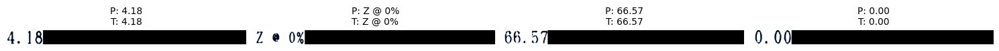


Epoch 2/7


Evaluating: 100%|██████████| 241/241 [08:23<00:00,  2.09s/it]


Train Loss: 0.3906 | Val Loss: 0.2448 | Val CER: 0.0904
✅ Saved best model!


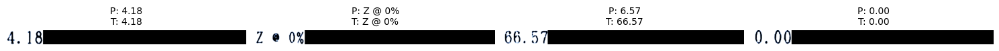


Epoch 3/7


Evaluating: 100%|██████████| 241/241 [08:12<00:00,  2.04s/it]


Train Loss: 0.2009 | Val Loss: 0.1731 | Val CER: 0.0653
✅ Saved best model!


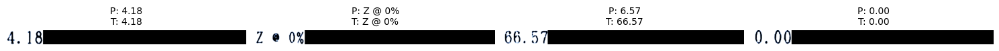


Epoch 4/7


Evaluating: 100%|██████████| 241/241 [08:20<00:00,  2.08s/it]


Train Loss: 0.1363 | Val Loss: 0.1385 | Val CER: 0.0460
✅ Saved best model!


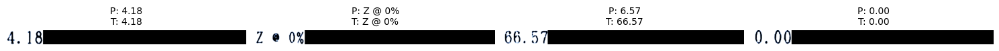


Epoch 5/7


Evaluating: 100%|██████████| 241/241 [08:12<00:00,  2.04s/it]


Train Loss: 0.1052 | Val Loss: 0.1227 | Val CER: 0.0391
✅ Saved best model!


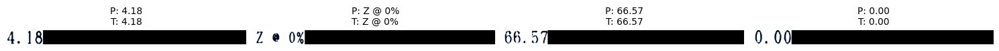


Epoch 6/7


Evaluating: 100%|██████████| 241/241 [08:20<00:00,  2.08s/it]


Train Loss: 0.0861 | Val Loss: 0.1089 | Val CER: 0.0445
✅ Saved best model!


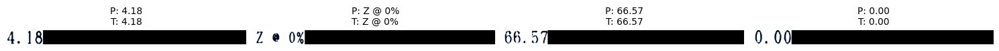


Epoch 7/7


Evaluating: 100%|██████████| 241/241 [08:20<00:00,  2.08s/it]


Train Loss: 0.0730 | Val Loss: 0.1063 | Val CER: 0.0334
✅ Saved best model!


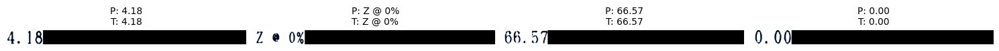

In [ ]:
import torch
import torch.optim as optim
import matplotlib.pyplot as plt
from torch import nn
from tqdm import tqdm

# Thiết lập device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Cài đặt các siêu tham số
num_epochs = 7  # Số epoch
learning_rate = 1e-4  # Learning rate
best_val_loss = float('inf')  # Lưu loss tốt nhất
save_path = "/content/best_ocr_model.pt"  # Đường dẫn lưu mô hình tốt nhất

# Đảm bảo mô hình được chuyển sang device (GPU hoặc CPU)
model = OCRModel(
    vocab_size=len(tokenizer.vocab),
    sos_token_id=tokenizer.vocab['<SOS>'],
    eos_token_id=tokenizer.vocab['<EOS>'],
    max_len=100  # Điều chỉnh nếu cần
).to(device)

# Định nghĩa loss function và optimizer
criterion = nn.CrossEntropyLoss(ignore_index=tokenizer.vocab['<PAD>'])
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

# Sử dụng learning rate scheduler để giảm LR khi loss không cải thiện
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=2, verbose=True)

# 2. Sửa phần train loop (thay đổi ít nhất)
early_stopper = EarlyStopping(patience=3)  # Dừng nếu loss không giảm sau

# Bắt đầu huấn luyện
for epoch in range(num_epochs):
    print(f"\nEpoch {epoch+1}/{num_epochs}")

    # Huấn luyện cho 1 epoch
    train_loss = train_one_epoch(model, train_loader, optimizer, criterion)

    # Đánh giá trên validation set
    val_loss, val_cer = evaluate(model, val_loader, criterion)

    # In ra kết quả
    print(f"Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f} | Val CER: {val_cer:.4f}")

    if early_stopper(val_loss):  # <-- Thêm dòng này để kiểm tra
        print(f"Early stopping at epoch {epoch+1}")
        break

    # Điều chỉnh learning rate nếu cần
    scheduler.step(val_loss)

    # Lưu lại mô hình tốt nhất
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        torch.save(model.state_dict(), save_path)
        print("✅ Saved best model!")

    # Hiển thị kết quả dự đoán trên validation set
    visualize_prediction(model, val_loader, num_samples=4)

##### Heatmap attention

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models

class OCRBackbone(nn.Module):
    def __init__(self, output_dim=512, pretrained=True, in_channels=3):
        super().__init__()

        base_model = models.resnet34(weights="IMAGENET1K_V1" if pretrained else None)

        # Tùy chỉnh conv1 nếu ảnh là grayscale
        if in_channels == 1:
            self.conv1 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)
            with torch.no_grad():
                self.conv1.weight.data = base_model.conv1.weight.data.mean(dim=1, keepdim=True)
        else:
            self.conv1 = base_model.conv1

        self.bn1 = base_model.bn1
        self.relu = base_model.relu
        self.maxpool = base_model.maxpool

        self.layer1 = base_model.layer1  # giữ nguyên
        self.layer2 = base_model.layer2
        self.layer3 = base_model.layer3
        self.layer4 = base_model.layer4

        self.pool = nn.AdaptiveAvgPool2d((1, None))  # H = 1, giữ W'
        self.output_conv = nn.Conv2d(512, output_dim, kernel_size=1)
        self.norm = nn.LayerNorm(output_dim)

    def forward(self, x):
        """
        Args:
            x: [B, C, H, W]
        Returns:
            features: [B, T, D]
        """
        x = self.conv1(x)     # [B, 64, H/2, W/2]
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)   # [B, 64, H/4, W/4]

        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        x = self.pool(x)                  # [B, 512, 1, W']
        x = self.output_conv(x)          # [B, output_dim, 1, W']
        x = x.squeeze(2).permute(0, 2, 1)  # [B, W', output_dim]
        return self.norm(x)

In [ ]:
import math
import copy
import torch
import torch.nn as nn

# Positional Encoding
class PositionalEncoding(nn.Module):
    def __init__(self, d_model, max_len=5000):
        super().__init__()
        pe = torch.zeros(max_len, d_model)
        position = torch.arange(0, max_len).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, d_model, 2) * (-math.log(10000.0) / d_model))
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        pe = pe.unsqueeze(1)  # (max_len, 1, d_model)
        self.register_buffer('pe', pe)

    def forward(self, x):  # x: (seq_len, batch_size, d_model)
        return x + self.pe[:x.size(0)]

In [ ]:
# Custom TransformerDecoderLayer
class TransformerDecoderLayerCustom(nn.Module):
    def __init__(self, d_model, nhead, dim_feedforward=2048, dropout=0.1):
        super().__init__()
        self.self_attn = nn.MultiheadAttention(d_model, nhead, dropout=dropout)
        self.cross_attn = nn.MultiheadAttention(d_model, nhead, dropout=dropout)
        self.linear1 = nn.Linear(d_model, dim_feedforward)
        self.dropout = nn.Dropout(dropout)
        self.linear2 = nn.Linear(dim_feedforward, d_model)

        self.norm1 = nn.LayerNorm(d_model)
        self.norm2 = nn.LayerNorm(d_model)
        self.norm3 = nn.LayerNorm(d_model)
        self.dropout1 = nn.Dropout(dropout)
        self.dropout2 = nn.Dropout(dropout)
        self.dropout3 = nn.Dropout(dropout)
        self.activation = nn.ReLU()

    def forward(self, tgt, memory, tgt_mask=None, memory_mask=None,
                tgt_key_padding_mask=None, memory_key_padding_mask=None):

        # 1. Self-attention
        tgt2 = self.self_attn(tgt, tgt, tgt, attn_mask=tgt_mask,
                              key_padding_mask=tgt_key_padding_mask)[0]
        tgt = tgt + self.dropout1(tgt2)
        tgt = self.norm1(tgt)

        # 2. Cross-attention (ảnh với text) — TRẢ RA attention weights
        tgt2, cross_attn_weights = self.cross_attn(
            tgt, memory, memory,
            attn_mask=memory_mask,
            key_padding_mask=memory_key_padding_mask,
            need_weights=True
        )
        tgt = tgt + self.dropout2(tgt2)
        tgt = self.norm2(tgt)

        # 3. FFN
        tgt2 = self.linear2(self.dropout(self.activation(self.linear1(tgt))))
        tgt = tgt + self.dropout3(tgt2)
        tgt = self.norm3(tgt)

        return tgt, cross_attn_weights

In [ ]:
# Stack nhiều lớp decoder
class TransformerDecoderCustom(nn.Module):
    def __init__(self, decoder_layer, num_layers):
        super().__init__()
        self.layers = nn.ModuleList([copy.deepcopy(decoder_layer) for _ in range(num_layers)])
        self.norm = nn.LayerNorm(decoder_layer.linear2.out_features)
        self.attn_weights_all = []

    def forward(self, tgt, memory, tgt_mask=None, memory_mask=None,
                tgt_key_padding_mask=None, memory_key_padding_mask=None):

        output = tgt
        self.attn_weights_all = []

        for mod in self.layers:
            output, cross_attn_weights = mod(
                output, memory,
                tgt_mask=tgt_mask,
                memory_mask=memory_mask,
                tgt_key_padding_mask=tgt_key_padding_mask,
                memory_key_padding_mask=memory_key_padding_mask
            )
            self.attn_weights_all.append(cross_attn_weights)  # (B, H, T, S)

        output = self.norm(output)
        return output

In [ ]:
# Decoder chính cho bài toán seq2seq
class TransformerDecoder(nn.Module):
    def __init__(self, vocab_size, embed_dim=512, num_heads=8, num_layers=3, dropout=0.1, max_len=150):
        super().__init__()
        self.embedding = nn.Embedding(vocab_size, embed_dim)
        self.pos_encoding = PositionalEncoding(embed_dim, max_len=max_len)

        decoder_layer = TransformerDecoderLayerCustom(
            d_model=embed_dim, nhead=num_heads, dim_feedforward=embed_dim*4, dropout=dropout
        )
        self.decoder = TransformerDecoderCustom(decoder_layer, num_layers=num_layers)
        self.fc = nn.Linear(embed_dim, vocab_size)
        self.embed_scale = embed_dim ** 0.5

    def generate_square_subsequent_mask(self, sz):
        return torch.triu(torch.ones(sz, sz) * float('-inf'), diagonal=1)

    def forward(self, tgt, memory, tgt_mask=None, tgt_padding_mask=None):
        """
        Args:
            tgt: (B, T)
            memory: (B, S, D)
            tgt_mask: (T, T)
            tgt_padding_mask: (B, T)
        """
        tgt_emb = self.embedding(tgt) * self.embed_scale  # (B, T, D)
        tgt_emb = tgt_emb.transpose(0, 1)                  # (T, B, D)
        tgt_emb = self.pos_encoding(tgt_emb)

        if tgt_mask is None:
            tgt_mask = self.generate_square_subsequent_mask(tgt.size(1)).to(tgt.device)

        out = self.decoder(
            tgt_emb,
            memory.transpose(0, 1),  # (S, B, D)
            tgt_mask=tgt_mask,
            tgt_key_padding_mask=tgt_padding_mask
        )  # output: (T, B, D)

        out = out.transpose(0, 1)               # (B, T, D)
        logits = self.fc(out)                   # (B, T, vocab_size)

        return logits, self.decoder.attn_weights_all  # Trả về logits và attention cho heatmap

In [ ]:
import torch
import torch.nn as nn

class OCRModel(nn.Module):
    def __init__(
        self,
        vocab_size,
        encoder=None,
        encoder_dim=512,
        embed_dim=512,
        num_heads=8,
        num_layers=3,
        dropout=0.1,
        sos_token_id=1,
        eos_token_id=2,
        max_len=150
    ):
        super().__init__()
        # encoder giữ nguyên
        self.encoder = encoder if encoder is not None else OCRBackbone(output_dim=encoder_dim)
        # projection nếu cần
        self.encoder_proj = nn.Linear(encoder_dim, embed_dim) if encoder_dim != embed_dim else nn.Identity()
        # transformer‐decoder giữ nguyên
        self.decoder = TransformerDecoder(
            vocab_size=vocab_size,
            embed_dim=embed_dim,
            num_heads=num_heads,
            num_layers=num_layers,
            dropout=dropout,
            max_len=max_len
        )
        # self.output_layer = nn.Linear(embed_dim, vocab_size)
        self.sos_token_id = sos_token_id
        self.eos_token_id = eos_token_id
        self.max_len = max_len

    def generate_square_subsequent_mask(self, sz: int) -> torch.Tensor:
        """ Mask upper-triangular for causal attention. """
        return torch.triu(torch.full((sz, sz), float('-inf')), diagonal=1)

    def forward(self,
                images: torch.Tensor,
                tgt_input: torch.Tensor,
                attention_mask: torch.Tensor
               ) -> torch.Tensor:
        """
        Args:
          images: [B, C, H, W]
          tgt_input: [B, T]       – token ids (including <SOS>)
          attention_mask: [B, T]  – True for real tokens, False for PAD
        Returns:
          logits: [B, T, vocab_size]
        """
        # 1) Encode hình ảnh
        memory = self.encoder(images)            # [B, S, encoder_dim]
        memory = self.encoder_proj(memory)       # [B, S, embed_dim]

        # 2) Tạo causal mask cho decoder (để không nhìn vào tương lai)
        T = tgt_input.size(1)
        # tgt_mask = self.generate_square_subsequent_mask(T).to(images.device)  # [T, T]
        tgt_mask = self.generate_square_subsequent_mask(T).to(images.device).type(torch.bool)

        # 3) Tạo padding mask (True = vị trí pad sẽ bị ignore)
        # TransformerDecoder expects tgt_key_padding_mask shape [B, T], True=pad
        tgt_key_padding_mask = ~attention_mask  # invert: False-> real token, True->pad

        # 4) Decode
        # Note: our TransformerDecoder.forward signature is (tgt, memory, tgt_mask, ..., tgt_key_padding_mask)
        dec_out, attn_weights = self.decoder(
            tgt=tgt_input,
            memory=memory,
            tgt_mask=tgt_mask,
            tgt_padding_mask=tgt_key_padding_mask
        )  # [B, T, embed_dim]

        # 5) Project to vocab
        # logits = self.output_layer(dec_out)     # [B, T, vocab_size]
        # return logits
        return dec_out, attn_weights

    @torch.no_grad()
    def predict(self, images, max_len=None, beam_size=5, length_penalty=0.7):
        """
        Beam search decoding.
        images: Tensor [B, C, H, W]
        max_len: int, tối đa độ dài output (mặc định self.max_len)
        beam_size: int, số beam
        length_penalty: float, điều chỉnh score beam
        Trả về: Tensor [B, L_pred] gồm token_ids (ko có <SOS>, pad bằng <EOS>)
        """
        self.eval()
        max_len = max_len or self.max_len
        device = images.device

        # 1) Encode + project
        memory = self.encoder(images)                   # [B, S, encoder_dim]
        memory = self.encoder_proj(memory)              # [B, S, embed_dim]

        B = memory.size(0)
        final_outputs = []
        all_attentions = []

        # 2) Beam search từng mẫu
        for b in range(B):
            mem = memory[b : b+1]   # [1, S, D]
            beams = [([self.sos_token_id], 0.0, [])]  # thêm list attention cho mỗi beam

            for _ in range(max_len):
                candidates = []
                for seq, score, attns in beams:
                    if seq[-1] == self.eos_token_id:
                        candidates.append((seq, score, attns))
                        continue

                    tgt = torch.tensor(seq, device=device).unsqueeze(0)  # [1, T]
                    # decoder sẽ tự tạo causal mask khi bạn không truyền tgt_mask
                    # logits = self.decoder(tgt, mem)  # [1, T, vocab_size]

                    dec_out, attn_weights = self.decoder(tgt, mem)
                    logp = torch.log_softmax(dec_out[:, -1, :], dim=-1)

                    # logp = torch.log_softmax(logits[:, -1, :], dim=-1)  # [1, vocab_size]
                    topk_logp, topk_ids = logp.topk(beam_size, dim=-1)  # [1, beam_size]

                    for i in range(beam_size):
                        new_seq = seq + [int(topk_ids[0, i])]
                        new_score = score + float(topk_logp[0, i])
                        new_attns = attns + [attn_weights]  # lưu từng attention
                        candidates.append((new_seq, new_score, new_attns))

                # length normalization và giữ lại beam_size best
                beams = sorted(
                    candidates,
                    key=lambda x: x[1] / ((len(x[0]) ** length_penalty) if length_penalty > 0 else 1.0),
                    reverse=True
                )[:beam_size]

                # nếu tất cả beams đã kết thúc bằng <EOS>, dừng sớm
                if all(seq[-1] == self.eos_token_id for seq, _, _ in beams):
                    break

            # Chọn beam tốt nhất, loại <SOS> + cắt sau <EOS>
            best_seq, _, best_attns = beams[0]

            if self.eos_token_id in best_seq:
                idx = best_seq.index(self.eos_token_id)
                best_seq = best_seq[1:idx]
                best_attns = best_attns[:idx - 1]  # exclude <SOS>, up to EOS
            else:
                best_seq = best_seq[1:]
                best_attns = best_attns[:]

            final_outputs.append(best_seq)
            all_attentions.append(best_attns)

        # 3) Padding về tensor [B, L_max_pred]
        max_p = max(len(s) for s in final_outputs)
        out = torch.full((B, max_p), self.eos_token_id, dtype=torch.long, device=device)
        for i, seq in enumerate(final_outputs):
            out[i, : len(seq)] = torch.tensor(seq, device=device)

        return out, all_attentions

    @torch.no_grad()
    def predict_greedy(self, images, max_len=None):
        """
        Greedy decoding: đơn giản, nhanh, dùng riêng cho evaluate()
        Trả về: Tensor [B, L_pred]
        """
        self.eval()
        max_len = max_len or self.max_len
        device = images.device

        # 1) Encode hình ảnh và project
        memory = self.encoder(images)                   # [B, S, encoder_dim]
        memory = self.encoder_proj(memory)              # [B, S, embed_dim]
        B = memory.size(0)
        final_outputs = []

        # 2) Greedy decoding cho mỗi mẫu
        for b in range(B):
            mem = memory[b:b+1]   # [1, S, D]
            seq = [self.sos_token_id]

            for _ in range(max_len):
                tgt = torch.tensor(seq, device=device).unsqueeze(0)  # [1, T]
                dec_out, _ = self.decoder(tgt, mem)  # [1, T, vocab_size]
                next_token = dec_out[:, -1, :].argmax(dim=-1).item()  # Lấy token có xác suất cao nhất
                seq.append(next_token)
                if next_token == self.eos_token_id:
                    break

            # 3) Cắt chuỗi nếu có <EOS>
            if self.eos_token_id in seq:
                idx = seq.index(self.eos_token_id)
                seq = seq[1:idx]  # Loại bỏ <SOS> và cắt sau <EOS>
            else:
                seq = seq[1:]  # Loại bỏ <SOS>

            final_outputs.append(seq)

        # 4) Padding về tensor có độ dài bằng nhau [B, L_max_pred]
        max_len_pred = max(len(s) for s in final_outputs)
        out = torch.full((B, max_len_pred), self.eos_token_id, dtype=torch.long, device=device)
        for i, seq in enumerate(final_outputs):
            out[i, :len(seq)] = torch.tensor(seq, device=device)

        return out

In [ ]:
class EarlyStopping:
    def __init__(self, patience=3, min_delta=0):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_loss = float('inf')

    def __call__(self, val_loss):
        if val_loss < self.best_loss - self.min_delta:
            self.best_loss = val_loss
            self.counter = 0
        else:
            self.counter += 1
            if self.counter >= self.patience:
                return True  # Dừng huấn luyện
        return False  # Tiếp tục

In [ ]:
from torch.nn import CrossEntropyLoss
from torch.optim import Adam
from tqdm.notebook import tqdm

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

learning_rate = 1e-4
best_val_loss = float('inf')
save_path = "/content/best_ocr_model.pt"  # Hoặc: '/content/drive/MyDrive/...'

In [ ]:
def train_one_epoch(model, dataloader, optimizer, criterion):
    model.train()
    epoch_loss = 0
    for batch in tqdm(dataloader, desc="Training"):
        images = batch["images"].to(device)               # Tensor (B, 3, H, W)
        texts = batch["targets"].to(device)               # Tensor (B, T)
        tgt_padding_mask = ~batch["attention_mask"].to(device)  # True tại vị trí PAD

        # shift for decoder
        tgt_input = texts[:, :-1]     # [B, T-1]
        tgt_output = texts[:, 1:]     # [B, T-1]
        tgt_pad = tgt_padding_mask[:, :-1]  # [B, T-1]

        optimizer.zero_grad()
        logits, attention_weights = model(images, tgt_input, ~tgt_pad)  # Get logits and attention weights

        # flatten và tính loss
        B, L, V = logits.shape
        loss = criterion(logits.reshape(-1, V), tgt_output.reshape(-1))
        loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
        optimizer.step()

        epoch_loss += loss.item()

        # Optionally, you can store attention weights for further visualization later
        # (or handle them within the batch loop if necessary)

    return epoch_loss / len(dataloader)


In [ ]:
import Levenshtein

# Hàm evaluate (tính CER)
def evaluate(model, dataloader, criterion):
    model.eval()
    epoch_loss = 0
    total_cer = 0
    total_samples = 0

    with torch.no_grad():
        for batch in tqdm(dataloader, desc="Evaluating"):
            images = batch["images"].to(device)
            texts = batch["targets"].to(device)
            tgt_padding_mask = ~batch["attention_mask"].to(device)

            tgt_input = texts[:, :-1]
            tgt_output = texts[:, 1:]
            tgt_pad = tgt_padding_mask[:, :-1]

            logits, attention_weights = model(images, tgt_input, ~tgt_pad)
            B, L, V = logits.shape
            loss = criterion(logits.reshape(-1, V), tgt_output.reshape(-1))
            epoch_loss += loss.item()

            # dự đoán beam-search
            # preds = model.predict(images, beam_size=5)
            preds = model.predict_greedy(images)
            pred_texts = [tokenizer.decode(p.tolist(), skip_special_tokens=True) for p in preds]
            true_texts = [tokenizer.decode(t.tolist(), skip_special_tokens=True) for t in texts]

            for pred, true in zip(pred_texts, true_texts):
                pred, true = pred.lower(), true.lower()
                if len(true) == 0:
                    continue
                # errors = sum(a != b for a, b in zip(pred, true))
                # total_cer += errors / max(len(true), 1)
                total_cer += Levenshtein.distance(pred, true) / max(len(true), 1)
                total_samples += 1

    avg_loss = epoch_loss / len(dataloader)
    avg_cer = total_cer / total_samples if total_samples else 0
    return avg_loss, avg_cer

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import torch

def visualize_prediction(model, dataloader, tokenizer, device, num_samples=4):
    model.eval()

    # Lấy một batch từ dataloader
    batch = next(iter(dataloader))
    images = batch["images"][:num_samples].to(device)
    texts = batch["targets"][:num_samples]

    with torch.no_grad():
        preds, all_attention_weights = model.predict(images, beam_size=1)

    fig, axes = plt.subplots(2, num_samples, figsize=(5 * num_samples, 10))

    for i in range(num_samples):
        # Hiển thị ảnh gốc
        img = images[i].detach().cpu()
        if img.shape[0] == 1:
            img = img.squeeze(0)
            axes[0, i].imshow(img, cmap='gray')
        else:
            img = img.permute(1, 2, 0)
            axes[0, i].imshow(img)

        # Hiển thị text dự đoán và ground truth
        pred_text = tokenizer.decode(preds[i].tolist(), skip_special_tokens=True)
        true_text = tokenizer.decode(texts[i].tolist(), skip_special_tokens=True)
        axes[0, i].set_title(f"P: {pred_text}\nT: {true_text}", fontsize=10)
        axes[0, i].axis('off')

        # Xử lý attention weights
        try:
            # Lấy attention weights từ tất cả các layers và heads
            # all_attention_weights là list các attention từ các layers
            # Mỗi attention có shape [B, num_heads, T, S]

            # Chọn layer cuối cùng và average qua các heads
            last_layer_attn = all_attention_weights[-1][i]  # [num_heads, T, S]
            avg_attn = last_layer_attn.mean(dim=0)  # [T, S]

            # Chọn attention cho token cuối cùng hoặc average tất cả tokens
            token_attn = avg_attn[-1]  # [S] - attention cho token cuối cùng

            # Resize attention map để khớp với ảnh
            H, W = img.shape[0], img.shape[1] if len(img.shape) > 1 else img.shape[1]
            attn_map = token_attn.reshape(1, -1)  # [1, S]
            attn_map = torch.nn.functional.interpolate(
                attn_map.unsqueeze(0).unsqueeze(0),
                size=(H, W),
                mode='bilinear'
            ).squeeze().cpu().numpy()

            # Hiển thị heatmap riêng
            sns.heatmap(attn_map, ax=axes[1, i], cmap='viridis', cbar=True)
            axes[1, i].set_title(f"Attention Heatmap - Sample {i+1}")
            axes[1, i].axis('off')

        except Exception as e:
            # print(f"⚠️ Error processing attention for sample {i}: {e}")
            axes[1, i].axis('off')

    plt.tight_layout()
    plt.savefig("attention_vis.png")
    plt.show()

    return all_attention_weights, images, texts, preds

In [ ]:
def plot_detailed_attention(attention_weights, image, text, token_idx=-1, layer=-1):
    """
    Vẽ chi tiết attention map cho một ảnh cụ thể
    Args:
        attention_weights: Danh sách attention weights từ model.predict()
        image: Ảnh gốc tensor [C, H, W]
        text: Văn bản dự đoán
        token_idx: Token cần visualize attention (-1 cho token cuối)
        layer: Layer cần visualize (-1 cho layer cuối)
    """
    # Lấy attention weights từ layer được chọn
    layer_attn = attention_weights[layer][0]  # [num_heads, T, S]

    # Average qua các heads
    avg_attn = layer_attn.mean(dim=0)  # [T, S]

    # Lấy attention cho token được chọn
    token_attn = avg_attn[token_idx]  # [S]

    # Chuẩn bị ảnh
    img = image.detach().cpu()
    if img.shape[0] == 1:
        img = img.squeeze(0)
    else:
        img = img.permute(1, 2, 0)

    # Resize attention map
    H, W = img.shape[0], img.shape[1] if len(img.shape) > 1 else img.shape[1]
    attn_map = token_attn.reshape(1, -1)
    attn_map = torch.nn.functional.interpolate(
        attn_map.unsqueeze(0).unsqueeze(0),
        size=(H, W),
        mode='bilinear'
    ).squeeze().cpu().numpy()

    # Chuẩn bị figure
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    # Ảnh gốc
    if len(img.shape) == 2:
        axes[0].imshow(img, cmap='gray')
    else:
        axes[0].imshow(img)
    axes[0].set_title("Original Image")
    axes[0].axis('off')

    # Heatmap
    sns.heatmap(attn_map, ax=axes[1], cmap='viridis')
    axes[1].set_title("Attention Heatmap")
    axes[1].axis('off')

    # Overlay
    axes[2].imshow(img, cmap='gray' if len(img.shape) == 2 else None)
    axes[2].imshow(attn_map, cmap='jet', alpha=0.5)
    axes[2].set_title("Attention Overlay")
    axes[2].axis('off')

    plt.suptitle(f"Attention for token '{text[token_idx]}' (Layer {layer})", y=1.05)
    plt.tight_layout()
    plt.savefig("detailed_attention.png")
    plt.show()

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import torch

def plot_token_attention(attn_weights_all, token_idx=0, layer=0, head=0):
    """
    attn_weights_all: list of tensors [L x (B, H, T, S)]
    token_idx: token đầu ra đang xét (T)
    """
    attn = attn_weights_all[layer]  # (B, H, T, S)
    attn_tensor = attn[0, head]  # (T, S)

    token_attention = attn_tensor[token_idx]  # (S,)

    plt.figure(figsize=(10, 1.5))
    sns.heatmap(token_attention.unsqueeze(0).cpu().detach().numpy(), cmap="viridis", cbar=True)
    plt.title(f"Attention for token {token_idx} | Layer {layer} | Head {head}")
    plt.xlabel("Source Feature Index")
    plt.yticks([])
    plt.show()


Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
100%|██████████| 83.3M/83.3M [00:01<00:00, 57.7MB/s]
/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(



Epoch 1/2


Evaluating: 100%|██████████| 121/121 [10:02<00:00,  4.98s/it]


Train Loss: 1.4250 | Val Loss: 0.5622 | Val CER: 0.2299
✅ Saved best model!


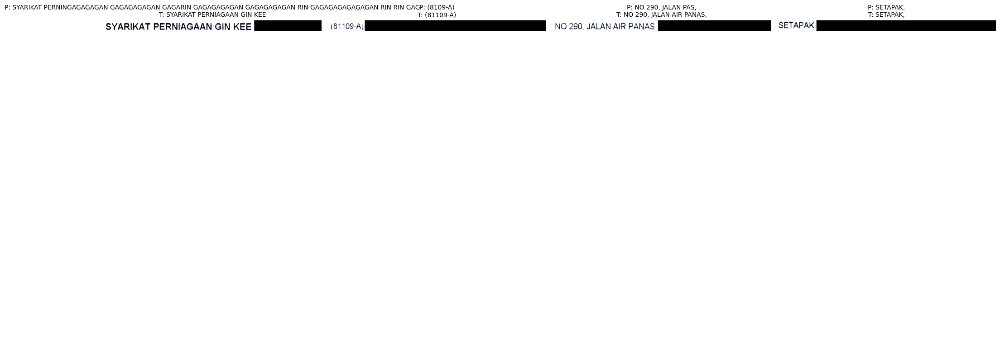


Epoch 2/2


Evaluating: 100%|██████████| 121/121 [09:02<00:00,  4.48s/it]


Train Loss: 0.3911 | Val Loss: 0.2383 | Val CER: 0.0815
✅ Saved best model!


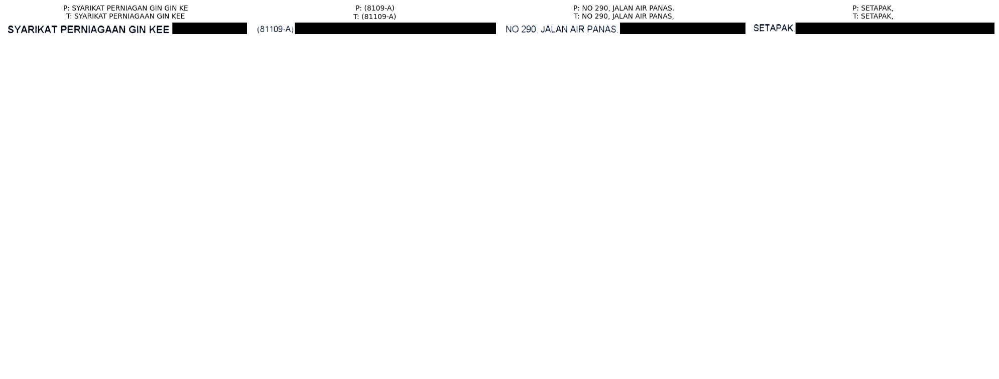

In [ ]:
import torch
import torch.optim as optim
import matplotlib.pyplot as plt
from torch import nn
from tqdm import tqdm

# Thiết lập device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Cài đặt các siêu tham số
num_epochs = 2  # Số epoch
learning_rate = 1e-4  # Learning rate
best_val_loss = float('inf')  # Lưu loss tốt nhất
save_path = "/content/best_ocr_model.pt"  # Đường dẫn lưu mô hình tốt nhất

# Đảm bảo mô hình được chuyển sang device (GPU hoặc CPU)
model = OCRModel(
    vocab_size=len(tokenizer.vocab),
    sos_token_id=tokenizer.vocab['<SOS>'],
    eos_token_id=tokenizer.vocab['<EOS>'],
    max_len=100  # Điều chỉnh nếu cần
).to(device)

# Định nghĩa loss function và optimizer
criterion = nn.CrossEntropyLoss(ignore_index=tokenizer.vocab['<PAD>'])
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

# Sử dụng learning rate scheduler để giảm LR khi loss không cải thiện
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=2, verbose=True)

# 2. Sửa phần train loop (thay đổi ít nhất)
early_stopper = EarlyStopping(patience=3)  # Dừng nếu loss không giảm sau

# Bắt đầu huấn luyện
for epoch in range(num_epochs):
    print(f"\nEpoch {epoch+1}/{num_epochs}")

    # Huấn luyện cho 1 epoch
    train_loss = train_one_epoch(model, train_loader, optimizer, criterion)

    # Đánh giá trên validation set
    val_loss, val_cer = evaluate(model, val_loader, criterion)
    # val_loss, val_cer = evaluate(model, val_loader, criterion, tokenizer, device, visualize_attention=False)


    # In ra kết quả
    print(f"Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f} | Val CER: {val_cer:.4f}")

    if early_stopper(val_loss):  # <-- Thêm dòng này để kiểm tra
        print(f"Early stopping at epoch {epoch+1}")
        break

    # Điều chỉnh learning rate nếu cần
    scheduler.step(val_loss)

    # Lưu lại mô hình tốt nhất
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        torch.save(model.state_dict(), save_path)
        print("✅ Saved best model!")

    # Hiển thị kết quả dự đoán trên validation set
    # visualize_prediction(model, val_loader, tokenizer, device, num_samples=4)
    last_attention, last_images, last_texts, last_preds = visualize_prediction(
        model, val_loader, tokenizer, device, num_samples=4
    )

### Heatmap Attention

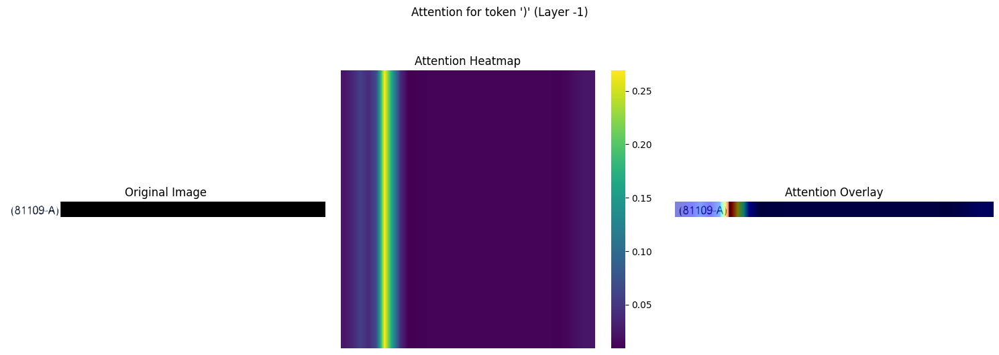

In [ ]:
# Cell này chạy sau khi huấn luyện xong
sample_idx = 1  # Chọn sample đầu tiên (0-3)

# Lấy thông tin từ kết quả visualization cuối cùng
selected_attention = last_attention
selected_image = last_images[sample_idx]
selected_pred_text = tokenizer.decode(last_preds[sample_idx].tolist(), skip_special_tokens=True)

# Hiển thị attention chi tiết cho token cụ thể
plot_detailed_attention(
    selected_attention[sample_idx],  # attention weights cho sample được chọn
    selected_image,
    selected_pred_text,
    token_idx=-1,  # Có thể thay đổi để xem attention cho token khác
    layer=-1       # Có thể thay đổi để xem attention từ layer khác
)

In [ ]:
def analyze_character_attention(attention_weights, image, text, token_idx, layer=-1, threshold=0.1):
    """
    Phân tích các ký tự được chú ý khi dự đoán 1 token cụ thể
    Args:
        attention_weights: Danh sách attention weights từ model.predict()
        image: Ảnh gốc tensor [C, H, W]
        text: Văn bản dự đoán
        token_idx: Vị trí token cần phân tích
        layer: Layer cần visualize (-1 cho layer cuối)
        threshold: Ngưỡng attention để xác định ký tự quan trọng
    """
    # Lấy attention map
    layer_attn = attention_weights[layer][0] if isinstance(attention_weights[layer], list) else attention_weights[layer]
    avg_attn = layer_attn.mean(dim=0)  # [T, S]
    token_attn = avg_attn[token_idx]   # [S]

    # Chuẩn bị ảnh
    img = image.detach().cpu()
    if img.shape[0] == 1:
        img = img.squeeze(0)
    else:
        img = img.permute(1, 2, 0)

    # Xác định các ký tự quan trọng
    important_indices = torch.where(token_attn > threshold)[0]
    print(f"\nPhân tích attention cho token '{text[token_idx]}' (vị trí {token_idx}):")
    print(f"Ngưỡng attention: {threshold:.2f}")
    print("Các ký tự được chú ý nhiều nhất:")

    for idx in important_indices:
        char = text[min(idx, len(text)-1)]  # Phòng trường hợp vượt quá độ dài
        print(f"- Ký tự '{char}' (vị trí {idx}): attention_score = {token_attn[idx]:.4f}")

    # Visualize
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Ảnh gốc với highlight
    axes[0].imshow(img, cmap='gray' if len(img.shape) == 2 else None)
    axes[0].set_title(f"Text: {text}")
    axes[0].axis('off')

    # Attention heatmap
    sns.heatmap(token_attn.unsqueeze(0).cpu().numpy(),
                ax=axes[1],
                cmap="YlOrRd",
                annot=True,
                fmt=".2f",
                cbar=False)
    axes[1].set_title(f"Attention scores cho token '{text[token_idx]}'")
    axes[1].set_xlabel("Vị trí ký tự")
    axes[1].set_ylabel("Attention")
    axes[1].set_xticks(range(len(text)))
    axes[1].set_xticklabels(list(text))

    plt.tight_layout()
    plt.show()

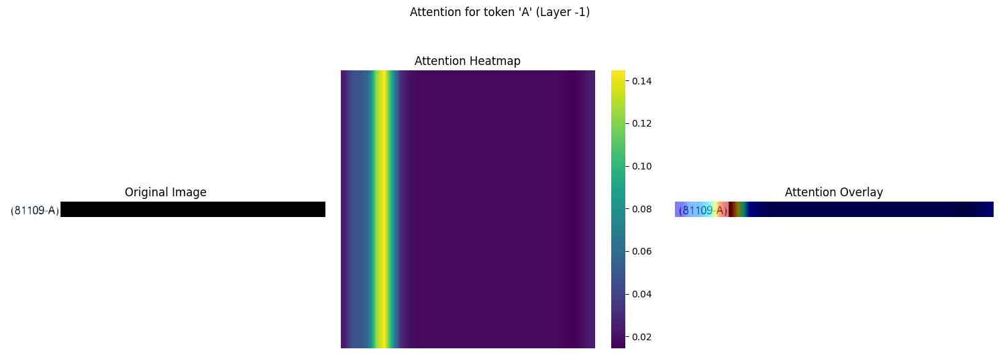


Phân tích attention cho token 'A' (vị trí 6):
Ngưỡng attention: 0.05
Các ký tự được chú ý nhiều nhất:
- Ký tự '0' (vị trí 3): attention_score = 0.0614
- Ký tự '9' (vị trí 4): attention_score = 0.1234
- Ký tự '-' (vị trí 5): attention_score = 0.1450
- Ký tự 'A' (vị trí 6): attention_score = 0.0889


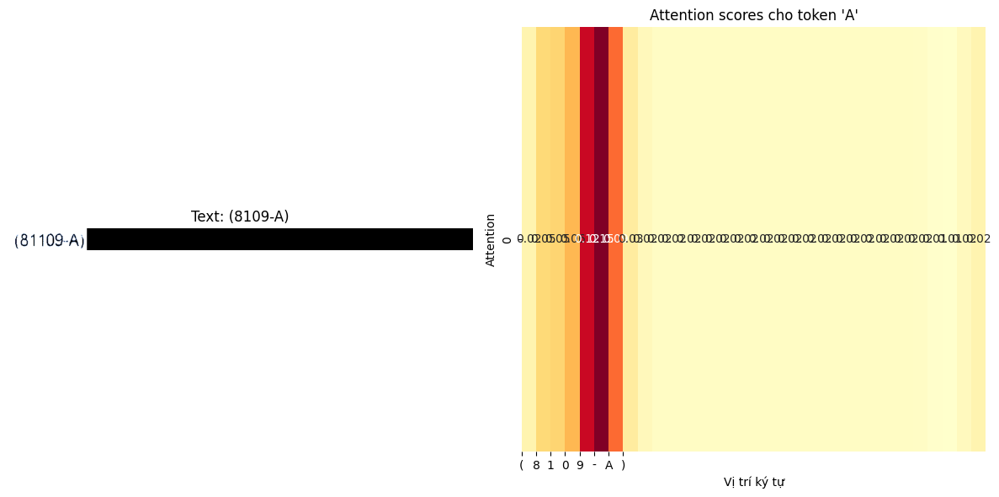

In [ ]:
# Cell này chạy sau khi huấn luyện xong
sample_idx = 1  # Chọn sample (0-3)
token_to_analyze = 'A'  # Ký tự muốn phân tích

# Lấy dữ liệu
selected_attention = last_attention
selected_image = last_images[sample_idx]
selected_pred_text = tokenizer.decode(last_preds[sample_idx].tolist(), skip_special_tokens=True)

# Tìm vị trí token trong text
token_idx = selected_pred_text.index(token_to_analyze)

# 1. Hiển thị heatmap tổng quan
plot_detailed_attention(
    selected_attention[sample_idx],
    selected_image,
    selected_pred_text,
    token_idx=token_idx,
    layer=-1
)

# 2. Phân tích chi tiết các ký tự được chú ý
analyze_character_attention(
    selected_attention[sample_idx],
    selected_image,
    selected_pred_text,
    token_idx=token_idx,
    layer=-1,
    threshold=0.05  # Có thể điều chỉnh
)

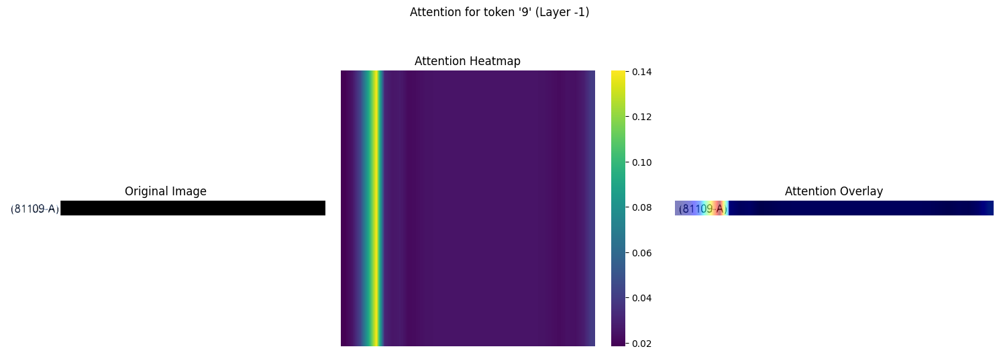


Phân tích attention cho token '9' (vị trí 4):
Ngưỡng attention: 0.05
Các ký tự được chú ý nhiều nhất:
- Ký tự '0' (vị trí 3): attention_score = 0.0913
- Ký tự '9' (vị trí 4): attention_score = 0.1414


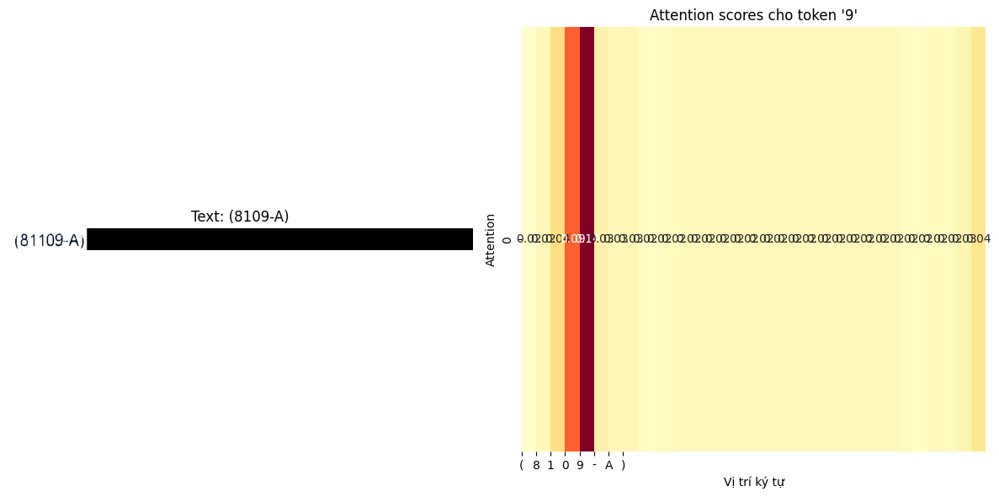

In [ ]:
# Cell này chạy sau khi huấn luyện xong
sample_idx = 1  # Chọn sample (0-3)
token_to_analyze = '9'  # Ký tự muốn phân tích

# Lấy dữ liệu
selected_attention = last_attention
selected_image = last_images[sample_idx]
selected_pred_text = tokenizer.decode(last_preds[sample_idx].tolist(), skip_special_tokens=True)

# Tìm vị trí token trong text
token_idx = selected_pred_text.index(token_to_analyze)

# 1. Hiển thị heatmap tổng quan
plot_detailed_attention(
    selected_attention[sample_idx],
    selected_image,
    selected_pred_text,
    token_idx=token_idx,
    layer=-1
)

# 2. Phân tích chi tiết các ký tự được chú ý
analyze_character_attention(
    selected_attention[sample_idx],
    selected_image,
    selected_pred_text,
    token_idx=token_idx,
    layer=-1,
    threshold=0.05  # Có thể điều chỉnh
)

### Inference

In [ ]:
import os
import json
import cv2
import torch
import numpy as np
from PIL import Image
from torchvision import transforms

# 1. Cấu hình chung
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_path = "/content/resnet34_7epoch_2h50.pt"    # đường dẫn checkpoint
annotation_path = "/content/receipt_dataset/test/annotations/receipt_0007.json"
image_path      = "/content/receipt_dataset/test/img/receipt_0007.jpg"

# 2. Load vocab & tokenizer (giữ y hệt training)
with open("vocab.json", "r", encoding="utf-8") as f:
    vocab = json.load(f)["vocab"]
tokenizer = OCRTokenizer(vocab)

# 3. Khởi tạo & load model
model = OCRModel(
    vocab_size=len(tokenizer.vocab),
    sos_token_id=tokenizer.vocab["<SOS>"],
    eos_token_id=tokenizer.vocab["<EOS>"],
    max_len=100
).to(device)
state = torch.load(model_path, map_location=device)
model.load_state_dict(state)
model.eval()

# 4. Transform chỉ Normalize như lúc training
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485,0.456,0.406],
                         std =[0.229,0.224,0.225])
])

# 5. Load ảnh + annotation
image = cv2.imread(image_path)
assert image is not None, f"Không đọc được {image_path}"
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
with open(annotation_path, "r", encoding="utf-8") as f:
    annotations = json.load(f)

# 6. Crop từng dòng, resize theo tỉ lệ, rồi ToTensor+Normalize
target_height = 48
tensors = []
for item in annotations:
    pts = np.array(item["box"], dtype=np.float32)
    x,y,w,h = cv2.boundingRect(pts)
    roi = image_rgb[y:y+h, x:x+w]

    # resize theo tỷ lệ
    ratio = target_height / roi.shape[0]
    new_w = max(1, int(roi.shape[1] * ratio))
    resized = cv2.resize(roi, (new_w, target_height))

    # PIL → Tensor → Normalize
    pil = Image.fromarray(resized)
    t   = transform(pil)
    tensors.append(t)

# 7. Pad width động giống collate_fn
widths = [t.shape[2] for t in tensors]
max_w  = max(widths)
batch  = torch.zeros(len(tensors), 3, target_height, max_w, device=device)
for i,t in enumerate(tensors):
    batch[i,:, :, : t.shape[2]] = t

# 8. Inference
with torch.no_grad():
    output_ids = model.predict(batch, beam_size=5)  # beam=5 cũng được
    for i, ids in enumerate(output_ids):
        txt = tokenizer.decode(ids.tolist(), skip_special_tokens=True)
        print(f"Line {i+1}: {txt}")

Line 1: TAN CHAY YEE
Line 2: SOON HUAT MACHINERY ENTERY ENTERISE
Line 3: (JM0352019-K)
Line 4: NO.53 JALAN PUTRA 1,
Line 5: TAMAN SRIPUTRA.
Line 6: 41200 JOHOR BAHRU
Line 7: JOHOR
Line 8: TEL : 07-55547360/016-79333391
Line 9: FAX : 07-5624059
Line 10: SONHUAT20006@HOTMAIL.COM
Line 11: GST ID:0021168376
Line 12: CASH SALES
Line 13: DOCNO.
Line 14: : CS0000040
Line 15: DATE: 11/01/2019
Line 16: CASHIER
Line 17: : USER
Line 18: TIME: 09:44:00
Line 19: SALESPERSON :
Line 20: REF.:
Line 21: GOODS SOLD ARE NOT RETURNABLE, THANK YOU.
Line 22: ITEM
Line 23: QTY
Line 24: SPRIE
Line 25: S/PRICE
Line 26: AMOUNT
Line 27: TAX
Line 28: 1072
Line 29: 1
Line 30: 80.00
Line 31: 80.00
Line 32: 80.00
Line 33: REPAIR ENGINER SPRAYER (1UNINT)
Line 34: WORKMANSHIP & SERVICE
Line 35: 70549
Line 36: 1
Line 37: 160.00
Line 38: 16.00
Line 39: 160.00
Line 40: GIANT 605 OVERLOWASSY
Line 41: 1071
Line 42: 1
Line 43: 17.00
Line 44: 17:00
Line 45: 17.00
Line 46: ENGINE OL
Line 47: 7091
Line 48: 1
Line 49: 10.00
Lin

In [ ]:
from google.colab import files

# Đường dẫn đến file model đã lưu
files.download("/content/resnet34_7epoch_2h50.pt")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
import os
import json
import cv2
import torch
import numpy as np
from PIL import Image
from torchvision import transforms
from tabulate import tabulate

# === CẤU HÌNH ===
device         = torch.device("cuda" if torch.cuda.is_available() else "cpu")
image_name     = "receipt_0007.jpg"
test_image_path = f"/content/receipt_dataset/test/img/{image_name}"
anno_path       = f"/content/receipt_dataset/test/annotations/{image_name.replace('.jpg', '.json')}"

# === TẢI MODEL ===
model = OCRModel(
    vocab_size=len(tokenizer.vocab),
    sos_token_id=tokenizer.vocab['<SOS>'],
    eos_token_id=tokenizer.vocab['<EOS>'],
    max_len=100
).to(device)
model.load_state_dict(torch.load("/content/resnet34_7epoch_2h50.pt", map_location=device))
model.eval()

# === TRANSFORM (giống lúc training) ===
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485,0.456,0.406],
                         std =[0.229,0.224,0.225])
])

# === HÀM GIẢI MÃ OUTPUT ===
def decode_ids(ids):
    return tokenizer.decode(ids, skip_special_tokens=True)

# === LOAD ẢNH + ANNOTATION ===
image = cv2.imread(test_image_path)
assert image is not None, f"Không đọc được {test_image_path}"
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
with open(anno_path, 'r', encoding='utf-8') as f:
    annotations = json.load(f)

# === INFERENCE MỖI DÒNG ===
results = []
target_height = 48

print(f"\n📄 Kết quả dự đoán cho ảnh: {image_name}\n")
for i, item in enumerate(annotations):
    pts = np.array(item['box'], dtype=np.float32)
    # 1) Crop bằng boundingRect (ko warp)
    x,y,w,h = cv2.boundingRect(pts)
    roi = image_rgb[y:y+h, x:x+w]

    # 2) Resize theo tỉ lệ để chiều cao = target_height
    ratio   = target_height / float(h)
    new_w   = max(1, int(w * ratio))
    resized = cv2.resize(roi, (new_w, target_height))

    # 3) ToTensor + Normalize
    pil = Image.fromarray(resized)
    t   = transform(pil).unsqueeze(0).to(device)  # [1,3,48,new_w]

    # 4) Pad width nếu bạn muốn batch nhiều dòng cùng lúc—
    #    nhưng ở đây mỗi dòng 1 sample, CNN+Transformer đều chấp nhận width linh hoạt.

    # 5) Predict
    with torch.no_grad():
        out_ids  = model.predict(t, beam_size=5)[0].cpu().tolist()
        pred_txt = decode_ids(out_ids)

    gt_txt = item['text']
    results.append([f"Line {i+1}", gt_txt, pred_txt])

# === HIỂN THỊ KẾT QUẢ DẠNG BẢNG ===
headers = ["Dòng", "Ground‑Truth", "Prediction"]
print(tabulate(results, headers, tablefmt="grid"))

# === ĐỘ CHÍNH XÁC DÒNG ===
correct = sum(1 for _, gt, pr in results if gt == pr)
acc     = correct / len(results) * 100
print(f"\n🔍 Độ chính xác dòng: {acc:.2f}% ({correct}/{len(results)})")


📄 Kết quả dự đoán cho ảnh: receipt_0007.jpg

+---------+-------------------------------------------+------------------------------------------------------------------------------------------------------+
| Dòng    | Ground‑Truth                              | Prediction                                                                                           |
+=========+===========================================+======================================================================================================+
| Line 1  | TAN CHAY YEE                              | TAN CHAY YEE                                                                                         |
+---------+-------------------------------------------+------------------------------------------------------------------------------------------------------+
| Line 2  | SOON HUAT MACHINERY ENTERPRISE            | SOON HUAT MACHINERY ENTERY ENTERISE                                                                  |


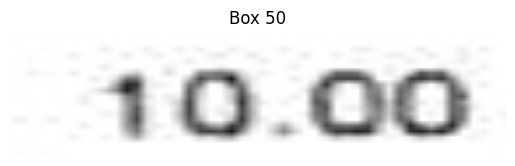

✅ Dự đoán cho box 50: 10.00


In [ ]:
import json
import cv2
import torch
from torchvision import transforms
import matplotlib.pyplot as plt

# ==== CẤU HÌNH ====
image_path = '/content/receipt_dataset/test/img/receipt_0007.jpg'               # đường dẫn ảnh
annotation_path = '/content/receipt_dataset/test/annotations/receipt_0007.json'         # đường dẫn file box annotation JSON
order = 50                               # Chọn bounding box thứ mấy (bắt đầu từ 0)
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# ==== TIỀN XỬ LÝ ====
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((64, 256)),  # thay đổi tùy backbone
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])    # nếu ảnh grayscale
])

# ==== LOAD ẢNH & BOX ====
with open(annotation_path, 'r') as f:
    data = json.load(f)

box = data[order]['box']  # [[x1, y1], [x2, y2], [x3, y3], [x4, y4]]
pts = np.array(box, dtype=np.float32)

# Load ảnh và crop theo bounding box
image = cv2.imread(image_path)
h, w = 64, 256  # khung chuẩn OCR
target_pts = np.array([[0, 0], [w-1, 0], [w-1, h-1], [0, h-1]], dtype=np.float32)

M = cv2.getPerspectiveTransform(pts, target_pts)
cropped = cv2.warpPerspective(image, M, (w, h))

# Hiển thị ảnh crop
plt.imshow(cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB))
plt.title(f'Box {order}')
plt.axis('off')
plt.show()

# ==== CHẠY MODEL OCR ====
input_tensor = transform(cropped).unsqueeze(0).to(device)  # [1, C, H, W]

with torch.no_grad():
    output_ids = model.predict(input_tensor)
    pred_text = tokenizer.decode(output_ids[0].tolist())

print(f"✅ Dự đoán cho box {order}:", pred_text)

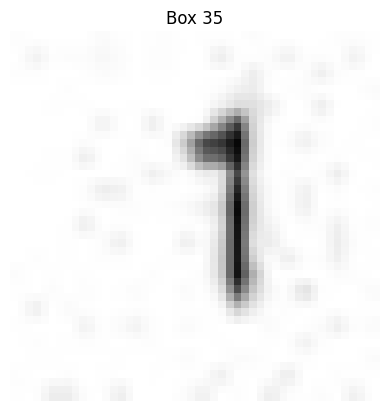

✅ Dự đoán cho box 35: 1


In [ ]:
import json
import cv2
import torch
from torchvision import transforms
import matplotlib.pyplot as plt
import numpy as np

# ==== CẤU HÌNH ====
image_path = '/content/receipt_dataset/test/img/receipt_0007.jpg'               # đường dẫn ảnh
annotation_path = '/content/receipt_dataset/test/annotations/receipt_0007.json'         # đường dẫn file box annotation JSON
order = 35                                 # Chọn bounding box thứ mấy (bắt đầu từ 0)
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# ==== TIỀN XỬ LÝ ====
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485,0.456,0.406], std=[0.229,0.224,0.225])  # Giá trị mean và std chuẩn từ ImageNet cho ảnh màu
])

# ==== LOAD ẢNH & BOX ====
with open(annotation_path, 'r') as f:
    data = json.load(f)

box = data[order]['box']  # [[x1, y1], [x2, y2], [x3, y3], [x4, y4]]
pts = np.array(box, dtype=np.float32)

# Load ảnh
image = cv2.imread(image_path)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Crop và chuẩn hóa vùng chứa văn bản từ bounding box
x, y, w, h = cv2.boundingRect(pts)
roi = image_rgb[y:y+h, x:x+w]

# ==== Resize theo tỉ lệ ====
target_height = 48  # Cùng height như bạn đã chuẩn bị trong pipeline training
ratio = target_height / float(h)
new_width = int(w * ratio)
resized = cv2.resize(roi, (new_width, target_height))

# Hiển thị ảnh crop và resize
plt.imshow(resized)
plt.title(f'Box {order}')
plt.axis('off')
plt.show()

# ==== CHẠY MODEL OCR ====
input_tensor = transform(resized).unsqueeze(0).to(device)  # [1, C, H, W]

with torch.no_grad():
    output_ids = model.predict(input_tensor)  # Dự đoán bằng mô hình OCR (cần model đã huấn luyện)
    pred_text = tokenizer.decode(output_ids[0].tolist())

print(f"✅ Dự đoán cho box {order}: {pred_text}")



📄 Predicted text for test10.jpg: F.STR:


<ipython-input-43-2c7ec48adf6f>:47: UserWarning: Glyph 128196 (\N{PAGE FACING UP}) missing from font(s) DejaVu Sans.
  plt.tight_layout()


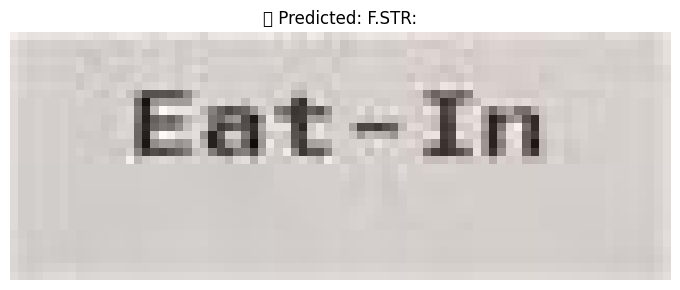

In [ ]:
import os
import torch
import cv2
from PIL import Image
import matplotlib.pyplot as plt
from torchvision import transforms

# Khởi tạo model
model = OCRModel(
    vocab_size=len(tokenizer.vocab),
    sos_token_id=tokenizer.vocab['<SOS>'],
    eos_token_id=tokenizer.vocab['<EOS>'],
    max_len=100
).to(device)

model.load_state_dict(torch.load("/content/resnet34_7epoch_2h50.pt"))
model.eval()

# Transform ảnh RGB (3 kênh)
transform = transforms.Compose([
    transforms.Resize((32, 128)),
    transforms.ToTensor(),  # [3, 32, 128]
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])

# === Đường dẫn ảnh đã crop sẵn ===
image_path = "/content/test10.jpg"
image = cv2.imread(image_path)  # đọc ảnh màu
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # chuyển sang RGB

# Tiền xử lý
pil_image = Image.fromarray(image)
input_tensor = transform(pil_image).unsqueeze(0).to(device)

# Dự đoán
with torch.no_grad():
    output_ids = model.predict(input_tensor)
    pred_text = tokenizer.decode(output_ids[0].tolist())

print(f"\n📄 Predicted text for {os.path.basename(image_path)}: {pred_text}")

# === Hiển thị ảnh và kết quả OCR ===
plt.figure(figsize=(8, 3))
plt.imshow(image)
plt.title(f"📄 Predicted: {pred_text}", fontsize=12)
plt.axis("off")
plt.tight_layout()
plt.show()


In [ ]:
def resize_with_padding(image, target_height=48, target_width=160):
    """
    Resize ảnh theo chiều cao, giữ tỉ lệ, sau đó padding chiều rộng để đủ kích thước.
    Input: image (NumPy array, RGB)
    Output: padded_image (NumPy array, RGB, shape = [target_height, target_width, 3])
    """
    original_height, original_width = image.shape[:2]
    scale = target_height / original_height
    new_width = int(original_width * scale)
    image_resized = cv2.resize(image, (new_width, target_height))

    # Nếu ảnh đã lớn hơn target_width thì resize về target_width luôn (tránh tràn)
    if new_width > target_width:
        image_resized = cv2.resize(image, (target_width, target_height))
        new_width = target_width

    # Padding hai bên để ảnh đủ chiều rộng
    pad_left = (target_width - new_width) // 2
    pad_right = target_width - new_width - pad_left
    padded_image = cv2.copyMakeBorder(image_resized, 0, 0, pad_left, pad_right, cv2.BORDER_CONSTANT, value=[255, 255, 255])

    return padded_image



📄 Predicted text for test10.jpg: FE-ST-SUR.


<ipython-input-42-7ee9abe28556>:30: UserWarning: Glyph 128196 (\N{PAGE FACING UP}) missing from font(s) DejaVu Sans.
  plt.tight_layout()


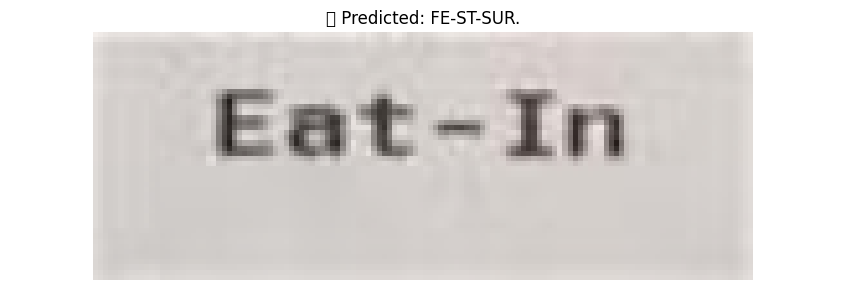

In [ ]:
# === Đọc ảnh và resize + padding ===
image_path = "/content/test10.jpg"
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Resize theo chiều cao 48, giữ tỉ lệ và padding chiều rộng về 160
processed_image = resize_with_padding(image, target_height=48, target_width=160)

# === Tiền xử lý cho mô hình ===
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])

input_tensor = transform(processed_image).unsqueeze(0).to(device)  # [1, 3, 48, 160]

# === Dự đoán văn bản ===
with torch.no_grad():
    output_ids = model.predict(input_tensor)
    pred_text = tokenizer.decode(output_ids[0].tolist())

# === Hiển thị kết quả ===
print(f"\n📄 Predicted text for {os.path.basename(image_path)}: {pred_text}")

plt.figure(figsize=(10, 3))
plt.imshow(processed_image)
plt.title(f"📄 Predicted: {pred_text}")
plt.axis("off")
plt.tight_layout()
plt.show()


📄 Predicted text for test10.jpg: FE-SUN


<ipython-input-44-a02593473a66>:63: UserWarning: Glyph 128196 (\N{PAGE FACING UP}) missing from font(s) DejaVu Sans.
  plt.tight_layout()


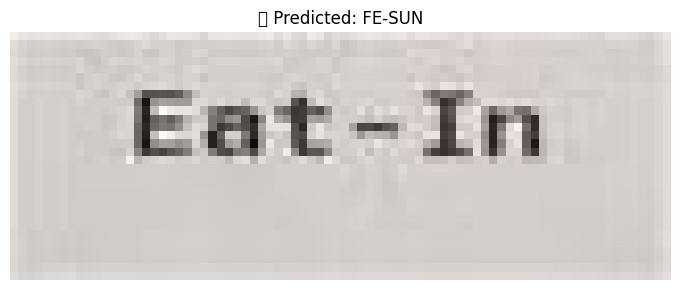

In [ ]:
import os
import torch
import cv2
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from torchvision import transforms

# === Khởi tạo model ===
model = OCRModel(
    vocab_size=len(tokenizer.vocab),
    sos_token_id=tokenizer.vocab['<SOS>'],
    eos_token_id=tokenizer.vocab['<EOS>'],
    max_len=100
).to(device)

model.load_state_dict(torch.load("/content/resnet34_7epoch_2h50.pt"))
model.eval()

# === Hàm tiền xử lý giữ tỉ lệ chiều cao + padding động chiều rộng ===
def preprocess_keep_ratio_padding(image, target_height=48, max_width=512):
    h, w, _ = image.shape
    new_w = int(w * (target_height / h))
    new_w = min(new_w, max_width)

    # Resize ảnh theo tỉ lệ
    resized = cv2.resize(image, (new_w, target_height))

    # Padding ảnh theo chiều rộng
    padded = np.ones((target_height, max_width, 3), dtype=np.uint8) * 255  # nền trắng
    padded[:, :new_w] = resized

    return padded

# === Đường dẫn ảnh đã crop sẵn ===
image_path = "/content/test10.jpg"
image = cv2.imread(image_path)
if image is None:
    raise FileNotFoundError(f"Không tìm thấy ảnh: {image_path}")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# === Tiền xử lý ===
padded_image = preprocess_keep_ratio_padding(image, target_height=48, max_width=512)
pil_image = Image.fromarray(padded_image)

transform = transforms.Compose([
    transforms.ToTensor(),  # [3, 48, W]
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])
input_tensor = transform(pil_image).unsqueeze(0).to(device)

# === Dự đoán ===
with torch.no_grad():
    output_ids = model.predict(input_tensor)
    pred_text = tokenizer.decode(output_ids[0].tolist())

# === Hiển thị ảnh và kết quả OCR ===
print(f"\n📄 Predicted text for {os.path.basename(image_path)}: {pred_text}")
plt.figure(figsize=(10, 3))
plt.imshow(image)
plt.title(f"📄 Predicted: {pred_text}", fontsize=12)
plt.axis("off")
plt.tight_layout()
plt.show()

In [ ]:
import os
import torch
import cv2
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from torchvision import transforms

# === Khởi tạo model ===
model = OCRModel(
    vocab_size=len(tokenizer.vocab),
    sos_token_id=tokenizer.vocab['<SOS>'],
    eos_token_id=tokenizer.vocab['<EOS>'],
    max_len=100
).to(device)

model.load_state_dict(torch.load("/content/resnet34_7epoch_2h50.pt"))
model.eval()

# === Hàm tiền xử lý giữ tỉ lệ chiều cao + padding động chiều rộng ===
def preprocess_keep_ratio_padding(image, target_height=48, max_width=512):
    h, w, _ = image.shape
    new_w = int(w * (target_height / h))
    new_w = min(new_w, max_width)

    # Resize ảnh theo tỉ lệ
    resized = cv2.resize(image, (new_w, target_height))

    # Padding ảnh theo chiều rộng
    padded = np.ones((target_height, max_width, 3), dtype=np.uint8) * 255  # nền trắng
    padded[:, :new_w] = resized

    return padded

# === Đường dẫn ảnh đã crop sẵn ===
image_path = "/content/test10.jpg"
image = cv2.imread(image_path)
if image is None:
    raise FileNotFoundError(f"Không tìm thấy ảnh: {image_path}")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# === Tiền xử lý ===
padded_image = preprocess_keep_ratio_padding(image, target_height=48, max_width=512)
pil_image = Image.fromarray(padded_image)

transform = transforms.Compose([
    transforms.ToTensor(),  # [3, 48, W]
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])
input_tensor = transform(pil_image).unsqueeze(0).to(device)

# === Dự đoán ===
with torch.no_grad():
    output_ids = model.predict(input_tensor)
    pred_text = tokenizer.decode(output_ids[0].tolist())

# === Hiển thị ảnh và kết quả OCR ===
print(f"\n📄 Predicted text for {os.path.basename(image_path)}: {pred_text}")
plt.figure(figsize=(10, 3))
plt.imshow(image)
plt.title(f"📄 Predicted: {pred_text}", fontsize=12)
plt.axis("off")
plt.tight_layout()
plt.show()

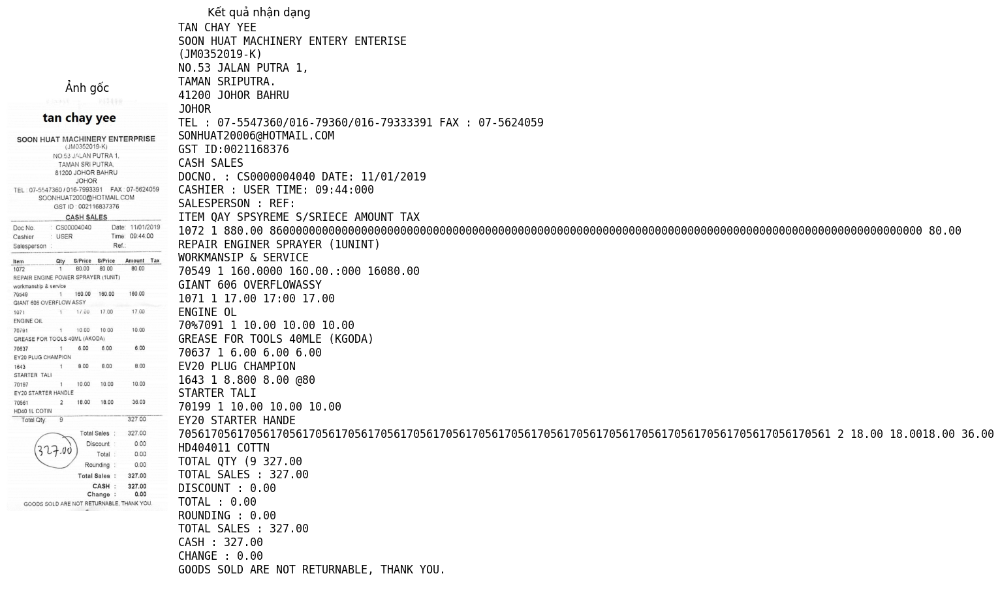

In [ ]:
import os
import json
import cv2
import torch
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from torchvision import transforms

# === CẤU HÌNH ===
device         = torch.device("cuda" if torch.cuda.is_available() else "cpu")
image_name     = "receipt_0007.jpg"
test_image_path = f"/content/receipt_dataset/test/img/{image_name}"
anno_path       = f"/content/receipt_dataset/test/annotations/{image_name.replace('.jpg', '.json')}"

# === TẢI MODEL ===
model = OCRModel(
    vocab_size=len(tokenizer.vocab),
    sos_token_id=tokenizer.vocab['<SOS>'],
    eos_token_id=tokenizer.vocab['<EOS>'],
    max_len=100
).to(device)
model.load_state_dict(torch.load("/content/resnet34_7epoch_2h50.pt", map_location=device))
model.eval()

# === TRANSFORM (giống lúc training) ===
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485,0.456,0.406],
                         std =[0.229,0.224,0.225])
])

# === HÀM GIẢI MÃ OUTPUT ===
def decode_ids(ids):
    return tokenizer.decode(ids, skip_special_tokens=True)

# === LOAD ẢNH + ANNOTATION ===
image = cv2.imread(test_image_path)
assert image is not None, f"Không đọc được {test_image_path}"
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
with open(anno_path, 'r', encoding='utf-8') as f:
    annotations = json.load(f)

# === INFERENCE MỖI DÒNG ===
target_height = 48
predictions = []

for i, item in enumerate(annotations):
    pts = np.array(item['box'], dtype=np.float32)
    x, y, w, h = cv2.boundingRect(pts)
    roi = image_rgb[y:y+h, x:x+w]

    # Resize giữ tỷ lệ
    ratio   = target_height / float(h)
    new_w   = max(1, int(w * ratio))
    resized = cv2.resize(roi, (new_w, target_height))

    pil = Image.fromarray(resized)
    t   = transform(pil).unsqueeze(0).to(device)

    with torch.no_grad():
        out_ids  = model.predict(t, beam_size=5)[0].cpu().tolist()
        pred_txt = decode_ids(out_ids)

    center_y = y + h // 2
    predictions.append({
        "text": pred_txt,
        "y": center_y,
        "x": x
    })

# === NHÓM THEO DÒNG (Y-GROUPING) ===
predictions.sort(key=lambda x: x["y"])  # Sắp xếp theo trục y

grouped_lines = []
line_threshold = 15  # khoảng cách theo y để coi là cùng dòng

for pred in predictions:
    matched = False
    for line in grouped_lines:
        if abs(pred["y"] - line["y_mean"]) <= line_threshold:
            line["items"].append(pred)
            line["y_vals"].append(pred["y"])
            line["y_mean"] = np.mean(line["y_vals"])
            matched = True
            break
    if not matched:
        grouped_lines.append({
            "items": [pred],
            "y_vals": [pred["y"]],
            "y_mean": pred["y"]
        })

# === GHÉP TEXT THEO DÒNG (sắp theo X) ===
output_lines = []
for line in grouped_lines:
    items = sorted(line["items"], key=lambda x: x["x"])
    line_text = " ".join([item["text"] for item in items])
    output_lines.append(line_text)

# === HIỂN THỊ: ẢNH GỐC + TEXT ===
plt.figure(figsize=(15, 10))

# Ảnh gốc (bên trái)
plt.subplot(1, 2, 1)
plt.imshow(image_rgb)
plt.title("Ảnh gốc")
plt.axis("off")

# Text nhận dạng (bên phải)
plt.subplot(1, 2, 2)
plt.axis("off")
plt.title("Kết quả nhận dạng")
text_display = "\n".join(output_lines)
plt.text(0, 1, text_display, fontsize=12, va='top', family='monospace')

# Tăng khoảng cách giữa 2 subplot
plt.subplots_adjust(wspace=2)  # Giá trị lớn hơn sẽ tạo khoảng cách lớn hơn nữa

plt.tight_layout()
plt.show()

In [ ]:
# Bước 1: Chọn GPU trong Colab
# Menu -> Runtime -> Change runtime type -> GPU

# Bước 2: Cài đặt Python 3.10 và thiết lập môi trường
!sudo apt-get update
!sudo apt-get install python3.10 python3.10-venv python3.10-dev -y

# Bước 3: Tạo virtual environment
!python3.10 -m venv paddle_gpu_env
!source paddle_gpu_env/bin/activate

# Bước 4: Cập nhật pip
!python3.10 -m pip install --upgrade pip setuptools wheel

# Bước 5: Cài đặt PaddlePaddle GPU version (QUAN TRỌNG)
!python3.10 -m pip install paddlepaddle-gpu==2.5.1.post117 -f https://www.paddlepaddle.org.cn/whl/linux/mkl/avx/stable.html

# Bước 6: Cài đặt PaddleOCR và dependencies
!python3.10 -m pip install \
    paddleocr==2.7.0.3 \
    opencv-python==4.8.0.76 \
    numpy==1.23.5 \
    shapely==2.0.2 \
    pyclipper==1.3.0.post6 \
    lmdb==1.4.1

# Bước 7: Cài đặt thư viện hệ thống
!apt-get install -y libgl1 libglib2.0-0

Hit:1 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:2 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:3 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Hit:4 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Get:5 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:6 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Get:7 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Hit:8 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:9 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:10 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Get:11 https://r2u.stat.illinois.edu/ubuntu jammy/main amd64 Packages [2,715 kB]
Get:12 http://archive.ubuntu.com/ubuntu jammy-updates/main amd64 Packages [3,208 kB]
Get:13 http://archive.ubuntu.com/ubuntu jammy-updates/restricted amd64 Packa

In [ ]:
!pip install paddlepaddle paddleocr

  Using cached paddlepaddle-3.0.0-cp311-cp311-manylinux1_x86_64.whl.metadata (8.9 kB)
  Using cached paddleocr-2.10.0-py3-none-any.whl.metadata (12 kB)
  Using cached astor-0.8.1-py2.py3-none-any.whl.metadata (4.2 kB)
  Using cached opt_einsum-3.3.0-py3-none-any.whl.metadata (6.5 kB)
  Using cached pyclipper-1.3.0.post6-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (9.0 kB)
  Using cached lmdb-1.6.2-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (1.1 kB)
  Using cached python_docx-1.1.2-py3-none-any.whl.metadata (2.0 kB)
  Using cached fire-0.7.0.tar.gz (87 kB)
  Preparing metadata (setup.py) ... done
Using cached paddlepaddle-3.0.0-cp311-cp311-manylinux1_x86_64.whl (192.8 MB)
Using cached opt_einsum-3.3.0-py3-none-any.whl (65 kB)
Using cached paddleocr-2.10.0-py3-none-any.whl (2.4 MB)
Using cached astor-0.8.1-py2.py3-none-any.whl (27 kB)
Using cached lmdb-1.6.2-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (297 kB)
Using cached p

In [ ]:
import paddle
from paddleocr import PaddleOCR

# Kiểm tra GPU
print(f"PaddlePGPU có sẵn: {paddle.is_compiled_with_cuda()}")
print(f"GPU đang dùng: {paddle.get_device()}")

# Khởi tạo OCR với GPU
ocr = PaddleOCR(
    use_angle_cls=False,
    lang='en',
    rec=False,
    use_gpu=True  # Bật GPU
)
print("🟢 PaddleOCR GPU version hoạt động!")

/usr/local/lib/python3.11/dist-packages/paddle/utils/cpp_extension/extension_utils.py:711: UserWarning: No ccache found. Please be aware that recompiling all source files may be required. You can download and install ccache from: https://github.com/ccache/ccache/blob/master/doc/INSTALL.md
  warnings.warn(warning_message)


PaddlePGPU có sẵn: False
GPU đang dùng: cpu
download https://paddleocr.bj.bcebos.com/PP-OCRv3/english/en_PP-OCRv3_det_infer.tar to /root/.paddleocr/whl/det/en/en_PP-OCRv3_det_infer/en_PP-OCRv3_det_infer.tar


100%|██████████| 3910/3910 [00:16<00:00, 240.21it/s] 


download https://paddleocr.bj.bcebos.com/PP-OCRv4/english/en_PP-OCRv4_rec_infer.tar to /root/.paddleocr/whl/rec/en/en_PP-OCRv4_rec_infer/en_PP-OCRv4_rec_infer.tar


100%|██████████| 10000/10000 [00:19<00:00, 506.23it/s]


download https://paddleocr.bj.bcebos.com/dygraph_v2.0/ch/ch_ppocr_mobile_v2.0_cls_infer.tar to /root/.paddleocr/whl/cls/ch_ppocr_mobile_v2.0_cls_infer/ch_ppocr_mobile_v2.0_cls_infer.tar


100%|██████████| 2138/2138 [00:15<00:00, 136.61it/s]

[2025/05/07 00:29:07] ppocr DEBUG: Namespace(help='==SUPPRESS==', use_gpu=False, use_xpu=False, use_npu=False, use_mlu=False, use_gcu=False, ir_optim=True, use_tensorrt=False, min_subgraph_size=15, precision='fp32', gpu_mem=500, gpu_id=0, image_dir=None, page_num=0, det_algorithm='DB', det_model_dir='/root/.paddleocr/whl/det/en/en_PP-OCRv3_det_infer', det_limit_side_len=960, det_limit_type='max', det_box_type='quad', det_db_thresh=0.3, det_db_box_thresh=0.6, det_db_unclip_ratio=1.5, max_batch_size=10, use_dilation=False, det_db_score_mode='fast', det_east_score_thresh=0.8, det_east_cover_thresh=0.1, det_east_nms_thresh=0.2, det_sast_score_thresh=0.5, det_sast_nms_thresh=0.2, det_pse_thresh=0, det_pse_box_thresh=0.85, det_pse_min_area=16, det_pse_scale=1, scales=[8, 16, 32], alpha=1.0, beta=1.0, fourier_degree=5, rec_algorithm='SVTR_LCNet', rec_model_dir='/root/.paddleocr/whl/rec/en/en_PP-OCRv4_rec_infer', rec_image_inverse=True, rec_image_shape='3, 48, 320', rec_batch_num=6, max_text_l

🟢 PaddleOCR GPU version hoạt động!


In [ ]:
from paddleocr import PaddleOCR
import cv2
import json
from typing import List, Dict

def detect_text_boxes(image_path: str) -> List[Dict]:
    """
    Detect text bounding boxes from image using PaddleOCR

    Args:
        image_path: Path to input image

    Returns:
        List of dictionaries containing box coordinates
    """
    # Initialize PaddleOCR (disable recognition for faster processing)
    ocr = PaddleOCR(
        use_angle_cls=False,
        lang='en',
        rec=False,  # Disable text recognition
        use_gpu=False,  # Set to True if using GPU
        det_limit_side_len=1280  # Limit image size for detection
    )

    # Read image
    image = cv2.imread(image_path)
    if image is None:
        raise ValueError(f"Cannot read image: {image_path}")

    # Perform detection
    result = ocr.ocr(image, cls=False)

    # Format results
    boxes = []
    for idx, item in enumerate(result[0]):
        # PaddleOCR v2.7+ returns boxes as list of lists
        points = item[0]  # Already in list format [[x1,y1], [x2,y2],...]

        boxes.append({
            "id": idx + 1,
            "text": "",  # Empty since we disabled recognition
            "box": points  # [[x1,y1], [x2,y2], [x3,y3], [x4,y4]]
        })

    return boxes

def save_to_json(data: List[Dict], output_path: str):
    """Save detection results to JSON file"""
    with open(output_path, 'w', encoding='utf-8') as f:
        json.dump(data, f, ensure_ascii=False, indent=2)

# Example usage
if __name__ == "__main__":
    input_image = "receipt_0007(1).jpg"  # Change to your image path
    output_json = "output_boxes.json"

    # Detect boxes
    detected_boxes = detect_text_boxes(input_image)

    # Save to JSON
    save_to_json(detected_boxes, output_json)

    print(f"✅ Detection completed! Saved to {output_json}")
    print(f"Found {len(detected_boxes)} text boxes")

[2025/05/07 00:29:11] ppocr DEBUG: Namespace(help='==SUPPRESS==', use_gpu=False, use_xpu=False, use_npu=False, use_mlu=False, use_gcu=False, ir_optim=True, use_tensorrt=False, min_subgraph_size=15, precision='fp32', gpu_mem=500, gpu_id=0, image_dir=None, page_num=0, det_algorithm='DB', det_model_dir='/root/.paddleocr/whl/det/en/en_PP-OCRv3_det_infer', det_limit_side_len=1280, det_limit_type='max', det_box_type='quad', det_db_thresh=0.3, det_db_box_thresh=0.6, det_db_unclip_ratio=1.5, max_batch_size=10, use_dilation=False, det_db_score_mode='fast', det_east_score_thresh=0.8, det_east_cover_thresh=0.1, det_east_nms_thresh=0.2, det_sast_score_thresh=0.5, det_sast_nms_thresh=0.2, det_pse_thresh=0, det_pse_box_thresh=0.85, det_pse_min_area=16, det_pse_scale=1, scales=[8, 16, 32], alpha=1.0, beta=1.0, fourier_degree=5, rec_algorithm='SVTR_LCNet', rec_model_dir='/root/.paddleocr/whl/rec/en/en_PP-OCRv4_rec_infer', rec_image_inverse=True, rec_image_shape='3, 48, 320', rec_batch_num=6, max_text_

In [ ]:
import os
import json
import cv2
import torch
import numpy as np
from PIL import Image
from torchvision import transforms
from tabulate import tabulate

# === CẤU HÌNH ===
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
image_name = "receipt_0007(1).jpg"
test_image_path = f"/content/{image_name}"
anno_path = "output_boxes.json"  # Sử dụng file output từ PaddleOCR

# === TẢI MODEL ===
model = OCRModel(
    vocab_size=len(tokenizer.vocab),
    sos_token_id=tokenizer.vocab['<SOS>'],
    eos_token_id=tokenizer.vocab['<EOS>'],
    max_len=100
).to(device)
model.load_state_dict(torch.load("/content/resnet34_7epoch_2h50.pt", map_location=device))
model.eval()

# === TRANSFORM (giống lúc training) ===
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

# === HÀM GIẢI MÃ OUTPUT ===
def decode_ids(ids):
    return tokenizer.decode(ids, skip_special_tokens=True)

# === LOAD ẢNH + ANNOTATION ===
image = cv2.imread(test_image_path)
assert image is not None, f"Không đọc được {test_image_path}"
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Đọc annotations từ file output_boxes.json
with open(anno_path, 'r', encoding='utf-8') as f:
    annotations = json.load(f)

    # Sắp xếp các box theo thứ tự từ trên xuống dưới (nếu cần)
    annotations.sort(key=lambda x: min(point[1] for point in x['box']))

# === INFERENCE MỖI DÒNG ===
results = []
target_height = 48

print(f"\n📄 Kết quả dự đoán cho ảnh: {image_name}\n")
for i, item in enumerate(annotations):
    pts = np.array(item['box'], dtype=np.float32)

    # 1) Crop bằng boundingRect (ko warp)
    x, y, w, h = cv2.boundingRect(pts)
    roi = image_rgb[y:y+h, x:x+w]

    # 2) Resize theo tỉ lệ để chiều cao = target_height
    ratio = target_height / float(h)
    new_w = max(1, int(w * ratio))
    resized = cv2.resize(roi, (new_w, target_height))

    # 3) ToTensor + Normalize
    pil = Image.fromarray(resized)
    t = transform(pil).unsqueeze(0).to(device)  # [1,3,48,new_w]

    # 4) Predict
    with torch.no_grad():
        out_ids = model.predict(t, beam_size=5)[0].cpu().tolist()
        pred_txt = decode_ids(out_ids)

    # Lấy ground truth nếu có (nếu không thì để empty)
    gt_txt = item.get('text', '')
    results.append([f"Line {i+1}", gt_txt, pred_txt])

# === HIỂN THỊ KẾT QUẢ DẠNG BẢNG ===
headers = ["Dòng", "Ground-Truth", "Prediction"]
print(tabulate(results, headers, tablefmt="grid"))

# === ĐỘ CHÍNH XÁC DÒNG === (chỉ tính nếu có ground truth)
if any(gt for _, gt, _ in results):
    correct = sum(1 for _, gt, pr in results if gt and gt == pr)
    acc = correct / len([gt for _, gt, _ in results if gt]) * 100
    print(f"\n🔍 Độ chính xác dòng: {acc:.2f}% ({correct}/{len([gt for _, gt, _ in results if gt])})")
else:
    print("\n⚠ Không có ground truth để tính độ chính xác")
    # In kết quả nhận dạng
    print("\n🔍 Kết quả nhận dạng:")
    for i, (line, _, pred) in enumerate(results):
        print(f"Dòng {i+1}: {pred}")

Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
100%|██████████| 83.3M/83.3M [00:01<00:00, 61.9MB/s]



📄 Kết quả dự đoán cho ảnh: receipt_0007(1).jpg

+---------+----------------+------------------------------------------+
| Dòng    | Ground-Truth   | Prediction                               |
+=========+================+==========================================+
| Line 1  |                | TAN CHAY YEE                             |
+---------+----------------+------------------------------------------+
| Line 2  |                | SOON HUAT MACHINERY ENTERY ENTERPRISE    |
+---------+----------------+------------------------------------------+
| Line 3  |                | (JM0352019-K)                            |
+---------+----------------+------------------------------------------+
| Line 4  |                | NO.53 JALAN PUTRA 1,                     |
+---------+----------------+------------------------------------------+
| Line 5  |                | TAMAN SRI PUTRA                          |
+---------+----------------+------------------------------------------+
| Line 6  |    

### Text detection with paddle

In [ ]:
# Bước 1: Chọn GPU trong Colab
# Menu -> Runtime -> Change runtime type -> GPU

# Bước 2: Cài đặt Python 3.10 và thiết lập môi trường
!sudo apt-get update
!sudo apt-get install python3.10 python3.10-venv python3.10-dev -y

# Bước 3: Tạo virtual environment
!python3.10 -m venv paddle_gpu_env
!source paddle_gpu_env/bin/activate

# Bước 4: Cập nhật pip
!python3.10 -m pip install --upgrade pip setuptools wheel

# Bước 5: Cài đặt PaddlePaddle GPU version (QUAN TRỌNG)
!python3.10 -m pip install paddlepaddle-gpu==2.5.1.post117 -f https://www.paddlepaddle.org.cn/whl/linux/mkl/avx/stable.html

# Bước 6: Cài đặt PaddleOCR và dependencies
!python3.10 -m pip install \
    paddleocr==2.7.0.3 \
    opencv-python==4.8.0.76 \
    numpy==1.23.5 \
    shapely==2.0.2 \
    pyclipper==1.3.0.post6 \
    lmdb==1.4.1

# Bước 7: Cài đặt thư viện hệ thống
!apt-get install -y libgl1 libglib2.0-0

Hit:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Hit:2 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:3 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Get:4 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:5 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:6 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Get:7 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Hit:8 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:9 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:10 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Get:11 https://r2u.stat.illinois.edu/ubuntu jammy/main amd64 Packages [2,720 kB]
Get:12 http://archive.ubuntu.com/ubuntu jammy-updates/main amd64 Packages [3,211 kB]
Get:13 https://r2u.stat.illinois.edu/ubuntu jammy/main all Packages [8,927 k

In [ ]:
!pip install paddlepaddle paddleocr

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.2/87.2 kB 5.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 192.8/192.8 MB 7.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.5/65.5 kB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 80.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 297.8/297.8 kB 28.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 969.6/969.6 kB 58.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 244.3/244.3 kB 22.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 83.6 MB/s eta 0:00:00
  Created wheel for fire: filename=fire-0.7.0-py3-none-any.whl size=114249 sha256=d08153a906d045fc9ceb9b0daf3ec50c7db152a34dee59e12b8318aa75d9b4c0
  Stored in directory: /root/.cache/pip/wheels/46/54/24/1624fd5b8674eb1188623f7e8e17cdf7c0f6c24b609dfb8a89
Successfully built fire
  Attempting uninstall: opt_einsum
    Found e

In [ ]:
import paddle
from paddleocr import PaddleOCR

# Kiểm tra GPU
print(f"PaddlePGPU có sẵn: {paddle.is_compiled_with_cuda()}")
print(f"GPU đang dùng: {paddle.get_device()}")

# Khởi tạo OCR với GPU
ocr = PaddleOCR(
    use_angle_cls=False,
    lang='en',
    rec=False,
    use_gpu=True  # Bật GPU
)
print("🟢 PaddleOCR GPU version hoạt động!")

/usr/local/lib/python3.11/dist-packages/paddle/utils/cpp_extension/extension_utils.py:711: UserWarning: No ccache found. Please be aware that recompiling all source files may be required. You can download and install ccache from: https://github.com/ccache/ccache/blob/master/doc/INSTALL.md
  warnings.warn(warning_message)


PaddlePGPU có sẵn: False
GPU đang dùng: cpu
download https://paddleocr.bj.bcebos.com/PP-OCRv3/english/en_PP-OCRv3_det_infer.tar to /root/.paddleocr/whl/det/en/en_PP-OCRv3_det_infer/en_PP-OCRv3_det_infer.tar


100%|██████████| 3910/3910 [00:29<00:00, 131.92it/s] 


download https://paddleocr.bj.bcebos.com/PP-OCRv4/english/en_PP-OCRv4_rec_infer.tar to /root/.paddleocr/whl/rec/en/en_PP-OCRv4_rec_infer/en_PP-OCRv4_rec_infer.tar


100%|██████████| 10000/10000 [00:17<00:00, 579.60it/s]


download https://paddleocr.bj.bcebos.com/dygraph_v2.0/ch/ch_ppocr_mobile_v2.0_cls_infer.tar to /root/.paddleocr/whl/cls/ch_ppocr_mobile_v2.0_cls_infer/ch_ppocr_mobile_v2.0_cls_infer.tar


100%|██████████| 2138/2138 [00:15<00:00, 142.29it/s]


[2025/05/12 13:24:30] ppocr DEBUG: Namespace(help='==SUPPRESS==', use_gpu=False, use_xpu=False, use_npu=False, use_mlu=False, use_gcu=False, ir_optim=True, use_tensorrt=False, min_subgraph_size=15, precision='fp32', gpu_mem=500, gpu_id=0, image_dir=None, page_num=0, det_algorithm='DB', det_model_dir='/root/.paddleocr/whl/det/en/en_PP-OCRv3_det_infer', det_limit_side_len=960, det_limit_type='max', det_box_type='quad', det_db_thresh=0.3, det_db_box_thresh=0.6, det_db_unclip_ratio=1.5, max_batch_size=10, use_dilation=False, det_db_score_mode='fast', det_east_score_thresh=0.8, det_east_cover_thresh=0.1, det_east_nms_thresh=0.2, det_sast_score_thresh=0.5, det_sast_nms_thresh=0.2, det_pse_thresh=0, det_pse_box_thresh=0.85, det_pse_min_area=16, det_pse_scale=1, scales=[8, 16, 32], alpha=1.0, beta=1.0, fourier_degree=5, rec_algorithm='SVTR_LCNet', rec_model_dir='/root/.paddleocr/whl/rec/en/en_PP-OCRv4_rec_infer', rec_image_inverse=True, rec_image_shape='3, 48, 320', rec_batch_num=6, max_text_l

In [ ]:
from paddleocr import PaddleOCR
import cv2
import json
from typing import List, Dict

def detect_text_boxes(image_path: str) -> List[Dict]:
    """
    Detect text bounding boxes from image using PaddleOCR

    Args:
        image_path: Path to input image

    Returns:
        List of dictionaries containing box coordinates
    """
    # Initialize PaddleOCR (disable recognition for faster processing)
    ocr = PaddleOCR(
        use_angle_cls=False,
        lang='en',
        rec=False,  # Disable text recognition
        use_gpu=False,  # Set to True if using GPU
        det_limit_side_len=1280  # Limit image size for detection
    )

    # Read image
    image = cv2.imread(image_path)
    if image is None:
        raise ValueError(f"Cannot read image: {image_path}")

    # Perform detection
    result = ocr.ocr(image, cls=False)

    # Format results
    boxes = []
    for idx, item in enumerate(result[0]):
        # PaddleOCR v2.7+ returns boxes as list of lists
        points = item[0]  # Already in list format [[x1,y1], [x2,y2],...]

        boxes.append({
            "id": idx + 1,
            "text": "",  # Empty since we disabled recognition
            "box": points  # [[x1,y1], [x2,y2], [x3,y3], [x4,y4]]
        })

    return boxes

def save_to_json(data: List[Dict], output_path: str):
    """Save detection results to JSON file"""
    with open(output_path, 'w', encoding='utf-8') as f:
        json.dump(data, f, ensure_ascii=False, indent=2)

# Example usage
if __name__ == "__main__":
    input_image = "receipt_1.jpeg"  # Change to your image path
    output_json = "output_boxes.json"

    # Detect boxes
    detected_boxes = detect_text_boxes(input_image)

    # Save to JSON
    save_to_json(detected_boxes, output_json)

    print(f"✅ Detection completed! Saved to {output_json}")
    print(f"Found {len(detected_boxes)} text boxes")

[2025/05/12 13:24:38] ppocr DEBUG: Namespace(help='==SUPPRESS==', use_gpu=False, use_xpu=False, use_npu=False, use_mlu=False, use_gcu=False, ir_optim=True, use_tensorrt=False, min_subgraph_size=15, precision='fp32', gpu_mem=500, gpu_id=0, image_dir=None, page_num=0, det_algorithm='DB', det_model_dir='/root/.paddleocr/whl/det/en/en_PP-OCRv3_det_infer', det_limit_side_len=1280, det_limit_type='max', det_box_type='quad', det_db_thresh=0.3, det_db_box_thresh=0.6, det_db_unclip_ratio=1.5, max_batch_size=10, use_dilation=False, det_db_score_mode='fast', det_east_score_thresh=0.8, det_east_cover_thresh=0.1, det_east_nms_thresh=0.2, det_sast_score_thresh=0.5, det_sast_nms_thresh=0.2, det_pse_thresh=0, det_pse_box_thresh=0.85, det_pse_min_area=16, det_pse_scale=1, scales=[8, 16, 32], alpha=1.0, beta=1.0, fourier_degree=5, rec_algorithm='SVTR_LCNet', rec_model_dir='/root/.paddleocr/whl/rec/en/en_PP-OCRv4_rec_infer', rec_image_inverse=True, rec_image_shape='3, 48, 320', rec_batch_num=6, max_text_

✅ Đã lưu ảnh với bounding boxes tại: output_with_boxes.jpg

Kết quả nhận diện:


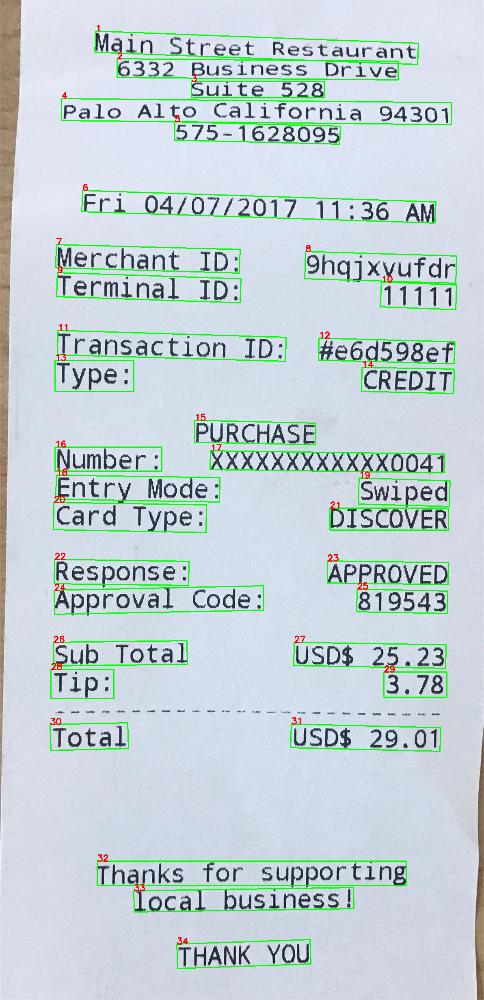

In [ ]:
import cv2
import json
import numpy as np
from google.colab.patches import cv2_imshow

def draw_boxes_on_image(image_path: str, json_path: str, output_path: str = "output.jpg"):
    """
    Vẽ bounding boxes từ file JSON lên ảnh gốc

    Args:
        image_path: Đường dẫn đến ảnh gốc
        json_path: Đường dẫn đến file JSON chứa thông tin boxes
        output_path: Đường dẫn lưu ảnh kết quả
    """
    # Đọc ảnh gốc
    image = cv2.imread(image_path)
    if image is None:
        raise ValueError(f"Cannot read image: {image_path}")

    # Đọc dữ liệu từ file JSON
    with open(json_path, 'r', encoding='utf-8') as f:
        boxes_data = json.load(f)

    # Vẽ từng box lên ảnh
    for box_info in boxes_data:
        points = np.array(box_info['box'], dtype=np.int32)

        # Vẽ polygon (do PaddleOCR trả về tứ giác không phải rectangle)
        cv2.polylines(image, [points], isClosed=True, color=(0, 255, 0), thickness=2)

        # Vẽ số thứ tự box
        cv2.putText(image, str(box_info['id']),
                   tuple(points[0]),  # Vị trí text (góc trên trái box)
                   cv2.FONT_HERSHEY_SIMPLEX,
                   0.7, (0, 0, 255), 2)

    # Lưu ảnh kết quả
    cv2.imwrite(output_path, image)
    print(f"✅ Đã lưu ảnh với bounding boxes tại: {output_path}")

    # Hiển thị ảnh trên Colab
    print("\nKết quả nhận diện:")
    cv2_imshow(image)

# Sử dụng hàm
if __name__ == "__main__":
    input_image = "receipt_1.jpeg"  # Ảnh gốc
    json_file = "output_boxes.json"  # File JSON từ PaddleOCR

    draw_boxes_on_image(input_image, json_file, "output_with_boxes.jpg")


📄 Kết quả dự đoán cho ảnh: receipt_1.jpeg

+---------+----------------+------------------------------------------------------------------------------------------------------+
| Dòng    | Ground-Truth   | Prediction                                                                                           |
+=========+================+======================================================================================================+
| Line 1  |                | MAIN STREET REET RESTAURENT                                                                          |
+---------+----------------+------------------------------------------------------------------------------------------------------+
| Line 2  |                | 6332 BUSINES DRIVE                                                                                   |
+---------+----------------+------------------------------------------------------------------------------------------------------+
| Line 3  |                | SUI

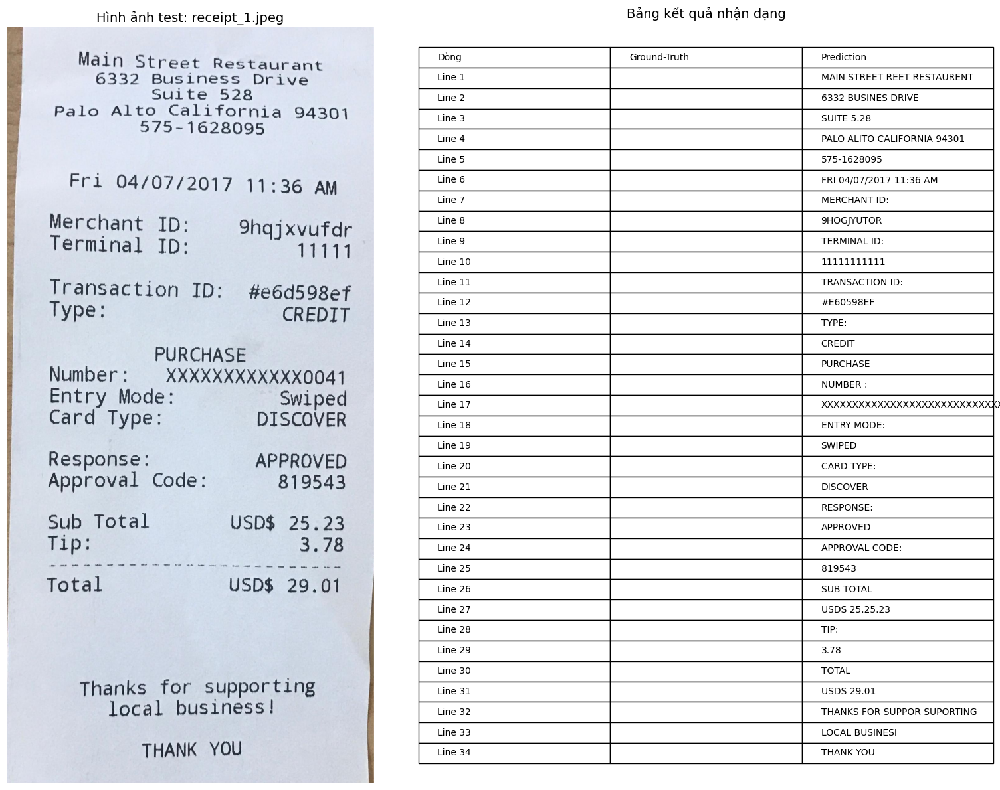

In [ ]:
import os
import json
import cv2
import torch
import numpy as np
from PIL import Image
from torchvision import transforms
from tabulate import tabulate

# === CẤU HÌNH ===
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
image_name = "receipt_1.jpeg"
test_image_path = f"/content/{image_name}"
anno_path = "output_boxes.json"  # Sử dụng file output từ PaddleOCR

# Load vocab & tokenizer (giữ y hệt training)
with open("vocab.json", "r", encoding="utf-8") as f:
    vocab = json.load(f)["vocab"]
tokenizer = OCRTokenizer(vocab)

# === TẢI MODEL ===
model = OCRModel(
    vocab_size=len(tokenizer.vocab),
    sos_token_id=tokenizer.vocab['<SOS>'],
    eos_token_id=tokenizer.vocab['<EOS>'],
    max_len=100
).to(device)
model.load_state_dict(torch.load("/content/resnet34_7epoch_2h50.pt", map_location=device))
model.eval()

# === TRANSFORM (giống lúc training) ===
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

# === HÀM GIẢI MÃ OUTPUT ===
def decode_ids(ids):
    # Ensure ids is a flat list of integers
    if isinstance(ids, (list, tuple)) and len(ids) > 0 and isinstance(ids[0], (list, tuple)):
        ids = ids[0]  # Take the first element if it's nested
    return tokenizer.decode(ids, skip_special_tokens=True)

# === LOAD ẢNH + ANNOTATION ===
image = cv2.imread(test_image_path)
assert image is not None, f"Không đọc được {test_image_path}"
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Đọc annotations từ file output_boxes.json
with open(anno_path, 'r', encoding='utf-8') as f:
    annotations = json.load(f)
    annotations.sort(key=lambda x: min(point[1] for point in x['box']))

# === INFERENCE MỖI DÒNG ===
results = []
target_height = 48

print(f"\n📄 Kết quả dự đoán cho ảnh: {image_name}\n")
for i, item in enumerate(annotations):
    pts = np.array(item['box'], dtype=np.float32)

    # 1) Crop bằng boundingRect (ko warp)
    x, y, w, h = cv2.boundingRect(pts)
    roi = image_rgb[y:y+h, x:x+w]

    # 2) Resize theo tỉ lệ để chiều cao = target_height
    ratio = target_height / float(h)
    new_w = max(1, int(w * ratio))
    resized = cv2.resize(roi, (new_w, target_height))

    # 3) ToTensor + Normalize
    pil = Image.fromarray(resized)
    t = transform(pil).unsqueeze(0).to(device)  # [1,3,48,new_w]

    # 4) Predict
    with torch.no_grad():
        output = model.predict(t, beam_size=5)

        # Xử lý đầu ra tùy thuộc vào cấu trúc model trả về
        if isinstance(output, tuple):
            # Giả sử phần tử đầu tiên của tuple là kết quả dự đoán
            out_ids = output[0]
        else:
            out_ids = output

        # Chuyển đổi sang CPU nếu cần và lấy danh sách ID
        if isinstance(out_ids, torch.Tensor):
            out_ids = out_ids.cpu().tolist()
        elif isinstance(out_ids, (list, tuple)):
            out_ids = list(out_ids)  # Chuyển tuple sang list nếu cần

        pred_txt = decode_ids(out_ids)

    # Lấy ground truth nếu có (nếu không thì để empty)
    gt_txt = item.get('text', '')
    results.append([f"Line {i+1}", gt_txt, pred_txt])

# === HIỂN THỊ KẾT QUẢ DẠNG BẢNG ===
headers = ["Dòng", "Ground-Truth", "Prediction"]
print(tabulate(results, headers, tablefmt="grid"))

# === ĐỘ CHÍNH XÁC DÒNG === (chỉ tính nếu có ground truth)
if any(gt for _, gt, _ in results):
    correct = sum(1 for _, gt, pr in results if gt and gt == pr)
    acc = correct / len([gt for _, gt, _ in results if gt]) * 100
    print(f"\n🔍 Độ chính xác dòng: {acc:.2f}% ({correct}/{len([gt for _, gt, _ in results if gt])})")
else:
    print("\n⚠ Không có ground truth để tính độ chính xác")
    # In kết quả nhận dạng
    print("\n🔍 Kết quả nhận dạng:")
    for i, (line, _, pred) in enumerate(results):
        print(f"Dòng {i+1}: {pred}")

import matplotlib.pyplot as plt
from matplotlib import gridspec

# === TẠO KHUNG HIỂN THỊ 2 CỘT: ẢNH + BẢNG VĂN BẢN ===
fig = plt.figure(figsize=(16, 12))
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 1.2])  # Ảnh : Bảng = 1 : 1.2

# --- CỘT TRÁI: ẢNH GỐC ---
ax0 = plt.subplot(gs[0])
ax0.imshow(image_rgb)
ax0.set_title(f"Hình ảnh test: {image_name}", fontsize=14)
ax0.axis("off")

# --- CỘT PHẢI: BẢNG DỰ ĐOÁN ---
ax1 = plt.subplot(gs[1])
ax1.axis("off")
ax1.set_title("Bảng kết quả nhận dạng", fontsize=14, pad=10)

# Dữ liệu dạng bảng (list of lists)
table_data = [headers] + results
table = ax1.table(cellText=table_data, colLabels=None, loc='center', cellLoc='left')
table.scale(1, 1.5)
table.auto_set_font_size(False)
table.set_fontsize(10)

# Điều chỉnh layout và hiển thị
plt.tight_layout()
plt.show()

## Vietnamese version

In [ ]:
import os
import shutil
import kagglehub

dataset_path = kagglehub.dataset_download("blyatfk/receipt-ocr")
destination_path = "/content/dataset"

# Tạo thư mục đích (xóa cũ nếu tồn tại)
if os.path.exists(destination_path):
    shutil.rmtree(destination_path)
os.makedirs(destination_path)

# Sao chép toàn bộ nội dung
for item in os.listdir(dataset_path):
    src = os.path.join(dataset_path, item)
    dst = os.path.join(destination_path, item)

    if os.path.isdir(src):
        shutil.copytree(src, dst, symlinks=True)  # Sao chép cả thư mục con
    else:
        shutil.copy2(src, dst)  # Giữ nguyên metadata

print(f"✅ Đã sao chép dataset vào: {destination_path}")
print("📂 Nội dung:", os.listdir(destination_path))

✅ Đã sao chép dataset vào: /content/dataset
📂 Nội dung: ['data_line']


In [ ]:
def list_folders_only(startpath):
    for root, dirs, _ in os.walk(startpath):
        level = root.replace(startpath, '').count(os.sep)
        indent = '  ' * level
        print(f"{indent}📁 {os.path.basename(root)}/")
        for d in dirs:
            subindent = '  ' * (level + 1)
            print(f"{subindent}📁 {d}/")
        # Không đệ quy thêm nữa để tránh in sâu vào các sub-sub-folder
        break  # Chỉ lấy các folder ở cấp hiện tại (1 cấp con)

# Gọi hàm để liệt kê folder trong receipt_dataset
list_folders_only("/content/dataset/data_line")

📁 data_line/
  📁 InkData_line_processed/


In [ ]:
txt_files = [
    "line_annotation.txt",
    "train_line_annotation.txt",
    "test_line_annotation.txt"
]

base_path = "/content/dataset/data_line"  # hoặc đường dẫn tương ứng trong máy bạn

for txt_file in txt_files:
    file_path = os.path.join(base_path, txt_file)
    with open(file_path, 'r', encoding='utf-8') as f:
        num_lines = sum(1 for _ in f)
    print(f"📄 {txt_file}: {num_lines} dòng")


📄 line_annotation.txt: 6228 dòng
📄 train_line_annotation.txt: 4982 dòng
📄 test_line_annotation.txt: 1246 dòng


In [ ]:
import os
import shutil
from tqdm import tqdm
from PIL import Image
from random import shuffle

# Đường dẫn gốc
src_img_folder = "/content/dataset/data_line/InkData_line_processed"
src_annotation_file = "/content/dataset/data_line/line_annotation.txt"

# Tạo thư mục mới
target_root = "/content/hoadon_dataset"
splits = ['train', 'val', 'test']
os.makedirs(target_root, exist_ok=True)

# Tạo các thư mục con
for split in splits:
    os.makedirs(os.path.join(target_root, split, "img"), exist_ok=True)

# Đọc toàn bộ dòng từ annotation
with open(src_annotation_file, 'r', encoding='utf-8') as f:
    lines = f.readlines()

# Shuffle và chia dữ liệu
shuffle(lines)
total = len(lines)
train_split = int(0.8 * total)
val_split = int(0.1 * total)

split_lines = {
    "train": lines[:train_split],
    "val": lines[train_split:train_split + val_split],
    "test": lines[train_split + val_split:]
}

# Copy ảnh, đổi tên và ghi file annotation
all_annotations = []
counter = 1

for split in splits:
    for line in tqdm(split_lines[split], desc=f"Processing {split}"):
        rel_path, label = line.strip().split('\t')
        old_img_path = os.path.join(src_img_folder, os.path.basename(rel_path))

        # Tạo tên ảnh mới
        new_img_name = f"receipt_{counter:04d}.jpg"
        counter += 1

        # Đọc ảnh và chuyển sang JPG
        try:
            with Image.open(old_img_path) as img:
                rgb_img = img.convert('RGB')  # Đảm bảo không có alpha channel
                target_img_path = os.path.join(target_root, split, "img", new_img_name)
                rgb_img.save(target_img_path, format='JPEG')
        except Exception as e:
            print(f"❌ Lỗi chuyển ảnh: {old_img_path} — {str(e)}")
            continue  # Bỏ qua ảnh lỗi

        # Ghi annotation
        all_annotations.append(f"{new_img_name}\t{label.strip()}\n")

# Ghi toàn bộ annotation vào hoadon_dataset/annotations.txt
with open(os.path.join(target_root, "annotations.txt"), 'w', encoding='utf-8') as f:
    f.writelines(all_annotations)

print("✅ Đã tạo thành công dataset tại:", target_root)


Processing test: 100%|██████████| 624/624 [00:00<00:00, 2009.35it/s]

✅ Đã tạo thành công dataset tại: /content/hoadon_dataset


In [ ]:
import shutil
from google.colab import files

# Đường dẫn thư mục và tên file zip
folder_to_zip = "/content/hoadon_dataset"
zip_file = "/content/hoadon_dataset.zip"

# Nén thư mục
shutil.make_archive(base_name=zip_file.replace('.zip', ''), format='zip', root_dir=folder_to_zip)

print("✅ Đã nén thành công. Đang tạo link tải xuống...")

# Tải file về
files.download(zip_file)

✅ Đã nén thành công. Đang tạo link tải xuống...


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Upload and unzip

In [ ]:
import zipfile
import os

# Đường dẫn tới file zip
zip_path = "hoadon_dataset.zip"

# Thư mục đích để giải nén
extract_to = "hoadon_dataset"

# Tạo thư mục nếu chưa tồn tại
os.makedirs(extract_to, exist_ok=True)

# Giải nén
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to)

In [ ]:
import unicodedata
import json
from collections import Counter

def build_vocab_from_txt(txt_paths, min_freq=1):
    """
    Xây dựng vocab từ các file TXT chứa annotation text (mỗi dòng là 1 annotation).

    Args:
        txt_paths: Danh sách đường dẫn tới file TXT.
        min_freq: Tần suất tối thiểu để thêm ký tự vào vocab.

    Returns:
        vocab: Dict ánh xạ ký tự sang index.
        inv_vocab: Dict ánh xạ index sang ký tự.
    """
    char_counter = Counter()

    for txt_path in txt_paths:
        try:
            with open(txt_path, 'r', encoding='utf-8') as f:
                lines = f.readlines()
            for line in lines:
                # Lấy phần text cuối dòng (sau dấu phẩy cuối cùng)
                parts = line.strip().split(',')
                if parts:
                    text = parts[-1].strip()
                    normalized_text = unicodedata.normalize('NFC', text)
                    char_counter.update(normalized_text)
        except Exception as e:
            print(f"Error processing {txt_path}: {e}")

    # Token đặc biệt
    vocab = {
        '<PAD>': 0, '<SOS>': 1, '<EOS>': 2, '<UNK>': 3,
        ' ': 4  # Dấu cách
    }
    idx = 5

    # Bộ ký tự tiếng Việt
    must_include = set(
        "*=%/$,.-+:@#&()"
        "0123456789"
        "AĂÂBCDĐEÊGHIKLMNOÔƠPQRSTUƯVXY"
        "aăâbcdđeêghiklmnoôơpqrstuưvxy"
        "ÀÁẢÃẠẦẤẨẪẬẰẮẲẴẶÈÉẺẼẸỀẾỂỄỆ"
        "ÌÍỈĨỊÒÓỎÕỌỒỐỔỖỘỜỚỞỠỢÙÚỦŨỤỪỨỬỮỰ"
        "ỲÝỶỸỴ"
        "àáảãạầấẩẫậằắẳẵặèéẻẽẹềếểễệ"
        "ìíỉĩịòóỏõọồốổỗộờớởỡợùúủũụừứửữự"
        "ỳýỷỹỵ"
    )

    for char, count in char_counter.items():
        if char not in vocab and count >= min_freq:
            if char in must_include:
                vocab[char] = idx
                idx += 1

    # Đảm bảo tất cả ký tự bắt buộc có mặt
    for char in must_include:
        if char not in vocab:
            vocab[char] = idx
            idx += 1

    inv_vocab = {v: k for k, v in vocab.items()}
    return vocab, inv_vocab


In [ ]:
from collections import Counter

txt_paths = ["hoadon_dataset/annotations.txt"]
vocab, inv_vocab = build_vocab_from_txt(txt_paths, min_freq=1)

print(f"Kích thước vocab: {len(vocab)}")
print("Sample vocab:", {k: vocab[k] for k in list(vocab)[:10]})

# Lưu file vocab
with open("vocab.json", "w", encoding="utf-8") as f:
    json.dump({'vocab': vocab, 'inv_vocab': inv_vocab}, f, ensure_ascii=False, indent=2)


Kích thước vocab: 208
Sample vocab: {'<PAD>': 0, '<SOS>': 1, '<EOS>': 2, '<UNK>': 3, ' ': 4, 'r': 5, 'e': 6, 'c': 7, 'i': 8, 'p': 9}


In [ ]:
import unicodedata
from typing import List, Union

class OCRTokenizer:
    def __init__(self, vocab: dict):
        required_tokens = ['<PAD>', '<SOS>', '<EOS>', '<UNK>']
        for token in required_tokens:
            if token not in vocab:
                raise ValueError(f"Vocab must contain {token}")

        self.vocab = vocab
        self.idx2char = {idx: char for char, idx in vocab.items()}
        self.unk_token_id = vocab['<UNK>']
        self.special_tokens = {
            'pad': vocab['<PAD>'],
            'sos': vocab['<SOS>'],
            'eos': vocab['<EOS>']
        }

    def encode(self, text: str, max_length: int = 150) -> List[int]:
        if not isinstance(text, str):
            raise ValueError("Input must be a string")

        text = unicodedata.normalize('NFC', text.strip())
        tokens = [self.vocab.get(char, self.unk_token_id) for char in text]
        encoded = [self.special_tokens['sos']] + tokens[:max_length] + [self.special_tokens['eos']]
        return encoded

    def batch_encode(self, texts: List[str], max_length: int = 150) -> List[List[int]]:
        return [self.encode(text, max_length) for text in texts]

    def decode(self, token_ids: List[int], skip_special_tokens: bool = True) -> str:
        decoded = []
        for id in token_ids:
            if skip_special_tokens and id in self.special_tokens.values():
                continue
            # Nếu token ID là <UNK> hoặc không tồn tại trong vocab
            if id == self.unk_token_id:
                decoded.append('?')
            elif id in self.idx2char:
                decoded.append(self.idx2char[id])
            else:
                decoded.append('?')  # Dùng '?' nếu gặp token không hợp lệ
        return ''.join(decoded)

    def batch_decode(self, batch_token_ids: List[List[int]], skip_special_tokens: bool = True) -> List[str]:
        return [self.decode(token_ids, skip_special_tokens) for token_ids in batch_token_ids]

    def __len__(self) -> int:
        return len(self.vocab)

    @property
    def vocab_size(self) -> int:
        return len(self)

In [ ]:
with open("vocab.json", "r", encoding="utf-8") as f:
    vocab_data = json.load(f)
    vocab = vocab_data['vocab']

tokenizer = OCRTokenizer(vocab)
text = "RECEIPT - CHANGE TAX"
encoded = tokenizer.encode(text)
decoded = tokenizer.decode(encoded)

print("Vocab size:", len(tokenizer))
print("Encoded:", encoded)
print("Decoded:", decoded)

texts = ["Hello", "Ton Yum"]
batch_encoded = tokenizer.batch_encode(texts)
batch_decoded = tokenizer.batch_decode(batch_encoded)
print("Batch encoded:", batch_encoded)
print("Batch decoded:", batch_decoded)


tokenizer = OCRTokenizer(vocab)
text = "Ngày mua hàng - "
encoded = tokenizer.encode(text)
decoded = tokenizer.decode(encoded)

print("Vocab size:", len(tokenizer))
print("Encoded:", encoded)
print("Decoded:", decoded)

texts = ["Thành tiền", "HÓA ĐƠN"]
batch_encoded = tokenizer.batch_encode(texts)
batch_decoded = tokenizer.batch_decode(batch_encoded)
print("Batch encoded:", batch_encoded)
print("Batch decoded:", batch_decoded)

Vocab size: 208
Encoded: [1, 82, 93, 39, 93, 26, 28, 23, 4, 22, 4, 39, 29, 64, 15, 25, 93, 4, 23, 64, 124, 2]
Decoded: RECEIPT - CHANGE TAX
Batch encoded: [[1, 29, 6, 52, 52, 46, 2], [1, 23, 46, 37, 4, 63, 54, 41, 2]]
Batch decoded: ['Hello', 'Ton Yum']
Vocab size: 208
Encoded: [1, 15, 14, 16, 17, 4, 41, 54, 48, 4, 42, 16, 37, 14, 4, 22, 2]
Decoded: Ngày mua hàng -
Batch encoded: [[1, 23, 42, 16, 37, 42, 4, 10, 8, 90, 37, 2], [1, 29, 151, 64, 4, 84, 154, 15, 2]]
Batch decoded: ['Thành tiền', 'HÓA ĐƠN']


In [ ]:
import torch
from torch.utils.data import Dataset, DataLoader
import cv2
import numpy as np
from PIL import Image
import torchvision.transforms as transforms

# Định nghĩa transform cho ảnh
def get_image_transform():
    return transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

class OCRDataset_2(Dataset):
    def __init__(self, annotation_file, image_dir, tokenizer, transform=None, target_height=48):
        self.annotations = []
        with open(annotation_file, 'r', encoding='utf-8') as f:
            for line in f:
                parts = line.strip().split('\t')
                if len(parts) == 2:
                    img_name, text = parts
                    img_path = os.path.join(image_dir, img_name.strip())
                    if text.strip():  # bỏ mẫu rỗng
                        self.annotations.append((img_path, text.strip()))

        self.tokenizer = tokenizer
        self.transform = transform or get_image_transform()
        self.target_height = target_height

    def _resize_with_ratio(self, img):
        h, w = img.shape[:2]
        ratio = self.target_height / h
        new_w = int(w * ratio)
        resized = cv2.resize(img, (new_w, self.target_height))
        return resized

    def __getitem__(self, idx):
        img_path, text = self.annotations[idx]

        try:
            img = cv2.imread(img_path)
            if img is None:
                raise ValueError("Không đọc được ảnh")

            resized = self._resize_with_ratio(img)
            pil_image = Image.fromarray(cv2.cvtColor(resized, cv2.COLOR_BGR2RGB))
            image_tensor = self.transform(pil_image)

        except Exception as e:
            print(f"Lỗi xử lý ảnh {img_path}: {str(e)}")
            image_tensor = torch.zeros((3, self.target_height, 672))
            text = "<UNK>"

        try:
            tokens = self.tokenizer.encode(text)
            if len(tokens) == 0:
                raise ValueError("Encode text thất bại")
            tokens = torch.tensor(tokens, dtype=torch.long)  # Chuyển sang tensor ngay tại đây
        except Exception as e:
            print(f"Lỗi encode text '{text}': {str(e)}")
            tokens = torch.tensor(self.tokenizer.encode("<UNK>"), dtype=torch.long)

        return image_tensor, tokens

    def __len__(self):
        return len(self.annotations)

def collate_fn(batch):
    valid_batch = [(img, tokens) for img, tokens in batch if img is not None and len(tokens) > 0]
    if not valid_batch:
        return None

    images, targets = zip(*valid_batch)

    # --- 1. Pad ảnh theo chiều rộng ---
    max_width = max(img.shape[2] for img in images)
    height = images[0].shape[1]  # target_height cố định

    # Tạo tensor chứa ảnh đã pad: (B, 3, H, max_width)
    padded_images = torch.zeros((len(images), 3, height, max_width), dtype=images[0].dtype)
    for i, img in enumerate(images):
        c, h, w = img.shape
        padded_images[i, :, :, :w] = img
        # Phần pad bên phải (w → max_width) giữ giá trị 0

    # --- 2. Pad targets và build attention_mask ---
    max_len = max(len(t) for t in targets)
    padded_targets = torch.full((len(targets), max_len), fill_value=0, dtype=torch.long)  # PAD_ID = 0
    attention_mask = torch.zeros((len(targets), max_len), dtype=torch.bool)

    for i, seq in enumerate(targets):
        # nếu seq là list, chuyển thành tensor
        if isinstance(seq, list):
            seq = torch.tensor(seq, dtype=torch.long)

        # đảm bảo có EOS token ở cuối
        if seq[-1] != 2:  # EOS_ID = 2
            seq = torch.cat([seq, torch.tensor([2], dtype=torch.long)])

        seq_len = seq.shape[0]
        padded_targets[i, :seq_len] = seq
        attention_mask[i, :seq_len] = True

    return {
        "images": padded_images,        # Tensor (B, 3, H, W_max)
        "targets": padded_targets,      # Tensor (B, L_max)
        "attention_mask": attention_mask  # Tensor (B, L_max)
    }

In [ ]:
import os

# Đường dẫn đến folder chứa ảnh theo split
split_dirs = {
    "train": "/content/hoadon_dataset/train/img",
    "val": "/content/hoadon_dataset/val/img",
    "test": "/content/hoadon_dataset/test/img",
}

# Đường dẫn annotations gốc
annotation_file = "/content/hoadon_dataset/annotations.txt"

# Đường dẫn output
output_folder = "/content/hoadon_dataset/"
os.makedirs(output_folder, exist_ok=True)

# Đọc toàn bộ annotation
with open(annotation_file, 'r', encoding='utf-8') as f:
    annotations = [line.strip() for line in f if line.strip()]

# Tạo set ảnh cho từng split để tra cứu nhanh
split_image_sets = {
    split: set(os.listdir(img_dir))
    for split, img_dir in split_dirs.items()
}

# Tạo dict chứa nội dung cho từng file
split_annotation_lines = {
    "train": [],
    "val": [],
    "test": []
}

# Phân chia annotation theo ảnh
for line in annotations:
    try:
        img_name, text = line.strip().split('\t')
        for split in ["train", "val", "test"]:
            if img_name in split_image_sets[split]:
                split_annotation_lines[split].append(f"{img_name}\t{text}")
                break
        else:
            print(f"⚠️ Không tìm thấy ảnh {img_name} trong bất kỳ split nào.")
    except ValueError:
        print(f"❌ Lỗi format dòng: {line}")

# Ghi các file output
for split in ["train", "val", "test"]:
    output_path = os.path.join(output_folder, f"{split}_annotations.txt")
    with open(output_path, 'w', encoding='utf-8') as f:
        f.write('\n'.join(split_annotation_lines[split]))
    print(f"✅ Đã ghi {len(split_annotation_lines[split])} dòng vào {output_path}")

✅ Đã ghi 4982 dòng vào /content/hoadon_dataset/train_annotations.txt
✅ Đã ghi 622 dòng vào /content/hoadon_dataset/val_annotations.txt
✅ Đã ghi 624 dòng vào /content/hoadon_dataset/test_annotations.txt


In [ ]:
from torch.utils.data import ConcatDataset

tokenizer = OCRTokenizer(vocab)
transform = get_image_transform()

viet_train_dataset = OCRDataset_2(
        annotation_file="/content/hoadon_dataset/train_annotations.txt",
        image_dir="/content/hoadon_dataset/train/img",
        tokenizer=tokenizer,
        transform=transform,
        target_height=48
    )

viet_val_dataset = OCRDataset_2(
        annotation_file="/content/hoadon_dataset/val_annotations.txt",
        image_dir="/content/hoadon_dataset/val/img",
        tokenizer=tokenizer,
        transform=transform,
        target_height=48
    )

viet_test_dataset = OCRDataset_2(
        annotation_file="/content/hoadon_dataset/test_annotations.txt",
        image_dir="/content/hoadon_dataset/test/img",
        tokenizer=tokenizer,
        transform=transform,
        target_height=48
    )

train_dataset = ConcatDataset([viet_train_dataset] * 5)

train_loader = DataLoader(
        train_dataset,
        batch_size=64,
        shuffle=True,
        collate_fn=collate_fn,
        num_workers = 4
    )


test_loader = DataLoader(
        viet_test_dataset,
        batch_size=64,
        shuffle=False,
        collate_fn=collate_fn,
        num_workers = 4
    )


val_loader = DataLoader(
        viet_val_dataset,
        batch_size=64,
        shuffle=False,
        collate_fn=collate_fn,
        num_workers = 4
    )

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


In [ ]:
def check_dataloader(dataloader, num_batches=5):
    """
    Kiểm tra DataLoader bằng cách in ra kích thước của images, targets và attention_mask.

    Parameters:
    - dataloader: DataLoader cần kiểm tra.
    - num_batches: Số lượng batch muốn kiểm tra. Mặc định là 5.
    """
    for i, batch in enumerate(dataloader):
        if i >= num_batches:
            break

        # Lấy dữ liệu trong batch
        images = batch['images']
        targets = batch['targets']
        attention_mask = batch['attention_mask']

        # In ra kích thước của images, targets và attention_mask
        print(f"Batch {i+1}:")
        print(f"  - Images shape: {images.shape}")  # (B, 3, H, W_max)
        print(f"  - Targets shape: {targets.shape}")  # (B, L_max)
        print(f"  - Attention mask shape: {attention_mask.shape}")  # (B, L_max)
        print("-" * 50)

# Kiểm tra dataloader cho train_loader
check_dataloader(train_loader)

Batch 1:
  - Images shape: torch.Size([64, 3, 48, 880])
  - Targets shape: torch.Size([64, 53])
  - Attention mask shape: torch.Size([64, 53])
--------------------------------------------------
Batch 2:
  - Images shape: torch.Size([64, 3, 48, 745])
  - Targets shape: torch.Size([64, 53])
  - Attention mask shape: torch.Size([64, 53])
--------------------------------------------------
Batch 3:
  - Images shape: torch.Size([64, 3, 48, 953])
  - Targets shape: torch.Size([64, 46])
  - Attention mask shape: torch.Size([64, 46])
--------------------------------------------------
Batch 4:
  - Images shape: torch.Size([64, 3, 48, 720])
  - Targets shape: torch.Size([64, 120])
  - Attention mask shape: torch.Size([64, 120])
--------------------------------------------------
Batch 5:
  - Images shape: torch.Size([64, 3, 48, 814])
  - Targets shape: torch.Size([64, 47])
  - Attention mask shape: torch.Size([64, 47])
--------------------------------------------------


In [ ]:
import random

# Kiểm tra 3 mẫu ngẫu nhiên từ DataLoader để đảm bảo rằng target và attention mask đúng
def check_random_samples(dataloader, num_samples=3):
    for i, batch in enumerate(dataloader):
        if i >= num_samples:  # Dừng khi đã kiểm tra đủ số lượng mẫu
            break

        images = batch['images']
        targets = batch['targets']
        attention_mask = batch['attention_mask']

        # Kiểm tra target và attention mask của từng sample trong batch
        for j in range(min(3, len(targets))):  # Kiểm tra tối đa 3 sample trong batch
            target = targets[j]
            mask = attention_mask[j]

            # Kiểm tra xem các token padding (PAD_ID = 0) trong target có khớp với các phần padding trong attention mask (0 là padding)
            padding_mismatch = False
            for k in range(target.shape[0]):
                if target[k] == 0 and mask[k] != 0:  # Token padding không được attention mask đánh dấu là padding
                    padding_mismatch = True
                    print(f"Padding mismatch at index {k} for sample {j}.")
                if target[k] != 0 and mask[k] == 0:  # Token không phải padding mà attention mask lại là padding
                    padding_mismatch = True
                    print(f"Non-padding token masked at index {k} for sample {j}.")

            if padding_mismatch:
                print(f"Sample {j} has mismatched padding between target and attention mask.")
            else:
                print(f"Sample {j} has correct padding between target and attention mask.")

            # In một vài thông tin để kiểm tra
            print(f"Sample {j} target length: {target.shape[0]}, attention mask length: {mask.shape[0]}")
            print("Target:", target)
            print("Attention mask:", mask)
            print("-" * 50)

# Sử dụng hàm kiểm tra cho DataLoader
check_random_samples(train_loader, num_samples=3)

Sample 0 has correct padding between target and attention mask.
Sample 0 target length: 35, attention mask length: 35
Target: tensor([ 1, 21, 14, 22, 23, 26,  4, 12, 12, 28, 11, 29, 28, 20, 11, 20, 11, 57,
        12, 32, 26, 20, 33,  2,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0])
Attention mask: tensor([ True,  True,  True,  True,  True,  True,  True,  True,  True,  True,
         True,  True,  True,  True,  True,  True,  True,  True,  True,  True,
         True,  True,  True,  True, False, False, False, False, False, False,
        False, False, False, False, False])
--------------------------------------------------
Sample 1 has correct padding between target and attention mask.
Sample 1 target length: 35, attention mask length: 35
Target: tensor([  1,  34,  58,  13,   4,  17,  59,  19,   4,  58,  42,  65, 183,   4,
         45,  46,  65,  16,  14,   4,  21,   8,  16,  42,   2,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0])
Attention mask: tensor([ True,  True,  True,  

### ResNet50 Backbone + Masked Attention + Transformer Decoder

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models

class OCRBackbone(nn.Module):
    def __init__(self, output_dim=512, pretrained=True, in_channels=3):
        super().__init__()

        base_model = models.resnet50(weights="IMAGENET1K_V1" if pretrained else None)

        # Điều chỉnh conv1 nếu là ảnh grayscale
        if in_channels == 1:
            self.conv1 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)
            with torch.no_grad():
                self.conv1.weight.data = base_model.conv1.weight.data.mean(dim=1, keepdim=True)
        else:
            self.conv1 = base_model.conv1

        self.bn1 = base_model.bn1
        self.relu = base_model.relu
        self.maxpool = base_model.maxpool

        self.layer1 = base_model.layer1
        self.layer2 = base_model.layer2
        self.layer3 = base_model.layer3
        self.layer4 = base_model.layer4

        self.pool = nn.AdaptiveAvgPool2d((1, None))  # H=1, giữ nguyên W'
        self.output_conv = nn.Conv2d(2048, output_dim, kernel_size=1)
        self.norm = nn.LayerNorm(output_dim)

    def forward(self, x):
        """
        Args:
            x: Tensor [B, C, H, W]
        Returns:
            features: Tensor [B, T, D]
        """
        x = self.conv1(x)     # [B, 64, H/2, W/2]
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)   # [B, 64, H/4, W/4]

        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)    # [B, 2048, H', W']

        x = self.pool(x)                      # [B, 2048, 1, W']
        x = self.output_conv(x)              # [B, output_dim, 1, W']
        x = x.squeeze(2).permute(0, 2, 1)    # [B, W', output_dim]
        return self.norm(x)

In [ ]:
import math
import copy
import torch
import torch.nn as nn

# Positional Encoding
class PositionalEncoding(nn.Module):
    def __init__(self, d_model, max_len=5000):
        super().__init__()
        pe = torch.zeros(max_len, d_model)
        position = torch.arange(0, max_len).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, d_model, 2) * (-math.log(10000.0) / d_model))
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        pe = pe.unsqueeze(1)  # (max_len, 1, d_model)
        self.register_buffer('pe', pe)

    def forward(self, x):  # x: (seq_len, batch_size, d_model)
        return x + self.pe[:x.size(0)]

In [ ]:
# Custom TransformerDecoderLayer
class TransformerDecoderLayerCustom(nn.Module):
    def __init__(self, d_model, nhead, dim_feedforward=2048, dropout=0.1):
        super().__init__()
        self.self_attn = nn.MultiheadAttention(d_model, nhead, dropout=dropout)
        self.cross_attn = nn.MultiheadAttention(d_model, nhead, dropout=dropout)
        self.linear1 = nn.Linear(d_model, dim_feedforward)
        self.dropout = nn.Dropout(dropout)
        self.linear2 = nn.Linear(dim_feedforward, d_model)

        self.norm1 = nn.LayerNorm(d_model)
        self.norm2 = nn.LayerNorm(d_model)
        self.norm3 = nn.LayerNorm(d_model)
        self.dropout1 = nn.Dropout(dropout)
        self.dropout2 = nn.Dropout(dropout)
        self.dropout3 = nn.Dropout(dropout)
        self.activation = nn.ReLU()

    def forward(self, tgt, memory, tgt_mask=None, memory_mask=None,
                tgt_key_padding_mask=None, memory_key_padding_mask=None):

        # 1. Self-attention
        tgt2 = self.self_attn(tgt, tgt, tgt, attn_mask=tgt_mask,
                              key_padding_mask=tgt_key_padding_mask)[0]
        tgt = tgt + self.dropout1(tgt2)
        tgt = self.norm1(tgt)

        # 2. Cross-attention (ảnh với text) — TRẢ RA attention weights
        tgt2, cross_attn_weights = self.cross_attn(
            tgt, memory, memory,
            attn_mask=memory_mask,
            key_padding_mask=memory_key_padding_mask,
            need_weights=True
        )
        tgt = tgt + self.dropout2(tgt2)
        tgt = self.norm2(tgt)

        # 3. FFN
        tgt2 = self.linear2(self.dropout(self.activation(self.linear1(tgt))))
        tgt = tgt + self.dropout3(tgt2)
        tgt = self.norm3(tgt)

        return tgt, cross_attn_weights

In [ ]:
# Stack nhiều lớp decoder
class TransformerDecoderCustom(nn.Module):
    def __init__(self, decoder_layer, num_layers):
        super().__init__()
        self.layers = nn.ModuleList([copy.deepcopy(decoder_layer) for _ in range(num_layers)])
        self.norm = nn.LayerNorm(decoder_layer.linear2.out_features)
        self.attn_weights_all = []

    def forward(self, tgt, memory, tgt_mask=None, memory_mask=None,
                tgt_key_padding_mask=None, memory_key_padding_mask=None):

        output = tgt
        self.attn_weights_all = []

        for mod in self.layers:
            output, cross_attn_weights = mod(
                output, memory,
                tgt_mask=tgt_mask,
                memory_mask=memory_mask,
                tgt_key_padding_mask=tgt_key_padding_mask,
                memory_key_padding_mask=memory_key_padding_mask
            )
            self.attn_weights_all.append(cross_attn_weights)  # (B, H, T, S)

        output = self.norm(output)
        return output

In [ ]:
# Decoder chính cho bài toán seq2seq
class TransformerDecoder(nn.Module):
    def __init__(self, vocab_size, embed_dim=512, num_heads=8, num_layers=3, dropout=0.1, max_len=150):
        super().__init__()
        self.embedding = nn.Embedding(vocab_size, embed_dim)
        self.pos_encoding = PositionalEncoding(embed_dim, max_len=max_len)

        decoder_layer = TransformerDecoderLayerCustom(
            d_model=embed_dim, nhead=num_heads, dim_feedforward=embed_dim*4, dropout=dropout
        )
        self.decoder = TransformerDecoderCustom(decoder_layer, num_layers=num_layers)
        self.fc = nn.Linear(embed_dim, vocab_size)
        self.embed_scale = embed_dim ** 0.5

    def generate_square_subsequent_mask(self, sz):
        return torch.triu(torch.ones(sz, sz) * float('-inf'), diagonal=1)

    def forward(self, tgt, memory, tgt_mask=None, tgt_padding_mask=None):
        """
        Args:
            tgt: (B, T)
            memory: (B, S, D)
            tgt_mask: (T, T)
            tgt_padding_mask: (B, T)
        """
        tgt_emb = self.embedding(tgt) * self.embed_scale  # (B, T, D)
        tgt_emb = tgt_emb.transpose(0, 1)                  # (T, B, D)
        tgt_emb = self.pos_encoding(tgt_emb)

        if tgt_mask is None:
            tgt_mask = self.generate_square_subsequent_mask(tgt.size(1)).to(tgt.device)

        out = self.decoder(
            tgt_emb,
            memory.transpose(0, 1),  # (S, B, D)
            tgt_mask=tgt_mask,
            tgt_key_padding_mask=tgt_padding_mask
        )  # output: (T, B, D)

        out = out.transpose(0, 1)               # (B, T, D)
        logits = self.fc(out)                   # (B, T, vocab_size)

        return logits, self.decoder.attn_weights_all  # Trả về logits và attention cho heatmap

In [ ]:
import torch
import torch.nn as nn

class OCRModel(nn.Module):
    def __init__(
        self,
        vocab_size,
        encoder=None,
        encoder_dim=512,
        embed_dim=512,
        num_heads=8,
        num_layers=3,
        dropout=0.1,
        sos_token_id=1,
        eos_token_id=2,
        max_len=150
    ):
        super().__init__()
        # encoder giữ nguyên
        self.encoder = encoder if encoder is not None else OCRBackbone(output_dim=encoder_dim)
        # projection nếu cần
        self.encoder_proj = nn.Linear(encoder_dim, embed_dim) if encoder_dim != embed_dim else nn.Identity()
        # transformer‐decoder giữ nguyên
        self.decoder = TransformerDecoder(
            vocab_size=vocab_size,
            embed_dim=embed_dim,
            num_heads=num_heads,
            num_layers=num_layers,
            dropout=dropout,
            max_len=max_len
        )
        # self.output_layer = nn.Linear(embed_dim, vocab_size)
        self.sos_token_id = sos_token_id
        self.eos_token_id = eos_token_id
        self.max_len = max_len

    def generate_square_subsequent_mask(self, sz: int) -> torch.Tensor:
        """ Mask upper-triangular for causal attention. """
        return torch.triu(torch.full((sz, sz), float('-inf')), diagonal=1)

    def forward(self,
                images: torch.Tensor,
                tgt_input: torch.Tensor,
                attention_mask: torch.Tensor
               ) -> torch.Tensor:
        """
        Args:
          images: [B, C, H, W]
          tgt_input: [B, T]       – token ids (including <SOS>)
          attention_mask: [B, T]  – True for real tokens, False for PAD
        Returns:
          logits: [B, T, vocab_size]
        """
        # 1) Encode hình ảnh
        memory = self.encoder(images)            # [B, S, encoder_dim]
        memory = self.encoder_proj(memory)       # [B, S, embed_dim]

        # 2) Tạo causal mask cho decoder (để không nhìn vào tương lai)
        T = tgt_input.size(1)
        # tgt_mask = self.generate_square_subsequent_mask(T).to(images.device)  # [T, T]
        tgt_mask = self.generate_square_subsequent_mask(T).to(images.device).type(torch.bool)

        # 3) Tạo padding mask (True = vị trí pad sẽ bị ignore)
        # TransformerDecoder expects tgt_key_padding_mask shape [B, T], True=pad
        tgt_key_padding_mask = ~attention_mask  # invert: False-> real token, True->pad

        # 4) Decode
        # Note: our TransformerDecoder.forward signature is (tgt, memory, tgt_mask, ..., tgt_key_padding_mask)
        dec_out, attn_weights = self.decoder(
            tgt=tgt_input,
            memory=memory,
            tgt_mask=tgt_mask,
            tgt_padding_mask=tgt_key_padding_mask
        )  # [B, T, embed_dim]

        # 5) Project to vocab
        # logits = self.output_layer(dec_out)     # [B, T, vocab_size]
        # return logits
        return dec_out, attn_weights

    @torch.no_grad()
    def predict(self, images, max_len=None, beam_size=5, length_penalty=0.7):
        """
        Beam search decoding.
        images: Tensor [B, C, H, W]
        max_len: int, tối đa độ dài output (mặc định self.max_len)
        beam_size: int, số beam
        length_penalty: float, điều chỉnh score beam
        Trả về: Tensor [B, L_pred] gồm token_ids (ko có <SOS>, pad bằng <EOS>)
        """
        self.eval()
        max_len = max_len or self.max_len
        device = images.device

        # 1) Encode + project
        memory = self.encoder(images)                   # [B, S, encoder_dim]
        memory = self.encoder_proj(memory)              # [B, S, embed_dim]

        B = memory.size(0)
        final_outputs = []
        all_attentions = []

        # 2) Beam search từng mẫu
        for b in range(B):
            mem = memory[b : b+1]   # [1, S, D]
            beams = [([self.sos_token_id], 0.0, [])]  # thêm list attention cho mỗi beam

            for _ in range(max_len):
                candidates = []
                for seq, score, attns in beams:
                    if seq[-1] == self.eos_token_id:
                        candidates.append((seq, score, attns))
                        continue

                    tgt = torch.tensor(seq, device=device).unsqueeze(0)  # [1, T]
                    # decoder sẽ tự tạo causal mask khi bạn không truyền tgt_mask
                    # logits = self.decoder(tgt, mem)  # [1, T, vocab_size]

                    dec_out, attn_weights = self.decoder(tgt, mem)
                    logp = torch.log_softmax(dec_out[:, -1, :], dim=-1)

                    # logp = torch.log_softmax(logits[:, -1, :], dim=-1)  # [1, vocab_size]
                    topk_logp, topk_ids = logp.topk(beam_size, dim=-1)  # [1, beam_size]

                    for i in range(beam_size):
                        new_seq = seq + [int(topk_ids[0, i])]
                        new_score = score + float(topk_logp[0, i])
                        new_attns = attns + [attn_weights]  # lưu từng attention
                        candidates.append((new_seq, new_score, new_attns))

                # length normalization và giữ lại beam_size best
                beams = sorted(
                    candidates,
                    key=lambda x: x[1] / ((len(x[0]) ** length_penalty) if length_penalty > 0 else 1.0),
                    reverse=True
                )[:beam_size]

                # nếu tất cả beams đã kết thúc bằng <EOS>, dừng sớm
                if all(seq[-1] == self.eos_token_id for seq, _, _ in beams):
                    break

            # Chọn beam tốt nhất, loại <SOS> + cắt sau <EOS>
            best_seq, _, best_attns = beams[0]

            if self.eos_token_id in best_seq:
                idx = best_seq.index(self.eos_token_id)
                best_seq = best_seq[1:idx]
                best_attns = best_attns[:idx - 1]  # exclude <SOS>, up to EOS
            else:
                best_seq = best_seq[1:]
                best_attns = best_attns[:]

            final_outputs.append(best_seq)
            all_attentions.append(best_attns)

        # 3) Padding về tensor [B, L_max_pred]
        max_p = max(len(s) for s in final_outputs)
        out = torch.full((B, max_p), self.eos_token_id, dtype=torch.long, device=device)
        for i, seq in enumerate(final_outputs):
            out[i, : len(seq)] = torch.tensor(seq, device=device)

        return out, all_attentions

    @torch.no_grad()
    def predict_greedy(self, images, max_len=None):
        """
        Greedy decoding: đơn giản, nhanh, dùng riêng cho evaluate()
        Trả về: Tensor [B, L_pred]
        """
        self.eval()
        max_len = max_len or self.max_len
        device = images.device

        # 1) Encode hình ảnh và project
        memory = self.encoder(images)                   # [B, S, encoder_dim]
        memory = self.encoder_proj(memory)              # [B, S, embed_dim]
        B = memory.size(0)
        final_outputs = []

        # 2) Greedy decoding cho mỗi mẫu
        for b in range(B):
            mem = memory[b:b+1]   # [1, S, D]
            seq = [self.sos_token_id]

            for _ in range(max_len):
                tgt = torch.tensor(seq, device=device).unsqueeze(0)  # [1, T]
                dec_out, _ = self.decoder(tgt, mem)  # [1, T, vocab_size]
                next_token = dec_out[:, -1, :].argmax(dim=-1).item()  # Lấy token có xác suất cao nhất
                seq.append(next_token)
                if next_token == self.eos_token_id:
                    break

            # 3) Cắt chuỗi nếu có <EOS>
            if self.eos_token_id in seq:
                idx = seq.index(self.eos_token_id)
                seq = seq[1:idx]  # Loại bỏ <SOS> và cắt sau <EOS>
            else:
                seq = seq[1:]  # Loại bỏ <SOS>

            final_outputs.append(seq)

        # 4) Padding về tensor có độ dài bằng nhau [B, L_max_pred]
        max_len_pred = max(len(s) for s in final_outputs)
        out = torch.full((B, max_len_pred), self.eos_token_id, dtype=torch.long, device=device)
        for i, seq in enumerate(final_outputs):
            out[i, :len(seq)] = torch.tensor(seq, device=device)

        return out

In [ ]:
class EarlyStopping:
    def __init__(self, patience=3, min_delta=0):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_loss = float('inf')

    def __call__(self, val_loss):
        if val_loss < self.best_loss - self.min_delta:
            self.best_loss = val_loss
            self.counter = 0
        else:
            self.counter += 1
            if self.counter >= self.patience:
                return True  # Dừng huấn luyện
        return False  # Tiếp tục

### Training model

In [ ]:
from torch.nn import CrossEntropyLoss
from torch.optim import Adam
from tqdm.notebook import tqdm

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

learning_rate = 1e-4
best_val_loss = float('inf')
save_path = "/content/best_ocr_model.pt"  # Hoặc: '/content/drive/MyDrive/...'

In [ ]:
def train_one_epoch(model, dataloader, optimizer, criterion):
    model.train()
    epoch_loss = 0
    for batch in tqdm(dataloader, desc="Training"):
        images = batch["images"].to(device)               # Tensor (B, 3, H, W)
        texts = batch["targets"].to(device)               # Tensor (B, T)
        tgt_padding_mask = ~batch["attention_mask"].to(device)  # True tại vị trí PAD

        # shift for decoder
        tgt_input = texts[:, :-1]     # [B, T-1]
        tgt_output = texts[:, 1:]     # [B, T-1]
        tgt_pad = tgt_padding_mask[:, :-1]  # [B, T-1]

        optimizer.zero_grad()
        logits, attention_weights = model(images, tgt_input, ~tgt_pad)  # Get logits and attention weights

        # flatten và tính loss
        B, L, V = logits.shape
        loss = criterion(logits.reshape(-1, V), tgt_output.reshape(-1))
        loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
        optimizer.step()

        epoch_loss += loss.item()

        # Optionally, you can store attention weights for further visualization later
        # (or handle them within the batch loop if necessary)

    return epoch_loss / len(dataloader)


In [ ]:
import Levenshtein

# Hàm evaluate (tính CER)
def evaluate(model, dataloader, criterion):
    model.eval()
    epoch_loss = 0
    total_cer = 0
    total_samples = 0

    with torch.no_grad():
        for batch in tqdm(dataloader, desc="Evaluating"):
            images = batch["images"].to(device)
            texts = batch["targets"].to(device)
            tgt_padding_mask = ~batch["attention_mask"].to(device)

            tgt_input = texts[:, :-1]
            tgt_output = texts[:, 1:]
            tgt_pad = tgt_padding_mask[:, :-1]

            logits, attention_weights = model(images, tgt_input, ~tgt_pad)
            B, L, V = logits.shape
            loss = criterion(logits.reshape(-1, V), tgt_output.reshape(-1))
            epoch_loss += loss.item()

            # dự đoán beam-search
            # preds = model.predict(images, beam_size=5)
            preds = model.predict_greedy(images)
            pred_texts = [tokenizer.decode(p.tolist(), skip_special_tokens=True) for p in preds]
            true_texts = [tokenizer.decode(t.tolist(), skip_special_tokens=True) for t in texts]

            for pred, true in zip(pred_texts, true_texts):
                pred, true = pred.lower(), true.lower()
                if len(true) == 0:
                    continue
                # errors = sum(a != b for a, b in zip(pred, true))
                # total_cer += errors / max(len(true), 1)
                total_cer += Levenshtein.distance(pred, true) / max(len(true), 1)
                total_samples += 1

    avg_loss = epoch_loss / len(dataloader)
    avg_cer = total_cer / total_samples if total_samples else 0
    return avg_loss, avg_cer

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import torch

def visualize_prediction(model, dataloader, tokenizer, device, num_samples=4):
    model.eval()

    # Lấy một batch từ dataloader
    batch = next(iter(dataloader))
    images = batch["images"][:num_samples].to(device)
    texts = batch["targets"][:num_samples]

    with torch.no_grad():
        preds, all_attention_weights = model.predict(images, beam_size=1)

    fig, axes = plt.subplots(2, num_samples, figsize=(5 * num_samples, 10))

    for i in range(num_samples):
        # Hiển thị ảnh gốc
        img = images[i].detach().cpu()
        if img.shape[0] == 1:
            img = img.squeeze(0)
            axes[0, i].imshow(img, cmap='gray')
        else:
            img = img.permute(1, 2, 0)
            axes[0, i].imshow(img)

        # Hiển thị text dự đoán và ground truth
        pred_text = tokenizer.decode(preds[i].tolist(), skip_special_tokens=True)
        true_text = tokenizer.decode(texts[i].tolist(), skip_special_tokens=True)
        axes[0, i].set_title(f"P: {pred_text}\nT: {true_text}", fontsize=10)
        axes[0, i].axis('off')

        # Xử lý attention weights
        try:
            # Lấy attention weights từ tất cả các layers và heads
            # all_attention_weights là list các attention từ các layers
            # Mỗi attention có shape [B, num_heads, T, S]

            # Chọn layer cuối cùng và average qua các heads
            last_layer_attn = all_attention_weights[-1][i]  # [num_heads, T, S]
            avg_attn = last_layer_attn.mean(dim=0)  # [T, S]

            # Chọn attention cho token cuối cùng hoặc average tất cả tokens
            token_attn = avg_attn[-1]  # [S] - attention cho token cuối cùng

            # Resize attention map để khớp với ảnh
            H, W = img.shape[0], img.shape[1] if len(img.shape) > 1 else img.shape[1]
            attn_map = token_attn.reshape(1, -1)  # [1, S]
            attn_map = torch.nn.functional.interpolate(
                attn_map.unsqueeze(0).unsqueeze(0),
                size=(H, W),
                mode='bilinear'
            ).squeeze().cpu().numpy()

            # Hiển thị heatmap riêng
            sns.heatmap(attn_map, ax=axes[1, i], cmap='viridis', cbar=True)
            axes[1, i].set_title(f"Attention Heatmap - Sample {i+1}")
            axes[1, i].axis('off')

        except Exception as e:
            # print(f"⚠️ Error processing attention for sample {i}: {e}")
            axes[1, i].axis('off')

    plt.tight_layout()
    plt.savefig("attention_vis.png")
    plt.show()

    return all_attention_weights, images, texts, preds

In [ ]:
def plot_detailed_attention(attention_weights, image, text, token_idx=-1, layer=-1):
    """
    Vẽ chi tiết attention map cho một ảnh cụ thể
    Args:
        attention_weights: Danh sách attention weights từ model.predict()
        image: Ảnh gốc tensor [C, H, W]
        text: Văn bản dự đoán
        token_idx: Token cần visualize attention (-1 cho token cuối)
        layer: Layer cần visualize (-1 cho layer cuối)
    """
    # Lấy attention weights từ layer được chọn
    layer_attn = attention_weights[layer][0]  # [num_heads, T, S]

    # Average qua các heads
    avg_attn = layer_attn.mean(dim=0)  # [T, S]

    # Lấy attention cho token được chọn
    token_attn = avg_attn[token_idx]  # [S]

    # Chuẩn bị ảnh
    img = image.detach().cpu()
    if img.shape[0] == 1:
        img = img.squeeze(0)
    else:
        img = img.permute(1, 2, 0)

    # Resize attention map
    H, W = img.shape[0], img.shape[1] if len(img.shape) > 1 else img.shape[1]
    attn_map = token_attn.reshape(1, -1)
    attn_map = torch.nn.functional.interpolate(
        attn_map.unsqueeze(0).unsqueeze(0),
        size=(H, W),
        mode='bilinear'
    ).squeeze().cpu().numpy()

    # Chuẩn bị figure
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    # Ảnh gốc
    if len(img.shape) == 2:
        axes[0].imshow(img, cmap='gray')
    else:
        axes[0].imshow(img)
    axes[0].set_title("Original Image")
    axes[0].axis('off')

    # Heatmap
    sns.heatmap(attn_map, ax=axes[1], cmap='viridis')
    axes[1].set_title("Attention Heatmap")
    axes[1].axis('off')

    # Overlay
    axes[2].imshow(img, cmap='gray' if len(img.shape) == 2 else None)
    axes[2].imshow(attn_map, cmap='jet', alpha=0.5)
    axes[2].set_title("Attention Overlay")
    axes[2].axis('off')

    plt.suptitle(f"Attention for token '{text[token_idx]}' (Layer {layer})", y=1.05)
    plt.tight_layout()
    plt.savefig("detailed_attention.png")
    plt.show()

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import torch

def plot_token_attention(attn_weights_all, token_idx=0, layer=0, head=0):
    """
    attn_weights_all: list of tensors [L x (B, H, T, S)]
    token_idx: token đầu ra đang xét (T)
    """
    attn = attn_weights_all[layer]  # (B, H, T, S)
    attn_tensor = attn[0, head]  # (T, S)

    token_attention = attn_tensor[token_idx]  # (S,)

    plt.figure(figsize=(10, 1.5))
    sns.heatmap(token_attention.unsqueeze(0).cpu().detach().numpy(), cmap="viridis", cbar=True)
    plt.title(f"Attention for token {token_idx} | Layer {layer} | Head {head}")
    plt.xlabel("Source Feature Index")
    plt.yticks([])
    plt.show()


Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 114MB/s]
/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(



Epoch 1/20


Evaluating: 100%|██████████| 10/10 [00:54<00:00,  5.48s/it]


Train Loss: 1.1083 | Val Loss: 0.5044 | Val CER: 0.2733
✅ Saved best model!


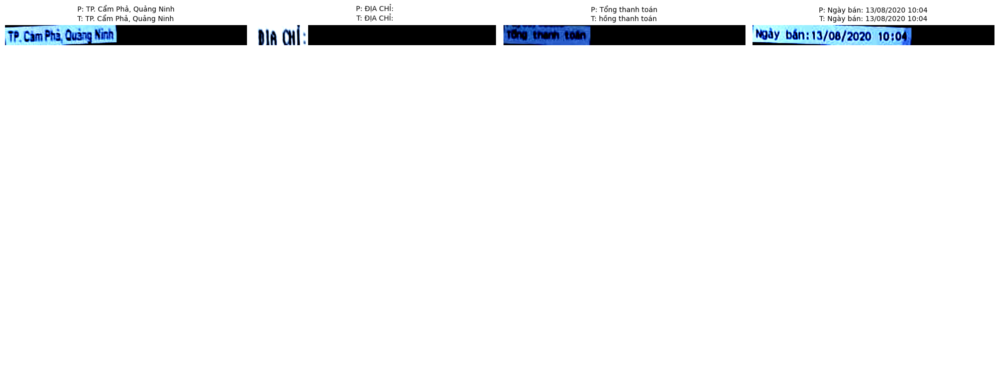


Epoch 2/20


Evaluating: 100%|██████████| 10/10 [01:10<00:00,  7.05s/it]


Train Loss: 0.3258 | Val Loss: 0.3694 | Val CER: 0.1570
✅ Saved best model!


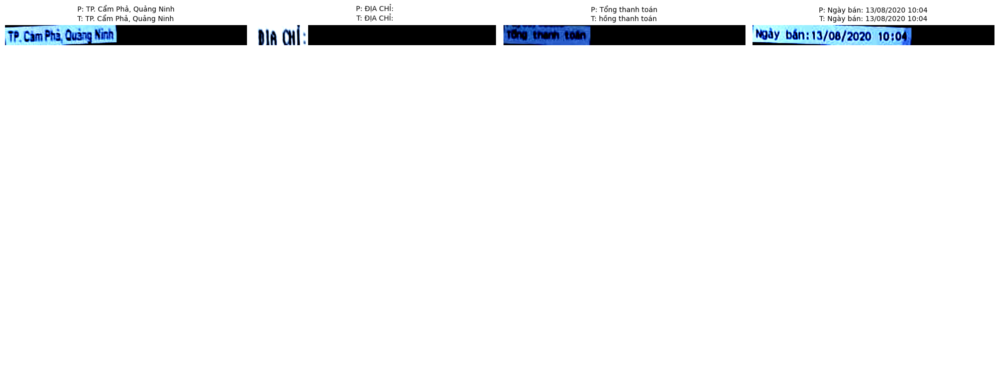


Epoch 3/20


Evaluating: 100%|██████████| 10/10 [01:41<00:00, 10.16s/it]


Train Loss: 0.1816 | Val Loss: 0.3512 | Val CER: 0.1265
✅ Saved best model!


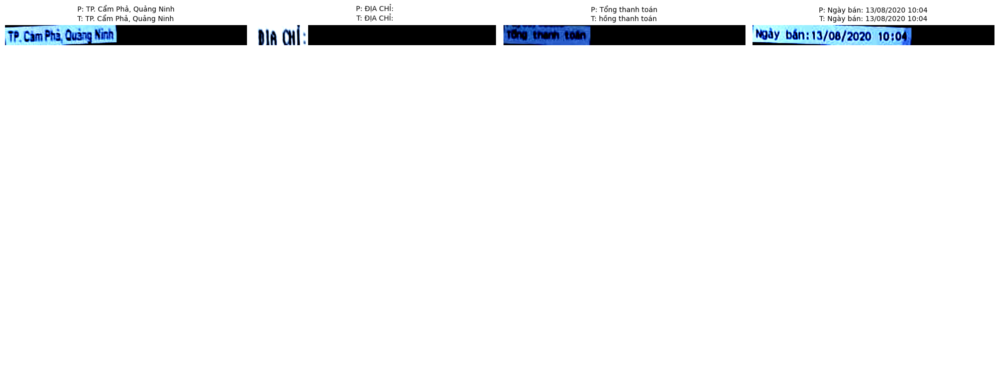


Epoch 4/20


Evaluating: 100%|██████████| 10/10 [02:28<00:00, 14.88s/it]

Train Loss: 0.1162 | Val Loss: 0.3653 | Val CER: 0.1303


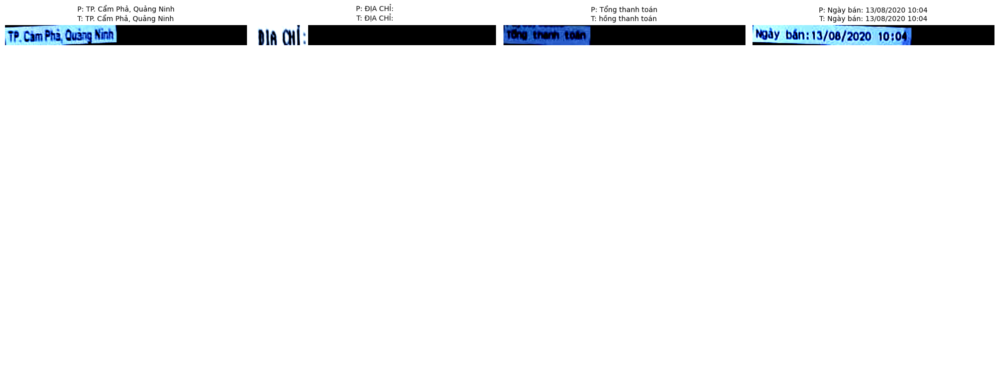


Epoch 5/20


Evaluating: 100%|██████████| 10/10 [01:21<00:00,  8.18s/it]

Train Loss: 0.0812 | Val Loss: 0.3695 | Val CER: 0.1188


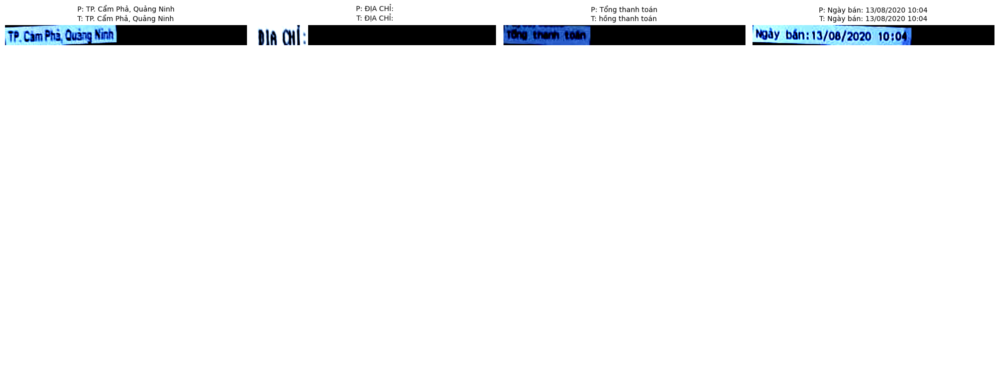


Epoch 6/20


Evaluating: 100%|██████████| 10/10 [01:23<00:00,  8.33s/it]

Train Loss: 0.0617 | Val Loss: 0.3810 | Val CER: 0.1170
Early stopping at epoch 6


In [ ]:
import torch
import torch.optim as optim
import matplotlib.pyplot as plt
from torch import nn
from tqdm import tqdm

# Thiết lập device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Cài đặt các siêu tham số
num_epochs = 20  # Số epoch
learning_rate = 1e-4  # Learning rate
best_val_loss = float('inf')  # Lưu loss tốt nhất
save_path = "/content/best_ocr_model.pt"  # Đường dẫn lưu mô hình tốt nhất

# Đảm bảo mô hình được chuyển sang device (GPU hoặc CPU)
model = OCRModel(
    vocab_size=len(tokenizer.vocab),
    sos_token_id=tokenizer.vocab['<SOS>'],
    eos_token_id=tokenizer.vocab['<EOS>'],
    max_len=150  # Điều chỉnh nếu cần
).to(device)

# Định nghĩa loss function và optimizer
criterion = nn.CrossEntropyLoss(ignore_index=tokenizer.vocab['<PAD>'])
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

# Sử dụng learning rate scheduler để giảm LR khi loss không cải thiện
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=2, verbose=True)

# 2. Sửa phần train loop (thay đổi ít nhất)
early_stopper = EarlyStopping(patience=3)  # Dừng nếu loss không giảm sau

# Bắt đầu huấn luyện
for epoch in range(num_epochs):
    print(f"\nEpoch {epoch+1}/{num_epochs}")

    # Huấn luyện cho 1 epoch
    train_loss = train_one_epoch(model, train_loader, optimizer, criterion)

    # Đánh giá trên validation set
    val_loss, val_cer = evaluate(model, val_loader, criterion)
    # val_loss, val_cer = evaluate(model, val_loader, criterion, tokenizer, device, visualize_attention=False)


    # In ra kết quả
    print(f"Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f} | Val CER: {val_cer:.4f}")

    if early_stopper(val_loss):  # <-- Thêm dòng này để kiểm tra
        print(f"Early stopping at epoch {epoch+1}")
        break

    # Điều chỉnh learning rate nếu cần
    scheduler.step(val_loss)

    # Lưu lại mô hình tốt nhất
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        torch.save(model.state_dict(), save_path)
        print("✅ Saved best model!")

    # Hiển thị kết quả dự đoán trên validation set
    # visualize_prediction(model, val_loader, tokenizer, device, num_samples=4)

    # Sửa dòng này để nhận kết quả trả về từ visualize_prediction
    last_attention, last_images, last_texts, last_preds = visualize_prediction(
        model, val_loader, tokenizer, device, num_samples=4
    )

    # # Chạy visualize_prediction
    # preds, attention_weights, images, texts = visualize_prediction(model, val_loader, tokenizer, device, num_samples=4)

    # # Chọn 1 ảnh ví dụ trong 4 ảnh đầu ra (ví dụ ảnh thứ 2)
    # attn_weights_image2 = attention_weights[1]  # list [L x (H, T, S)]

    # # Nếu attention là list [L x (H, T, S)], convert về tensor:
    # # Chuyển đổi list của các trọng số attention thành tensor nếu nó là list
    # if isinstance(attn_weights_image2, list) and isinstance(attn_weights_image2[0], torch.Tensor):
    #     attn_weights_image2 = torch.stack(attn_weights_image2)

    # # Bây giờ bạn có thể sử dụng unsqueeze
    # attn_tensor_all_layers = [
    #     torch.tensor(attn).unsqueeze(0) if not isinstance(attn, torch.Tensor) else attn.unsqueeze(0)
    #     for attn in attn_weights_image2
    # ]
    # # Hoặc nếu attention trả về dạng chuẩn rồi thì dùng trực tiếp

    # # Vẽ attention giữa token đầu ra thứ 3 và ảnh
    # plot_token_attention(attn_tensor_all_layers, token_idx=3, layer=0, head=0)

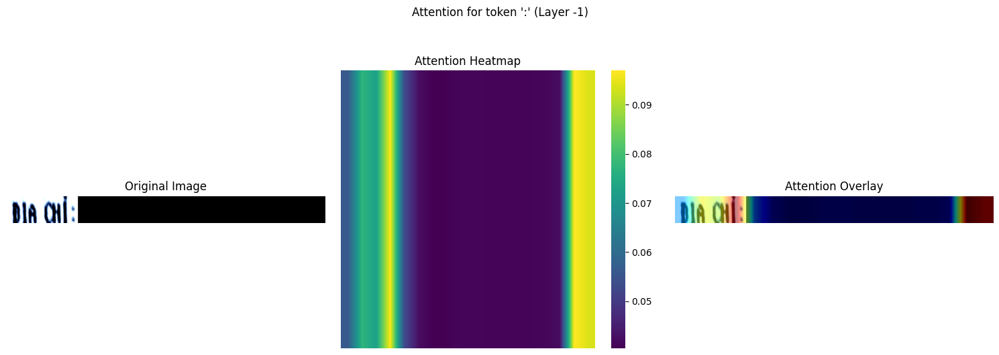

In [ ]:
# Cell này chạy sau khi huấn luyện xong
sample_idx = 1  # Chọn sample đầu tiên (0-3)

# Lấy thông tin từ kết quả visualization cuối cùng
selected_attention = last_attention
selected_image = last_images[sample_idx]
selected_pred_text = tokenizer.decode(last_preds[sample_idx].tolist(), skip_special_tokens=True)

# Hiển thị attention chi tiết cho token cụ thể
plot_detailed_attention(
    selected_attention[sample_idx],  # attention weights cho sample được chọn
    selected_image,
    selected_pred_text,
    token_idx=-1,  # Có thể thay đổi để xem attention cho token khác
    layer=-1       # Có thể thay đổi để xem attention từ layer khác
)

In [ ]:
def analyze_character_attention(attention_weights, image, text, token_idx, layer=-1, threshold=0.1):
    """
    Phân tích các ký tự được chú ý khi dự đoán 1 token cụ thể
    Args:
        attention_weights: Danh sách attention weights từ model.predict()
        image: Ảnh gốc tensor [C, H, W]
        text: Văn bản dự đoán
        token_idx: Vị trí token cần phân tích
        layer: Layer cần visualize (-1 cho layer cuối)
        threshold: Ngưỡng attention để xác định ký tự quan trọng
    """
    # Lấy attention map
    layer_attn = attention_weights[layer][0] if isinstance(attention_weights[layer], list) else attention_weights[layer]
    avg_attn = layer_attn.mean(dim=0)  # [T, S]
    token_attn = avg_attn[token_idx]   # [S]

    # Chuẩn bị ảnh
    img = image.detach().cpu()
    if img.shape[0] == 1:
        img = img.squeeze(0)
    else:
        img = img.permute(1, 2, 0)

    # Xác định các ký tự quan trọng
    important_indices = torch.where(token_attn > threshold)[0]
    print(f"\nPhân tích attention cho token '{text[token_idx]}' (vị trí {token_idx}):")
    print(f"Ngưỡng attention: {threshold:.2f}")
    print("Các ký tự được chú ý nhiều nhất:")

    for idx in important_indices:
        char = text[min(idx, len(text)-1)]  # Phòng trường hợp vượt quá độ dài
        print(f"- Ký tự '{char}' (vị trí {idx}): attention_score = {token_attn[idx]:.4f}")

    # Visualize
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Ảnh gốc với highlight
    axes[0].imshow(img, cmap='gray' if len(img.shape) == 2 else None)
    axes[0].set_title(f"Text: {text}")
    axes[0].axis('off')

    # Attention heatmap
    sns.heatmap(token_attn.unsqueeze(0).cpu().numpy(),
                ax=axes[1],
                cmap="YlOrRd",
                annot=True,
                fmt=".2f",
                cbar=False)
    axes[1].set_title(f"Attention scores cho token '{text[token_idx]}'")
    axes[1].set_xlabel("Vị trí ký tự")
    axes[1].set_ylabel("Attention")
    axes[1].set_xticks(range(len(text)))
    axes[1].set_xticklabels(list(text))

    plt.tight_layout()
    plt.show()

In [ ]:
# Cell này chạy sau khi huấn luyện xong
sample_idx = 1  # Chọn sample (0-3)
token_to_analyze = 'C'  # Ký tự muốn phân tích

# Lấy dữ liệu
selected_attention = last_attention
selected_image = last_images[sample_idx]
selected_pred_text = tokenizer.decode(last_preds[sample_idx].tolist(), skip_special_tokens=True)

# Tìm vị trí token trong text
token_idx = selected_pred_text.index(token_to_analyze)

# 1. Hiển thị heatmap tổng quan
plot_detailed_attention(
    selected_attention[sample_idx],
    selected_image,
    selected_pred_text,
    token_idx=token_idx,
    layer=-1
)

# 2. Phân tích chi tiết các ký tự được chú ý
analyze_character_attention(
    selected_attention[sample_idx],
    selected_image,
    selected_pred_text,
    token_idx=token_idx,
    layer=-1,
    threshold=0.05  # Có thể điều chỉnh
)

### Inference

In [ ]:
import cv2
import torch
from torchvision import transforms
import matplotlib.pyplot as plt

# ==== CẤU HÌNH ====
image_path = '/content/hoadon_dataset/test/img/receipt_5605.jpg'  # Đường dẫn đến ảnh dòng đã cắt sẵn
# image_path ='/content/download.png'
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# ==== TIỀN XỬ LÝ ====
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((64, 256)),  # Giữ nguyên kích thước đầu vào model
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

# ==== LOAD ẢNH ====
cropped = cv2.imread(image_path)

# Kiểm tra nếu không đọc được ảnh
if cropped is None:
    raise ValueError(f"Không thể đọc ảnh từ đường dẫn: {image_path}")

# Hiển thị ảnh
plt.imshow(cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB))
plt.title('Ảnh dòng đã cắt sẵn')
plt.axis('off')
plt.show()

# ==== INFERENCE OCR ====
input_tensor = transform(cropped).unsqueeze(0).to(device)

def decode_output(output, tokenizer):
    """Hàm giải mã linh hoạt"""
    if isinstance(output, tuple):
        output = output[0]  # Lấy predictions nếu có attention

    if isinstance(output, torch.Tensor):
        tokens = output.squeeze().tolist()
    else:
        tokens = output

    # Xử lý beam search (list of lists)
    if isinstance(tokens, list) and len(tokens) > 0 and isinstance(tokens[0], list):
        tokens = tokens[0]

    return tokenizer.decode(tokens)

# Giả sử model và tokenizer đã được load trước đó
with torch.no_grad():
    model_output = model.predict(input_tensor)
    pred_text = decode_output(model_output, tokenizer)

print("✅ Dự đoán OCR:", pred_text)

## Eng + Vietnamese

### Preprocessing

In [ ]:
import os
import shutil

def reduce_dataset(folder_path, num_files=100):
    # Paths to img and annotations folders
    img_folder = os.path.join(folder_path, 'img')
    ann_folder = os.path.join(folder_path, 'annotations')

    # Get list of image files and sort them
    img_files = sorted([f for f in os.listdir(img_folder) if f.endswith('.jpg')])

    # Select first 100 files
    selected_files = img_files[:num_files]

    # Create new folders for reduced dataset
    reduced_img = os.path.join(folder_path, 'reduced_img')
    reduced_ann = os.path.join(folder_path, 'reduced_annotations')
    os.makedirs(reduced_img, exist_ok=True)
    os.makedirs(reduced_ann, exist_ok=True)

    # Copy selected files to new folders
    for img_file in selected_files:
        # Copy image
        src_img = os.path.join(img_folder, img_file)
        dst_img = os.path.join(reduced_img, img_file)
        shutil.copy2(src_img, dst_img)

        # Copy corresponding annotation
        json_file = img_file.replace('.jpg', '.json')
        src_json = os.path.join(ann_folder, json_file)
        dst_json = os.path.join(reduced_ann, json_file)
        if os.path.exists(src_json):
            shutil.copy2(src_json, dst_json)

    print(f"Reduced dataset created in {folder_path} with {num_files} samples")

# Apply to all folders
dataset_root = 'receipt_dataset'
for folder in ['train', 'val', 'test']:
    folder_path = os.path.join(dataset_root, folder)
    reduce_dataset(folder_path)

Reduced dataset created in receipt_dataset/train with 100 samples
Reduced dataset created in receipt_dataset/val with 100 samples
Reduced dataset created in receipt_dataset/test with 100 samples


In [ ]:
from typing import List, Tuple
from pathlib import Path
import json

def convert_json_to_ocr_format(
    img_dir: str,
    json_dir: str,
    output_file: str = "ocr_annotations.txt"
) -> List[Tuple[str, List[Tuple[float, float]], str]]:
    """
    Chuyển đổi annotation từ JSON sang dạng (image_path, polygon, text)

    Args:
        img_dir: Thư mục chứa ảnh
        json_dir: Thư mục chứa file JSON annotation
        output_file: File đầu ra để lưu kết quả

    Returns:
        List[Tuple]: Danh sách các annotation dạng (image_path, polygon, text)
    """
    annotations = []

    # Lặp qua tất cả file JSON trong thư mục
    for json_file in Path(json_dir).glob("*.json"):
        # Lấy đường dẫn ảnh tương ứng
        img_name = json_file.stem + ".jpg"  # Giả sử ảnh có định dạng .jpg
        img_path = str(Path(img_dir) / img_name)

        # Kiểm tra xem ảnh có tồn tại không
        if not os.path.exists(img_path):
            print(f"Warning: Ảnh {img_path} không tồn tại, bỏ qua")
            continue

        # Đọc nội dung file JSON
        with open(json_file, 'r', encoding='utf-8') as f:
            boxes = json.load(f)

        # Tạo annotation cho từng box
        for box in boxes:
            # Chuyển đổi polygon về dạng list of tuples
            polygon = [(float(point[0]), float(point[1])) for point in box['box']]
            text = box['text'].strip()

            # Thêm vào danh sách kết quả
            annotations.append((img_path, polygon, text))

    # Ghi kết quả ra file
    with open(output_file, 'w', encoding='utf-8') as f:
        for ann in annotations:
            img_path, polygon, text = ann

            # Chuyển polygon về dạng string
            poly_str = ' '.join([f"{x},{y}" for x, y in polygon])

            # Ghi theo định dạng: image_path|polygon|text
            f.write(f"{img_path}|{poly_str}|{text}\n")

    print(f"Đã chuyển đổi {len(annotations)} annotations và lưu vào {output_file}")
    return annotations

# Sử dụng hàm
if __name__ == "__main__":
    # Thay đổi các đường dẫn phù hợp với dataset của bạn
    img_dir = "receipt_dataset/train/img"
    json_dir = "receipt_dataset/train/annotations"
    output_file = "train_annotations.txt"

    annotations = convert_json_to_ocr_format(img_dir, json_dir, output_file)

    # Tạo annotation cho tập test
    test_img_dir = "receipt_dataset/test/img"
    test_json_dir = "receipt_dataset/test/annotations"
    test_output_file = "test_annotations.txt"

    test_annotations = convert_json_to_ocr_format(test_img_dir, test_json_dir, test_output_file)

    # Tạo annotation cho tập val
    val_img_dir = "receipt_dataset/val/img"
    val_json_dir = "receipt_dataset/val/annotations"
    val_output_file = "val_annotations.txt"

    val_annotations = convert_json_to_ocr_format(val_img_dir, val_json_dir, val_output_file)

    # In thử 5 annotation đầu tiên để kiểm tra
    print("\n5 annotation đầu tiên:")
    for ann in annotations[:5]:
        print(f"Image: {ann[0]}")
        print(f"Polygon: {ann[1]}")
        print(f"Text: {ann[2]}\n")

Đã chuyển đổi 36708 annotations và lưu vào train_annotations.txt
Đã chuyển đổi 7918 annotations và lưu vào test_annotations.txt
Đã chuyển đổi 7705 annotations và lưu vào val_annotations.txt

5 annotation đầu tiên:
Image: receipt_dataset/train/img/receipt_0636.jpg
Polygon: [(174.0, 227.0), (682.0, 227.0), (682.0, 271.0), (174.0, 271.0)]
Text: LIGHTROOM GALLERY SDN BHD

Image: receipt_dataset/train/img/receipt_0636.jpg
Polygon: [(236.0, 266.0), (611.0, 266.0), (611.0, 305.0), (236.0, 305.0)]
Text: NO: 28, JALAN ASTANA 1C,

Image: receipt_dataset/train/img/receipt_0636.jpg
Polygon: [(226.0, 298.0), (629.0, 298.0), (629.0, 338.0), (226.0, 338.0)]
Text: BANDAR BUKIT RAJA, 41050

Image: receipt_dataset/train/img/receipt_0636.jpg
Polygon: [(192.0, 329.0), (661.0, 329.0), (661.0, 369.0), (192.0, 369.0)]
Text: KLANG SELANGOR D. E, MALAYSIA

Image: receipt_dataset/train/img/receipt_0636.jpg
Polygon: [(261.0, 365.0), (593.0, 365.0), (593.0, 400.0), (261.0, 400.0)]
Text: ROC NO. : (1072825-A)



In [ ]:
import unicodedata

def build_vocab(json_dirs, min_freq=1):
    """
    Xây dựng từ vựng từ các file JSON annotation.

    Args:
        json_dirs: Danh sách thư mục chứa file JSON annotation.
        min_freq: Tần suất tối thiểu để thêm ký tự vào vocab.

    Returns:
        vocab: Dict ánh xạ ký tự sang index.
        inv_vocab: Dict ánh xạ index sang ký tự.
    """
    char_counter = Counter()

    # Duyệt qua tất cả file JSON
    for json_dir in json_dirs:
        for json_file in Path(json_dir).glob("*.json"):
            try:
                with open(json_file, 'r', encoding='utf-8') as f:
                    boxes = json.load(f)
                for box in boxes:
                    text = unicodedata.normalize('NFC', box['text'].strip())
                    char_counter.update(text)
            except Exception as e:
                print(f"Error processing {json_file}: {e}")

    # Token cơ bản
    vocab = {
        '<PAD>': 0, '<SOS>': 1, '<EOS>': 2, '<UNK>': 3,
        ' ': 4  # Dấu cách
    }
    idx = 5

    # Ký tự bắt buộc
    must_include = set(
        "0123456789ABCDEFGHIJKLMNOPQRSTUVWXYZabcdefghijklmnopqrstuvwxyz"
        "*=%/$,.-+:@#&()"
        "àáảãạâầấẩẫậăằắẳẵặ"
        "èéẻẽẹêềếểễệ"
        "ìíỉĩị"
        "òóỏõọôồốổỗộơờớởỡợ"
        "ùúủũụưừứửữự"
        "ỳýỷỹỵ"
        "đ"
        "ÀÁẢÃẠÂẦẤẨẪẬĂẰẮẲẴẶ"
        "ÈÉẺẼẸÊỀẾỂỄỆ"
        "ÌÍỈĨỊ"
        "ÒÓỎÕỌÔỒỐỔỖỘƠỜỚỞỠỢ"
        "ÙÚỦŨỤƯỪỨỬỮỰ"
        "ỲÝỶỸỴ"
        "Đ"
    )

    # Thêm ký tự từ dataset (đạt min_freq)
    for char, count in char_counter.items():
        if char not in vocab and count >= min_freq:
            vocab[char] = idx
            idx += 1

    # Đảm bảo ký tự bắt buộc
    for char in must_include:
        if char not in vocab:
            vocab[char] = idx
            idx += 1

    inv_vocab = {v: k for k, v in vocab.items()}
    return vocab, inv_vocab

In [ ]:
from collections import Counter

json_dirs = [
        "receipt_dataset/train/annotations",
        "receipt_dataset/val/annotations",
        "receipt_dataset/test/annotations"
    ]
vocab, inv_vocab = build_vocab(json_dirs, min_freq=1)
print(f"Kích thước vocab: {len(vocab)}")
print("Sample vocab:", {k: vocab[k] for k in list(vocab)[:10]})

# Lưu vocab
with open("vocab.json", "w", encoding="utf-8") as f:
    json.dump({'vocab': vocab, 'inv_vocab': inv_vocab}, f, ensure_ascii=False)

Kích thước vocab: 236
Sample vocab: {'<PAD>': 0, '<SOS>': 1, '<EOS>': 2, '<UNK>': 3, ' ': 4, 'L': 5, 'I': 6, 'G': 7, 'H': 8, 'T': 9}


In [ ]:
import unicodedata
from typing import List, Union

class OCRTokenizer:
    def __init__(self, vocab: dict):
        required_tokens = ['<PAD>', '<SOS>', '<EOS>', '<UNK>']
        for token in required_tokens:
            if token not in vocab:
                raise ValueError(f"Vocab must contain {token}")

        self.vocab = vocab
        self.idx2char = {idx: char for char, idx in vocab.items()}
        self.unk_token_id = vocab['<UNK>']
        self.special_tokens = {
            'pad': vocab['<PAD>'],
            'sos': vocab['<SOS>'],
            'eos': vocab['<EOS>']
        }

    def encode(self, text: str, max_length: int = 150) -> List[int]:
        if not isinstance(text, str):
            raise ValueError("Input must be a string")

        text = unicodedata.normalize('NFC', text.strip())
        tokens = [self.vocab.get(char, self.unk_token_id) for char in text]
        encoded = [self.special_tokens['sos']] + tokens[:max_length] + [self.special_tokens['eos']]
        return encoded

    def batch_encode(self, texts: List[str], max_length: int = 150) -> List[List[int]]:
        return [self.encode(text, max_length) for text in texts]

    def decode(self, token_ids: List[int], skip_special_tokens: bool = True) -> str:
        decoded = []
        for id in token_ids:
            if skip_special_tokens and id in self.special_tokens.values():
                continue
            # Nếu token ID là <UNK> hoặc không tồn tại trong vocab
            if id == self.unk_token_id:
                decoded.append('?')
            elif id in self.idx2char:
                decoded.append(self.idx2char[id])
            else:
                decoded.append('?')  # Dùng '?' nếu gặp token không hợp lệ
        return ''.join(decoded)

    def batch_decode(self, batch_token_ids: List[List[int]], skip_special_tokens: bool = True) -> List[str]:
        return [self.decode(token_ids, skip_special_tokens) for token_ids in batch_token_ids]

    def __len__(self) -> int:
        return len(self.vocab)

    @property
    def vocab_size(self) -> int:
        return len(self)

In [ ]:
with open("vocab.json", "r", encoding="utf-8") as f:
    vocab_data = json.load(f)
    vocab = vocab_data['vocab']

tokenizer = OCRTokenizer(vocab)
text = "RECEIPT - CHANGE TAX"
encoded = tokenizer.encode(text)
decoded = tokenizer.decode(encoded)

print("Vocab size:", len(tokenizer))
print("Encoded:", encoded)
print("Decoded:", decoded)

texts = ["Hello", "Ton Yum"]
batch_encoded = tokenizer.batch_encode(texts)
batch_decoded = tokenizer.batch_decode(batch_encoded)
print("Batch encoded:", batch_encoded)
print("Batch decoded:", batch_decoded)


tokenizer = OCRTokenizer(vocab)
text = "Ngày mua hàng - "
encoded = tokenizer.encode(text)
decoded = tokenizer.decode(encoded)

print("Vocab size:", len(tokenizer))
print("Encoded:", encoded)
print("Decoded:", decoded)

texts = ["Thành tiền", "HÓA ĐƠN"]
batch_encoded = tokenizer.batch_encode(texts)
batch_decoded = tokenizer.batch_decode(batch_encoded)
print("Batch encoded:", batch_encoded)
print("Batch decoded:", batch_decoded)

Vocab size: 236
Encoded: [1, 10, 14, 26, 14, 6, 44, 9, 4, 35, 4, 26, 8, 13, 18, 7, 14, 4, 9, 13, 41, 2]
Decoded: RECEIPT - CHANGE TAX
Batch encoded: [[1, 8, 73, 78, 78, 189, 2], [1, 9, 189, 77, 4, 15, 144, 76, 2]]
Batch decoded: ['Hello', 'Ton Yum']
Vocab size: 236
Encoded: [1, 18, 182, 227, 161, 4, 76, 144, 69, 4, 71, 227, 77, 182, 4, 35, 2]
Decoded: Ngày mua hàng -
Batch encoded: [[1, 9, 71, 227, 77, 71, 4, 130, 72, 218, 77, 2], [1, 8, 137, 13, 4, 121, 201, 18, 2]]
Batch decoded: ['Thành tiền', 'HÓA ĐƠN']


In [ ]:
import torch
from torch.utils.data import Dataset, DataLoader
import cv2
import numpy as np
from PIL import Image
import torchvision.transforms as transforms
import torch.nn.functional as F

# Định nghĩa OCRDataset
def get_image_transform():
    return transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

class OCRDataset(Dataset):
    def __init__(self, annotation_file, tokenizer, transform=None, target_height=48):
        self.annotations = []
        with open(annotation_file, 'r', encoding='utf-8') as f:
            for line in f:
                parts = line.strip().split('|')
                if len(parts) == 3:
                    img_path, poly_str, text = parts
                    try:
                        if not text.strip():
                            raise ValueError("Text không được rỗng")

                        polygon = [tuple(map(float, p.split(','))) for p in poly_str.split()]
                        if len(polygon) < 3:
                            raise ValueError("Polygon không hợp lệ")

                        self.annotations.append((img_path, polygon, text.strip()))
                    except Exception as e:
                        print(f"Bỏ qua mẫu {img_path}: {str(e)}")
                        continue

        self.tokenizer = tokenizer
        self.transform = transform or get_image_transform()
        self.target_height = target_height

    def _crop_by_polygon(self, img, polygon):
        pts = np.array(polygon, dtype=np.float32)
        if len(pts) < 3:
            raise ValueError("Polygon phải có ít nhất 3 điểm")
        x, y, w, h = cv2.boundingRect(pts)
        if w <= 0 or h <= 0:
            raise ValueError("Bounding rect không hợp lệ")
        mask = np.zeros(img.shape[:2], dtype=np.uint8)
        cv2.fillPoly(mask, [pts.astype(np.int32)], 255)
        cropped = img[y:y+h, x:x+w]
        mask = mask[y:y+h, x:x+w]
        result = np.full_like(cropped, 255)
        result[mask > 0] = cropped[mask > 0]
        return result

    def _resize_with_ratio(self, img):
        h, w = img.shape[:2]
        ratio = self.target_height / h
        new_w = int(w * ratio)
        resized = cv2.resize(img, (new_w, self.target_height))
        return resized

    def __getitem__(self, idx):
        img_path, polygon, text = self.annotations[idx]

        try:
            img = cv2.imread(img_path)
            if img is None:
                raise ValueError("Không đọc được ảnh")

            cropped = self._crop_by_polygon(img, polygon)
            resized = self._resize_with_ratio(cropped)
            pil_image = Image.fromarray(cv2.cvtColor(resized, cv2.COLOR_BGR2RGB))
            image_tensor = self.transform(pil_image)

        except Exception as e:
            print(f"Lỗi xử lý ảnh {img_path}: {str(e)}")
            image_tensor = torch.zeros((3, self.target_height, 672))
            text = "<UNK>"

        try:
            tokens = self.tokenizer.encode(text)
            if len(tokens) == 0:
                raise ValueError("Encode text thất bại")
            tokens = torch.tensor(tokens, dtype=torch.long)  # Chuyển sang tensor ngay tại đây
        except Exception as e:
            print(f"Lỗi encode text '{text}': {str(e)}")
            tokens = torch.tensor(self.tokenizer.encode("<UNK>"), dtype=torch.long)

        return image_tensor, tokens

    def __len__(self):
        return len(self.annotations)


def collate_fn(batch):
    valid_batch = [(img, tokens) for img, tokens in batch if img is not None and len(tokens) > 0]
    if not valid_batch:
        return None

    images, targets = zip(*valid_batch)

    # --- 1. Pad ảnh theo chiều rộng ---
    # Tìm max_width trong batch
    max_width = max(img.shape[2] for img in images)
    height = images[0].shape[1]  # target_height cố định

    # Tạo tensor chứa ảnh đã pad: (B, 3, H, max_width)
    padded_images = torch.zeros((len(images), 3, height, max_width), dtype=images[0].dtype)
    for i, img in enumerate(images):
        c, h, w = img.shape
        padded_images[i, :, :, :w] = img
        # Phần pad bên phải (w → max_width) giữ giá trị 0

    # --- 2. Pad targets và build attention_mask ---
    max_len = max(len(t) for t in targets)
    padded_targets = torch.full((len(targets), max_len), fill_value=0, dtype=torch.long)  # PAD_ID = 0
    attention_mask = torch.zeros((len(targets), max_len), dtype=torch.bool)

    for i, seq in enumerate(targets):
        # nếu seq là list, chuyển thành tensor
        if isinstance(seq, list):
            seq = torch.tensor(seq, dtype=torch.long)

        # đảm bảo có EOS token ở cuối
        if seq[-1] != 2:  # EOS_ID = 2
            seq = torch.cat([seq, torch.tensor([2], dtype=torch.long)])

        seq_len = seq.shape[0]
        padded_targets[i, :seq_len] = seq
        attention_mask[i, :seq_len] = True

    return {
        "images": padded_images,        # Tensor (B, 3, H, W_max)
        "targets": padded_targets,      # Tensor (B, L_max)
        "attention_mask": attention_mask  # Tensor (B, L_max)
    }

In [ ]:
import torch
from torch.utils.data import Dataset, DataLoader
import cv2
import numpy as np
from PIL import Image
import torchvision.transforms as transforms

# Định nghĩa transform cho ảnh
def get_image_transform():
    return transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

class OCRDataset_2(Dataset):
    def __init__(self, annotation_file, image_dir, tokenizer, transform=None, target_height=48):
        self.annotations = []
        with open(annotation_file, 'r', encoding='utf-8') as f:
            for line in f:
                parts = line.strip().split('\t')
                if len(parts) == 2:
                    img_name, text = parts
                    img_path = os.path.join(image_dir, img_name.strip())
                    if text.strip():  # bỏ mẫu rỗng
                        self.annotations.append((img_path, text.strip()))

        self.tokenizer = tokenizer
        self.transform = transform or get_image_transform()
        self.target_height = target_height

    def _resize_with_ratio(self, img):
        h, w = img.shape[:2]
        ratio = self.target_height / h
        new_w = int(w * ratio)
        resized = cv2.resize(img, (new_w, self.target_height))
        return resized

    def __getitem__(self, idx):
        img_path, text = self.annotations[idx]

        try:
            img = cv2.imread(img_path)
            if img is None:
                raise ValueError("Không đọc được ảnh")

            resized = self._resize_with_ratio(img)
            pil_image = Image.fromarray(cv2.cvtColor(resized, cv2.COLOR_BGR2RGB))
            image_tensor = self.transform(pil_image)

        except Exception as e:
            print(f"Lỗi xử lý ảnh {img_path}: {str(e)}")
            image_tensor = torch.zeros((3, self.target_height, 672))
            text = "<UNK>"

        try:
            tokens = self.tokenizer.encode(text)
            if len(tokens) == 0:
                raise ValueError("Encode text thất bại")
            tokens = torch.tensor(tokens, dtype=torch.long)  # Chuyển sang tensor ngay tại đây
        except Exception as e:
            print(f"Lỗi encode text '{text}': {str(e)}")
            tokens = torch.tensor(self.tokenizer.encode("<UNK>"), dtype=torch.long)

        return image_tensor, tokens

    def __len__(self):
        return len(self.annotations)

def collate_fn(batch):
    valid_batch = [(img, tokens) for img, tokens in batch if img is not None and len(tokens) > 0]
    if not valid_batch:
        return None

    images, targets = zip(*valid_batch)

    # --- 1. Pad ảnh theo chiều rộng ---
    max_width = max(img.shape[2] for img in images)
    height = images[0].shape[1]  # target_height cố định

    # Tạo tensor chứa ảnh đã pad: (B, 3, H, max_width)
    padded_images = torch.zeros((len(images), 3, height, max_width), dtype=images[0].dtype)
    for i, img in enumerate(images):
        c, h, w = img.shape
        padded_images[i, :, :, :w] = img
        # Phần pad bên phải (w → max_width) giữ giá trị 0

    # --- 2. Pad targets và build attention_mask ---
    max_len = max(len(t) for t in targets)
    padded_targets = torch.full((len(targets), max_len), fill_value=0, dtype=torch.long)  # PAD_ID = 0
    attention_mask = torch.zeros((len(targets), max_len), dtype=torch.bool)

    for i, seq in enumerate(targets):
        # nếu seq là list, chuyển thành tensor
        if isinstance(seq, list):
            seq = torch.tensor(seq, dtype=torch.long)

        # đảm bảo có EOS token ở cuối
        if seq[-1] != 2:  # EOS_ID = 2
            seq = torch.cat([seq, torch.tensor([2], dtype=torch.long)])

        seq_len = seq.shape[0]
        padded_targets[i, :seq_len] = seq
        attention_mask[i, :seq_len] = True

    return {
        "images": padded_images,        # Tensor (B, 3, H, W_max)
        "targets": padded_targets,      # Tensor (B, L_max)
        "attention_mask": attention_mask  # Tensor (B, L_max)
    }

In [ ]:
import os

# Đường dẫn đến folder chứa ảnh theo split
split_dirs = {
    "train": "/content/hoadon_dataset/train/img",
    "val": "/content/hoadon_dataset/val/img",
    "test": "/content/hoadon_dataset/test/img",
}

# Đường dẫn annotations gốc
annotation_file = "/content/hoadon_dataset/annotations.txt"

# Đường dẫn output
output_folder = "/content/hoadon_dataset/"
os.makedirs(output_folder, exist_ok=True)

# Đọc toàn bộ annotation
with open(annotation_file, 'r', encoding='utf-8') as f:
    annotations = [line.strip() for line in f if line.strip()]

# Tạo set ảnh cho từng split để tra cứu nhanh
split_image_sets = {
    split: set(os.listdir(img_dir))
    for split, img_dir in split_dirs.items()
}

# Tạo dict chứa nội dung cho từng file
split_annotation_lines = {
    "train": [],
    "val": [],
    "test": []
}

# Phân chia annotation theo ảnh
for line in annotations:
    try:
        img_name, text = line.strip().split('\t')
        for split in ["train", "val", "test"]:
            if img_name in split_image_sets[split]:
                split_annotation_lines[split].append(f"{img_name}\t{text}")
                break
        else:
            print(f"⚠️ Không tìm thấy ảnh {img_name} trong bất kỳ split nào.")
    except ValueError:
        print(f"❌ Lỗi format dòng: {line}")

# Ghi các file output
for split in ["train", "val", "test"]:
    output_path = os.path.join(output_folder, f"{split}_annotations.txt")
    with open(output_path, 'w', encoding='utf-8') as f:
        f.write('\n'.join(split_annotation_lines[split]))
    print(f"✅ Đã ghi {len(split_annotation_lines[split])} dòng vào {output_path}")


✅ Đã ghi 4982 dòng vào /content/hoadon_dataset/train_annotations.txt
✅ Đã ghi 622 dòng vào /content/hoadon_dataset/val_annotations.txt
✅ Đã ghi 624 dòng vào /content/hoadon_dataset/test_annotations.txt


In [ ]:
from torch.utils.data import ConcatDataset

tokenizer = OCRTokenizer(vocab)
transform = get_image_transform()

eng_train_dataset = OCRDataset(
    annotation_file="train_annotations.txt",
    tokenizer=tokenizer,
    transform=transform,
    target_height=48,
)

eng_val_dataset = OCRDataset(
    annotation_file="val_annotations.txt",
    tokenizer=tokenizer,
    transform=transform,
    target_height=48,
)

eng_test_dataset = OCRDataset(
    annotation_file="test_annotations.txt",
    tokenizer=tokenizer,
    transform=transform,
    target_height=48,
)

viet_train_dataset = OCRDataset_2(
        annotation_file="/content/hoadon_dataset/train_annotations.txt",
        image_dir="/content/hoadon_dataset/train/img",
        tokenizer=tokenizer,
        transform=transform,
        target_height=48
    )

viet_val_dataset = OCRDataset_2(
        annotation_file="/content/hoadon_dataset/val_annotations.txt",
        image_dir="/content/hoadon_dataset/val/img",
        tokenizer=tokenizer,
        transform=transform,
        target_height=48
    )

viet_test_dataset = OCRDataset_2(
        annotation_file="/content/hoadon_dataset/test_annotations.txt",
        image_dir="/content/hoadon_dataset/test/img",
        tokenizer=tokenizer,
        transform=transform,
        target_height=48
    )

viet_train_dataset_oversampled = ConcatDataset([viet_train_dataset] * 5)
train_dataset = ConcatDataset([eng_train_dataset, viet_train_dataset_oversampled])

train_loader = DataLoader(
        train_dataset,
        batch_size=64,
        shuffle=True,
        collate_fn=collate_fn,
        num_workers = 4
    )

test_dataset = ConcatDataset([eng_test_dataset, viet_test_dataset])

test_loader = DataLoader(
        test_dataset,
        batch_size=64,
        shuffle=False,
        collate_fn=collate_fn,
        num_workers = 4
    )

val_dataset = ConcatDataset([eng_val_dataset, viet_val_dataset])
val_loader = DataLoader(
        val_dataset,
        batch_size=64,
        shuffle=False,
        collate_fn=collate_fn,
        num_workers = 4
    )

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


In [ ]:
def check_dataloader(dataloader, num_batches=5):
    """
    Kiểm tra DataLoader bằng cách in ra kích thước của images, targets và attention_mask.

    Parameters:
    - dataloader: DataLoader cần kiểm tra.
    - num_batches: Số lượng batch muốn kiểm tra. Mặc định là 5.
    """
    for i, batch in enumerate(dataloader):
        if i >= num_batches:
            break

        # Lấy dữ liệu trong batch
        images = batch['images']
        targets = batch['targets']
        attention_mask = batch['attention_mask']

        # In ra kích thước của images, targets và attention_mask
        print(f"Batch {i+1}:")
        print(f"  - Images shape: {images.shape}")  # (B, 3, H, W_max)
        print(f"  - Targets shape: {targets.shape}")  # (B, L_max)
        print(f"  - Attention mask shape: {attention_mask.shape}")  # (B, L_max)
        print("-" * 50)

# Kiểm tra dataloader cho train_loader
check_dataloader(train_loader)

Batch 1:
  - Images shape: torch.Size([64, 3, 48, 939])
  - Targets shape: torch.Size([64, 53])
  - Attention mask shape: torch.Size([64, 53])
--------------------------------------------------
Batch 2:
  - Images shape: torch.Size([64, 3, 48, 981])
  - Targets shape: torch.Size([64, 53])
  - Attention mask shape: torch.Size([64, 53])
--------------------------------------------------
Batch 3:
  - Images shape: torch.Size([64, 3, 48, 663])
  - Targets shape: torch.Size([64, 53])
  - Attention mask shape: torch.Size([64, 53])
--------------------------------------------------
Batch 4:
  - Images shape: torch.Size([64, 3, 48, 1072])
  - Targets shape: torch.Size([64, 47])
  - Attention mask shape: torch.Size([64, 47])
--------------------------------------------------
Batch 5:
  - Images shape: torch.Size([64, 3, 48, 1015])
  - Targets shape: torch.Size([64, 70])
  - Attention mask shape: torch.Size([64, 70])
--------------------------------------------------


### CNN Backbone + Masked Attention + Transformer Decoder

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models

class OCRBackbone(nn.Module):
    def __init__(self, output_dim=512, pretrained=True, in_channels=3):
        super().__init__()

        base_model = models.resnet34(weights="IMAGENET1K_V1" if pretrained else None)

        # Tùy chỉnh conv1 nếu ảnh là grayscale
        if in_channels == 1:
            self.conv1 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)
            with torch.no_grad():
                self.conv1.weight.data = base_model.conv1.weight.data.mean(dim=1, keepdim=True)
        else:
            self.conv1 = base_model.conv1

        self.bn1 = base_model.bn1
        self.relu = base_model.relu
        self.maxpool = base_model.maxpool

        self.layer1 = base_model.layer1  # giữ nguyên
        self.layer2 = base_model.layer2
        self.layer3 = base_model.layer3
        self.layer4 = base_model.layer4

        self.pool = nn.AdaptiveAvgPool2d((1, None))  # H = 1, giữ W'
        self.output_conv = nn.Conv2d(512, output_dim, kernel_size=1)
        self.norm = nn.LayerNorm(output_dim)

    def forward(self, x):
        """
        Args:
            x: [B, C, H, W]
        Returns:
            features: [B, T, D]
        """
        x = self.conv1(x)     # [B, 64, H/2, W/2]
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)   # [B, 64, H/4, W/4]

        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        x = self.pool(x)                  # [B, 512, 1, W']
        x = self.output_conv(x)          # [B, output_dim, 1, W']
        x = x.squeeze(2).permute(0, 2, 1)  # [B, W', output_dim]
        return self.norm(x)

In [ ]:
import math
import copy
import torch
import torch.nn as nn

# Positional Encoding
class PositionalEncoding(nn.Module):
    def __init__(self, d_model, max_len=5000):
        super().__init__()
        pe = torch.zeros(max_len, d_model)
        position = torch.arange(0, max_len).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, d_model, 2) * (-math.log(10000.0) / d_model))
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        pe = pe.unsqueeze(1)  # (max_len, 1, d_model)
        self.register_buffer('pe', pe)

    def forward(self, x):  # x: (seq_len, batch_size, d_model)
        return x + self.pe[:x.size(0)]

In [ ]:
# Custom TransformerDecoderLayer
class TransformerDecoderLayerCustom(nn.Module):
    def __init__(self, d_model, nhead, dim_feedforward=2048, dropout=0.1):
        super().__init__()
        self.self_attn = nn.MultiheadAttention(d_model, nhead, dropout=dropout)
        self.cross_attn = nn.MultiheadAttention(d_model, nhead, dropout=dropout)
        self.linear1 = nn.Linear(d_model, dim_feedforward)
        self.dropout = nn.Dropout(dropout)
        self.linear2 = nn.Linear(dim_feedforward, d_model)

        self.norm1 = nn.LayerNorm(d_model)
        self.norm2 = nn.LayerNorm(d_model)
        self.norm3 = nn.LayerNorm(d_model)
        self.dropout1 = nn.Dropout(dropout)
        self.dropout2 = nn.Dropout(dropout)
        self.dropout3 = nn.Dropout(dropout)
        self.activation = nn.ReLU()

    def forward(self, tgt, memory, tgt_mask=None, memory_mask=None,
                tgt_key_padding_mask=None, memory_key_padding_mask=None):

        # 1. Self-attention
        tgt2 = self.self_attn(tgt, tgt, tgt, attn_mask=tgt_mask,
                              key_padding_mask=tgt_key_padding_mask)[0]
        tgt = tgt + self.dropout1(tgt2)
        tgt = self.norm1(tgt)

        # 2. Cross-attention (ảnh với text) — TRẢ RA attention weights
        tgt2, cross_attn_weights = self.cross_attn(
            tgt, memory, memory,
            attn_mask=memory_mask,
            key_padding_mask=memory_key_padding_mask,
            need_weights=True
        )
        tgt = tgt + self.dropout2(tgt2)
        tgt = self.norm2(tgt)

        # 3. FFN
        tgt2 = self.linear2(self.dropout(self.activation(self.linear1(tgt))))
        tgt = tgt + self.dropout3(tgt2)
        tgt = self.norm3(tgt)

        return tgt, cross_attn_weights

In [ ]:
# Stack nhiều lớp decoder
class TransformerDecoderCustom(nn.Module):
    def __init__(self, decoder_layer, num_layers):
        super().__init__()
        self.layers = nn.ModuleList([copy.deepcopy(decoder_layer) for _ in range(num_layers)])
        self.norm = nn.LayerNorm(decoder_layer.linear2.out_features)
        self.attn_weights_all = []

    def forward(self, tgt, memory, tgt_mask=None, memory_mask=None,
                tgt_key_padding_mask=None, memory_key_padding_mask=None):

        output = tgt
        self.attn_weights_all = []

        for mod in self.layers:
            output, cross_attn_weights = mod(
                output, memory,
                tgt_mask=tgt_mask,
                memory_mask=memory_mask,
                tgt_key_padding_mask=tgt_key_padding_mask,
                memory_key_padding_mask=memory_key_padding_mask
            )
            self.attn_weights_all.append(cross_attn_weights)  # (B, H, T, S)

        output = self.norm(output)
        return output

In [ ]:
# Decoder chính cho bài toán seq2seq
class TransformerDecoder(nn.Module):
    def __init__(self, vocab_size, embed_dim=512, num_heads=8, num_layers=3, dropout=0.1, max_len=150):
        super().__init__()
        self.embedding = nn.Embedding(vocab_size, embed_dim)
        self.pos_encoding = PositionalEncoding(embed_dim, max_len=max_len)

        decoder_layer = TransformerDecoderLayerCustom(
            d_model=embed_dim, nhead=num_heads, dim_feedforward=embed_dim*4, dropout=dropout
        )
        self.decoder = TransformerDecoderCustom(decoder_layer, num_layers=num_layers)
        self.fc = nn.Linear(embed_dim, vocab_size)
        self.embed_scale = embed_dim ** 0.5

    def generate_square_subsequent_mask(self, sz):
        return torch.triu(torch.ones(sz, sz) * float('-inf'), diagonal=1)

    def forward(self, tgt, memory, tgt_mask=None, tgt_padding_mask=None):
        """
        Args:
            tgt: (B, T)
            memory: (B, S, D)
            tgt_mask: (T, T)
            tgt_padding_mask: (B, T)
        """
        tgt_emb = self.embedding(tgt) * self.embed_scale  # (B, T, D)
        tgt_emb = tgt_emb.transpose(0, 1)                  # (T, B, D)
        tgt_emb = self.pos_encoding(tgt_emb)

        if tgt_mask is None:
            tgt_mask = self.generate_square_subsequent_mask(tgt.size(1)).to(tgt.device)

        out = self.decoder(
            tgt_emb,
            memory.transpose(0, 1),  # (S, B, D)
            tgt_mask=tgt_mask,
            tgt_key_padding_mask=tgt_padding_mask
        )  # output: (T, B, D)

        out = out.transpose(0, 1)               # (B, T, D)
        logits = self.fc(out)                   # (B, T, vocab_size)

        return logits, self.decoder.attn_weights_all  # Trả về logits và attention cho heatmap

In [ ]:
import torch
import torch.nn as nn

class OCRModel(nn.Module):
    def __init__(
        self,
        vocab_size,
        encoder=None,
        encoder_dim=512,
        embed_dim=512,
        num_heads=8,
        num_layers=3,
        dropout=0.1,
        sos_token_id=1,
        eos_token_id=2,
        max_len=150
    ):
        super().__init__()
        # encoder giữ nguyên
        self.encoder = encoder if encoder is not None else OCRBackbone(output_dim=encoder_dim)
        # projection nếu cần
        self.encoder_proj = nn.Linear(encoder_dim, embed_dim) if encoder_dim != embed_dim else nn.Identity()
        # transformer‐decoder giữ nguyên
        self.decoder = TransformerDecoder(
            vocab_size=vocab_size,
            embed_dim=embed_dim,
            num_heads=num_heads,
            num_layers=num_layers,
            dropout=dropout,
            max_len=max_len
        )
        # self.output_layer = nn.Linear(embed_dim, vocab_size)
        self.sos_token_id = sos_token_id
        self.eos_token_id = eos_token_id
        self.max_len = max_len

    def generate_square_subsequent_mask(self, sz: int) -> torch.Tensor:
        """ Mask upper-triangular for causal attention. """
        return torch.triu(torch.full((sz, sz), float('-inf')), diagonal=1)

    def forward(self,
                images: torch.Tensor,
                tgt_input: torch.Tensor,
                attention_mask: torch.Tensor
               ) -> torch.Tensor:
        """
        Args:
          images: [B, C, H, W]
          tgt_input: [B, T]       – token ids (including <SOS>)
          attention_mask: [B, T]  – True for real tokens, False for PAD
        Returns:
          logits: [B, T, vocab_size]
        """
        # 1) Encode hình ảnh
        memory = self.encoder(images)            # [B, S, encoder_dim]
        memory = self.encoder_proj(memory)       # [B, S, embed_dim]

        # 2) Tạo causal mask cho decoder (để không nhìn vào tương lai)
        T = tgt_input.size(1)
        # tgt_mask = self.generate_square_subsequent_mask(T).to(images.device)  # [T, T]
        tgt_mask = self.generate_square_subsequent_mask(T).to(images.device).type(torch.bool)

        # 3) Tạo padding mask (True = vị trí pad sẽ bị ignore)
        # TransformerDecoder expects tgt_key_padding_mask shape [B, T], True=pad
        tgt_key_padding_mask = ~attention_mask  # invert: False-> real token, True->pad

        # 4) Decode
        # Note: our TransformerDecoder.forward signature is (tgt, memory, tgt_mask, ..., tgt_key_padding_mask)
        dec_out, attn_weights = self.decoder(
            tgt=tgt_input,
            memory=memory,
            tgt_mask=tgt_mask,
            tgt_padding_mask=tgt_key_padding_mask
        )  # [B, T, embed_dim]

        # 5) Project to vocab
        # logits = self.output_layer(dec_out)     # [B, T, vocab_size]
        # return logits
        return dec_out, attn_weights

    @torch.no_grad()
    def predict(self, images, max_len=None, beam_size=5, length_penalty=0.7):
        """
        Beam search decoding.
        images: Tensor [B, C, H, W]
        max_len: int, tối đa độ dài output (mặc định self.max_len)
        beam_size: int, số beam
        length_penalty: float, điều chỉnh score beam
        Trả về: Tensor [B, L_pred] gồm token_ids (ko có <SOS>, pad bằng <EOS>)
        """
        self.eval()
        max_len = max_len or self.max_len
        device = images.device

        # 1) Encode + project
        memory = self.encoder(images)                   # [B, S, encoder_dim]
        memory = self.encoder_proj(memory)              # [B, S, embed_dim]

        B = memory.size(0)
        final_outputs = []
        all_attentions = []

        # 2) Beam search từng mẫu
        for b in range(B):
            mem = memory[b : b+1]   # [1, S, D]
            beams = [([self.sos_token_id], 0.0, [])]  # thêm list attention cho mỗi beam

            for _ in range(max_len):
                candidates = []
                for seq, score, attns in beams:
                    if seq[-1] == self.eos_token_id:
                        candidates.append((seq, score, attns))
                        continue

                    tgt = torch.tensor(seq, device=device).unsqueeze(0)  # [1, T]
                    # decoder sẽ tự tạo causal mask khi bạn không truyền tgt_mask
                    # logits = self.decoder(tgt, mem)  # [1, T, vocab_size]

                    dec_out, attn_weights = self.decoder(tgt, mem)
                    logp = torch.log_softmax(dec_out[:, -1, :], dim=-1)

                    # logp = torch.log_softmax(logits[:, -1, :], dim=-1)  # [1, vocab_size]
                    topk_logp, topk_ids = logp.topk(beam_size, dim=-1)  # [1, beam_size]

                    for i in range(beam_size):
                        new_seq = seq + [int(topk_ids[0, i])]
                        new_score = score + float(topk_logp[0, i])
                        new_attns = attns + [attn_weights]  # lưu từng attention
                        candidates.append((new_seq, new_score, new_attns))

                # length normalization và giữ lại beam_size best
                beams = sorted(
                    candidates,
                    key=lambda x: x[1] / ((len(x[0]) ** length_penalty) if length_penalty > 0 else 1.0),
                    reverse=True
                )[:beam_size]

                # nếu tất cả beams đã kết thúc bằng <EOS>, dừng sớm
                if all(seq[-1] == self.eos_token_id for seq, _, _ in beams):
                    break

            # Chọn beam tốt nhất, loại <SOS> + cắt sau <EOS>
            best_seq, _, best_attns = beams[0]

            if self.eos_token_id in best_seq:
                idx = best_seq.index(self.eos_token_id)
                best_seq = best_seq[1:idx]
                best_attns = best_attns[:idx - 1]  # exclude <SOS>, up to EOS
            else:
                best_seq = best_seq[1:]
                best_attns = best_attns[:]

            final_outputs.append(best_seq)
            all_attentions.append(best_attns)

        # 3) Padding về tensor [B, L_max_pred]
        max_p = max(len(s) for s in final_outputs)
        out = torch.full((B, max_p), self.eos_token_id, dtype=torch.long, device=device)
        for i, seq in enumerate(final_outputs):
            out[i, : len(seq)] = torch.tensor(seq, device=device)

        return out, all_attentions

    @torch.no_grad()
    def predict_greedy(self, images, max_len=None):
        """
        Greedy decoding: đơn giản, nhanh, dùng riêng cho evaluate()
        Trả về: Tensor [B, L_pred]
        """
        self.eval()
        max_len = max_len or self.max_len
        device = images.device

        # 1) Encode hình ảnh và project
        memory = self.encoder(images)                   # [B, S, encoder_dim]
        memory = self.encoder_proj(memory)              # [B, S, embed_dim]
        B = memory.size(0)
        final_outputs = []

        # 2) Greedy decoding cho mỗi mẫu
        for b in range(B):
            mem = memory[b:b+1]   # [1, S, D]
            seq = [self.sos_token_id]

            for _ in range(max_len):
                tgt = torch.tensor(seq, device=device).unsqueeze(0)  # [1, T]
                dec_out, _ = self.decoder(tgt, mem)  # [1, T, vocab_size]
                next_token = dec_out[:, -1, :].argmax(dim=-1).item()  # Lấy token có xác suất cao nhất
                seq.append(next_token)
                if next_token == self.eos_token_id:
                    break

            # 3) Cắt chuỗi nếu có <EOS>
            if self.eos_token_id in seq:
                idx = seq.index(self.eos_token_id)
                seq = seq[1:idx]  # Loại bỏ <SOS> và cắt sau <EOS>
            else:
                seq = seq[1:]  # Loại bỏ <SOS>

            final_outputs.append(seq)

        # 4) Padding về tensor có độ dài bằng nhau [B, L_max_pred]
        max_len_pred = max(len(s) for s in final_outputs)
        out = torch.full((B, max_len_pred), self.eos_token_id, dtype=torch.long, device=device)
        for i, seq in enumerate(final_outputs):
            out[i, :len(seq)] = torch.tensor(seq, device=device)

        return out

In [ ]:
class EarlyStopping:
    def __init__(self, patience=3, min_delta=0):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_loss = float('inf')

    def __call__(self, val_loss):
        if val_loss < self.best_loss - self.min_delta:
            self.best_loss = val_loss
            self.counter = 0
        else:
            self.counter += 1
            if self.counter >= self.patience:
                return True  # Dừng huấn luyện
        return False  # Tiếp tục

### Training model

In [ ]:
from torch.nn import CrossEntropyLoss
from torch.optim import Adam
from tqdm.notebook import tqdm

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

learning_rate = 1e-4
best_val_loss = float('inf')
save_path = "/content/best_ocr_model.pt"  # Hoặc: '/content/drive/MyDrive/...'

In [ ]:
def train_one_epoch(model, dataloader, optimizer, criterion):
    model.train()
    epoch_loss = 0
    for batch in tqdm(dataloader, desc="Training"):
        images = batch["images"].to(device)               # Tensor (B, 3, H, W)
        texts = batch["targets"].to(device)               # Tensor (B, T)
        tgt_padding_mask = ~batch["attention_mask"].to(device)  # True tại vị trí PAD

        # shift for decoder
        tgt_input = texts[:, :-1]     # [B, T-1]
        tgt_output = texts[:, 1:]     # [B, T-1]
        tgt_pad = tgt_padding_mask[:, :-1]  # [B, T-1]

        optimizer.zero_grad()
        logits, attention_weights = model(images, tgt_input, ~tgt_pad)  # Get logits and attention weights

        # flatten và tính loss
        B, L, V = logits.shape
        loss = criterion(logits.reshape(-1, V), tgt_output.reshape(-1))
        loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
        optimizer.step()

        epoch_loss += loss.item()

        # Optionally, you can store attention weights for further visualization later
        # (or handle them within the batch loop if necessary)

    return epoch_loss / len(dataloader)


In [ ]:
import Levenshtein

# Hàm evaluate (tính CER)
def evaluate(model, dataloader, criterion):
    model.eval()
    epoch_loss = 0
    total_cer = 0
    total_samples = 0

    with torch.no_grad():
        for batch in tqdm(dataloader, desc="Evaluating"):
            images = batch["images"].to(device)
            texts = batch["targets"].to(device)
            tgt_padding_mask = ~batch["attention_mask"].to(device)

            tgt_input = texts[:, :-1]
            tgt_output = texts[:, 1:]
            tgt_pad = tgt_padding_mask[:, :-1]

            logits, attention_weights = model(images, tgt_input, ~tgt_pad)
            B, L, V = logits.shape
            loss = criterion(logits.reshape(-1, V), tgt_output.reshape(-1))
            epoch_loss += loss.item()

            # dự đoán beam-search
            # preds = model.predict(images, beam_size=5)
            preds = model.predict_greedy(images)
            pred_texts = [tokenizer.decode(p.tolist(), skip_special_tokens=True) for p in preds]
            true_texts = [tokenizer.decode(t.tolist(), skip_special_tokens=True) for t in texts]

            for pred, true in zip(pred_texts, true_texts):
                pred, true = pred.lower(), true.lower()
                if len(true) == 0:
                    continue
                # errors = sum(a != b for a, b in zip(pred, true))
                # total_cer += errors / max(len(true), 1)
                total_cer += Levenshtein.distance(pred, true) / max(len(true), 1)
                total_samples += 1

    avg_loss = epoch_loss / len(dataloader)
    avg_cer = total_cer / total_samples if total_samples else 0
    return avg_loss, avg_cer

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import torch

def visualize_prediction(model, dataloader, tokenizer, device, num_samples=4):
    model.eval()

    # Lấy một batch từ dataloader
    batch = next(iter(dataloader))
    images = batch["images"][:num_samples].to(device)
    texts = batch["targets"][:num_samples]

    with torch.no_grad():
        preds, all_attention_weights = model.predict(images, beam_size=1)

    fig, axes = plt.subplots(2, num_samples, figsize=(5 * num_samples, 10))

    for i in range(num_samples):
        # Hiển thị ảnh gốc
        img = images[i].detach().cpu()
        if img.shape[0] == 1:
            img = img.squeeze(0)
            axes[0, i].imshow(img, cmap='gray')
        else:
            img = img.permute(1, 2, 0)
            axes[0, i].imshow(img)

        # Hiển thị text dự đoán và ground truth
        pred_text = tokenizer.decode(preds[i].tolist(), skip_special_tokens=True)
        true_text = tokenizer.decode(texts[i].tolist(), skip_special_tokens=True)
        axes[0, i].set_title(f"P: {pred_text}\nT: {true_text}", fontsize=10)
        axes[0, i].axis('off')

        # Xử lý attention weights
        try:
            # Lấy attention weights từ tất cả các layers và heads
            # all_attention_weights là list các attention từ các layers
            # Mỗi attention có shape [B, num_heads, T, S]

            # Chọn layer cuối cùng và average qua các heads
            last_layer_attn = all_attention_weights[-1][i]  # [num_heads, T, S]
            avg_attn = last_layer_attn.mean(dim=0)  # [T, S]

            # Chọn attention cho token cuối cùng hoặc average tất cả tokens
            token_attn = avg_attn[-1]  # [S] - attention cho token cuối cùng

            # Resize attention map để khớp với ảnh
            H, W = img.shape[0], img.shape[1] if len(img.shape) > 1 else img.shape[1]
            attn_map = token_attn.reshape(1, -1)  # [1, S]
            attn_map = torch.nn.functional.interpolate(
                attn_map.unsqueeze(0).unsqueeze(0),
                size=(H, W),
                mode='bilinear'
            ).squeeze().cpu().numpy()

            # Hiển thị heatmap riêng
            sns.heatmap(attn_map, ax=axes[1, i], cmap='viridis', cbar=True)
            axes[1, i].set_title(f"Attention Heatmap - Sample {i+1}")
            axes[1, i].axis('off')

        except Exception as e:
            # print(f"⚠️ Error processing attention for sample {i}: {e}")
            axes[1, i].axis('off')

    plt.tight_layout()
    plt.savefig("attention_vis.png")
    plt.show()

    return all_attention_weights, images, texts, preds

In [ ]:
def plot_detailed_attention(attention_weights, image, text, token_idx=-1, layer=-1):
    """
    Vẽ chi tiết attention map cho một ảnh cụ thể
    Args:
        attention_weights: Danh sách attention weights từ model.predict()
        image: Ảnh gốc tensor [C, H, W]
        text: Văn bản dự đoán
        token_idx: Token cần visualize attention (-1 cho token cuối)
        layer: Layer cần visualize (-1 cho layer cuối)
    """
    # Lấy attention weights từ layer được chọn
    layer_attn = attention_weights[layer][0]  # [num_heads, T, S]

    # Average qua các heads
    avg_attn = layer_attn.mean(dim=0)  # [T, S]

    # Lấy attention cho token được chọn
    token_attn = avg_attn[token_idx]  # [S]

    # Chuẩn bị ảnh
    img = image.detach().cpu()
    if img.shape[0] == 1:
        img = img.squeeze(0)
    else:
        img = img.permute(1, 2, 0)

    # Resize attention map
    H, W = img.shape[0], img.shape[1] if len(img.shape) > 1 else img.shape[1]
    attn_map = token_attn.reshape(1, -1)
    attn_map = torch.nn.functional.interpolate(
        attn_map.unsqueeze(0).unsqueeze(0),
        size=(H, W),
        mode='bilinear'
    ).squeeze().cpu().numpy()

    # Chuẩn bị figure
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    # Ảnh gốc
    if len(img.shape) == 2:
        axes[0].imshow(img, cmap='gray')
    else:
        axes[0].imshow(img)
    axes[0].set_title("Original Image")
    axes[0].axis('off')

    # Heatmap
    sns.heatmap(attn_map, ax=axes[1], cmap='viridis')
    axes[1].set_title("Attention Heatmap")
    axes[1].axis('off')

    # Overlay
    axes[2].imshow(img, cmap='gray' if len(img.shape) == 2 else None)
    axes[2].imshow(attn_map, cmap='jet', alpha=0.5)
    axes[2].set_title("Attention Overlay")
    axes[2].axis('off')

    plt.suptitle(f"Attention for token '{text[token_idx]}' (Layer {layer})", y=1.05)
    plt.tight_layout()
    plt.savefig("detailed_attention.png")
    plt.show()

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import torch

def plot_token_attention(attn_weights_all, token_idx=0, layer=0, head=0):
    """
    attn_weights_all: list of tensors [L x (B, H, T, S)]
    token_idx: token đầu ra đang xét (T)
    """
    attn = attn_weights_all[layer]  # (B, H, T, S)
    attn_tensor = attn[0, head]  # (T, S)

    token_attention = attn_tensor[token_idx]  # (S,)

    plt.figure(figsize=(10, 1.5))
    sns.heatmap(token_attention.unsqueeze(0).cpu().detach().numpy(), cmap="viridis", cbar=True)
    plt.title(f"Attention for token {token_idx} | Layer {layer} | Head {head}")
    plt.xlabel("Source Feature Index")
    plt.yticks([])
    plt.show()


In [ ]:
import torch
import torch.optim as optim
import matplotlib.pyplot as plt
from torch import nn
from tqdm import tqdm

# Thiết lập device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Cài đặt các siêu tham số
num_epochs = 5  # Số epoch
learning_rate = 1e-4  # Learning rate
best_val_loss = float('inf')  # Lưu loss tốt nhất
save_path = "/content/best_ocr_model.pt"  # Đường dẫn lưu mô hình tốt nhất

# Đảm bảo mô hình được chuyển sang device (GPU hoặc CPU)
model = OCRModel(
    vocab_size=len(tokenizer.vocab),
    sos_token_id=tokenizer.vocab['<SOS>'],
    eos_token_id=tokenizer.vocab['<EOS>'],
    max_len=150  # Điều chỉnh nếu cần
).to(device)

# Định nghĩa loss function và optimizer
criterion = nn.CrossEntropyLoss(ignore_index=tokenizer.vocab['<PAD>'])
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

# Sử dụng learning rate scheduler để giảm LR khi loss không cải thiện
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=2, verbose=True)

# 2. Sửa phần train loop (thay đổi ít nhất)
early_stopper = EarlyStopping(patience=3)  # Dừng nếu loss không giảm sau

# Bắt đầu huấn luyện
for epoch in range(num_epochs):
    print(f"\nEpoch {epoch+1}/{num_epochs}")

    # Huấn luyện cho 1 epoch
    train_loss = train_one_epoch(model, train_loader, optimizer, criterion)

    # Đánh giá trên validation set
    val_loss, val_cer = evaluate(model, val_loader, criterion)
    # val_loss, val_cer = evaluate(model, val_loader, criterion, tokenizer, device, visualize_attention=False)


    # In ra kết quả
    print(f"Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f} | Val CER: {val_cer:.4f}")

    if early_stopper(val_loss):  # <-- Thêm dòng này để kiểm tra
        print(f"Early stopping at epoch {epoch+1}")
        break

    # Điều chỉnh learning rate nếu cần
    scheduler.step(val_loss)

    # Lưu lại mô hình tốt nhất
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        torch.save(model.state_dict(), save_path)
        print("✅ Saved best model!")

    # Hiển thị kết quả dự đoán trên validation set
    # visualize_prediction(model, val_loader, tokenizer, device, num_samples=4)

    # Sửa dòng này để nhận kết quả trả về từ visualize_prediction
    last_attention, last_images, last_texts, last_preds = visualize_prediction(
        model, val_loader, tokenizer, device, num_samples=4
    )

In [ ]:
# Cell này chạy sau khi huấn luyện xong
sample_idx = 1  # Chọn sample đầu tiên (0-3)

# Lấy thông tin từ kết quả visualization cuối cùng
selected_attention = last_attention
selected_image = last_images[sample_idx]
selected_pred_text = tokenizer.decode(last_preds[sample_idx].tolist(), skip_special_tokens=True)

# Hiển thị attention chi tiết cho token cụ thể
plot_detailed_attention(
    selected_attention[sample_idx],  # attention weights cho sample được chọn
    selected_image,
    selected_pred_text,
    token_idx=-1,  # Có thể thay đổi để xem attention cho token khác
    layer=-1       # Có thể thay đổi để xem attention từ layer khác
)

In [ ]:
def analyze_character_attention(attention_weights, image, text, token_idx, layer=-1, threshold=0.1):
    """
    Phân tích các ký tự được chú ý khi dự đoán 1 token cụ thể
    Args:
        attention_weights: Danh sách attention weights từ model.predict()
        image: Ảnh gốc tensor [C, H, W]
        text: Văn bản dự đoán
        token_idx: Vị trí token cần phân tích
        layer: Layer cần visualize (-1 cho layer cuối)
        threshold: Ngưỡng attention để xác định ký tự quan trọng
    """
    # Lấy attention map
    layer_attn = attention_weights[layer][0] if isinstance(attention_weights[layer], list) else attention_weights[layer]
    avg_attn = layer_attn.mean(dim=0)  # [T, S]
    token_attn = avg_attn[token_idx]   # [S]

    # Chuẩn bị ảnh
    img = image.detach().cpu()
    if img.shape[0] == 1:
        img = img.squeeze(0)
    else:
        img = img.permute(1, 2, 0)

    # Xác định các ký tự quan trọng
    important_indices = torch.where(token_attn > threshold)[0]
    print(f"\nPhân tích attention cho token '{text[token_idx]}' (vị trí {token_idx}):")
    print(f"Ngưỡng attention: {threshold:.2f}")
    print("Các ký tự được chú ý nhiều nhất:")

    for idx in important_indices:
        char = text[min(idx, len(text)-1)]  # Phòng trường hợp vượt quá độ dài
        print(f"- Ký tự '{char}' (vị trí {idx}): attention_score = {token_attn[idx]:.4f}")

    # Visualize
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Ảnh gốc với highlight
    axes[0].imshow(img, cmap='gray' if len(img.shape) == 2 else None)
    axes[0].set_title(f"Text: {text}")
    axes[0].axis('off')

    # Attention heatmap
    sns.heatmap(token_attn.unsqueeze(0).cpu().numpy(),
                ax=axes[1],
                cmap="YlOrRd",
                annot=True,
                fmt=".2f",
                cbar=False)
    axes[1].set_title(f"Attention scores cho token '{text[token_idx]}'")
    axes[1].set_xlabel("Vị trí ký tự")
    axes[1].set_ylabel("Attention")
    axes[1].set_xticks(range(len(text)))
    axes[1].set_xticklabels(list(text))

    plt.tight_layout()
    plt.show()

In [ ]:
# Cell này chạy sau khi huấn luyện xong
sample_idx = 1  # Chọn sample (0-3)
token_to_analyze = 'A'  # Ký tự muốn phân tích

# Lấy dữ liệu
selected_attention = last_attention
selected_image = last_images[sample_idx]
selected_pred_text = tokenizer.decode(last_preds[sample_idx].tolist(), skip_special_tokens=True)

# Tìm vị trí token trong text
token_idx = selected_pred_text.index(token_to_analyze)

# 1. Hiển thị heatmap tổng quan
plot_detailed_attention(
    selected_attention[sample_idx],
    selected_image,
    selected_pred_text,
    token_idx=token_idx,
    layer=-1
)

# 2. Phân tích chi tiết các ký tự được chú ý
analyze_character_attention(
    selected_attention[sample_idx],
    selected_image,
    selected_pred_text,
    token_idx=token_idx,
    layer=-1,
    threshold=0.05  # Có thể điều chỉnh
)

### Inference

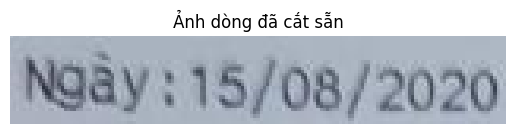

✅ Dự đoán OCR: NÔắở : 15/08/2020


In [ ]:
import cv2
import torch
from torchvision import transforms
import matplotlib.pyplot as plt

# ==== CẤU HÌNH ====
image_path = '/content/hoadon_dataset/test/img/receipt_5609.jpg'  # Đường dẫn đến ảnh dòng đã cắt sẵn
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# ==== TIỀN XỬ LÝ ====
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((64, 256)),  # Giữ nguyên kích thước đầu vào model
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

# ==== LOAD ẢNH ====
cropped = cv2.imread(image_path)

# Kiểm tra nếu không đọc được ảnh
if cropped is None:
    raise ValueError(f"Không thể đọc ảnh từ đường dẫn: {image_path}")

# Hiển thị ảnh
plt.imshow(cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB))
plt.title('Ảnh dòng đã cắt sẵn')
plt.axis('off')
plt.show()

# ==== INFERENCE OCR ====
input_tensor = transform(cropped).unsqueeze(0).to(device)

def decode_output(output, tokenizer):
    """Hàm giải mã linh hoạt"""
    if isinstance(output, tuple):
        output = output[0]  # Lấy predictions nếu có attention

    if isinstance(output, torch.Tensor):
        tokens = output.squeeze().tolist()
    else:
        tokens = output

    # Xử lý beam search (list of lists)
    if isinstance(tokens, list) and len(tokens) > 0 and isinstance(tokens[0], list):
        tokens = tokens[0]

    return tokenizer.decode(tokens)

# Giả sử model và tokenizer đã được load trước đó
with torch.no_grad():
    model_output = model.predict(input_tensor)
    pred_text = decode_output(model_output, tokenizer)

print("✅ Dự đoán OCR:", pred_text)

In [ ]:
import os
import json
import cv2
import torch
import numpy as np
from PIL import Image
from torchvision import transforms
from tabulate import tabulate

# === CẤU HÌNH ===
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
image_name = "receipt_0090.jpg"
test_image_path = f"/content/receipt_dataset/test/img/{image_name}"
anno_path = f"/content/receipt_dataset/test/annotations/{image_name.replace('.jpg', '.json')}"

# === TẢI MODEL ===
model = OCRModel(
    vocab_size=len(tokenizer.vocab),
    sos_token_id=tokenizer.vocab['<SOS>'],
    eos_token_id=tokenizer.vocab['<EOS>'],
    max_len=150
).to(device)
model.load_state_dict(torch.load("/content/resnet34_5epoch_2h22_new.pt", map_location=device))
model.eval()

# === TRANSFORM ===
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                        std=[0.229, 0.224, 0.225])
])

def decode_ids(ids):
    """Hàm giải mã cải tiến"""
    if isinstance(ids, torch.Tensor):
        ids = ids.cpu().tolist()

    if isinstance(ids, list) and ids and isinstance(ids[0], list):
        ids = ids[0]

    if isinstance(ids, int):
        ids = [ids]

    # Lọc các token đặc biệt
    clean_ids = []
    for id in ids:
        if id == tokenizer.vocab['<EOS>']:
            break
        if id not in [tokenizer.vocab['<PAD>'], tokenizer.vocab['<SOS>']]:
            clean_ids.append(id)

    return tokenizer.decode(clean_ids)

# === INFERENCE ===
results = []
target_height = 48

print(f"\n📄 Kết quả dự đoán cho ảnh: {image_name}\n")
for i, item in enumerate(annotations):
    try:
        pts = np.array(item['box'], dtype=np.float32)
        x, y, w, h = cv2.boundingRect(pts)
        roi = image_rgb[y:y+h, x:x+w]

        ratio = target_height / float(h)
        new_w = max(1, int(w * ratio))
        resized = cv2.resize(roi, (new_w, target_height))

        pil = Image.fromarray(resized)
        t = transform(pil).unsqueeze(0).to(device)

        with torch.no_grad():
            output = model.predict(t, beam_size=5)
            pred_txt = decode_ids(output[0])  # Lấy predictions từ tuple

        gt_txt = item['text']
        results.append([f"Line {i+1}", gt_txt, pred_txt])

    except Exception as e:
        print(f"⚠️ Lỗi khi xử lý dòng {i+1}: {str(e)}")
        results.append([f"Line {i+1}", item['text'], "LỖI DỰ ĐOÁN"])

# === HIỂN THỊ KẾT QUẢ ===
headers = ["Dòng", "Ground-Truth", "Prediction"]
print(tabulate(results, headers, tablefmt="grid"))

correct = sum(1 for _, gt, pr in results if gt == pr)
acc = correct / len(results) * 100
print(f"\n🔍 Độ chính xác dòng: {acc:.2f}% ({correct}/{len(results)})")


📄 Kết quả dự đoán cho ảnh: receipt_0090.jpg

+---------+----------------------------------------+------------------------------------------------+
| Dòng    | Ground-Truth                           | Prediction                                     |
+=========+========================================+================================================+
| Line 1  | FY EAGLE ENTERPRISE                    | FY EAGLE ENTERPRISE                            |
+---------+----------------------------------------+------------------------------------------------+
| Line 2  | 002065464-X                            | 00206546444-X                                  |
+---------+----------------------------------------+------------------------------------------------+
| Line 3  | NO. 42, JALAN PBS 14/11,               | NO. 42, JALAN PBS 14/11,                       |
+---------+----------------------------------------+------------------------------------------------+
| Line 4  | TAMAN PERINDUSTRIAN BUKI

In [ ]:
import os
import json
import cv2
import torch
import numpy as np
from PIL import Image
from torchvision import transforms
from tabulate import tabulate

# === CẤU HÌNH ===
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
image_name = "receipt_0090.jpg"
test_image_path = f"/content/receipt_dataset/test/img/{image_name}"
anno_path = f"/content/receipt_dataset/test/annotations/{image_name.replace('.jpg', '.json')}"

# === TẢI MODEL ===
model = OCRModel(
    vocab_size=len(tokenizer.vocab),
    sos_token_id=tokenizer.vocab['<SOS>'],
    eos_token_id=tokenizer.vocab['<EOS>'],
    max_len=150
).to(device)
model.load_state_dict(torch.load("/content/resnet34_9epoch.pt", map_location=device))
model.eval()

# === TRANSFORM ===
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                        std=[0.229, 0.224, 0.225])
])

def decode_ids(ids):
    """Hàm giải mã cải tiến"""
    if isinstance(ids, torch.Tensor):
        ids = ids.cpu().tolist()

    if isinstance(ids, list) and ids and isinstance(ids[0], list):
        ids = ids[0]

    if isinstance(ids, int):
        ids = [ids]

    # Lọc các token đặc biệt
    clean_ids = []
    for id in ids:
        if id == tokenizer.vocab['<EOS>']:
            break
        if id not in [tokenizer.vocab['<PAD>'], tokenizer.vocab['<SOS>']]:
            clean_ids.append(id)

    return tokenizer.decode(clean_ids)

# === INFERENCE ===
results = []
target_height = 48

print(f"\n📄 Kết quả dự đoán cho ảnh: {image_name}\n")
for i, item in enumerate(annotations):
    try:
        pts = np.array(item['box'], dtype=np.float32)
        x, y, w, h = cv2.boundingRect(pts)
        roi = image_rgb[y:y+h, x:x+w]

        ratio = target_height / float(h)
        new_w = max(1, int(w * ratio))
        resized = cv2.resize(roi, (new_w, target_height))

        pil = Image.fromarray(resized)
        t = transform(pil).unsqueeze(0).to(device)

        with torch.no_grad():
            output = model.predict(t, beam_size=5)
            pred_txt = decode_ids(output[0])  # Lấy predictions từ tuple

        gt_txt = item['text']
        results.append([f"Line {i+1}", gt_txt, pred_txt])

    except Exception as e:
        print(f"⚠️ Lỗi khi xử lý dòng {i+1}: {str(e)}")
        results.append([f"Line {i+1}", item['text'], "LỖI DỰ ĐOÁN"])

# === HIỂN THỊ KẾT QUẢ ===
headers = ["Dòng", "Ground-Truth", "Prediction"]
print(tabulate(results, headers, tablefmt="grid"))

correct = sum(1 for _, gt, pr in results if gt == pr)
acc = correct / len(results) * 100
print(f"\n🔍 Độ chính xác dòng: {acc:.2f}% ({correct}/{len(results)})")


📄 Kết quả dự đoán cho ảnh: receipt_0090.jpg

+---------+----------------------------------------+--------------------------------------------------------------------------------------------------------------------------------------------------------+
| Dòng    | Ground-Truth                           | Prediction                                                                                                                                             |
+=========+========================================+========================================================================================================================================================+
| Line 1  | FY EAGLE ENTERPRISE                    | FY EAGLE ENTERPRISE                                                                                                                                    |
+---------+----------------------------------------+------------------------------------------------------------------------------

In [ ]:
import os
import json
import cv2
import torch
import numpy as np
from PIL import Image
from torchvision import transforms
from tabulate import tabulate

# === CẤU HÌNH ===
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
image_name = "receipt_0007.jpg"
test_image_path = f"/content/receipt_dataset/test/img/{image_name}"
anno_path = f"/content/receipt_dataset/test/annotations/{image_name.replace('.jpg', '.json')}"

# === TẢI MODEL ===
model = OCRModel(
    vocab_size=len(tokenizer.vocab),
    sos_token_id=tokenizer.vocab['<SOS>'],
    eos_token_id=tokenizer.vocab['<EOS>'],
    max_len=150
).to(device)
model.load_state_dict(torch.load("/content/resnet34_9epoch.pt", map_location=device))
model.eval()

# === TRANSFORM ===
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                        std=[0.229, 0.224, 0.225])
])

def decode_ids(ids):
    """Hàm giải mã cải tiến"""
    if isinstance(ids, torch.Tensor):
        ids = ids.cpu().tolist()

    if isinstance(ids, list) and ids and isinstance(ids[0], list):
        ids = ids[0]

    if isinstance(ids, int):
        ids = [ids]

    # Lọc các token đặc biệt
    clean_ids = []
    for id in ids:
        if id == tokenizer.vocab['<EOS>']:
            break
        if id not in [tokenizer.vocab['<PAD>'], tokenizer.vocab['<SOS>']]:
            clean_ids.append(id)

    return tokenizer.decode(clean_ids)

# === INFERENCE ===
results = []
target_height = 48

print(f"\n📄 Kết quả dự đoán cho ảnh: {image_name}\n")
for i, item in enumerate(annotations):
    try:
        pts = np.array(item['box'], dtype=np.float32)
        x, y, w, h = cv2.boundingRect(pts)
        roi = image_rgb[y:y+h, x:x+w]

        ratio = target_height / float(h)
        new_w = max(1, int(w * ratio))
        resized = cv2.resize(roi, (new_w, target_height))

        pil = Image.fromarray(resized)
        t = transform(pil).unsqueeze(0).to(device)

        with torch.no_grad():
            output = model.predict(t, beam_size=5)
            pred_txt = decode_ids(output[0])  # Lấy predictions từ tuple

        gt_txt = item['text']
        results.append([f"Line {i+1}", gt_txt, pred_txt])

    except Exception as e:
        print(f"⚠️ Lỗi khi xử lý dòng {i+1}: {str(e)}")
        results.append([f"Line {i+1}", item['text'], "LỖI DỰ ĐOÁN"])

# === HIỂN THỊ KẾT QUẢ ===
headers = ["Dòng", "Ground-Truth", "Prediction"]
print(tabulate(results, headers, tablefmt="grid"))

correct = sum(1 for _, gt, pr in results if gt == pr)
acc = correct / len(results) * 100
print(f"\n🔍 Độ chính xác dòng: {acc:.2f}% ({correct}/{len(results)})")


📄 Kết quả dự đoán cho ảnh: receipt_0007.jpg

+---------+----------------------------------------+--------------------------------------------------------------------------------------------------------------------------------------------------------+
| Dòng    | Ground-Truth                           | Prediction                                                                                                                                             |
+=========+========================================+========================================================================================================================================================+
| Line 1  | FY EAGLE ENTERPRISE                    | FY EAGLE ENTERPRISE                                                                                                                                    |
+---------+----------------------------------------+------------------------------------------------------------------------------

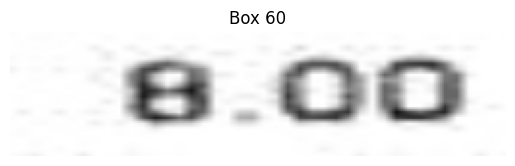

✅ Dự đoán cho box 60: 8.00


In [ ]:
import json
import cv2
import torch
import numpy as np
from torchvision import transforms
import matplotlib.pyplot as plt

# ==== CẤU HÌNH ====
image_path = '/content/receipt_dataset/test/img/receipt_0007.jpg'
annotation_path = '/content/receipt_dataset/test/annotations/receipt_0007.json'
order = 60  # Chọn bounding box thứ mấy (bắt đầu từ 0)
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# ==== TIỀN XỬ LÝ ====
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((64, 256)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

# ==== LOAD ẢNH & BOX ====
with open(annotation_path, 'r') as f:
    data = json.load(f)

box = data[order]['box']
pts = np.array(box, dtype=np.float32)

# Crop và warp ảnh
image = cv2.imread(image_path)
h, w = 64, 256
target_pts = np.array([[0, 0], [w-1, 0], [w-1, h-1], [0, h-1]], dtype=np.float32)
M = cv2.getPerspectiveTransform(pts, target_pts)
cropped = cv2.warpPerspective(image, M, (w, h))

# Hiển thị ảnh
plt.imshow(cv2.cvtColor(cropped, cv2.COLOR_BGR2RGB))
plt.title(f'Box {order}')
plt.axis('off')
plt.show()

# ==== INFERENCE OCR ====
input_tensor = transform(cropped).unsqueeze(0).to(device)

def decode_output(output, tokenizer):
    """Hàm giải mã linh hoạt"""
    if isinstance(output, tuple):
        output = output[0]  # Lấy predictions nếu có attention

    if isinstance(output, torch.Tensor):
        tokens = output.squeeze().tolist()
    else:
        tokens = output

    # Xử lý beam search (list of lists)
    if isinstance(tokens, list) and len(tokens) > 0 and isinstance(tokens[0], list):
        tokens = tokens[0]

    return tokenizer.decode(tokens)

with torch.no_grad():
    model_output = model.predict(input_tensor)
    pred_text = decode_output(model_output, tokenizer)

print(f"✅ Dự đoán cho box {order}:", pred_text)

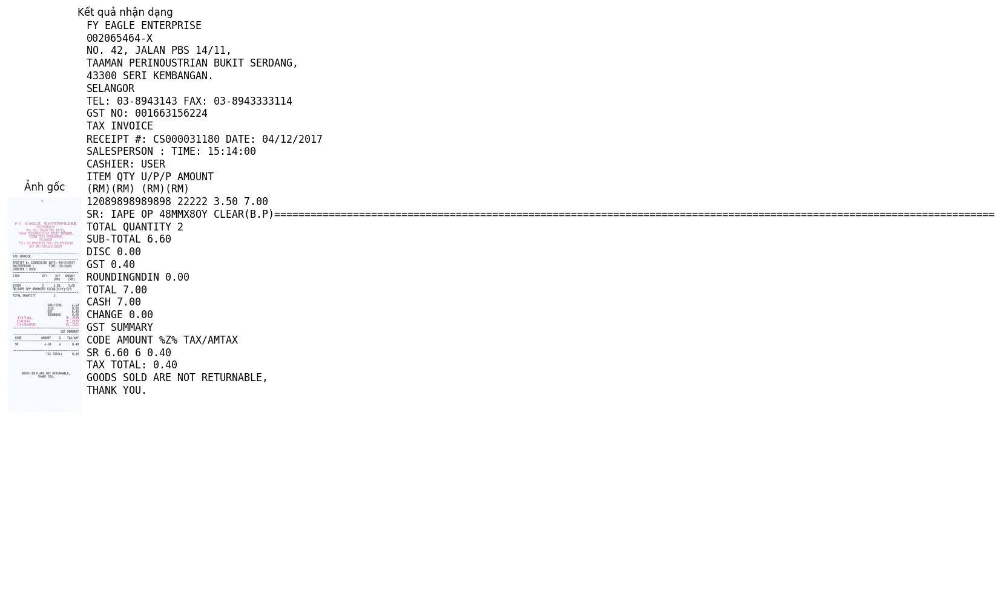

In [ ]:
import os
import json
import cv2
import torch
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from torchvision import transforms

# === CẤU HÌNH ===
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
image_name = "receipt_0090.jpg"
test_image_path = f"/content/receipt_dataset/test/img/{image_name}"
anno_path = f"/content/receipt_dataset/test/annotations/{image_name.replace('.jpg', '.json')}"

# === TẢI MODEL ===
model = OCRModel(
    vocab_size=len(tokenizer.vocab),
    sos_token_id=tokenizer.vocab['<SOS>'],
    eos_token_id=tokenizer.vocab['<EOS>'],
    max_len=150
).to(device)
model.load_state_dict(torch.load("/content/resnet34_9epoch.pt", map_location=device))
model.eval()

# === TRANSFORM ===
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

def decode_ids(ids):
    """Hàm giải mã cải tiến"""
    if isinstance(ids, torch.Tensor):
        ids = ids.cpu().tolist()

    if isinstance(ids, list) and ids and isinstance(ids[0], list):
        ids = ids[0]

    if isinstance(ids, int):
        ids = [ids]

    # Lọc các token đặc biệt
    clean_ids = []
    for id in ids:
        if id == tokenizer.vocab['<EOS>']:
            break
        if id not in [tokenizer.vocab['<PAD>'], tokenizer.vocab['<SOS>']]:
            clean_ids.append(id)

    return tokenizer.decode(clean_ids)

# === LOAD ẢNH + ANNOTATION ===
image = cv2.imread(test_image_path)
assert image is not None, f"Không đọc được {test_image_path}"
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
with open(anno_path, 'r', encoding='utf-8') as f:
    annotations = json.load(f)

# === INFERENCE MỖI DÒNG ===
target_height = 48
predictions = []

for i, item in enumerate(annotations):
    try:
        pts = np.array(item['box'], dtype=np.float32)
        x, y, w, h = cv2.boundingRect(pts)
        roi = image_rgb[y:y+h, x:x+w]

        # Resize giữ tỷ lệ
        ratio = target_height / float(h)
        new_w = max(1, int(w * ratio))
        resized = cv2.resize(roi, (new_w, target_height))

        pil = Image.fromarray(resized)
        t = transform(pil).unsqueeze(0).to(device)

        with torch.no_grad():
            output = model.predict(t, beam_size=5)
            pred_txt = decode_ids(output[0])  # Lấy predictions từ tuple

        center_y = y + h // 2
        predictions.append({
            "text": pred_txt,
            "y": center_y,
            "x": x
        })
    except Exception as e:
        print(f"⚠️ Lỗi khi xử lý dòng {i+1}: {str(e)}")
        continue

# === NHÓM THEO DÒNG (Y-GROUPING) ===
predictions.sort(key=lambda x: x["y"])  # Sắp xếp theo trục y

grouped_lines = []
line_threshold = 15  # khoảng cách theo y để coi là cùng dòng

for pred in predictions:
    matched = False
    for line in grouped_lines:
        if abs(pred["y"] - line["y_mean"]) <= line_threshold:
            line["items"].append(pred)
            line["y_vals"].append(pred["y"])
            line["y_mean"] = np.mean(line["y_vals"])
            matched = True
            break
    if not matched:
        grouped_lines.append({
            "items": [pred],
            "y_vals": [pred["y"]],
            "y_mean": pred["y"]
        })

# === GHÉP TEXT THEO DÒNG (sắp theo X) ===
output_lines = []
for line in grouped_lines:
    items = sorted(line["items"], key=lambda x: x["x"])
    line_text = " ".join([item["text"] for item in items])
    output_lines.append(line_text)

# === HIỂN THỊ: ẢNH GỐC + TEXT ===
plt.figure(figsize=(15, 10))

# Ảnh gốc (bên trái)
plt.subplot(1, 2, 1)
plt.imshow(image_rgb)
plt.title("Ảnh gốc")
plt.axis("off")

# Text nhận dạng (bên phải)
plt.subplot(1, 2, 2)
plt.axis("off")
plt.title("Kết quả nhận dạng")
text_display = "\n".join(output_lines)
plt.text(0, 1, text_display, fontsize=12, va='top', family='monospace')

plt.subplots_adjust(wspace=2)
plt.tight_layout()
plt.show()

#### Paddle for Text detection

In [ ]:
# Bước 1: Chọn GPU trong Colab
# Menu -> Runtime -> Change runtime type -> GPU

# Bước 2: Cài đặt Python 3.10 và thiết lập môi trường
!sudo apt-get update
!sudo apt-get install python3.10 python3.10-venv python3.10-dev -y

# Bước 3: Tạo virtual environment
!python3.10 -m venv paddle_gpu_env
!source paddle_gpu_env/bin/activate

# Bước 4: Cập nhật pip
!python3.10 -m pip install --upgrade pip setuptools wheel

# Bước 5: Cài đặt PaddlePaddle GPU version (QUAN TRỌNG)
!python3.10 -m pip install paddlepaddle-gpu==2.5.1.post117 -f https://www.paddlepaddle.org.cn/whl/linux/mkl/avx/stable.html

# Bước 6: Cài đặt PaddleOCR và dependencies
!python3.10 -m pip install \
    paddleocr==2.7.0.3 \
    opencv-python==4.8.0.76 \
    numpy==1.23.5 \
    shapely==2.0.2 \
    pyclipper==1.3.0.post6 \
    lmdb==1.4.1

# Bước 7: Cài đặt thư viện hệ thống
!apt-get install -y libgl1 libglib2.0-0

Get:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Hit:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Get:3 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Hit:4 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:5 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Get:6 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Hit:7 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Get:8 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Get:9 https://r2u.stat.illinois.edu/ubuntu jammy/main all Packages [8,927 kB]
Hit:10 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Get:11 http://security.ubuntu.com/ubuntu jammy-security/main amd64 Packages [2,901 kB]
Get:12 http://archive.ubuntu.com/ubuntu jammy-updates/main amd64 Packages [3,211 kB]
Hit:13 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy I

In [ ]:
!pip install paddlepaddle paddleocr

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.2/87.2 kB 5.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 192.8/192.8 MB 6.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.5/65.5 kB 6.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 97.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 297.8/297.8 kB 30.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 969.6/969.6 kB 63.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 244.3/244.3 kB 25.5 MB/s eta 0:00:00
  Created wheel for fire: filename=fire-0.7.0-py3-none-any.whl size=114249 sha256=88de000e81a7cca6c55e9f6a6496363c9d40b155f9ad5589b15442014bd47ff9
  Stored in directory: /root/.cache/pip/wheels/46/54/24/1624fd5b8674eb1188623f7e8e17cdf7c0f6c24b609dfb8a89
Successfully built fire
  Attempting uninstall: opt_einsum
    Found existing installation: opt_einsum 3.4.0
    Uninstalling opt_einsum-3.4.0:
   

In [ ]:
import paddle
from paddleocr import PaddleOCR

# Kiểm tra GPU
print(f"PaddlePGPU có sẵn: {paddle.is_compiled_with_cuda()}")
print(f"GPU đang dùng: {paddle.get_device()}")

# Khởi tạo OCR với GPU
ocr = PaddleOCR(
    use_angle_cls=False,
    lang='en',
    rec=False,
    use_gpu=True  # Bật GPU
)
print("🟢 PaddleOCR GPU version hoạt động!")

/usr/local/lib/python3.11/dist-packages/paddle/utils/cpp_extension/extension_utils.py:711: UserWarning: No ccache found. Please be aware that recompiling all source files may be required. You can download and install ccache from: https://github.com/ccache/ccache/blob/master/doc/INSTALL.md
  warnings.warn(warning_message)


PaddlePGPU có sẵn: False
GPU đang dùng: cpu
download https://paddleocr.bj.bcebos.com/PP-OCRv3/english/en_PP-OCRv3_det_infer.tar to /root/.paddleocr/whl/det/en/en_PP-OCRv3_det_infer/en_PP-OCRv3_det_infer.tar


100%|██████████| 3910/3910 [00:16<00:00, 233.28it/s] 


download https://paddleocr.bj.bcebos.com/PP-OCRv4/english/en_PP-OCRv4_rec_infer.tar to /root/.paddleocr/whl/rec/en/en_PP-OCRv4_rec_infer/en_PP-OCRv4_rec_infer.tar


100%|██████████| 10000/10000 [00:19<00:00, 515.00it/s]


download https://paddleocr.bj.bcebos.com/dygraph_v2.0/ch/ch_ppocr_mobile_v2.0_cls_infer.tar to /root/.paddleocr/whl/cls/ch_ppocr_mobile_v2.0_cls_infer/ch_ppocr_mobile_v2.0_cls_infer.tar


100%|██████████| 2138/2138 [00:15<00:00, 138.64it/s]

[2025/05/12 16:06:36] ppocr DEBUG: Namespace(help='==SUPPRESS==', use_gpu=False, use_xpu=False, use_npu=False, use_mlu=False, use_gcu=False, ir_optim=True, use_tensorrt=False, min_subgraph_size=15, precision='fp32', gpu_mem=500, gpu_id=0, image_dir=None, page_num=0, det_algorithm='DB', det_model_dir='/root/.paddleocr/whl/det/en/en_PP-OCRv3_det_infer', det_limit_side_len=960, det_limit_type='max', det_box_type='quad', det_db_thresh=0.3, det_db_box_thresh=0.6, det_db_unclip_ratio=1.5, max_batch_size=10, use_dilation=False, det_db_score_mode='fast', det_east_score_thresh=0.8, det_east_cover_thresh=0.1, det_east_nms_thresh=0.2, det_sast_score_thresh=0.5, det_sast_nms_thresh=0.2, det_pse_thresh=0, det_pse_box_thresh=0.85, det_pse_min_area=16, det_pse_scale=1, scales=[8, 16, 32], alpha=1.0, beta=1.0, fourier_degree=5, rec_algorithm='SVTR_LCNet', rec_model_dir='/root/.paddleocr/whl/rec/en/en_PP-OCRv4_rec_infer', rec_image_inverse=True, rec_image_shape='3, 48, 320', rec_batch_num=6, max_text_l

🟢 PaddleOCR GPU version hoạt động!


In [ ]:
from paddleocr import PaddleOCR
import cv2
import json
from typing import List, Dict

def detect_text_boxes(image_path: str) -> List[Dict]:
    """
    Detect text bounding boxes from image using PaddleOCR

    Args:
        image_path: Path to input image

    Returns:
        List of dictionaries containing box coordinates
    """
    # Initialize PaddleOCR (disable recognition for faster processing)
    ocr = PaddleOCR(
        use_angle_cls=False,
        lang='en',
        rec=False,  # Disable text recognition
        use_gpu=False,  # Set to True if using GPU
        det_limit_side_len=1280  # Limit image size for detection
    )

    # Read image
    image = cv2.imread(image_path)
    if image is None:
        raise ValueError(f"Cannot read image: {image_path}")

    # Perform detection
    result = ocr.ocr(image, cls=False)

    # Format results
    boxes = []
    for idx, item in enumerate(result[0]):
        # PaddleOCR v2.7+ returns boxes as list of lists
        points = item[0]  # Already in list format [[x1,y1], [x2,y2],...]

        boxes.append({
            "id": idx + 1,
            "text": "",  # Empty since we disabled recognition
            "box": points  # [[x1,y1], [x2,y2], [x3,y3], [x4,y4]]
        })

    return boxes

def save_to_json(data: List[Dict], output_path: str):
    """Save detection results to JSON file"""
    with open(output_path, 'w', encoding='utf-8') as f:
        json.dump(data, f, ensure_ascii=False, indent=2)

# Example usage
if __name__ == "__main__":
    input_image = "hoadon_1.jpg"  # Change to your image path
    output_json = "output_boxes.json"

    # Detect boxes
    detected_boxes = detect_text_boxes(input_image)

    # Save to JSON
    save_to_json(detected_boxes, output_json)

    print(f"✅ Detection completed! Saved to {output_json}")
    print(f"Found {len(detected_boxes)} text boxes")

[2025/05/12 16:06:41] ppocr DEBUG: Namespace(help='==SUPPRESS==', use_gpu=False, use_xpu=False, use_npu=False, use_mlu=False, use_gcu=False, ir_optim=True, use_tensorrt=False, min_subgraph_size=15, precision='fp32', gpu_mem=500, gpu_id=0, image_dir=None, page_num=0, det_algorithm='DB', det_model_dir='/root/.paddleocr/whl/det/en/en_PP-OCRv3_det_infer', det_limit_side_len=1280, det_limit_type='max', det_box_type='quad', det_db_thresh=0.3, det_db_box_thresh=0.6, det_db_unclip_ratio=1.5, max_batch_size=10, use_dilation=False, det_db_score_mode='fast', det_east_score_thresh=0.8, det_east_cover_thresh=0.1, det_east_nms_thresh=0.2, det_sast_score_thresh=0.5, det_sast_nms_thresh=0.2, det_pse_thresh=0, det_pse_box_thresh=0.85, det_pse_min_area=16, det_pse_scale=1, scales=[8, 16, 32], alpha=1.0, beta=1.0, fourier_degree=5, rec_algorithm='SVTR_LCNet', rec_model_dir='/root/.paddleocr/whl/rec/en/en_PP-OCRv4_rec_infer', rec_image_inverse=True, rec_image_shape='3, 48, 320', rec_batch_num=6, max_text_

✅ Đã lưu ảnh với bounding boxes tại: output_with_boxes.jpg

Kết quả nhận diện:


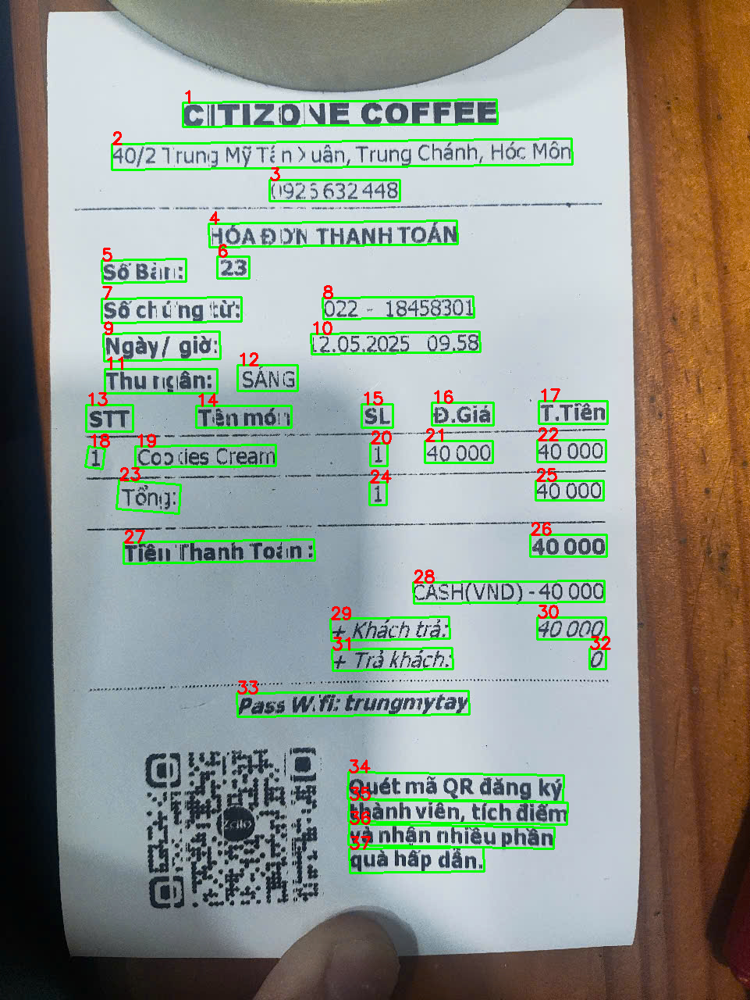

In [ ]:
import cv2
import json
import numpy as np
from google.colab.patches import cv2_imshow

def draw_boxes_on_image(image_path: str, json_path: str, output_path: str = "output.jpg"):
    """
    Vẽ bounding boxes từ file JSON lên ảnh gốc

    Args:
        image_path: Đường dẫn đến ảnh gốc
        json_path: Đường dẫn đến file JSON chứa thông tin boxes
        output_path: Đường dẫn lưu ảnh kết quả
    """
    # Đọc ảnh gốc
    image = cv2.imread(image_path)
    if image is None:
        raise ValueError(f"Cannot read image: {image_path}")

    # Đọc dữ liệu từ file JSON
    with open(json_path, 'r', encoding='utf-8') as f:
        boxes_data = json.load(f)

    # Vẽ từng box lên ảnh
    for box_info in boxes_data:
        points = np.array(box_info['box'], dtype=np.int32)

        # Vẽ polygon (do PaddleOCR trả về tứ giác không phải rectangle)
        cv2.polylines(image, [points], isClosed=True, color=(0, 255, 0), thickness=2)

        # Vẽ số thứ tự box
        cv2.putText(image, str(box_info['id']),
                   tuple(points[0]),  # Vị trí text (góc trên trái box)
                   cv2.FONT_HERSHEY_SIMPLEX,
                   0.7, (0, 0, 255), 2)

    # Lưu ảnh kết quả
    cv2.imwrite(output_path, image)
    print(f"✅ Đã lưu ảnh với bounding boxes tại: {output_path}")

    # Hiển thị ảnh trên Colab
    print("\nKết quả nhận diện:")
    cv2_imshow(image)

# Sử dụng hàm
if __name__ == "__main__":
    input_image = "hoadon_1.jpg"  # Ảnh gốc
    json_file = "output_boxes.json"  # File JSON từ PaddleOCR

    draw_boxes_on_image(input_image, json_file, "output_with_boxes.jpg")

In [ ]:
import os
import json
import cv2
import torch
import numpy as np
from PIL import Image
from torchvision import transforms
from tabulate import tabulate

# === CẤU HÌNH ===
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
image_name = "hoadon_1.jpg"
test_image_path = f"/content/{image_name}"
anno_path = "output_boxes.json"  # Sử dụng file output từ PaddleOCR

# === TẢI MODEL ===
model = OCRModel(
    vocab_size=len(tokenizer.vocab),
    sos_token_id=tokenizer.vocab['<SOS>'],
    eos_token_id=tokenizer.vocab['<EOS>'],
    max_len=150
).to(device)
model.load_state_dict(torch.load("/content/resnet34_9epoch.pt", map_location=device))
model.eval()

# === TRANSFORM (giống lúc training) ===
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

# === HÀM GIẢI MÃ OUTPUT ===
def decode_ids(ids):
    # Ensure ids is a flat list of integers
    if isinstance(ids, (list, tuple)) and len(ids) > 0 and isinstance(ids[0], (list, tuple)):
        ids = ids[0]  # Take the first element if it's nested
    return tokenizer.decode(ids, skip_special_tokens=True)

# === LOAD ẢNH + ANNOTATION ===
image = cv2.imread(test_image_path)
assert image is not None, f"Không đọc được {test_image_path}"
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Đọc annotations từ file output_boxes.json
with open(anno_path, 'r', encoding='utf-8') as f:
    annotations = json.load(f)
    annotations.sort(key=lambda x: min(point[1] for point in x['box']))

# === INFERENCE MỖI DÒNG ===
results = []
target_height = 48

print(f"\n📄 Kết quả dự đoán cho ảnh: {image_name}\n")
for i, item in enumerate(annotations):
    pts = np.array(item['box'], dtype=np.float32)

    # 1) Crop bằng boundingRect (ko warp)
    x, y, w, h = cv2.boundingRect(pts)
    roi = image_rgb[y:y+h, x:x+w]

    # 2) Resize theo tỉ lệ để chiều cao = target_height
    ratio = target_height / float(h)
    new_w = max(1, int(w * ratio))
    resized = cv2.resize(roi, (new_w, target_height))

    # 3) ToTensor + Normalize
    pil = Image.fromarray(resized)
    t = transform(pil).unsqueeze(0).to(device)  # [1,3,48,new_w]

    # 4) Predict
    with torch.no_grad():
        output = model.predict(t, beam_size=5)

        # Xử lý đầu ra tùy thuộc vào cấu trúc model trả về
        if isinstance(output, tuple):
            # Giả sử phần tử đầu tiên của tuple là kết quả dự đoán
            out_ids = output[0]
        else:
            out_ids = output

        # Chuyển đổi sang CPU nếu cần và lấy danh sách ID
        if isinstance(out_ids, torch.Tensor):
            out_ids = out_ids.cpu().tolist()
        elif isinstance(out_ids, (list, tuple)):
            out_ids = list(out_ids)  # Chuyển tuple sang list nếu cần

        pred_txt = decode_ids(out_ids)

    # Lấy ground truth nếu có (nếu không thì để empty)
    gt_txt = item.get('text', '')
    results.append([f"Line {i+1}", gt_txt, pred_txt])

# === HIỂN THỊ KẾT QUẢ DẠNG BẢNG ===
headers = ["Dòng", "Ground-Truth", "Prediction"]
print(tabulate(results, headers, tablefmt="grid"))

# === ĐỘ CHÍNH XÁC DÒNG === (chỉ tính nếu có ground truth)
if any(gt for _, gt, _ in results):
    correct = sum(1 for _, gt, pr in results if gt and gt == pr)
    acc = correct / len([gt for _, gt, _ in results if gt]) * 100
    print(f"\n🔍 Độ chính xác dòng: {acc:.2f}% ({correct}/{len([gt for _, gt, _ in results if gt])})")
else:
    print("\n⚠ Không có ground truth để tính độ chính xác")
    # In kết quả nhận dạng
    print("\n🔍 Kết quả nhận dạng:")
    for i, (line, _, pred) in enumerate(results):
        print(f"Dòng {i+1}: {pred}")


📄 Kết quả dự đoán cho ảnh: hoadon_1.jpg

+---------+----------------+----------------------------------------------------------------+
| Dòng    | Ground-Truth   | Prediction                                                     |
+=========+================+================================================================+
| Line 1  |                | CLIFIZONE COFFEE                                               |
+---------+----------------+----------------------------------------------------------------+
| Line 2  |                | 40/2 TrỶnNG NYầm, TRUNG ChủỐnẴ MẦẼhẻc                          |
+---------+----------------+----------------------------------------------------------------+
| Line 3  |                | (925632 5632448                                                |
+---------+----------------+----------------------------------------------------------------+
| Line 4  |                | HỖA ẨON THANHANH TOậNH TOậN                                    |
+---------+-------

In [ ]:
from paddleocr import PaddleOCR
import cv2
import json
from typing import List, Dict

def detect_text_boxes(image_path: str) -> List[Dict]:
    """
    Detect text bounding boxes from image using PaddleOCR

    Args:
        image_path: Path to input image

    Returns:
        List of dictionaries containing box coordinates
    """
    # Initialize PaddleOCR (disable recognition for faster processing)
    ocr = PaddleOCR(
        use_angle_cls=False,
        lang='en',
        rec=False,  # Disable text recognition
        use_gpu=False,  # Set to True if using GPU
        det_limit_side_len=1280  # Limit image size for detection
    )

    # Read image
    image = cv2.imread(image_path)
    if image is None:
        raise ValueError(f"Cannot read image: {image_path}")

    # Perform detection
    result = ocr.ocr(image, cls=False)

    # Format results
    boxes = []
    for idx, item in enumerate(result[0]):
        # PaddleOCR v2.7+ returns boxes as list of lists
        points = item[0]  # Already in list format [[x1,y1], [x2,y2],...]

        boxes.append({
            "id": idx + 1,
            "text": "",  # Empty since we disabled recognition
            "box": points  # [[x1,y1], [x2,y2], [x3,y3], [x4,y4]]
        })

    return boxes

def save_to_json(data: List[Dict], output_path: str):
    """Save detection results to JSON file"""
    with open(output_path, 'w', encoding='utf-8') as f:
        json.dump(data, f, ensure_ascii=False, indent=2)

# Example usage
if __name__ == "__main__":
    input_image = "real.jpg"  # Change to your image path
    output_json = "output_boxes.json"

    # Detect boxes
    detected_boxes = detect_text_boxes(input_image)

    # Save to JSON
    save_to_json(detected_boxes, output_json)

    print(f"✅ Detection completed! Saved to {output_json}")
    print(f"Found {len(detected_boxes)} text boxes")

[2025/05/12 16:08:19] ppocr DEBUG: Namespace(help='==SUPPRESS==', use_gpu=False, use_xpu=False, use_npu=False, use_mlu=False, use_gcu=False, ir_optim=True, use_tensorrt=False, min_subgraph_size=15, precision='fp32', gpu_mem=500, gpu_id=0, image_dir=None, page_num=0, det_algorithm='DB', det_model_dir='/root/.paddleocr/whl/det/en/en_PP-OCRv3_det_infer', det_limit_side_len=1280, det_limit_type='max', det_box_type='quad', det_db_thresh=0.3, det_db_box_thresh=0.6, det_db_unclip_ratio=1.5, max_batch_size=10, use_dilation=False, det_db_score_mode='fast', det_east_score_thresh=0.8, det_east_cover_thresh=0.1, det_east_nms_thresh=0.2, det_sast_score_thresh=0.5, det_sast_nms_thresh=0.2, det_pse_thresh=0, det_pse_box_thresh=0.85, det_pse_min_area=16, det_pse_scale=1, scales=[8, 16, 32], alpha=1.0, beta=1.0, fourier_degree=5, rec_algorithm='SVTR_LCNet', rec_model_dir='/root/.paddleocr/whl/rec/en/en_PP-OCRv4_rec_infer', rec_image_inverse=True, rec_image_shape='3, 48, 320', rec_batch_num=6, max_text_

In [ ]:
import os
import json
import cv2
import torch
import numpy as np
from PIL import Image
from torchvision import transforms
from tabulate import tabulate

# === CẤU HÌNH ===
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
image_name = "real.jpg"
test_image_path = f"/content/{image_name}"
anno_path = "output_boxes.json"  # Sử dụng file output từ PaddleOCR

# === TẢI MODEL ===
model = OCRModel(
    vocab_size=len(tokenizer.vocab),
    sos_token_id=tokenizer.vocab['<SOS>'],
    eos_token_id=tokenizer.vocab['<EOS>'],
    max_len=150
).to(device)
model.load_state_dict(torch.load("/content/resnet34_9epoch.pt", map_location=device))
model.eval()

# === TRANSFORM (giống lúc training) ===
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

# === HÀM GIẢI MÃ OUTPUT ===
def decode_ids(ids):
    # Ensure ids is a flat list of integers
    if isinstance(ids, (list, tuple)) and len(ids) > 0 and isinstance(ids[0], (list, tuple)):
        ids = ids[0]  # Take the first element if it's nested
    return tokenizer.decode(ids, skip_special_tokens=True)

# === LOAD ẢNH + ANNOTATION ===
image = cv2.imread(test_image_path)
assert image is not None, f"Không đọc được {test_image_path}"
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Đọc annotations từ file output_boxes.json
with open(anno_path, 'r', encoding='utf-8') as f:
    annotations = json.load(f)
    annotations.sort(key=lambda x: min(point[1] for point in x['box']))

# === INFERENCE MỖI DÒNG ===
results = []
target_height = 48

print(f"\n📄 Kết quả dự đoán cho ảnh: {image_name}\n")
for i, item in enumerate(annotations):
    pts = np.array(item['box'], dtype=np.float32)

    # 1) Crop bằng boundingRect (ko warp)
    x, y, w, h = cv2.boundingRect(pts)
    roi = image_rgb[y:y+h, x:x+w]

    # 2) Resize theo tỉ lệ để chiều cao = target_height
    ratio = target_height / float(h)
    new_w = max(1, int(w * ratio))
    resized = cv2.resize(roi, (new_w, target_height))

    # 3) ToTensor + Normalize
    pil = Image.fromarray(resized)
    t = transform(pil).unsqueeze(0).to(device)  # [1,3,48,new_w]

    # 4) Predict
    with torch.no_grad():
        output = model.predict(t, beam_size=5)

        # Xử lý đầu ra tùy thuộc vào cấu trúc model trả về
        if isinstance(output, tuple):
            # Giả sử phần tử đầu tiên của tuple là kết quả dự đoán
            out_ids = output[0]
        else:
            out_ids = output

        # Chuyển đổi sang CPU nếu cần và lấy danh sách ID
        if isinstance(out_ids, torch.Tensor):
            out_ids = out_ids.cpu().tolist()
        elif isinstance(out_ids, (list, tuple)):
            out_ids = list(out_ids)  # Chuyển tuple sang list nếu cần

        pred_txt = decode_ids(out_ids)

    # Lấy ground truth nếu có (nếu không thì để empty)
    gt_txt = item.get('text', '')
    results.append([f"Line {i+1}", gt_txt, pred_txt])

# === HIỂN THỊ KẾT QUẢ DẠNG BẢNG ===
headers = ["Dòng", "Ground-Truth", "Prediction"]
print(tabulate(results, headers, tablefmt="grid"))

# === ĐỘ CHÍNH XÁC DÒNG === (chỉ tính nếu có ground truth)
if any(gt for _, gt, _ in results):
    correct = sum(1 for _, gt, pr in results if gt and gt == pr)
    acc = correct / len([gt for _, gt, _ in results if gt]) * 100
    print(f"\n🔍 Độ chính xác dòng: {acc:.2f}% ({correct}/{len([gt for _, gt, _ in results if gt])})")
else:
    print("\n⚠ Không có ground truth để tính độ chính xác")
    # In kết quả nhận dạng
    print("\n🔍 Kết quả nhận dạng:")
    for i, (line, _, pred) in enumerate(results):
        print(f"Dòng {i+1}: {pred}")


📄 Kết quả dự đoán cho ảnh: real.jpg

+---------+----------------+--------------------------------------------------------------------------------------------------------------------------------------------------------+
| Dòng    | Ground-Truth   | Prediction                                                                                                                                             |
+=========+================+========================================================================================================================================================+
| Line 1  |                | 7-ELEVEờ                                                                                                                                               |
+---------+----------------+--------------------------------------------------------------------------------------------------------------------------------------------------------+
| Line 2  |                | TÌnẴ sÌ ờien ờhanh ờÌan

In [ ]:
import os
import json
import cv2
import torch
import numpy as np
from PIL import Image
from torchvision import transforms
from tabulate import tabulate

# === CẤU HÌNH ===
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
image_name = "real.jpg"
test_image_path = f"/content/{image_name}"
anno_path = "output_boxes.json"  # Sử dụng file output từ PaddleOCR

# === TẢI MODEL ===
model = OCRModel(
    vocab_size=len(tokenizer.vocab),
    sos_token_id=tokenizer.vocab['<SOS>'],
    eos_token_id=tokenizer.vocab['<EOS>'],
    max_len=150
).to(device)
model.load_state_dict(torch.load("/content/resnet34_5epoch_2h22_new.pt", map_location=device))
model.eval()

# === TRANSFORM (giống lúc training) ===
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

# === HÀM GIẢI MÃ OUTPUT ===
def decode_ids(ids):
    # Ensure ids is a flat list of integers
    if isinstance(ids, (list, tuple)) and len(ids) > 0 and isinstance(ids[0], (list, tuple)):
        ids = ids[0]  # Take the first element if it's nested
    return tokenizer.decode(ids, skip_special_tokens=True)

# === LOAD ẢNH + ANNOTATION ===
image = cv2.imread(test_image_path)
assert image is not None, f"Không đọc được {test_image_path}"
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Đọc annotations từ file output_boxes.json
with open(anno_path, 'r', encoding='utf-8') as f:
    annotations = json.load(f)
    annotations.sort(key=lambda x: min(point[1] for point in x['box']))

# === INFERENCE MỖI DÒNG ===
results = []
target_height = 48

print(f"\n📄 Kết quả dự đoán cho ảnh: {image_name}\n")
for i, item in enumerate(annotations):
    pts = np.array(item['box'], dtype=np.float32)

    # 1) Crop bằng boundingRect (ko warp)
    x, y, w, h = cv2.boundingRect(pts)
    roi = image_rgb[y:y+h, x:x+w]

    # 2) Resize theo tỉ lệ để chiều cao = target_height
    ratio = target_height / float(h)
    new_w = max(1, int(w * ratio))
    resized = cv2.resize(roi, (new_w, target_height))

    # 3) ToTensor + Normalize
    pil = Image.fromarray(resized)
    t = transform(pil).unsqueeze(0).to(device)  # [1,3,48,new_w]

    # 4) Predict
    with torch.no_grad():
        output = model.predict(t, beam_size=5)

        # Xử lý đầu ra tùy thuộc vào cấu trúc model trả về
        if isinstance(output, tuple):
            # Giả sử phần tử đầu tiên của tuple là kết quả dự đoán
            out_ids = output[0]
        else:
            out_ids = output

        # Chuyển đổi sang CPU nếu cần và lấy danh sách ID
        if isinstance(out_ids, torch.Tensor):
            out_ids = out_ids.cpu().tolist()
        elif isinstance(out_ids, (list, tuple)):
            out_ids = list(out_ids)  # Chuyển tuple sang list nếu cần

        pred_txt = decode_ids(out_ids)

    # Lấy ground truth nếu có (nếu không thì để empty)
    gt_txt = item.get('text', '')
    results.append([f"Line {i+1}", gt_txt, pred_txt])

# === HIỂN THỊ KẾT QUẢ DẠNG BẢNG ===
headers = ["Dòng", "Ground-Truth", "Prediction"]
print(tabulate(results, headers, tablefmt="grid"))

# === ĐỘ CHÍNH XÁC DÒNG === (chỉ tính nếu có ground truth)
if any(gt for _, gt, _ in results):
    correct = sum(1 for _, gt, pr in results if gt and gt == pr)
    acc = correct / len([gt for _, gt, _ in results if gt]) * 100
    print(f"\n🔍 Độ chính xác dòng: {acc:.2f}% ({correct}/{len([gt for _, gt, _ in results if gt])})")
else:
    print("\n⚠ Không có ground truth để tính độ chính xác")
    # In kết quả nhận dạng
    print("\n🔍 Kết quả nhận dạng:")
    for i, (line, _, pred) in enumerate(results):
        print(f"Dòng {i+1}: {pred}")


📄 Kết quả dự đoán cho ảnh: real.jpg

+---------+----------------+------------------------------------------------------------------------------------------+
| Dòng    | Ground-Truth   | Prediction                                                                               |
+=========+================+==========================================================================================+
| Line 1  |                | TELEIEVELE                                                                               |
+---------+----------------+------------------------------------------------------------------------------------------+
| Line 2  |                | 10 - ThốnÔ PhẶ - QẬĐnÔ USỂnh .                                                           |
+---------+----------------+------------------------------------------------------------------------------------------+
| Line 3  |                | NÔắở : 08/08/2020 - :32:2:36                                                             |
+-

In [ ]:
from paddleocr import PaddleOCR
import cv2
import json
from typing import List, Dict

def detect_text_boxes(image_path: str) -> List[Dict]:
    """
    Detect text bounding boxes from image using PaddleOCR

    Args:
        image_path: Path to input image

    Returns:
        List of dictionaries containing box coordinates
    """
    # Initialize PaddleOCR (disable recognition for faster processing)
    ocr = PaddleOCR(
        use_angle_cls=False,
        lang='en',
        rec=False,  # Disable text recognition
        use_gpu=False,  # Set to True if using GPU
        det_limit_side_len=1280  # Limit image size for detection
    )

    # Read image
    image = cv2.imread(image_path)
    if image is None:
        raise ValueError(f"Cannot read image: {image_path}")

    # Perform detection
    result = ocr.ocr(image, cls=False)

    # Format results
    boxes = []
    for idx, item in enumerate(result[0]):
        # PaddleOCR v2.7+ returns boxes as list of lists
        points = item[0]  # Already in list format [[x1,y1], [x2,y2],...]

        boxes.append({
            "id": idx + 1,
            "text": "",  # Empty since we disabled recognition
            "box": points  # [[x1,y1], [x2,y2], [x3,y3], [x4,y4]]
        })

    return boxes

def save_to_json(data: List[Dict], output_path: str):
    """Save detection results to JSON file"""
    with open(output_path, 'w', encoding='utf-8') as f:
        json.dump(data, f, ensure_ascii=False, indent=2)

# Example usage
if __name__ == "__main__":
    input_image = "hoadon_1.jpg"  # Change to your image path
    output_json = "output_boxes.json"

    # Detect boxes
    detected_boxes = detect_text_boxes(input_image)

    # Save to JSON
    save_to_json(detected_boxes, output_json)

    print(f"✅ Detection completed! Saved to {output_json}")
    print(f"Found {len(detected_boxes)} text boxes")

[2025/05/12 16:12:21] ppocr DEBUG: Namespace(help='==SUPPRESS==', use_gpu=False, use_xpu=False, use_npu=False, use_mlu=False, use_gcu=False, ir_optim=True, use_tensorrt=False, min_subgraph_size=15, precision='fp32', gpu_mem=500, gpu_id=0, image_dir=None, page_num=0, det_algorithm='DB', det_model_dir='/root/.paddleocr/whl/det/en/en_PP-OCRv3_det_infer', det_limit_side_len=1280, det_limit_type='max', det_box_type='quad', det_db_thresh=0.3, det_db_box_thresh=0.6, det_db_unclip_ratio=1.5, max_batch_size=10, use_dilation=False, det_db_score_mode='fast', det_east_score_thresh=0.8, det_east_cover_thresh=0.1, det_east_nms_thresh=0.2, det_sast_score_thresh=0.5, det_sast_nms_thresh=0.2, det_pse_thresh=0, det_pse_box_thresh=0.85, det_pse_min_area=16, det_pse_scale=1, scales=[8, 16, 32], alpha=1.0, beta=1.0, fourier_degree=5, rec_algorithm='SVTR_LCNet', rec_model_dir='/root/.paddleocr/whl/rec/en/en_PP-OCRv4_rec_infer', rec_image_inverse=True, rec_image_shape='3, 48, 320', rec_batch_num=6, max_text_

In [ ]:
import os
import json
import cv2
import torch
import numpy as np
from PIL import Image
from torchvision import transforms
from tabulate import tabulate

# === CẤU HÌNH ===
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
image_name = "hoadon_1.jpg"
test_image_path = f"/content/{image_name}"
anno_path = "output_boxes.json"  # Sử dụng file output từ PaddleOCR

# === TẢI MODEL ===
model = OCRModel(
    vocab_size=len(tokenizer.vocab),
    sos_token_id=tokenizer.vocab['<SOS>'],
    eos_token_id=tokenizer.vocab['<EOS>'],
    max_len=150
).to(device)
model.load_state_dict(torch.load("/content/resnet34_5epoch_2h22_new.pt", map_location=device))
model.eval()

# === TRANSFORM (giống lúc training) ===
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

# === HÀM GIẢI MÃ OUTPUT ===
def decode_ids(ids):
    # Ensure ids is a flat list of integers
    if isinstance(ids, (list, tuple)) and len(ids) > 0 and isinstance(ids[0], (list, tuple)):
        ids = ids[0]  # Take the first element if it's nested
    return tokenizer.decode(ids, skip_special_tokens=True)

# === LOAD ẢNH + ANNOTATION ===
image = cv2.imread(test_image_path)
assert image is not None, f"Không đọc được {test_image_path}"
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Đọc annotations từ file output_boxes.json
with open(anno_path, 'r', encoding='utf-8') as f:
    annotations = json.load(f)
    annotations.sort(key=lambda x: min(point[1] for point in x['box']))

# === INFERENCE MỖI DÒNG ===
results = []
target_height = 48

print(f"\n📄 Kết quả dự đoán cho ảnh: {image_name}\n")
for i, item in enumerate(annotations):
    pts = np.array(item['box'], dtype=np.float32)

    # 1) Crop bằng boundingRect (ko warp)
    x, y, w, h = cv2.boundingRect(pts)
    roi = image_rgb[y:y+h, x:x+w]

    # 2) Resize theo tỉ lệ để chiều cao = target_height
    ratio = target_height / float(h)
    new_w = max(1, int(w * ratio))
    resized = cv2.resize(roi, (new_w, target_height))

    # 3) ToTensor + Normalize
    pil = Image.fromarray(resized)
    t = transform(pil).unsqueeze(0).to(device)  # [1,3,48,new_w]

    # 4) Predict
    with torch.no_grad():
        output = model.predict(t, beam_size=5)

        # Xử lý đầu ra tùy thuộc vào cấu trúc model trả về
        if isinstance(output, tuple):
            # Giả sử phần tử đầu tiên của tuple là kết quả dự đoán
            out_ids = output[0]
        else:
            out_ids = output

        # Chuyển đổi sang CPU nếu cần và lấy danh sách ID
        if isinstance(out_ids, torch.Tensor):
            out_ids = out_ids.cpu().tolist()
        elif isinstance(out_ids, (list, tuple)):
            out_ids = list(out_ids)  # Chuyển tuple sang list nếu cần

        pred_txt = decode_ids(out_ids)

    # Lấy ground truth nếu có (nếu không thì để empty)
    gt_txt = item.get('text', '')
    results.append([f"Line {i+1}", gt_txt, pred_txt])

# === HIỂN THỊ KẾT QUẢ DẠNG BẢNG ===
headers = ["Dòng", "Ground-Truth", "Prediction"]
print(tabulate(results, headers, tablefmt="grid"))

# === ĐỘ CHÍNH XÁC DÒNG === (chỉ tính nếu có ground truth)
if any(gt for _, gt, _ in results):
    correct = sum(1 for _, gt, pr in results if gt and gt == pr)
    acc = correct / len([gt for _, gt, _ in results if gt]) * 100
    print(f"\n🔍 Độ chính xác dòng: {acc:.2f}% ({correct}/{len([gt for _, gt, _ in results if gt])})")
else:
    print("\n⚠ Không có ground truth để tính độ chính xác")
    # In kết quả nhận dạng
    print("\n🔍 Kết quả nhận dạng:")
    for i, (line, _, pred) in enumerate(results):
        print(f"Dòng {i+1}: {pred}")


📄 Kết quả dự đoán cho ảnh: hoadon_1.jpg

+---------+----------------+----------------------------------------------------+
| Dòng    | Ground-Truth   | Prediction                                         |
+=========+================+====================================================+
| Line 1  |                | CITHIZONE COFFEE COFFEE                            |
+---------+----------------+----------------------------------------------------+
| Line 2  |                | 40Z Trẫn PhẶ QẬở - NÔ TỐnh ThẬởĂnhẶ - MỆn Hù & MỆn |
+---------+----------------+----------------------------------------------------+
| Line 3  |                | (925632 6324484844848484844848484                  |
+---------+----------------+----------------------------------------------------+
| Line 4  |                | HOA ầDN THAN HANH TOĩN                             |
+---------+----------------+----------------------------------------------------+
| Line 5  |                | 23                         